In [9]:
import pandas as pd
import AnalFunctions as af
import numpy as np
import matplotlib.pyplot as plt
import os

path, folder_list, N_runs, b, cross_var, folder_frame, test_str, test_var, test_var2, test_str2, lin_var, T_test_list, sec_test_var, N_ped, fps, mot_frac = af.var_ini()
af.file_writer(path, folder_list, N_runs, b, cross_var, folder_frame, test_str, test_var)

sl = "/"
T_test_list = lin_var[test_var2]
lattice_type = 'jule'
runs_tested = N_runs
traj_testvar2 = []


def dist(x1, y1, x2, y2, x3, y3): # x3,y3 is the point

    px = x2-x1
    py = y2-y1

    norm = px*px + py*py

    u =  ((x3 - x1) * px + (y3 - y1) * py) / float(norm)

    #u_new = np.array([1 if ui > 1 else 0 for ui in u])
    u[u > 1] = 1
    u[u < 0] = 0

    x = x1 + u * px
    y = y1 + u * py

    dx = x - x3
    dy = y - y3

    # Note: If the actual distance does not matter,
    # if you only want to compare what this function
    # returns to other results of this function, you
    # can just return the squared distance instead
    # (i.e. remove the sqrt) to gain a little performance

    dist = np.sqrt(dx*dx + dy*dy)
    return dist



current path is  trajectories/ini_lm_N_ped55_tmax120_size_0_17_fps_16_testvar_b/
Index(['Unnamed: 0', 'ini_folder', 'b', 'v0', 'T', 'rho', 'esigma', 'N_ped',
       'mot_frac'],
      dtype='object')
0      0.1
1      1.3
2      0.1
3      1.3
4      0.1
      ... 
121    1.3
122    0.1
123    1.3
124    0.1
125    1.3
Name: T, Length: 126, dtype: float64
[0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3
 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3
 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3
 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3
 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3
 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3
 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3 0.1 1.3]
[[ 0.7   0.4   1.34 ... 55.    1.    0.25]
 [ 0.7   0.4   1.34 ... 55.    1.    0.25]
 [ 0.7   0.45  1.34 ... 55.    1.    0.25]
 

/writing files


In [10]:
def add_wall(line_width,bi):
    wall1 = plt.Line2D((-bi / 2, -bi / 2), (0, 100), lw=line_width)
    wall2 = plt.Line2D((bi / 2, bi / 2), (0, 100), lw=line_width)
    wall3 = plt.Line2D((-bi / 2, -0.45), (0, 0), lw=line_width)
    wall4 = plt.Line2D((0.45, bi / 2), (0, 0), lw=line_width)
    wall5 = plt.Line2D((0.45, 0.25), (0., -0.15), lw=line_width)
    wall6 = plt.Line2D((-0.45, -0.25), (0., -0.15), lw=line_width)
    wall7 = plt.Line2D((0.25, 0.25), (-0.15, -1.0), lw=line_width)
    wall8 = plt.Line2D((-0.25, -0.25), (-0.15, -1.), lw=line_width)
    plt.gca().add_line(wall1)
    plt.gca().add_line(wall2)
    plt.gca().add_line(wall3)
    plt.gca().add_line(wall4)
    plt.gca().add_line(wall5)
    plt.gca().add_line(wall6)
    plt.gca().add_line(wall7)
    plt.gca().add_line(wall8)


In [11]:
waittime_list = []
test_var_list = []
test_var2_list = []
b_list = []
N_ped_list = []
T_list = []
os.system("mkdir " + path + "waittime")
t_min = 10
t_max = 30
t_start = t_min * fps
t_end = t_max * fps


In [4]:
from multiprocessing import Pool


In [12]:
col = ["FR","X","Y","ID","IntID"]
blist = 2 * lin_var[test_var]
v_0_list = []
from itertools import groupby
N_del_i = 10
N_del = 10
for T_test in T_test_list:
    folder_frame_frac = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['ini_folder'])
    b_folder = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['b'])
    loc_list = [[path + folder + sl + "new_evac_traj_" + af.b_data_name(2 * bi, 3) + "_" + str(i) + ".txt" for i in
                 range(runs_tested)] for folder, bi in zip(folder_frame_frac, b_folder)]
    bi = 0
    for loc_list_runs in loc_list:
        print("<calculating " + test_str + " = " + str(2 * lin_var[test_var][bi]) + ">")
        p0count = 0
        count = 0
        incount = 0
        for loc in loc_list_runs:
            if os.path.isfile(loc) == False:
                #print("WARNING: file " + loc + " not found.")
                continue
            df = pd.read_csv(loc, sep="\s+", header=0, comment="#",skipinitialspace=True, usecols=col)
            n_min_frame = df.groupby('ID')['FR'].min()[df['ID']].nsmallest(N_del_i).index.values
            n_max_frame = df.groupby('ID')['FR'].max()[df['ID']].nlargest(N_del).index.values
            #df = df[~df['ID'].isin(n_min_frame)]

            df = df[~df['ID'].isin(n_max_frame)]
            #framemax = df["FR"].max()
            #print(ids)
            #print(df_fr)
            print(df["FR"].min(),df["FR"].max())
            for t in np.arange(10 * fps,df["FR"].max()):
                #print("T=",t)
                df_t = df[df['FR'] == t]
                df_id = df_t['ID'].values
                df_int = df_t['IntID'].values
                df_new = pd.DataFrame({"ID":df_id,"IntID":df_int})
                np_new = df_new.values
                set_new = [set(i) for i in np_new]
                truec = np.array([len(list(group)) for key, group in groupby(set_new)]) > 1
                truec = truec.sum()
                count += truec
                incount += df_int.shape[0]
                #print(np.array([len(list(group)) for key, group in groupby(set_new)]) > 1 )

                #print(df_new.isin(np_new))
                #print(df_new)
        print(count)
        print(incount)
        print(count/incount)
                
                
        bi += 1           

<calculating b = 0.8>
0 530
0 534
0 525
0 527
0 529
0 545
0 544
0 533


KeyboardInterrupt: 

[160]
(2, 63, 63, 1)
<calculating b = 0.8>


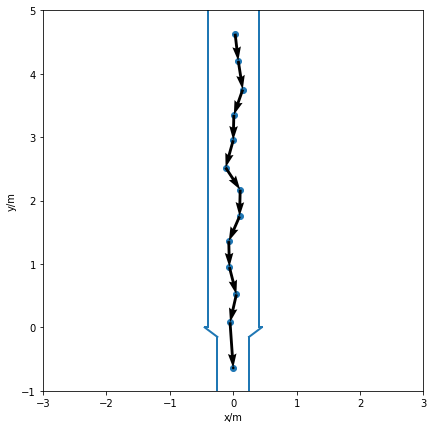

counts_mean =  0.02054054054054054
<calculating b = 0.9>


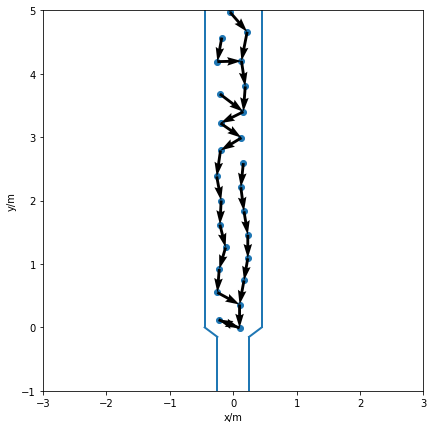

counts_mean =  0.024444444444444446
<calculating b = 1.0>


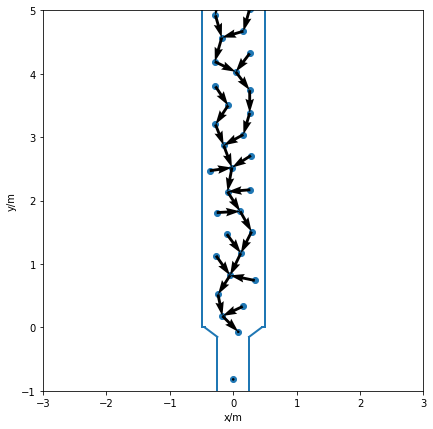

counts_mean =  0.027058823529411767
<calculating b = 1.1>


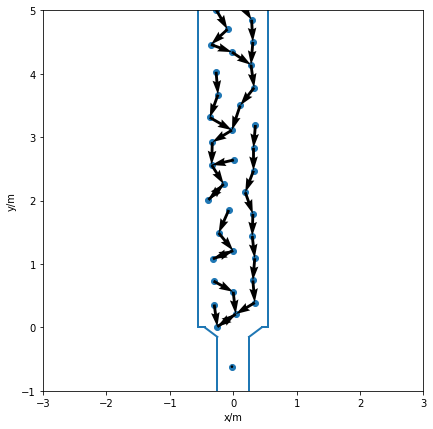

counts_mean =  0.025
<calculating b = 1.2>


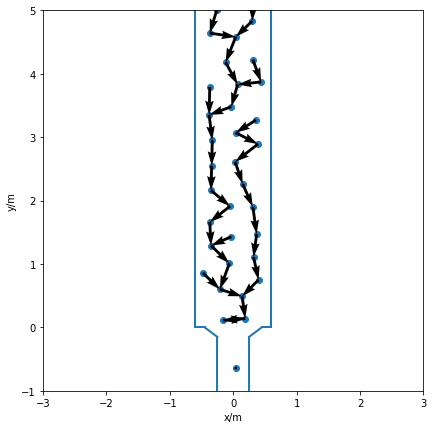

counts_mean =  0.02484848484848485
<calculating b = 1.3>


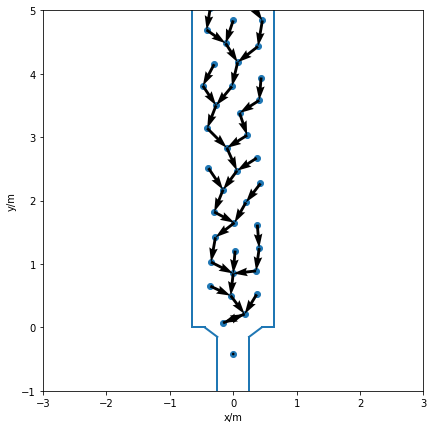

counts_mean =  0.028666666666666667
<calculating b = 1.4>


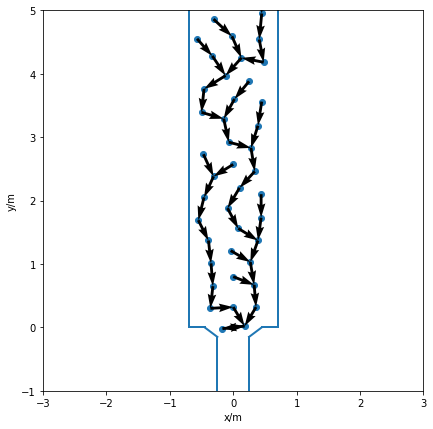

counts_mean =  0.025714285714285717
<calculating b = 1.5>


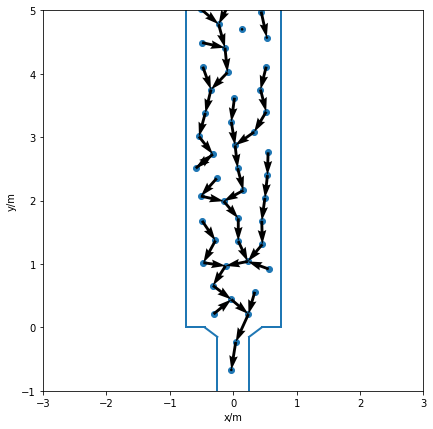

counts_mean =  0.027058823529411767
<calculating b = 1.6>


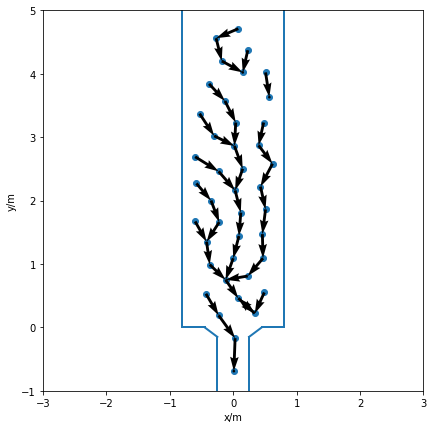

counts_mean =  0.025625
<calculating b = 1.7>


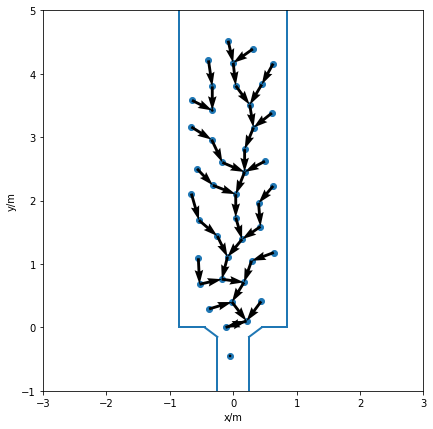

counts_mean =  0.03
<calculating b = 1.8>


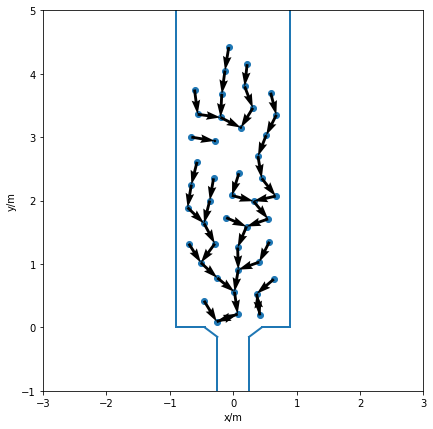

counts_mean =  0.02727272727272727
<calculating b = 1.9>


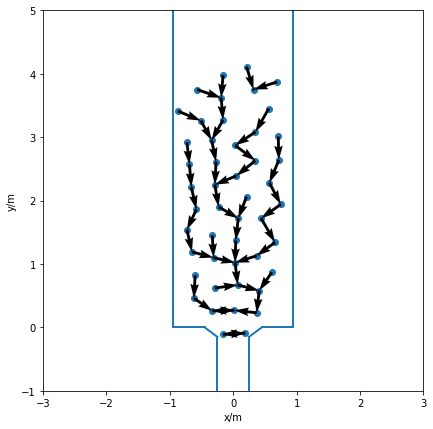

counts_mean =  0.026666666666666665
<calculating b = 2.0>


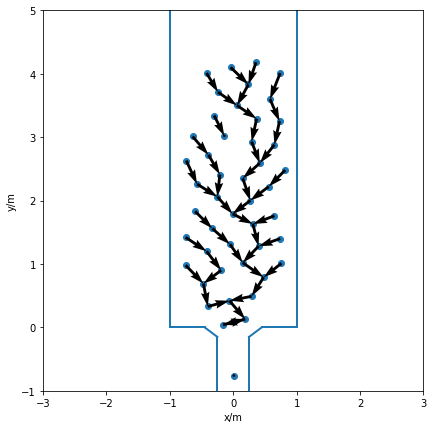

counts_mean =  0.02787878787878788
<calculating b = 2.1>


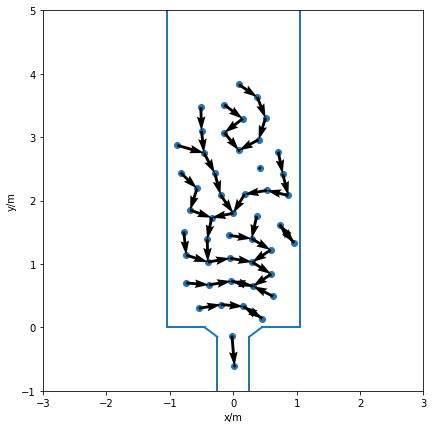

counts_mean =  0.026666666666666665
<calculating b = 2.2>


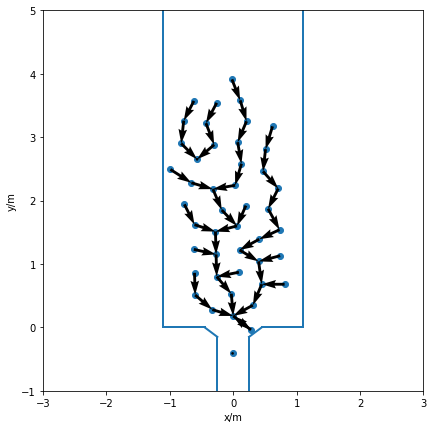

counts_mean =  0.026470588235294117
<calculating b = 2.3>


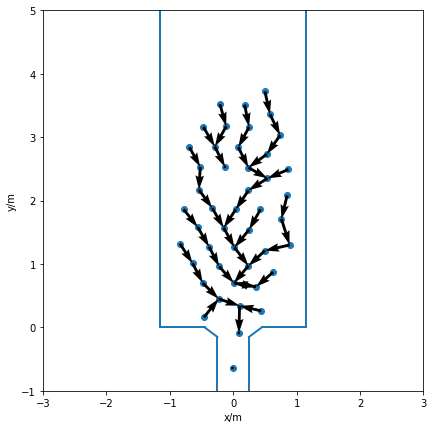

counts_mean =  0.026666666666666665
<calculating b = 2.4>


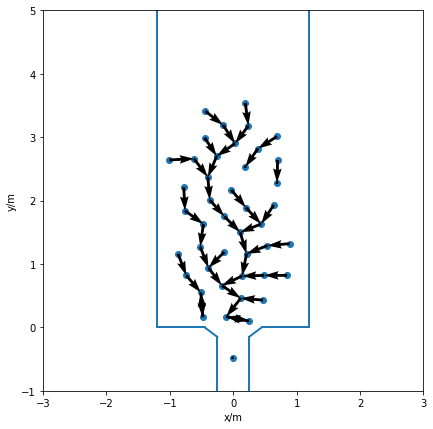

counts_mean =  0.028666666666666667
<calculating b = 2.5>


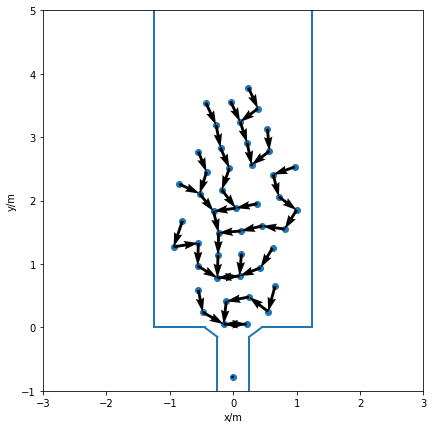

counts_mean =  0.027058823529411767
<calculating b = 2.6>


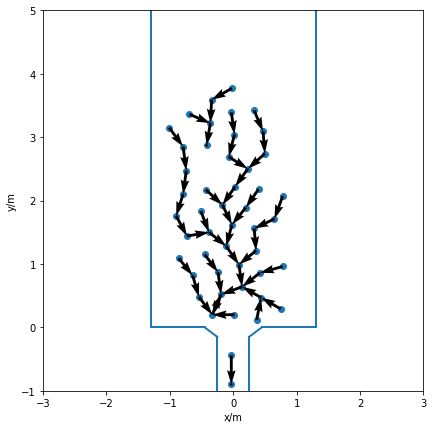

counts_mean =  0.028484848484848488
<calculating b = 2.7>


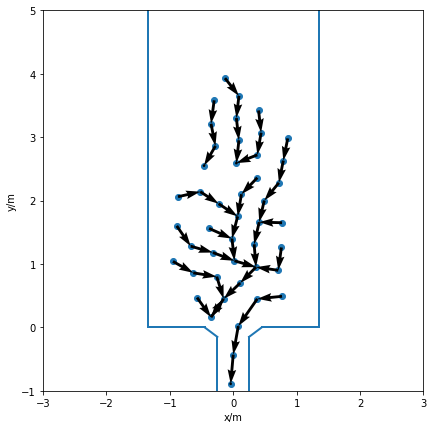

counts_mean =  0.026470588235294117
<calculating b = 2.8>


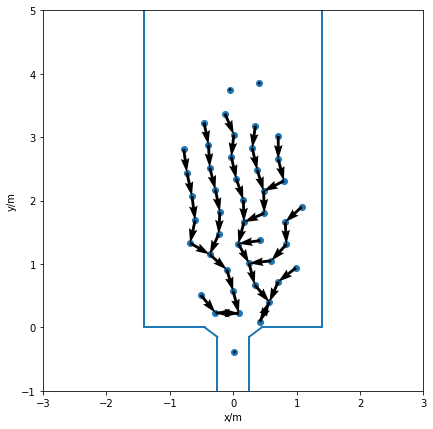

counts_mean =  0.025714285714285717
<calculating b = 2.9>


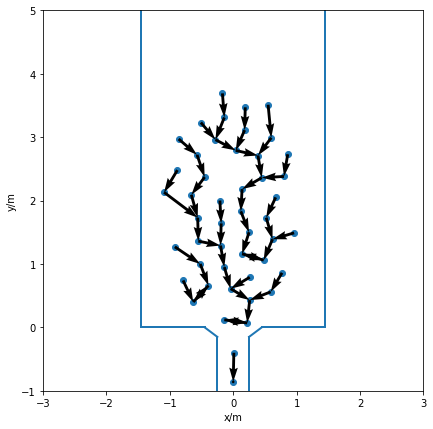

counts_mean =  0.028484848484848488
<calculating b = 3.0>


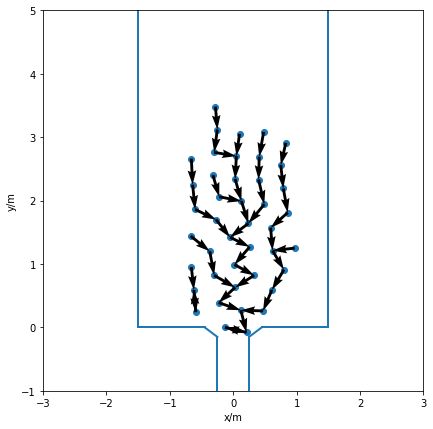

counts_mean =  0.02529411764705882
<calculating b = 3.1>


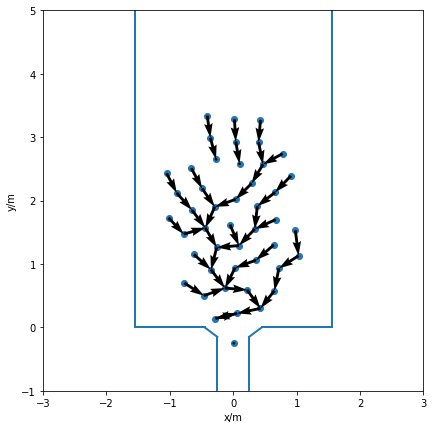

counts_mean =  0.028125
<calculating b = 3.2>


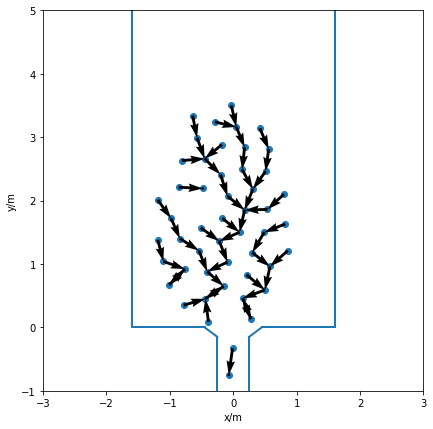

counts_mean =  0.029696969696969697
<calculating b = 3.3>


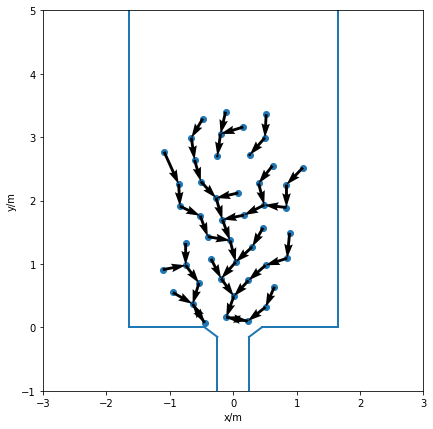

counts_mean =  0.02823529411764706
<calculating b = 3.4>


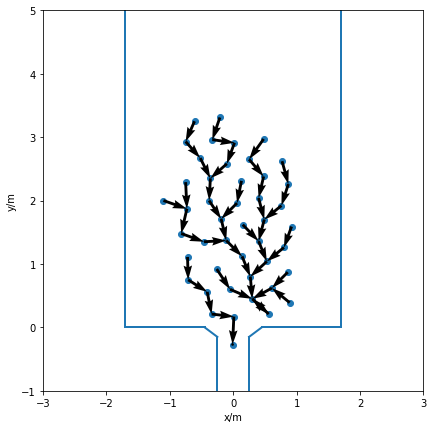

counts_mean =  0.02727272727272727
<calculating b = 3.5>


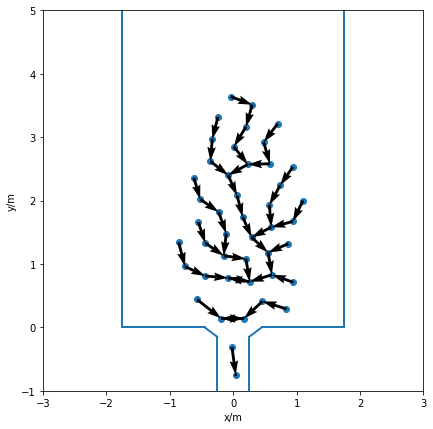

counts_mean =  0.0275
<calculating b = 3.6>


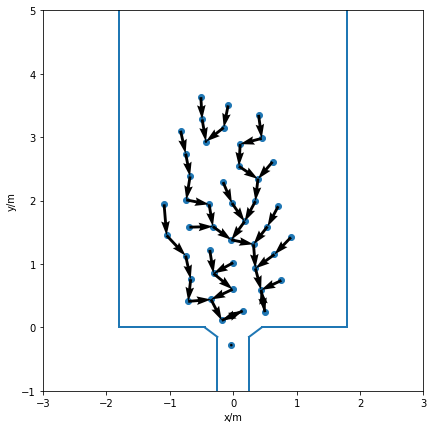

counts_mean =  0.0275
<calculating b = 3.7>


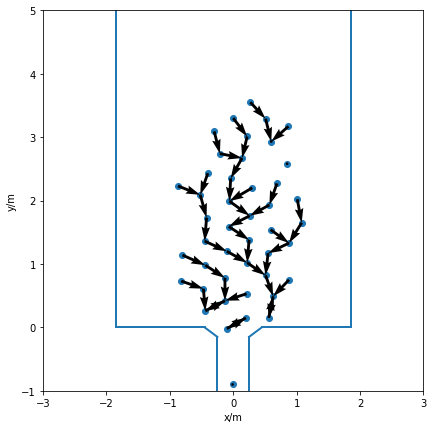

counts_mean =  0.029333333333333333
<calculating b = 3.8>


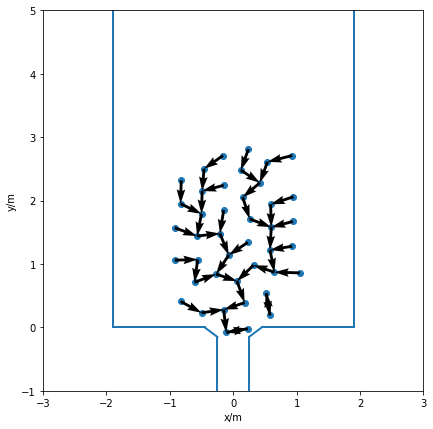

counts_mean =  0.03
<calculating b = 3.9>


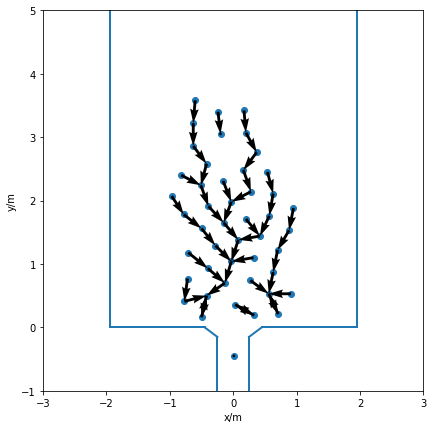

counts_mean =  0.02764705882352941
<calculating b = 4.0>


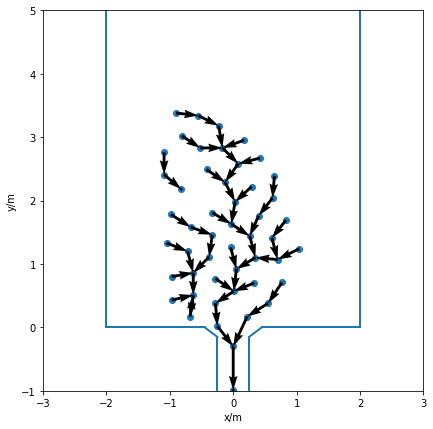

counts_mean =  0.030625
<calculating b = 4.1>


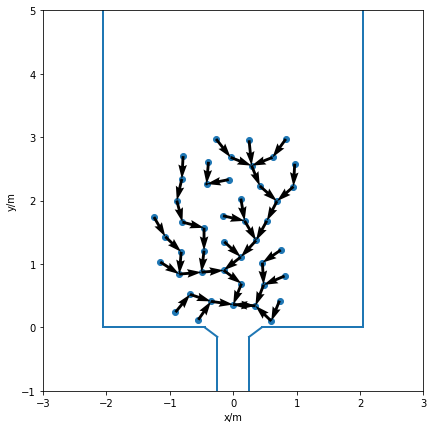

counts_mean =  0.03066666666666667
<calculating b = 4.2>


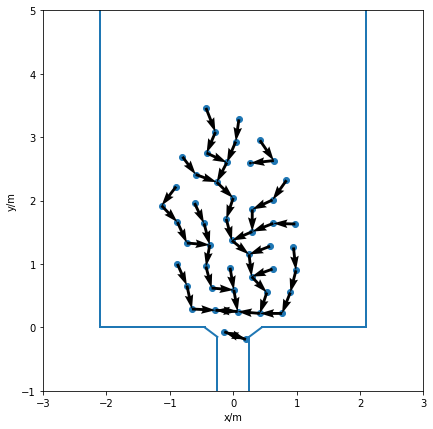

counts_mean =  0.026486486486486487
<calculating b = 4.3>


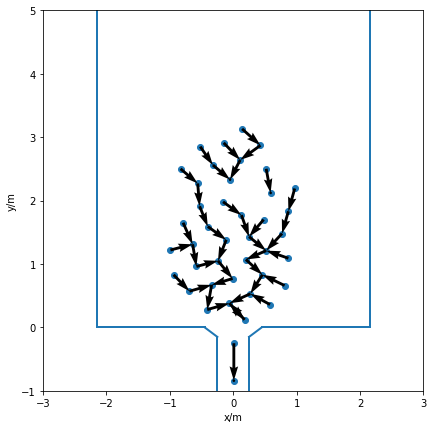

counts_mean =  0.029285714285714283
<calculating b = 4.4>


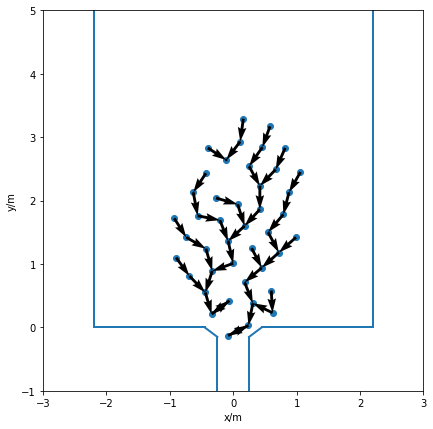

counts_mean =  0.026875
<calculating b = 4.5>


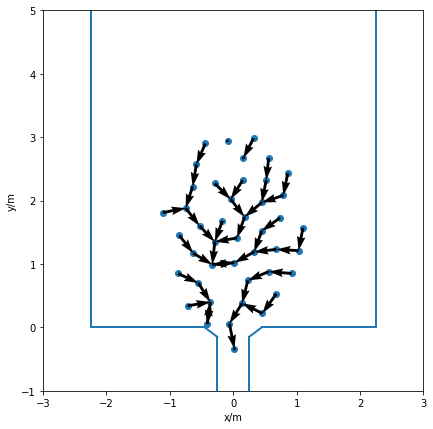

counts_mean =  0.029655172413793104
<calculating b = 4.6>


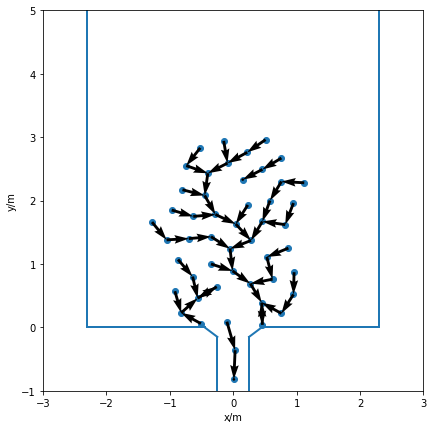

counts_mean =  0.028823529411764706
<calculating b = 4.7>


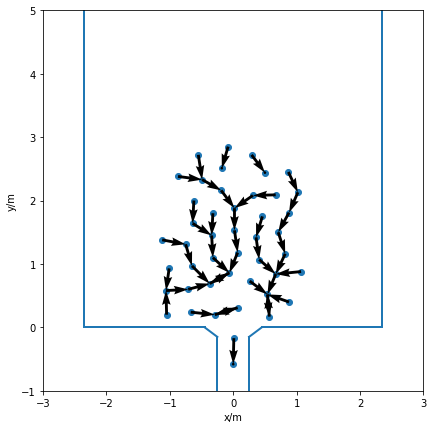

counts_mean =  0.03
<calculating b = 4.8>


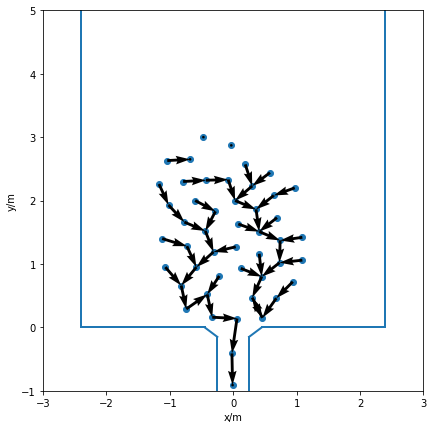

counts_mean =  0.032413793103448274
<calculating b = 4.9>


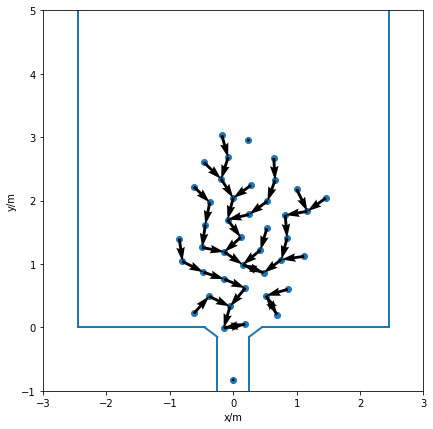

counts_mean =  0.027999999999999997
<calculating b = 5.0>


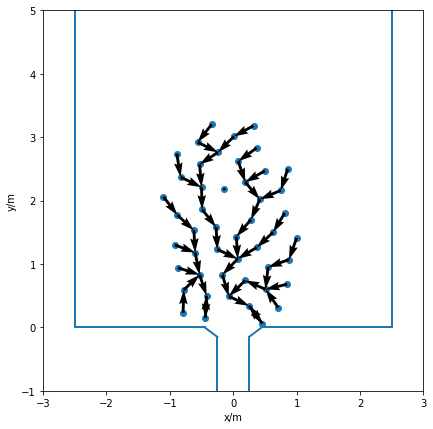

counts_mean =  0.02823529411764706
<calculating b = 5.1>


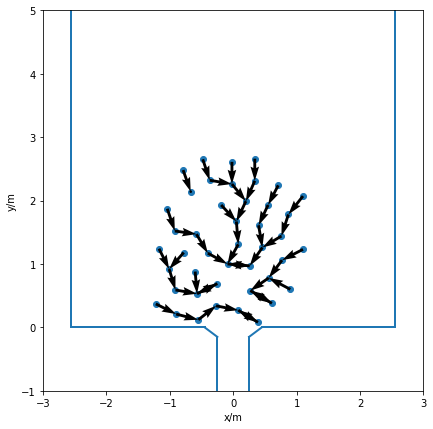

counts_mean =  0.02838709677419355
<calculating b = 5.2>


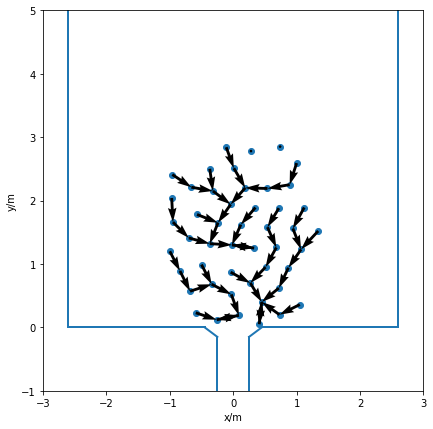

counts_mean =  0.03
<calculating b = 5.3>


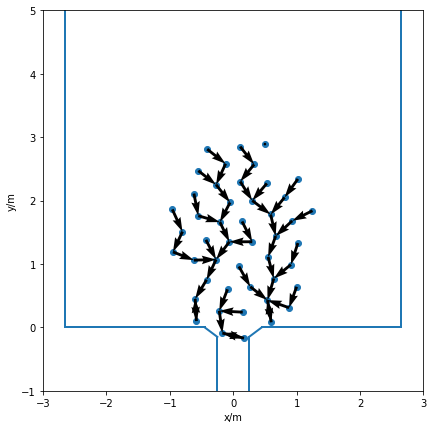

counts_mean =  0.029375
<calculating b = 5.4>


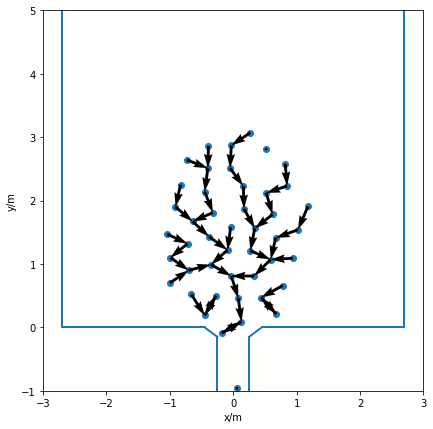

counts_mean =  0.02727272727272727
<calculating b = 5.5>


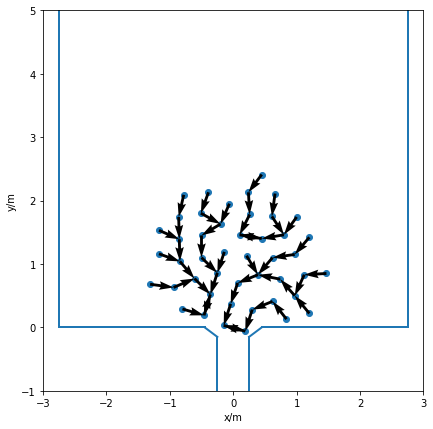

counts_mean =  0.03066666666666667
<calculating b = 5.6>


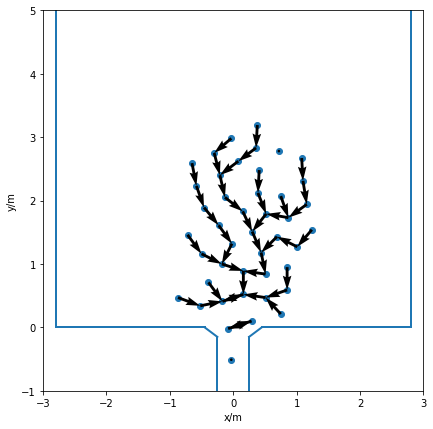

counts_mean =  0.02774193548387097
<calculating b = 5.7>


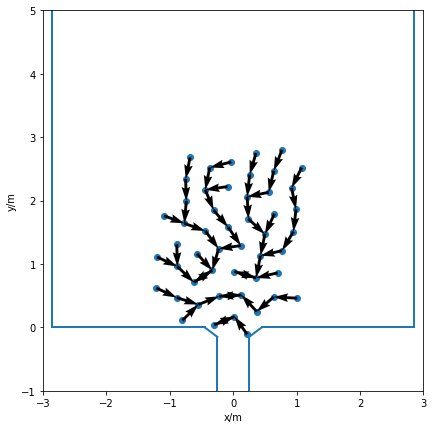

counts_mean =  0.029411764705882356
<calculating b = 5.8>


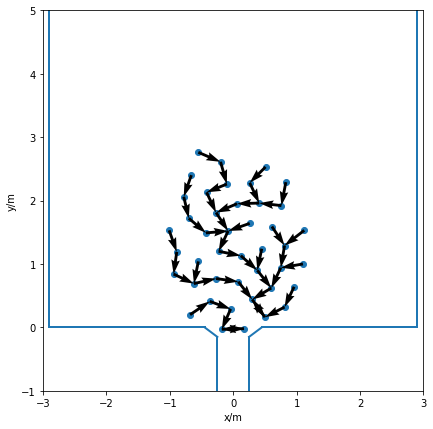

counts_mean =  0.028666666666666667
<calculating b = 5.9>


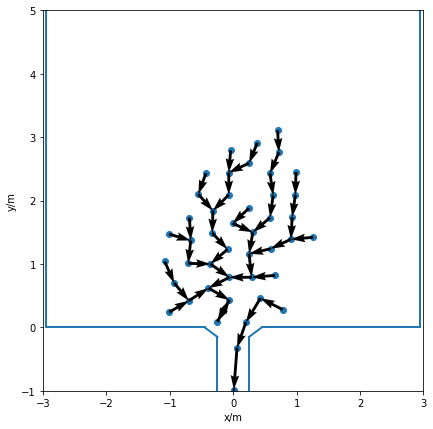

counts_mean =  0.0275
<calculating b = 6.0>


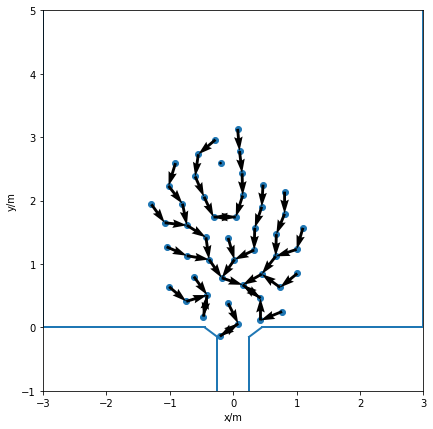

counts_mean =  0.027999999999999997
<calculating b = 6.1>


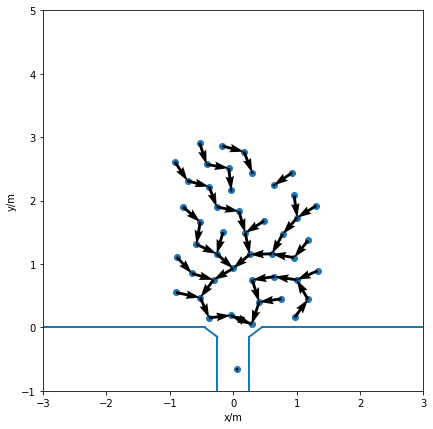

counts_mean =  0.02875
<calculating b = 6.2>


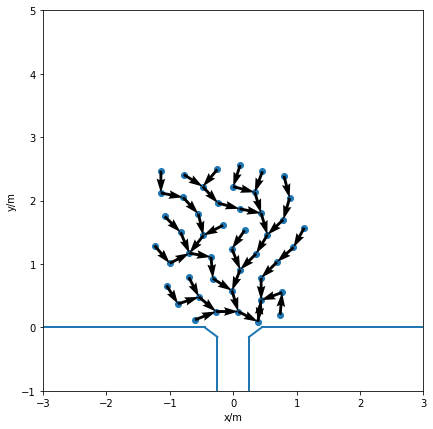

counts_mean =  0.029375
<calculating b = 6.3>


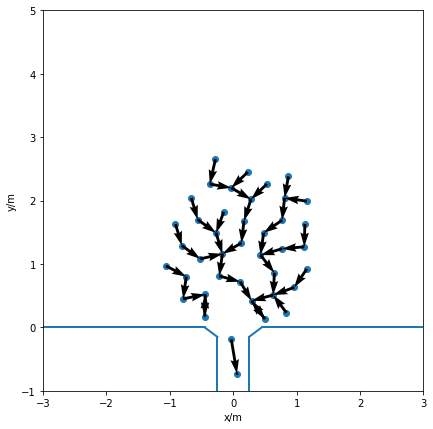

counts_mean =  0.02857142857142857
<calculating b = 6.4>


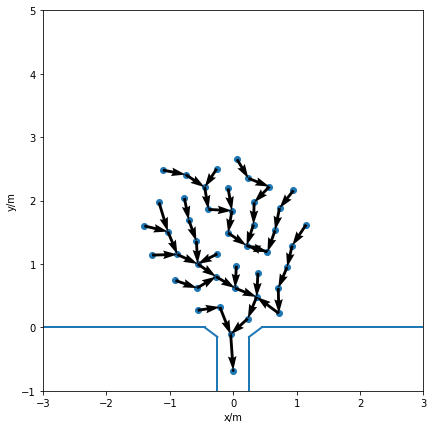

counts_mean =  0.029333333333333333
<calculating b = 6.5>


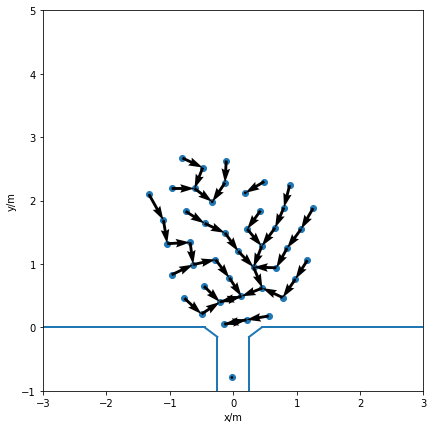

counts_mean =  0.02838709677419355
<calculating b = 6.6>


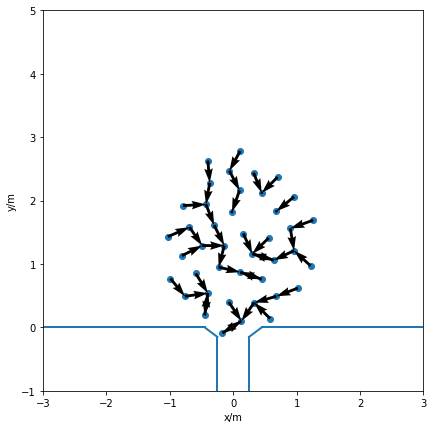

counts_mean =  0.03230769230769231
<calculating b = 6.7>


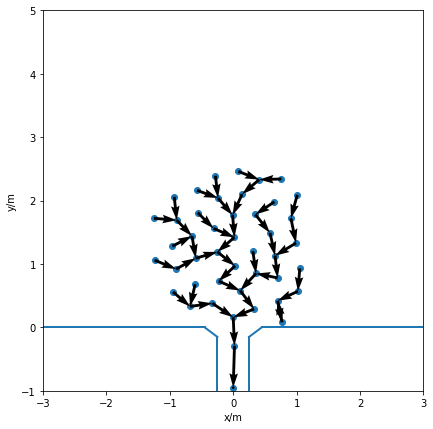

counts_mean =  0.029333333333333333
<calculating b = 6.8>


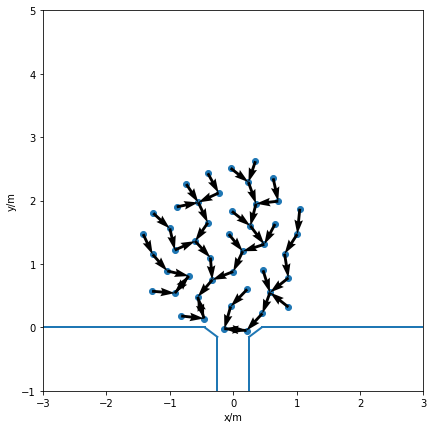

counts_mean =  0.031724137931034485
<calculating b = 6.9>


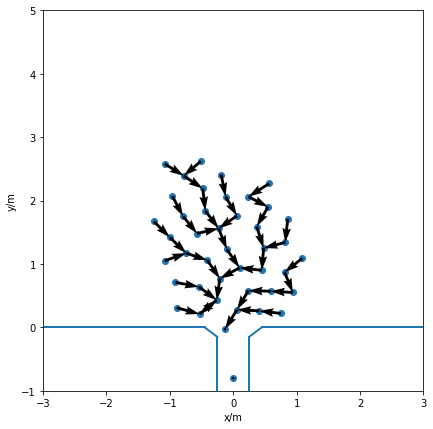

counts_mean =  0.027333333333333334
<calculating b = 7.0>


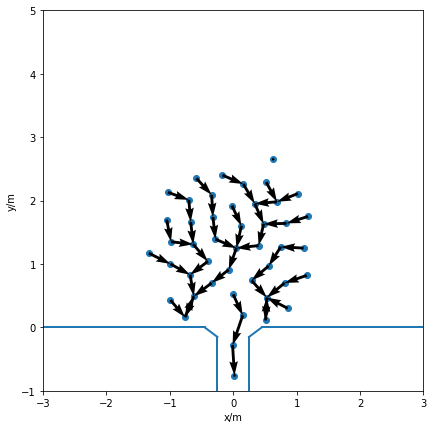

counts_mean =  0.028125
<calculating b = 0.8>


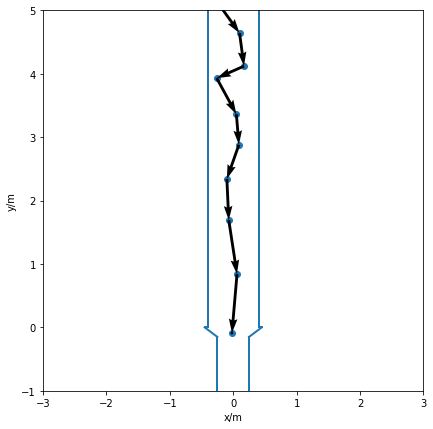

counts_mean =  0.021951219512195124
<calculating b = 0.9>


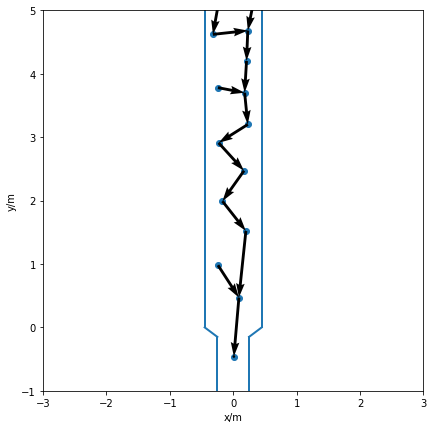

counts_mean =  0.024324324324324326
<calculating b = 1.0>


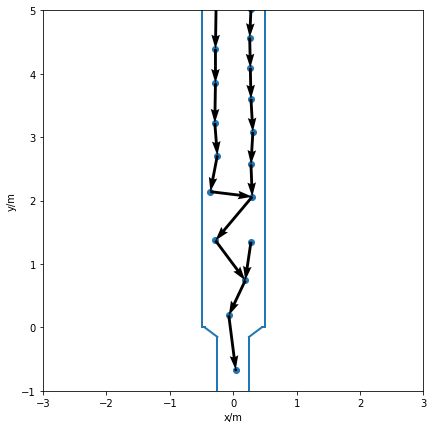

counts_mean =  0.026470588235294117
<calculating b = 1.1>


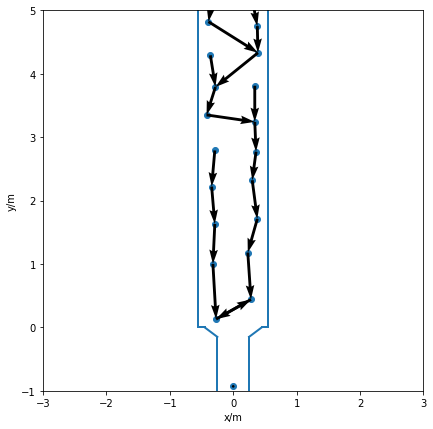

counts_mean =  0.024864864864864864
<calculating b = 1.2>


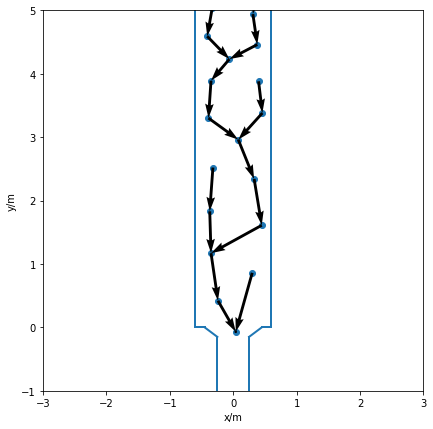

counts_mean =  0.02388888888888889
<calculating b = 1.3>


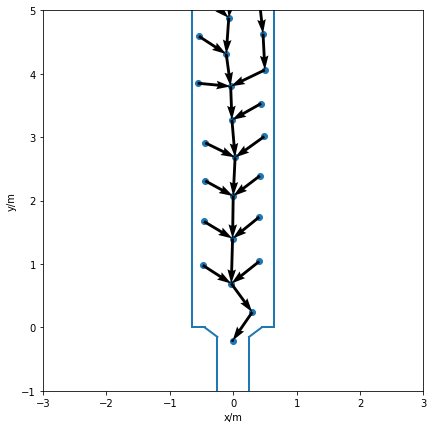

counts_mean =  0.03461538461538462
<calculating b = 1.4>


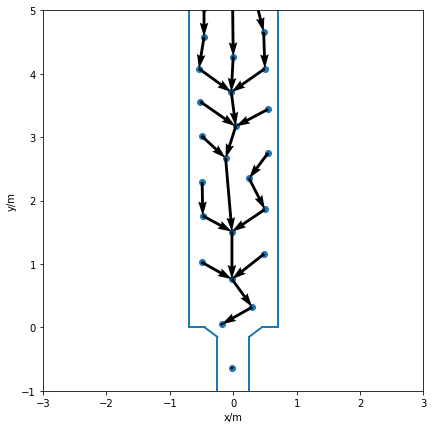

counts_mean =  0.03142857142857143
<calculating b = 1.5>


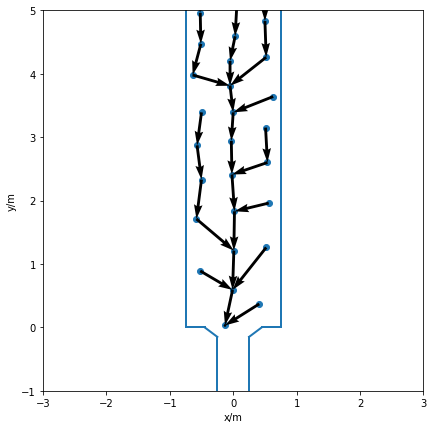

counts_mean =  0.02606060606060606
<calculating b = 1.6>


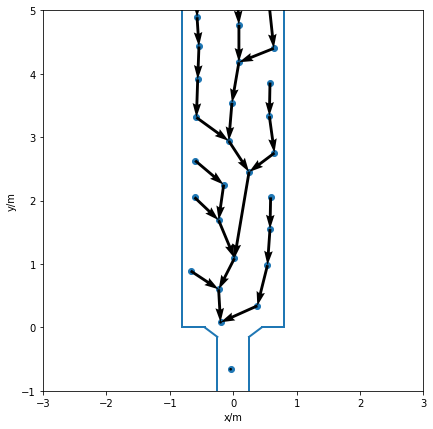

counts_mean =  0.026470588235294117
<calculating b = 1.7>


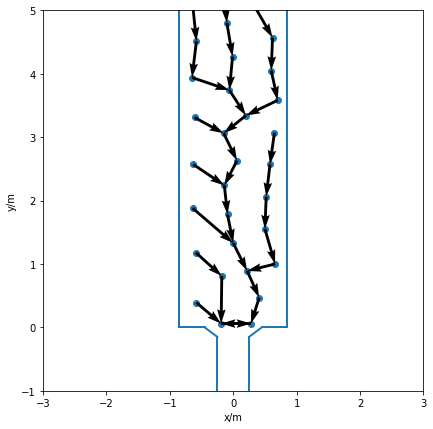

counts_mean =  0.02764705882352941
<calculating b = 1.8>


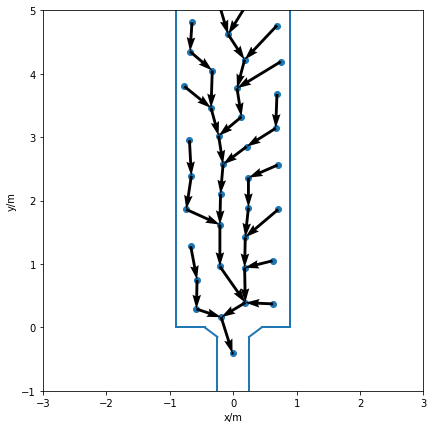

counts_mean =  0.02787878787878788
<calculating b = 1.9>


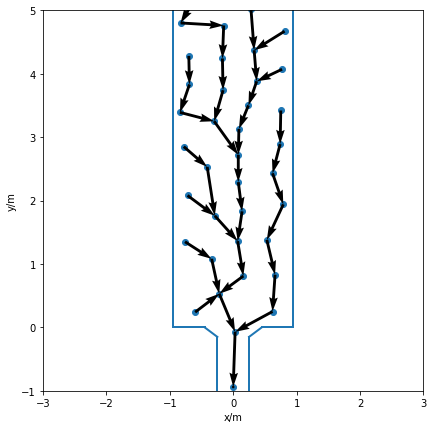

counts_mean =  0.025714285714285717
<calculating b = 2.0>


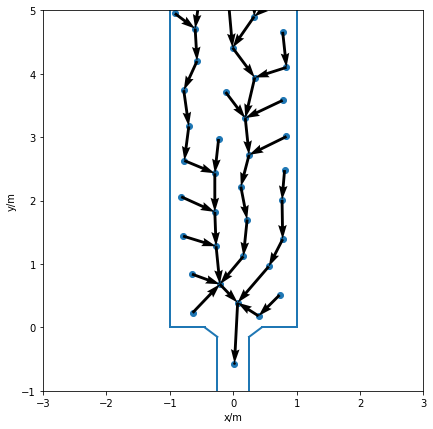

counts_mean =  0.03066666666666667
<calculating b = 2.1>


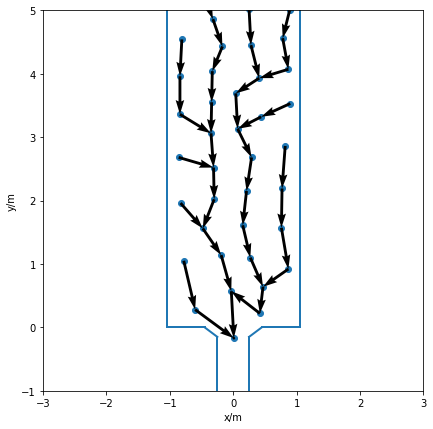

counts_mean =  0.026470588235294117
<calculating b = 2.2>


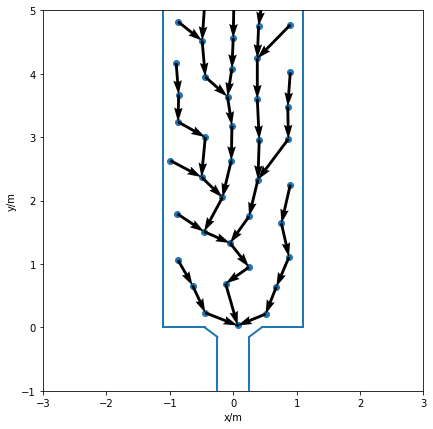

counts_mean =  0.026470588235294117
<calculating b = 2.3>


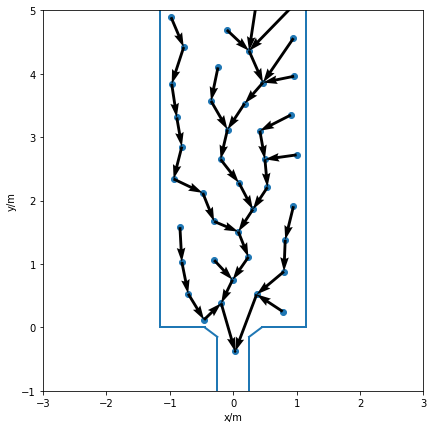

counts_mean =  0.02764705882352941
<calculating b = 2.4>


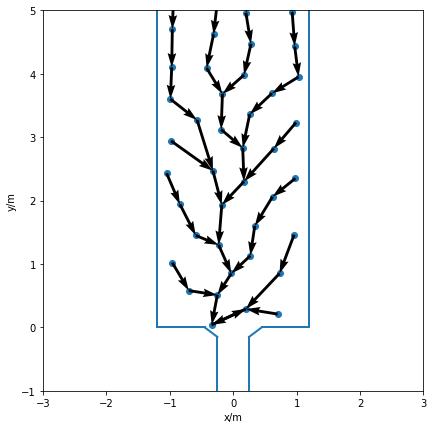

counts_mean =  0.026285714285714287
<calculating b = 2.5>


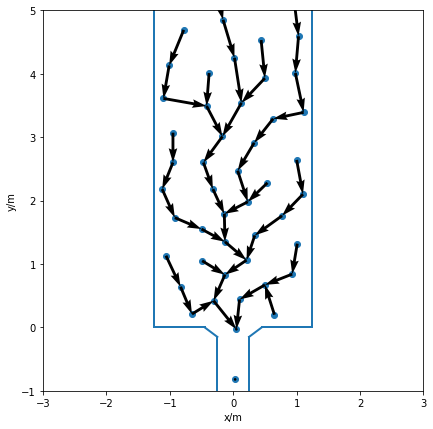

counts_mean =  0.026285714285714287
<calculating b = 2.6>


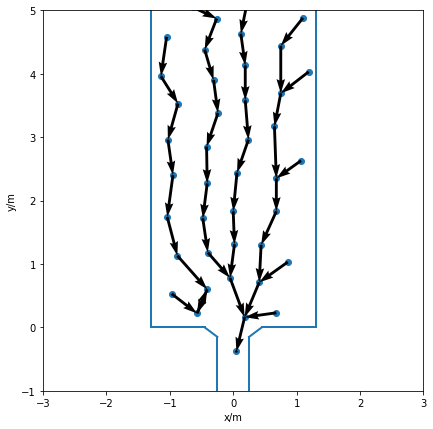

counts_mean =  0.025405405405405403
<calculating b = 2.7>


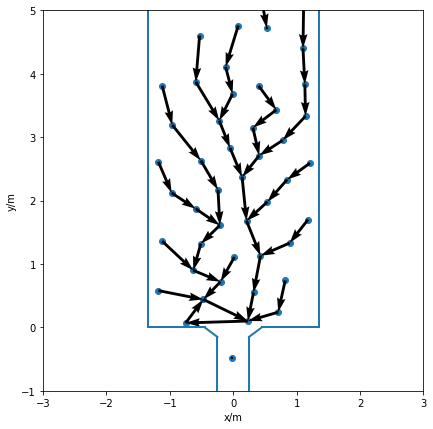

counts_mean =  0.027058823529411767
<calculating b = 2.8>


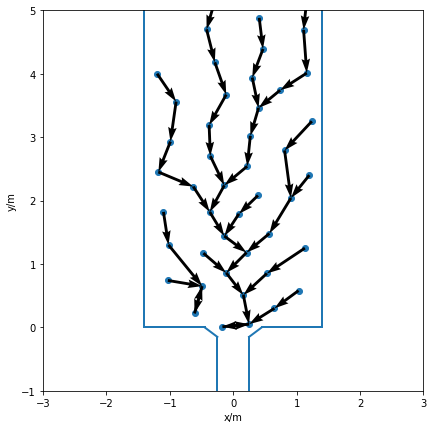

counts_mean =  0.027058823529411767
<calculating b = 2.9>


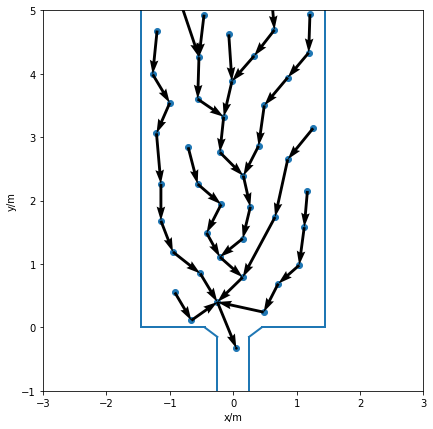

counts_mean =  0.024864864864864864
<calculating b = 3.0>


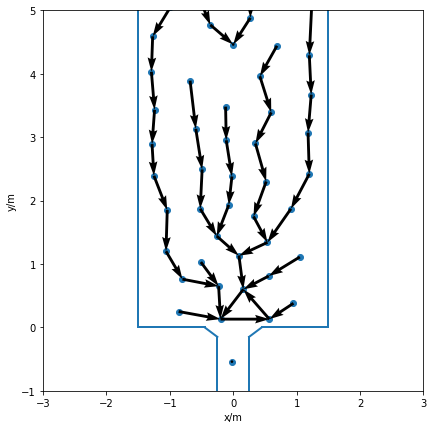

counts_mean =  0.025555555555555554
<calculating b = 3.1>


KeyboardInterrupt: 

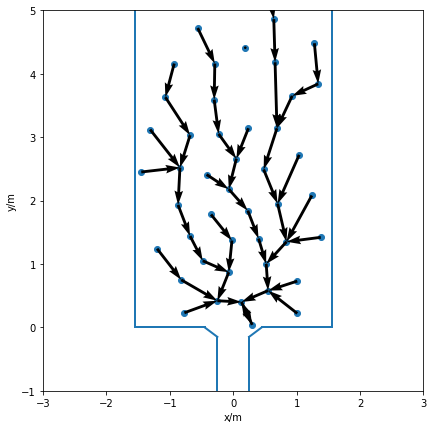

In [14]:
N_del = 10
col = ["FR","X","Y","ID","IntID"]
time_cluster_T = []
os.system("mkdir " + path + "plots")
os.system("mkdir " + path + "plots/graph")
os.system("mkdir " + path + "graph")
time = np.arange(10 * fps ,10 * fps + 1 ,fps)
print(time)
np_cluster_array = np.empty([len(T_test_list),lin_var[test_var].shape[0],N_runs,time.shape[0]])
print(np_cluster_array.shape)

for T_test, T_i in zip(T_test_list, range(len(T_test_list))):
    folder_frame_frac = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['ini_folder'])
    b_folder = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['b'])
    loc_list = [[path + folder + sl + "new_evac_traj_" + af.b_data_name(2 * bi, 3) + "_" + str(i) + ".txt" for i in
                 range(runs_tested)] for folder, bi in zip(folder_frame_frac, b_folder)]
    bi = 0
    #count_list = []
    #time_cluster = []
    for loc_list_runs, var_i in zip(loc_list,range(len(loc_list))):
        print("<calculating " + test_str + " = " + str(2 * lin_var[test_var][bi]) + ">")
        p0count = 0
        count = 0
        incount = 0
        count_mean = 0
        n_count = 50 * time.shape[0]
        #node_time = []
        for loc, l_i in zip(loc_list_runs[0:1], range(len(loc_list_runs))):
            if os.path.isfile(loc) == False:
                #print("WARNING: file " + loc + " not found.")
                continue
                
            if os.stat(loc).st_size == 0:
                #print("WARNING: file " + loc + " not found.")
                continue
            df = pd.read_csv(loc, sep="\s+", header=0, comment="#",skipinitialspace=True, usecols=col)
            #n_min_frame = df.groupby('ID')['FR'].min()[df['ID']].nsmallest(N_del_i).index.values
            n_max_frame = df.groupby('ID')['FR'].max()[df['ID']].nlargest(N_del).index.values
            #df = df[~df['ID'].isin(n_min_frame)]

            df = df[~df['ID'].isin(n_max_frame)]
            #df = df[df['Y'] > 0]
            #df = df[df['X'] * df['X'] + df['Y']* df['Y'] < 1.**2]
            #framemax = df["FR"].max()
            #print(ids)
            #print(df_fr)
            #print(df["FR"].min(),df["FR"].max())
            #node_time_i = []
            for t, t_i in zip(time,range(time.shape[0])):
                xpos = []
                ypos = []
                u = []
                v = []
                df_t = df[df["FR"] == t]
                #print(df_t)
                id_list = df_t["ID"].values
                int_list = df_t[df_t["IntID"]> 0]["IntID"].values
                unique, counts = np.unique(int_list, return_counts=True)
                #print(counts.mean())
                count_mean += counts.mean()
                #node_time_i.append(counts.mean())
                np_cluster_array[T_i][var_i][l_i][t_i] = counts.mean()
                #print(id_list)
                for i in id_list:
                    df_id = df_t[df_t["ID"] == i]
                    x1 = df_id["X"].values[0]
                    x2 = df_id["Y"].values[0]
                    inter = df_id["IntID"].values[0]
                    #print(inter)
                    xpos.append([x1])
                    ypos.append([x2])
                    if inter > 0:
                        #print(inter)
                        #print(np.isin(inter,id_list))
                        df_int = df_t[df_t["ID"] == inter] 
                        #print(df_int)
                        
                        if(df_int.values.shape[0] > 0):
                            x1int = df_int["X"].values[0]
                            x2int = df_int["Y"].values[0]
                            u.append(x1int - x1)
                            v.append(x2int - x2)
                        else:
                            u.append(0)
                            v.append(0)
                    else:
                        u.append(0)
                        v.append(0)
            
            fig, ax = plt.subplots(figsize = (12, 7))
            plt.scatter(xpos,ypos)
            ax.quiver(xpos, ypos, u, v,angles='xy', scale_units='xy',scale = 1)
            ax.set_aspect("equal")
            ax.axis([-3, 3, -1, 5])
            plt.xlabel("x/m")
            plt.ylabel("y/m")
            add_wall(2,2 * lin_var[test_var][bi])
            plt.savefig(path + 'plots/graph/graph_' + af.b_data_name(2 * lin_var[test_var][bi],3) + '.pdf')
            #show plot 
            plt.show() 
            #node_time.append(node_time_i)
        #np_time = np.array(node_time)
            
        #print(np_time.shape)
        #time_cluster.append(np_time.mean(axis=0))
        #plt.plot(time/fps,np_cluster_array[T_i][var_i].mean(axis=0),label = "b = " + str(2 * lin_var[test_var][bi]))
        bi += 1
            
        print("counts_mean = ", count_mean/n_count)
    
    #np.save(path + "cluster" + af.b_data_name(T_test,3) + ".npy", np_cluster_array)
    #count_list.append(count_mean/n_count)
    #time_cluster_T.append(time_cluster)
    #print(time_cluster_T.shape)
    #plt.legend()
    #plt.show()
    #plt.plot(2 * lin_var[test_var],count_list)
                    
                            

(0,)
[]


ValueError: x and y must be the same size

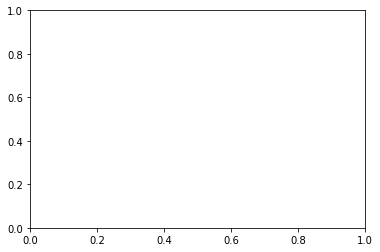

In [27]:
plt.show()
np_time_cluster = np.array(time_cluster_T)
print(np_time_cluster.shape)
#print(np_time_cluster)
max_clust = []
#print(np_time_cluster.shape)
#print(np_time_cluster)
for clust in np_time_cluster:
    #print(clust.shape)
    #print(clust)
    ##print(clust)
   # print("a")
    #print(clust.max())
    max_clust.append(clust.max())
print(max_clust)
plt.scatter(2 * lin_var[test_var],max_clust)
np_time_cluster.mean(axis = 1)[0].max()
#plt.plot(np_time_cluster.mean(axis = 1))

(1, 6, 1, 1441)
<calculating b = 1.2>
<calculating b = 1.2>


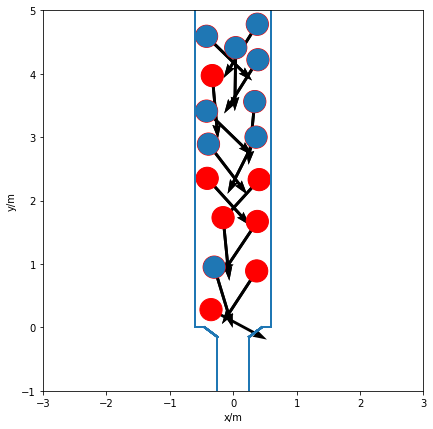

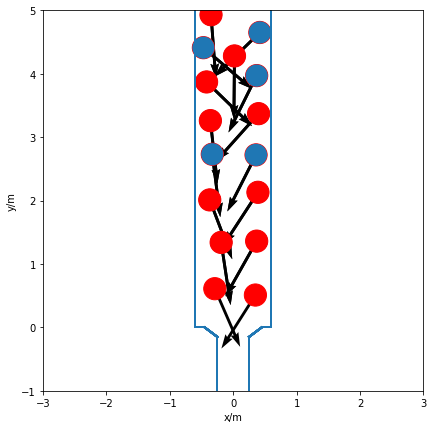

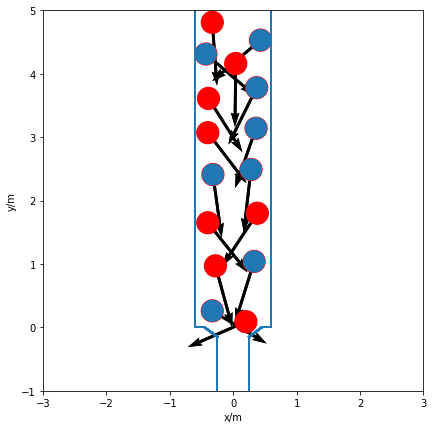

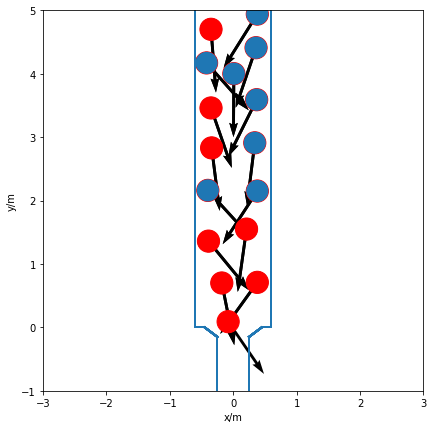

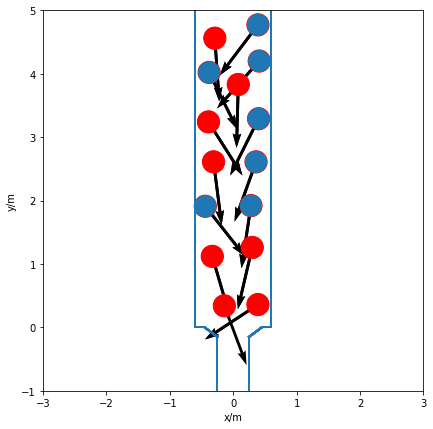

...

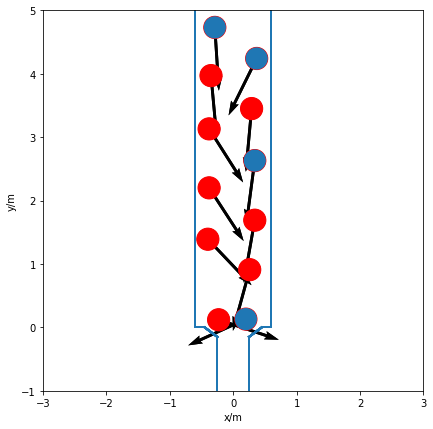

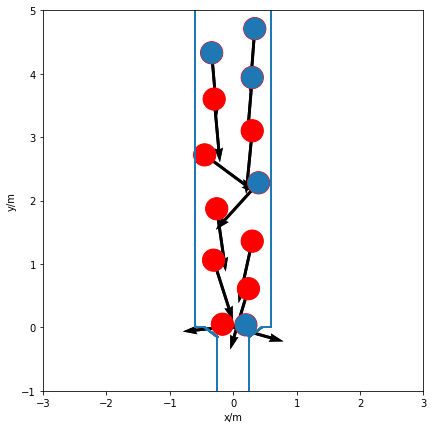

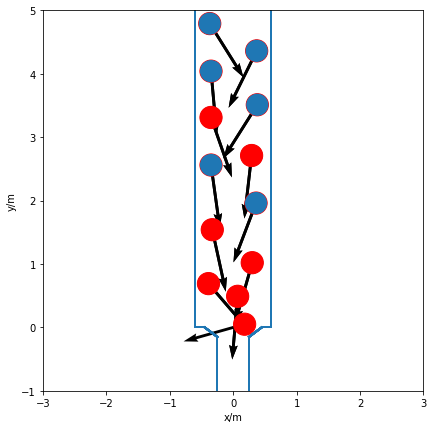

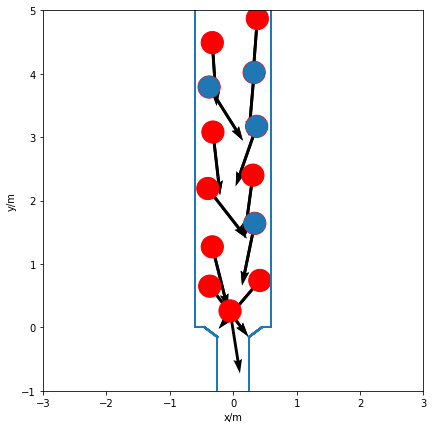

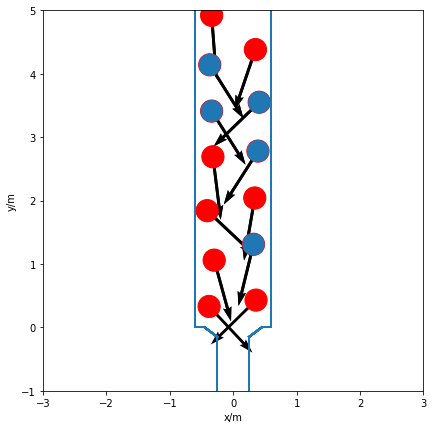

<calculating b = 2.3>


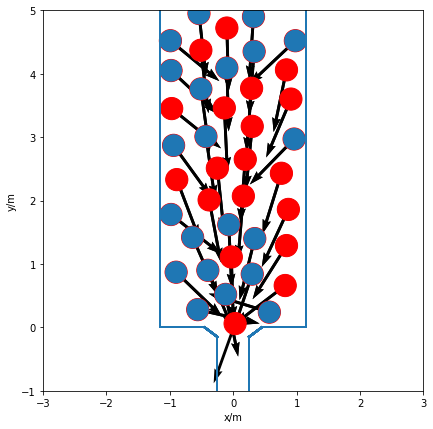

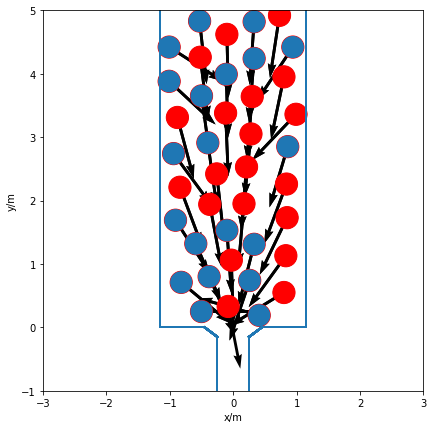

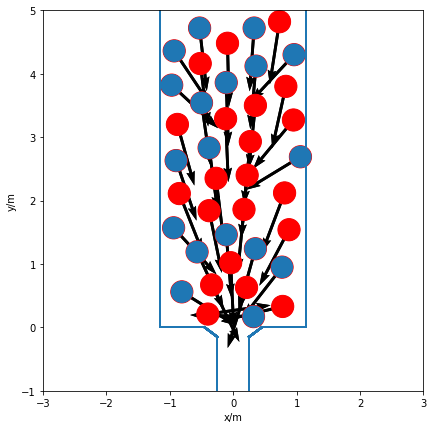

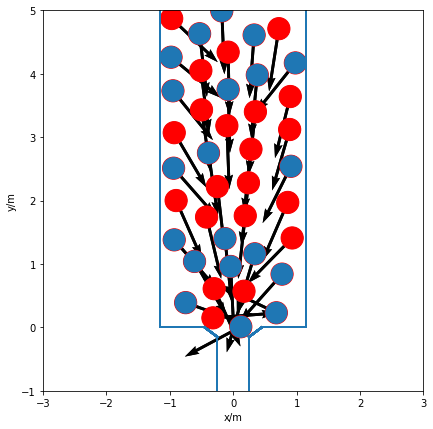

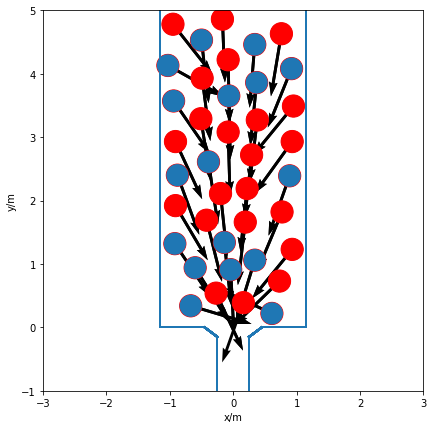

...

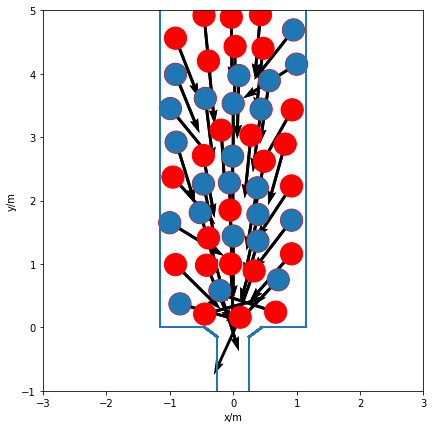

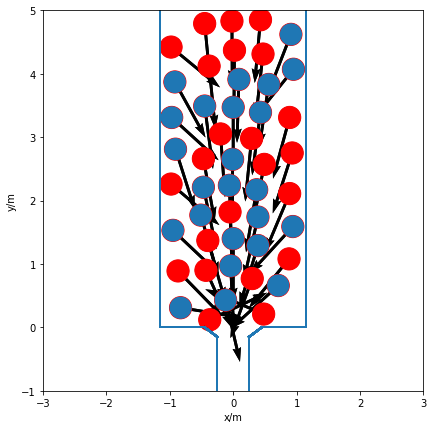

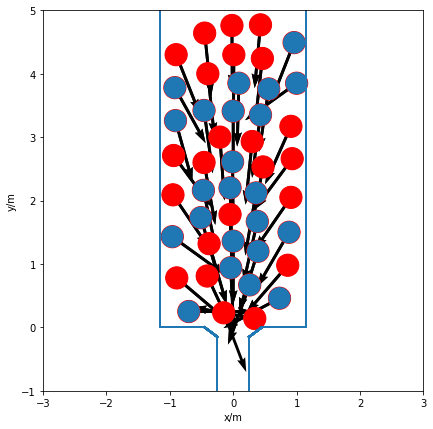

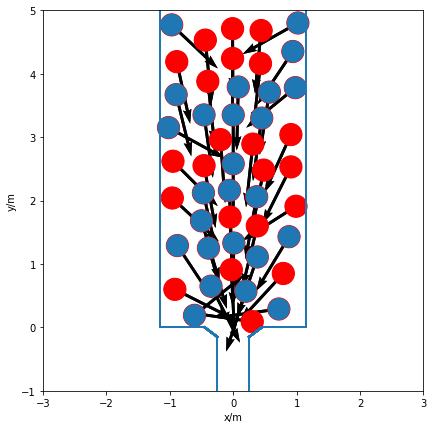

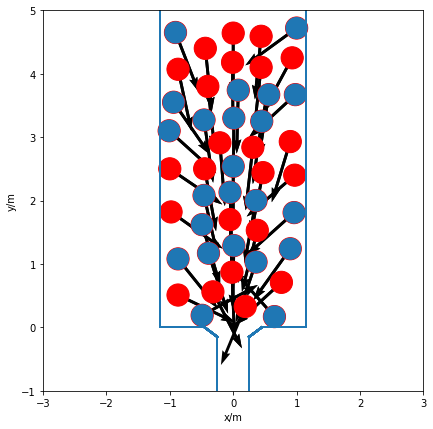

<calculating b = 3.4>


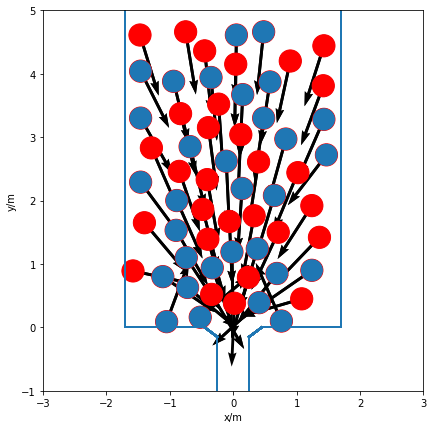

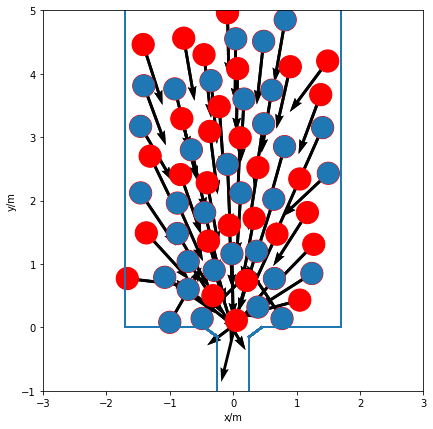

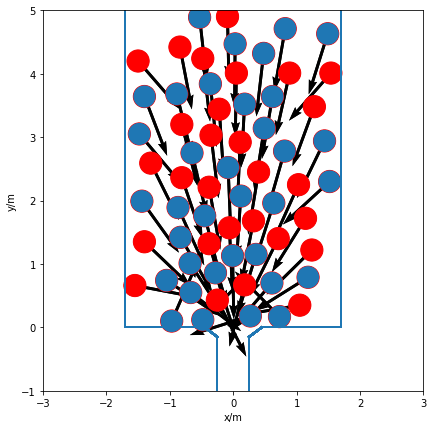

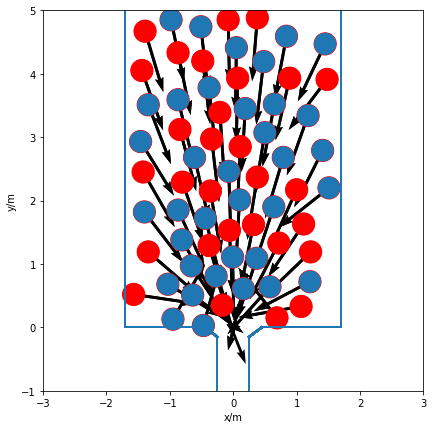

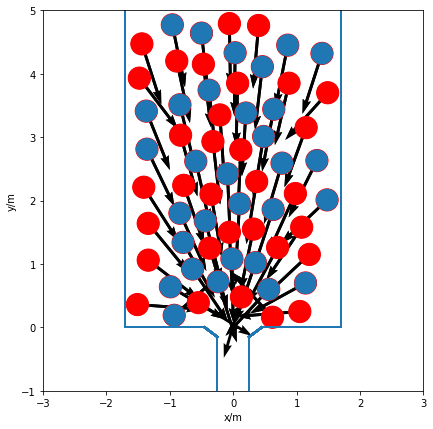

...

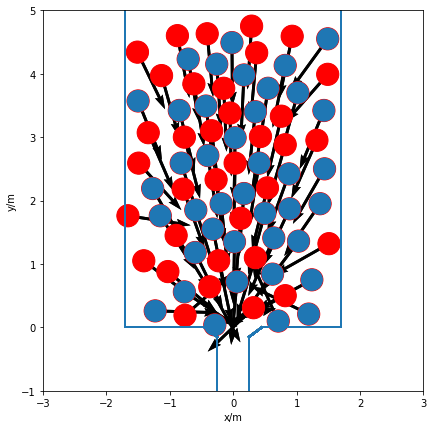

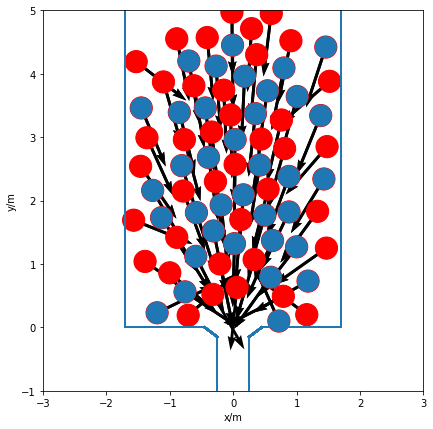

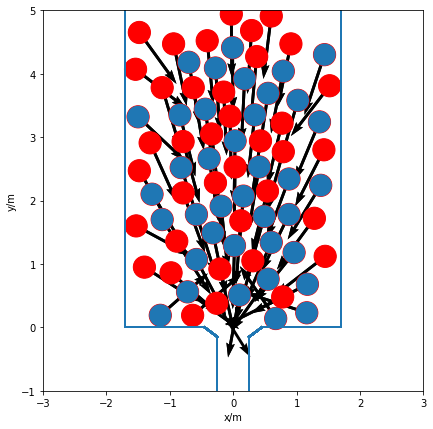

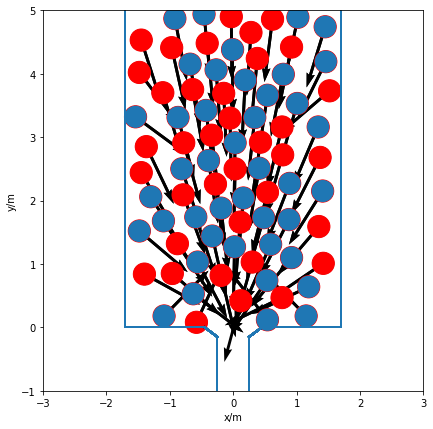

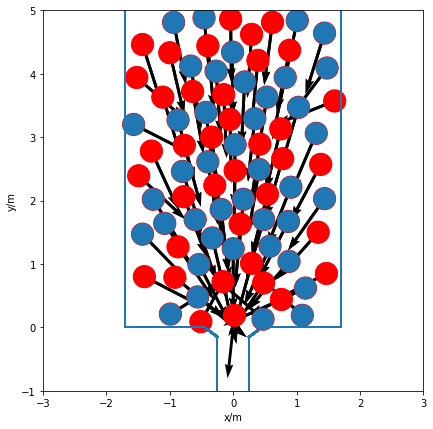

<calculating b = 4.5>


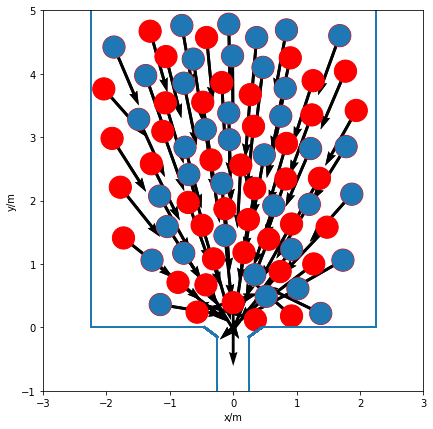

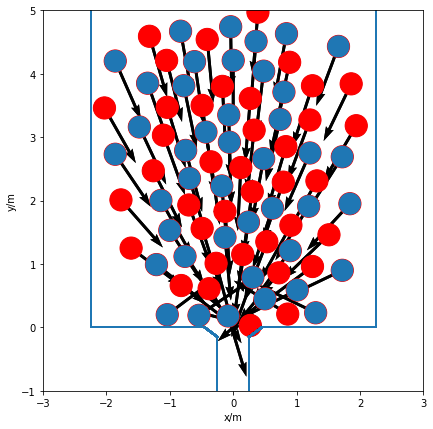

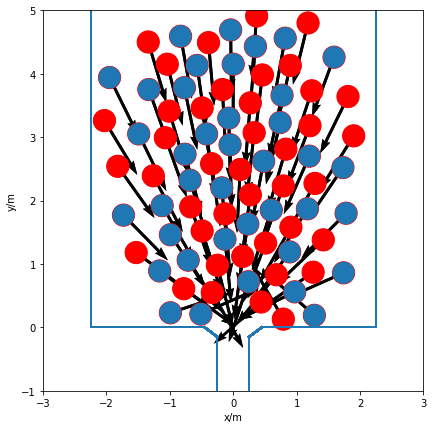

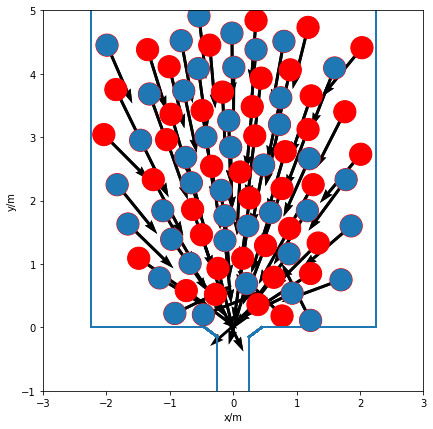

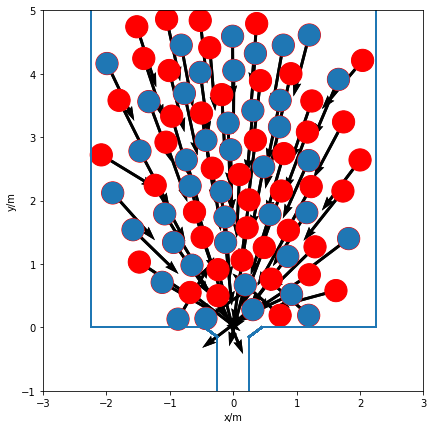

...

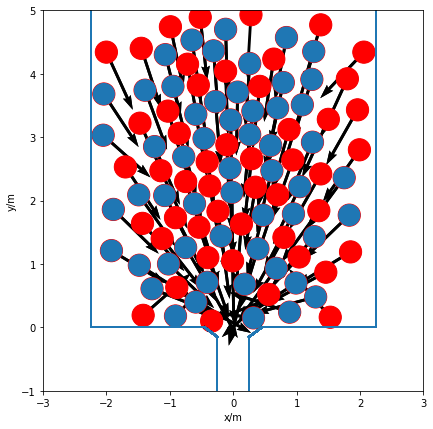

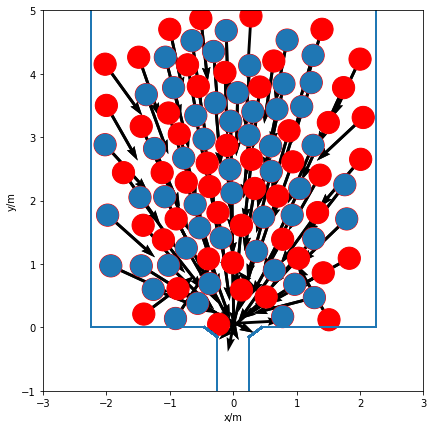

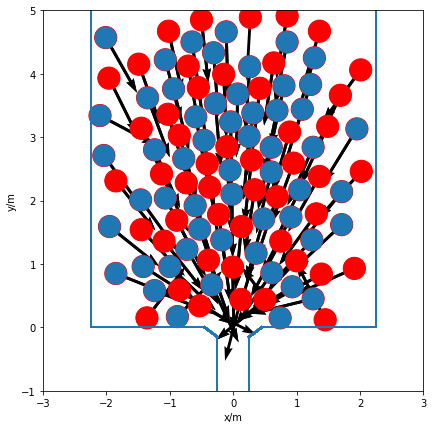

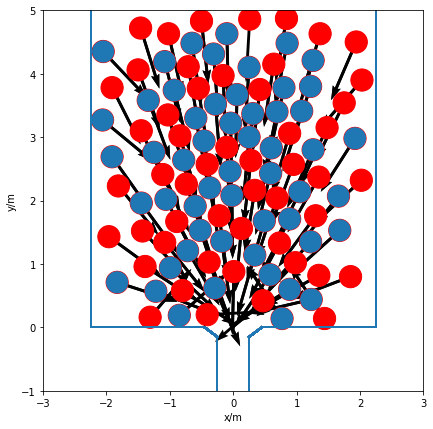

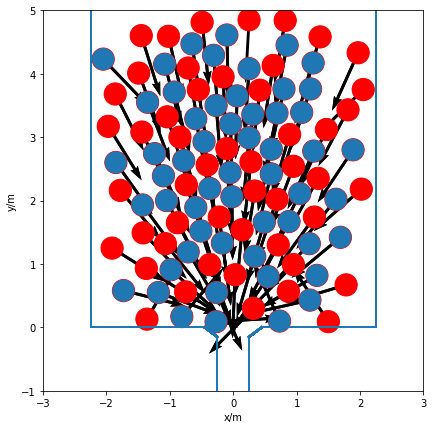

<calculating b = 5.6>


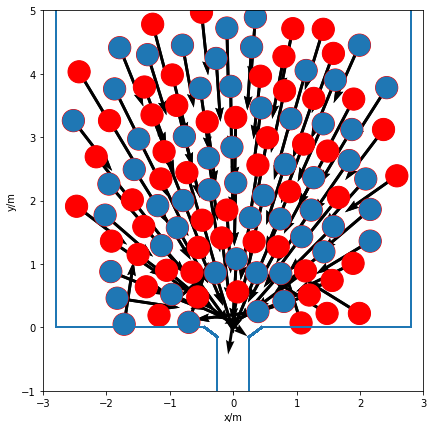

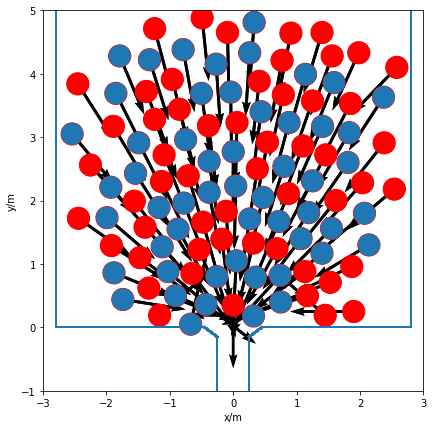

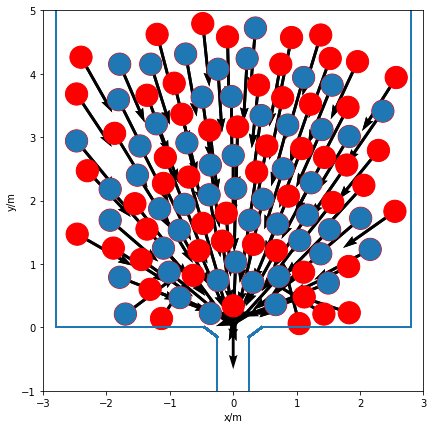

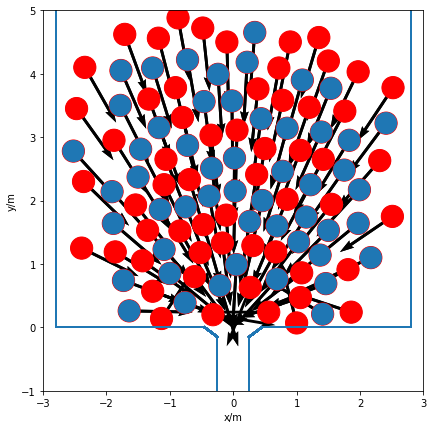

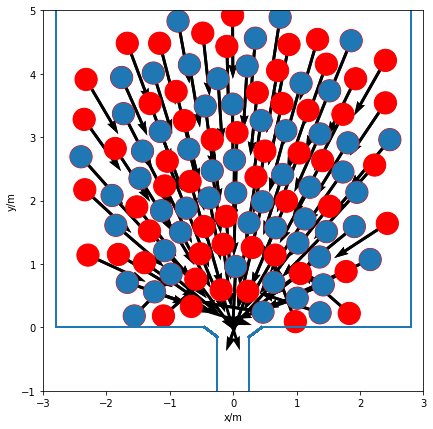

...

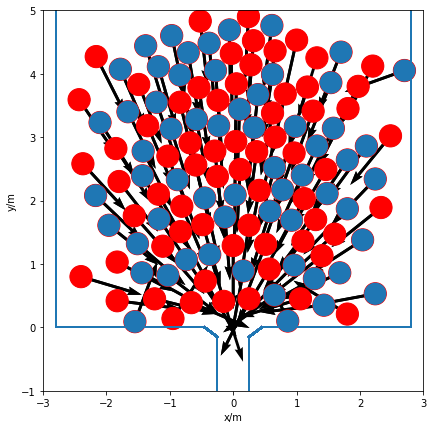

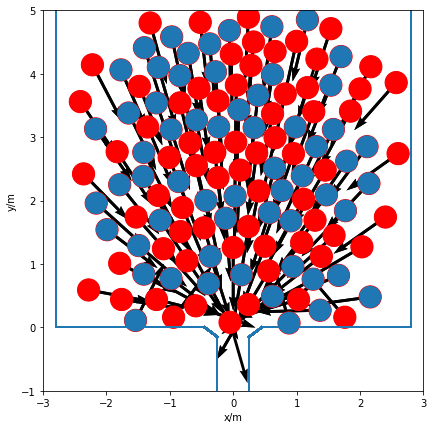

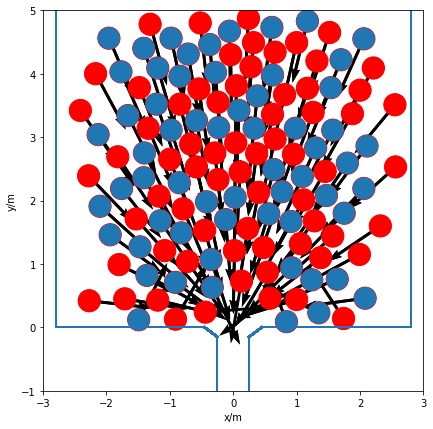

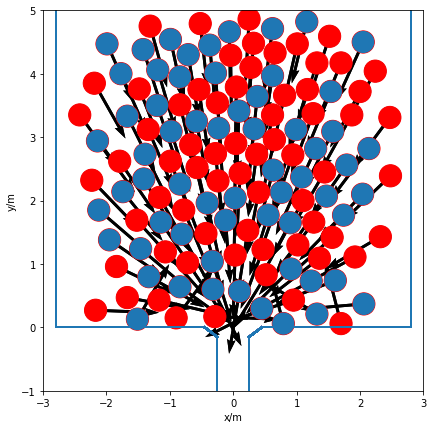

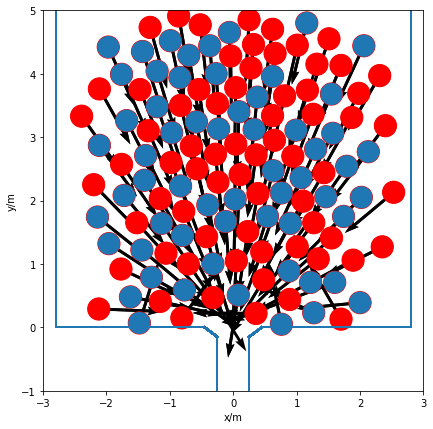

In [39]:
N_del = 10
import matplotlib as mpl

col = ["FR","X","Y","ID","IntID","AngleDirNn","ANGLE_int_nn"]
time_cluster_T = []

time = np.arange(10 * fps ,100 * fps + 1 ,1)

np_cluster_array = np.empty([len(T_test_list),lin_var[test_var].shape[0],N_runs,time.shape[0]])
print(np_cluster_array.shape)

for T_test, T_i in zip(T_test_list, range(len(T_test_list))):
    folder_frame_frac = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['ini_folder'])
    b_folder = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['b'])
    loc_list = [[path + folder + sl + "new_evac_traj_" + af.b_data_name(2 * bi, 3) + "_" + str(i) + ".txt" for i in
                 range(runs_tested)] for folder, bi in zip(folder_frame_frac, b_folder)]
    bi = 1
    #count_list = []
    #time_cluster = []
    for loc_list_runs, var_i in zip(loc_list,range(len(loc_list))):
        print("<calculating " + test_str + " = " + str(2 * lin_var[test_var][bi]) + ">")

        #node_time = []
        for loc, l_i in zip(loc_list_runs[0:1], range(len(loc_list_runs))):
            if os.path.isfile(loc) == False:
                #print("WARNING: file " + loc + " not found.")
                continue
                
            if os.stat(loc).st_size == 0:
                #print("WARNING: file " + loc + " not found.")
                continue
            df = pd.read_csv(loc, sep="\s+", header=0, comment="#",skipinitialspace=True, usecols=col)
            n_max_frame = df.groupby('ID')['FR'].max()[df['ID']].nlargest(N_del).index.values

            df = df[~df['ID'].isin(n_max_frame)]
            df = df[df['IntID']>0]
           
            df = df[df['Y']>0]
            df = df[df['X'] * df['X'] + df['Y']* df['Y'] < 5.**2]
            df = df[df["FR"]>10 * fps]
            framemax = df["FR"].max()
            framemin = df["FR"].min()
            #time = np.arange(framemin,framemax)
            time = np.arange(11 * fps, 50 * fps + 1,16)
            #print(time)
            scalarprod = np.empty(0)
            angles = np.empty(0)
            for t, t_i in zip(time,range(time.shape[0])):
                
                df_t = df[df["FR"] == t]

                #print(df_t)
                ids = df_t['ID'].values
                fig, ax = plt.subplots(figsize = (12, 7))

                for ID in ids:
                    df_int = df_t[df_t["IntID"] == ID]
                    df_id = df_t[df_t["ID"] == ID]
                    scalarprduct = df_int["ANGLE_int_nn"].values

                    #df_int = df_int[df_int["ANGLE_int_nn"] == 1.]
                    dirphi = df_int["AngleDirNn"].values
                    x_dirint = np.cos(dirphi)
                    y_dirint = np.sin(dirphi)
                    x_pos = df_int["X"].values
                    y_pos = df_int["Y"].values
                    for xi,yi in zip(x_pos,y_pos):
                        circle = plt.Circle((xi, yi), 0.175)
                        ax.add_artist(circle)

                    x_id = df_id["X"].values
                    y_id = df_id["Y"].values
                    dirphi = df_id["AngleDirNn"].values
                    x_dir = np.cos(dirphi)
                    y_dir = np.sin(dirphi)
                    circle = plt.Circle((x_id, y_id), 0.175,color = "r")
                    ax.add_artist(circle)

                    plt.scatter(x_pos,y_pos)
                    ax.quiver(x_pos, y_pos, x_dirint, y_dirint,angles='xy', scale_units='xy',scale = 1)

                    plt.scatter(x_id,y_id)
                    ax.quiver(x_id, y_id, x_dir, y_dir,angles='xy', scale_units='xy',scale = 1)

                    ax.set_aspect("equal")
                    ax.axis([-3, 3, -1, 5])
                    plt.xlabel("x/m")
                    plt.ylabel("y/m")
                    add_wall(2,2 * lin_var[test_var][bi])
                    
                plt.show()
                            
            bi += 1

        #plt.hist(scalarprod,bins = 50,density = True)
        #plt.hist(angles,bins=50,density = True)
                


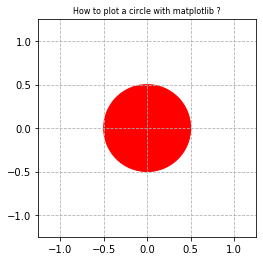

In [154]:
circle1 = plt.Circle((0, 0), 0.5, color='r')

fig, ax = plt.subplots()

plt.xlim(-1.25,1.25)
plt.ylim(-1.25,1.25)

plt.grid(linestyle='--')

ax.set_aspect(1)

ax.add_artist(circle1)

plt.title('How to plot a circle with matplotlib ?', fontsize=8)

plt.savefig("plot_circle_matplotlib_02.png", bbox_inches='tight')

plt.show()

In [272]:
time = np.arange(1 * fps,20 * fps,int(fps/2))
print(time.shape)
print(np_time.mean(axis=0))

(38,)
[1.41411335 1.41984835 1.42756026 1.40882294 1.42315511 1.43620332
 1.41041568 1.39825077 1.39136307 1.40210916 1.39240947 1.37283971
 1.3829085  1.40337033 1.41893777 1.38153773 1.39193972 1.38255921
 1.38674971 1.40306866 1.41794411 1.43709663 1.41592889 1.39820633
 1.39849841 1.40449542 1.42204969 1.4094422  1.40157852 1.40520833
 1.39827448 1.41453065 1.38821889 1.39933471 1.40467    1.38932624
 1.39170536 1.38951951]


In [75]:
os.system("mkdir " + path  + "distributions")


0

<calculating b = 1.0>
0


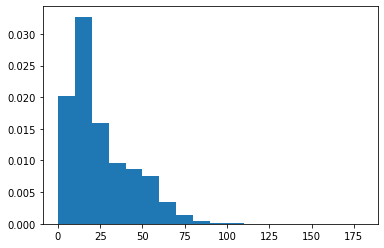

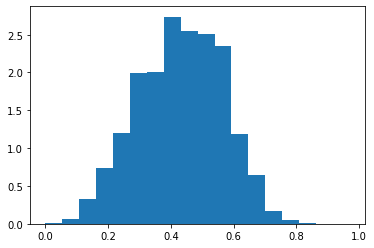

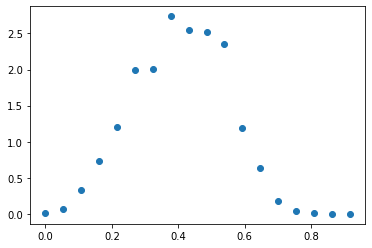

0.4312603274173807
24.691655944226227
<calculating b = 1.2>
1


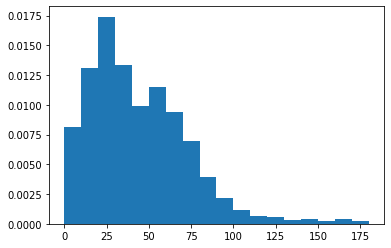

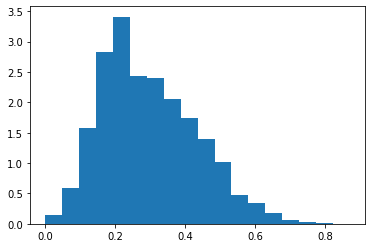

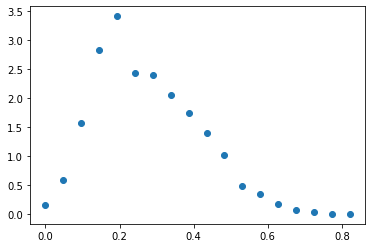

0.2962320879721331
44.07550604877028
<calculating b = 1.5>
37


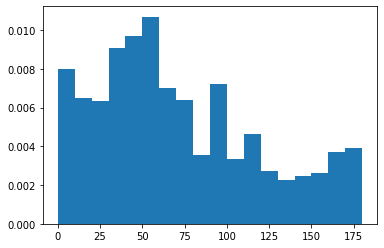

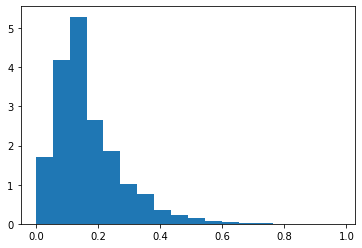

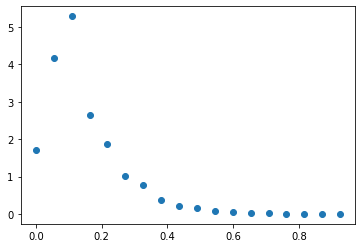

0.16658746019545406
70.99786359566774
<calculating b = 2.0>
46


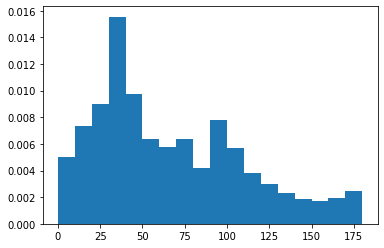

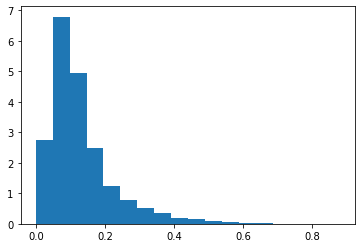

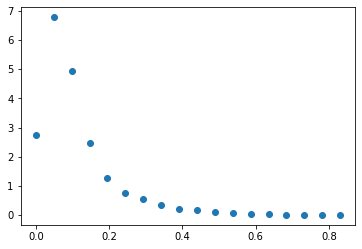

0.12806028264442643
66.50203362879041
<calculating b = 2.3>
44


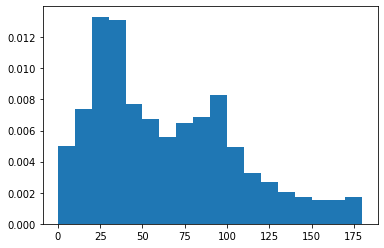

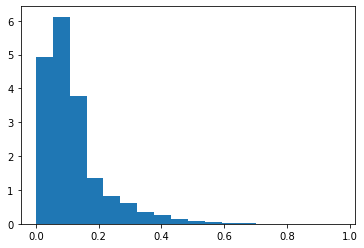

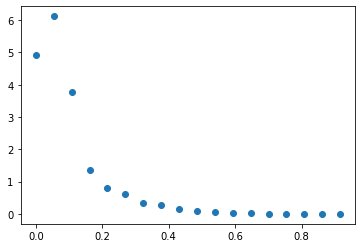

0.11725812301598766
64.08885911568574
<calculating b = 3.0>
43


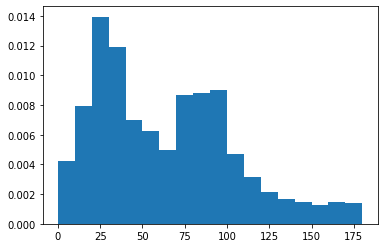

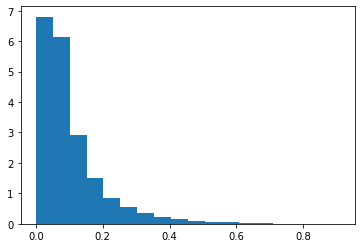

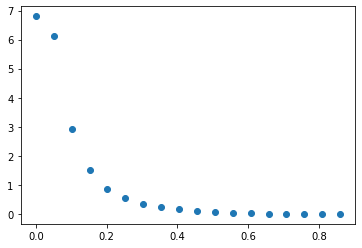

0.10665163064245962
63.7237128859495
<calculating b = 3.4>
44


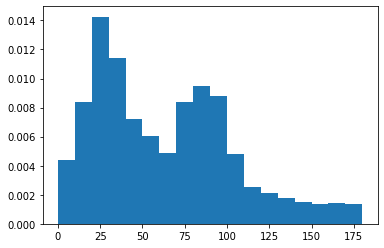

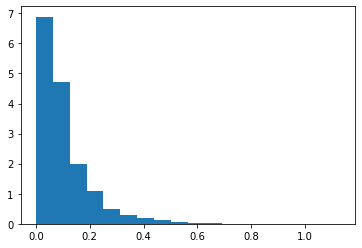

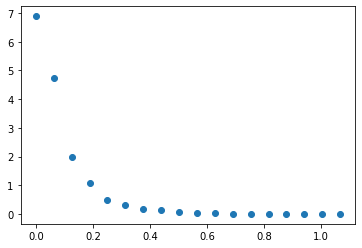

0.10519195362332057
63.32094650038012
<calculating b = 4.5>
43


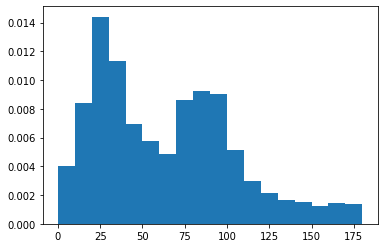

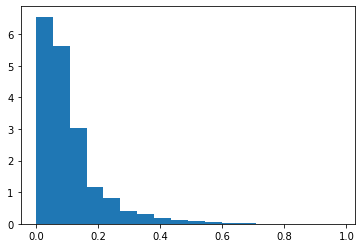

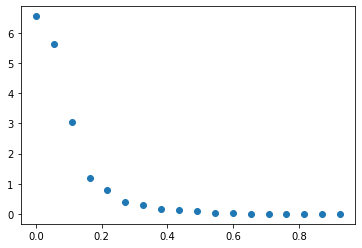

0.10425506757745509
63.72256705145545
<calculating b = 5.8>
48


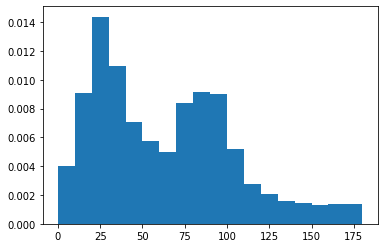

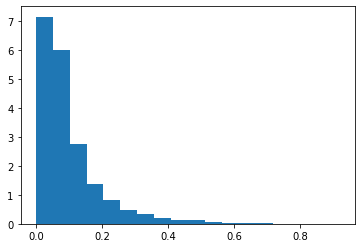

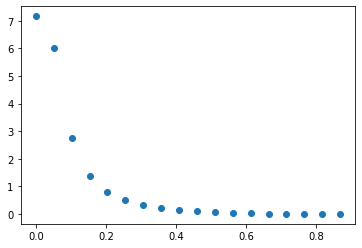

0.1028231513659064
63.34162057272273
<calculating b = 7.0>
42


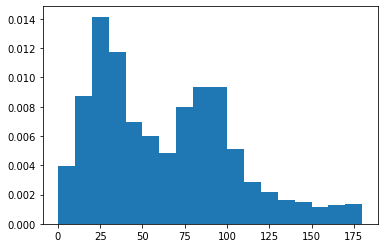

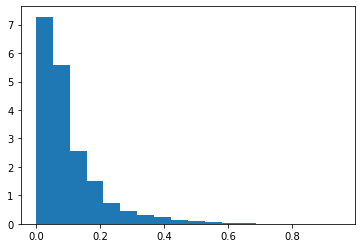

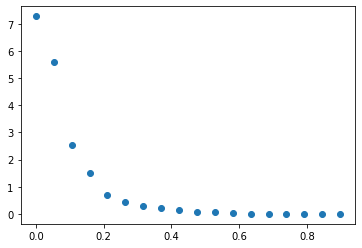

0.10186199978731171
63.36287911197322


In [117]:
col = ["FR","X","Y","ID","speed_nn","ANGLE_int_nn"]
blist = 2 * lin_var[test_var]
v_0_list = []
resultfolder = "distributions/"
os.system("mkdir " + path  + resultfolder)
os.system("mkdir " + path  + "plots")
os.system("mkdir " + path  + "plots/angledist")
os.system("mkdir " + path  + "plots/speeddist")

folderlist = []
for T_test in T_test_list:
    folder_frame_frac = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['ini_folder'])
    b_folder = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['b'])

    loc_list = [[path + folder + sl + "new_evac_traj_" + af.b_data_name(2 * bi, 3) + "_" + str(i) + ".txt" for i in
                 range(runs_tested)] for folder, bi in zip(folder_frame_frac, b_folder)]
    bi = 0
    
    v_0_mean = np.empty(blist.shape[0])
    v_0_var = np.empty(blist.shape[0])
    angle_nn_var = np.empty(blist.shape[0])
    angle_nn_mean = np.empty(blist.shape[0])
    for loc_list_runs in loc_list:
        print("<calculating " + test_str + " = " + str(2 * lin_var[test_var][bi]) + ">")
        v_nn_mean = np.empty(0)
        angle_nn = np.empty(0)
        p0count = 0
        for loc in loc_list_runs:
            if os.path.isfile(loc) == False:
                #print("WARNING: file " + loc + " not found.")
                continue
            df = pd.read_csv(loc, sep="\s+", header=0, comment="#",skipinitialspace=True, usecols=col)
            #df['ANGLE_int_nn'] = df['ANGLE_int_nn'].values.astype(np.float)
            df = df[df['FR'] > 10 * fps]
            df = df[df['ANGLE_int_nn'].values.astype(np.float) >= -1.0]
            df = df[df['speed_nn'].values.astype(np.float) >= 0.0]
            df = df[df['speed_nn'].values.astype(np.float) < 1.34]
            p0 = df.groupby('FR')['speed_nn'].max()
            p0 = p0[p0.values < 0.1].values.shape[0]
            #print(p0)
            if p0 > 0:
                p0count += 1
            
            #print(p0)
            #df = df[df['FR'] > fps * 10]
            df = df[df['Y'] > 0]
            df = df[df['X'] * df['X'] + df['Y']* df['Y'] < 1.**2]
            v_nn_mean = np.append(v_nn_mean,df['speed_nn'].values.astype(np.float))  
            #df = df[abs(df['X']) < 0.5]
            #df = df[df['Y'] > 1]

            #df = df[df['Y'] < 1]

            angle_nn = np.append(angle_nn,np.arccos(df['ANGLE_int_nn'].values.astype(np.float))*180./3.1415)
        print(p0count)
        #plt.hist(v_nn_mean,bins=50)
        #plt.show()
        df_anal = pd.DataFrame({"angle":angle_nn,"speed" : v_nn_mean})
        dat_name = path + resultfolder + "dist_" + af.b_data_name(2 * lin_var[test_var][bi],3) + ".csv"
        df_anal.to_csv(dat_name)
        x, bins, p= plt.hist(angle_nn,bins=18,density=True)
        plt.savefig(path + 'plots/angledist/angle_' + af.b_data_name(2 * lin_var[test_var][bi], 3) + '.png')
        plt.show()

        x, bins, p =plt.hist(v_nn_mean,bins = 18,density=True)
        plt.savefig(path + 'plots/speeddist/speed_' + af.b_data_name(2 * lin_var[test_var][bi], 3) + '.png')

        plt.show()

        nphist = np.histogram(v_nn_mean,bins=18,density = True)
        #plt.plot(nphist[1][:-1],np.log(-np.log(1-nphist[0])), marker = "o", linestyle='none')
        plt.plot(nphist[1][:-1],nphist[0], marker = "o", linestyle='none')
        #plt.xscale("log")
        #plt.yscale("log")
        plt.show()
        #print(v_nn_mean)
        v_0_list.append(v_nn_mean.mean())
        v_0_mean[bi] = v_nn_mean.mean()
        v_0_var[bi] = v_nn_mean.std()
        print(v_nn_mean.mean())
        angle_nn_mean[bi] = angle_nn.mean()
        angle_nn_var[bi] = angle_nn.std()

        print(angle_nn.mean())
        bi += 1
        #print(v_nn_mean.mean())


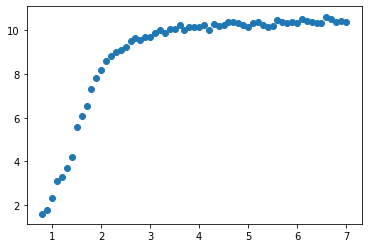

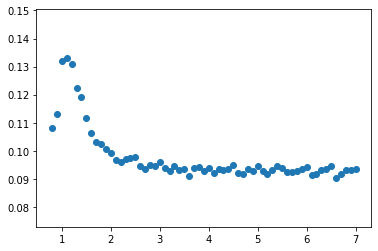

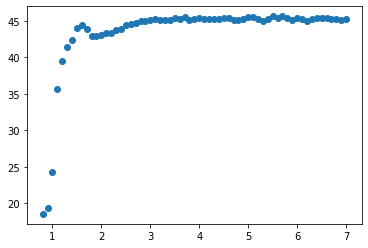

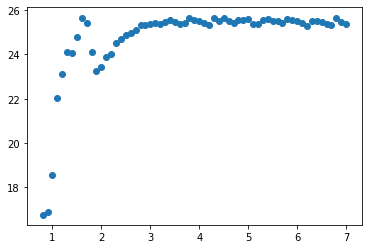

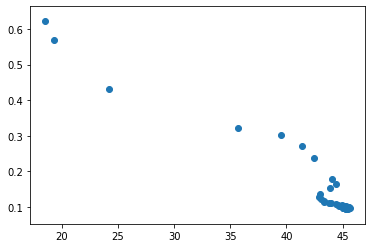

In [72]:
#plt.yscale("exp")
#plt.xscale("log")
plt.scatter(blist,1/v_0_mean)

plt.show()

plt.scatter(blist,v_0_var)
plt.show()
plt.scatter(blist,angle_nn_mean)
plt.show()

plt.scatter(blist,angle_nn_var)
plt.show()

plt.scatter(angle_nn_mean,v_0_mean)

plt.show()


<calculating b = 7.5>
</calculating b = 7.5>


/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:42: RuntimeWarning: divide by zero encountered in true_divide
/Users/jonas/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:42: RuntimeWarning: invalid value encountered in arctan


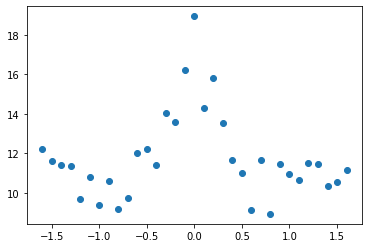

In [362]:
col = ["FR","X","Y","ID"]
t_array = np.arange(100 * fps, 500 * fps, int(fps/2 ))#
for T_test in T_test_list:
    folder_frame_frac = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['ini_folder'])
    b_folder = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['b'])

    loc_list = [[path + folder + sl + "new_evac_traj_" + af.b_data_name(2 * bi, 3) + "_" + str(i) + ".txt" for i in
                 range(runs_tested)] for folder, bi in zip(folder_frame_frac, b_folder)]
    bi = 0
    ttt_arr = np.empty(0)
    dist_arr = np.empty(0)
    angle_arr = np.empty(0)
    x_ar = np.empty(0)
    y_ar = np.empty(0)
    for loc_list_runs in loc_list:
        print("<calculating " + test_str + " = " + str(lin_var[test_var][bi]) + ">")

        for loc in loc_list_runs:
            df = pd.read_csv(loc, sep="\s+", header=0, comment="#",skipinitialspace=True, usecols=col)
            min_value = df.groupby('ID')['Y'].min()[df['ID']][0:N_ped - 1]
            #n_max_frame = df.groupby('ID')['FR'].max()[df['ID']][0:N_ped - 1].nlargest(12).index.values
            #print(n_max_frame)
            min_value = min_value[min_value < -0.2]
            key_filtered = min_value.keys().values
            
            df = df[df['ID'].isin(key_filtered)]
            df = df[df['Y'] > 0.]
            df = df[~df['ID'].isin(n_max_frame)]
            
            max_frame = df.groupby('ID')['FR'].max()[df['ID']]
            #print(max_frame.groupby('ID').nlargest(1))
            df['max_frame'] = max_frame.values
            df = df[df['FR'].isin(t_array)]

            #print(max_frame)


            x = df['X'].values
            y = df['Y'].values
            #dist_ttt = np.round(dist(-0.4, 0., 0.4, 0., x, y),2)
            dist_ttt = np.round(np.sqrt( x * x + y * y),1)
            angle_ttt = np.round(np.arctan(y/x),1)
            ttt = df['max_frame'].values - df['FR'].values
            ttt_arr = np.append(ttt_arr,ttt)
            dist_arr = np.append(dist_arr,dist_ttt)
            angle_arr = np.append(angle_arr,angle_ttt)
            x_ar = np.append(x_ar,x)
            y_ar = np.append(y_ar,y)
        print("</calculating " + test_str + " = " + str(lin_var[test_var][bi]) + ">")
        #print(dist_ttt.shape)
        #print(ttt.shape)
        #print(np.array(ttt_arr))
        df_plot = pd.DataFrame({"ttt" :  ttt_arr  / fps,"angle":angle_arr, "dist": dist_arr,"x":x_ar,"y":y_ar })
        #plt.plot(dist_arr,ttt_arr/fps,marker = "o",linestyle='none')
        #print(df_plot)
        #print(df_plot)
        bi += 1
        df_mean = df_plot[df_plot["dist"] < 1.2]
        df_mean = df_mean[df_mean["dist"] > 1.0]

        df_mean = df_mean.groupby("angle").mean()
        #print(df_mean)
        plt.plot(df_mean.index,df_mean["ttt"],marker = "o",linestyle='none')
        #plt.xscale('log')
        #plt.yscale('log')
        plt.show()
        #plt.plot(df_plot["dist"].values, ttt_mean_list,marker = "o",linestyle='none')
   # plt.show()


In [35]:
"""theta = df_plot['angle'].values
r = df_plot['dist'].values
ttt = df_plot['ttt'].values

x_arr = r * np.cos(theta)
y_arr = r * np.sin(theta)

x, y = np.meshgrid(x_arr, y_arr)
ttt_mesh = np.meshgrid(ttt,ttt)
z = ttt_mesh[:-1, :-1].flatten()

z_min, z_max = np.abs(z).min(), np.abs(z).max()
fig, ax = plt.subplots()
c = ax.pcolormesh(x, y, z, cmap='hot', vmin=z_min, vmax=12, label="density in [m^-2]")
# set the limits of the plot to the limits of the data
ax.axis([x.min(), x.max(), y.min(), y.max()])
fig.colorbar(c, ax=ax, label="$\\rho$ in [$m^{-2}$]")
print(z.mean())
print("corridor width = ", bi)
if bi == 1.7 or bi == 1.2:
    print("density jump")
line_width = 2.5
add_wall(line_width,bi*2)
name_var = lin_var[test_var][test_var_count]
test_var_count += 1"""

'theta = df_plot[\'angle\'].values\nr = df_plot[\'dist\'].values\nttt = df_plot[\'ttt\'].values\n\nx_arr = r * np.cos(theta)\ny_arr = r * np.sin(theta)\n\nx, y = np.meshgrid(x_arr, y_arr)\nttt_mesh = np.meshgrid(ttt,ttt)\nz = ttt_mesh[:-1, :-1].flatten()\n\nz_min, z_max = np.abs(z).min(), np.abs(z).max()\nfig, ax = plt.subplots()\nc = ax.pcolormesh(x, y, z, cmap=\'hot\', vmin=z_min, vmax=12, label="density in [m^-2]")\n# set the limits of the plot to the limits of the data\nax.axis([x.min(), x.max(), y.min(), y.max()])\nfig.colorbar(c, ax=ax, label="$\\rho$ in [$m^{-2}$]")\nprint(z.mean())\nprint("corridor width = ", bi)\nif bi == 1.7 or bi == 1.2:\n    print("density jump")\nline_width = 2.5\nadd_wall(line_width,bi*2)\nname_var = lin_var[test_var][test_var_count]\ntest_var_count += 1'

In [36]:
"""df_plot['x']= np.round(x_arr,1)
df_plot['y']= np.round(y_arr,1)
df_heat = pd.DataFrame({"x":np.round(x_arr,1),"y":np.round(y_arr,1),"ttt":ttt_arr/fps})"""

'df_plot[\'x\']= np.round(x_arr,1)\ndf_plot[\'y\']= np.round(y_arr,1)\ndf_heat = pd.DataFrame({"x":np.round(x_arr,1),"y":np.round(y_arr,1),"ttt":ttt_arr/fps})'

In [353]:
x_arr = np.round(np.arange(-3.5,3.5,0.1),1)
y_arr = np.round(np.arange(0,10,0.1),1)


In [363]:
ttt_arr = np.zeros([y_arr.shape[0],x_arr.shape[0]])
df_plot2 = df_plot
df_plot2['x'] = np.round(df_plot2['x'].values,1)
df_plot2['y'] = np.round(df_plot2['y'].values,1)

x_i = 0
for x in x_arr:
    y_i = 0
    for y in y_arr:
        x_bool = df_plot2['x'] == x
        df_new = df_plot2[x_bool]
        y_bool = df_new['y'] == y

        df_new = df_new[y_bool]
        #print(df_new['ttt'].values.shape[0])
        if (df_new['ttt'].values.shape[0]  and x*x + y*y < 4 and x*x + y * y > 0.09):
            ttt_arr[y_i][x_i] += df_new['ttt'].values.sum()/df_new['ttt'].values.shape[0]
            
        y_i += 1
    x_i += 1


In [364]:
print(x_arr.shape,y_arr.shape)
ttt_arr.shape

(70,) (100,)


(100, 70)

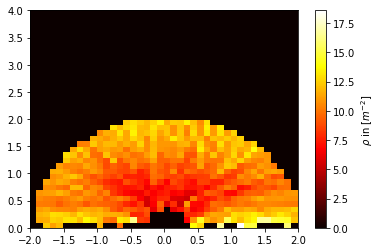

In [365]:
x, y = np.meshgrid(x_arr, y_arr)

r = x * x + y * y


z = np.divide(ttt_arr,r, where= r != 0)

#z = ttt_arr
#z = r
#print(z[z > 0])
z_min, z_max = np.abs(z).min(), np.abs(z).max()
fig, ax = plt.subplots()
c = ax.pcolormesh(x, y, z, cmap='hot', vmin=z_min, vmax=z_max, label="density in [m^-2]")
# set the limits of the plot to the limits of the data
ax.axis([x.min(), x.max(), y.min(), y.max()])
plt.xlim([-2,2])
plt.ylim([0,4])
fig.colorbar(c, ax=ax, label="$\\rho$ in [$m^{-2}$]")
#print(z.mean())
#print("corridor width = ", bi)
#if bi == 1.7 or bi == 1.2:
#    print("density jump")
#line_width = 2.5
#add_wall(line_width,bi*2)
#name_var = lin_var[test_var][test_var_count]
#test_var_count += 1

In [6]:

points = np.array([[0, 0], [0, 1.1], [1, 0], [1, 1]])
from scipy.spatial import Delaunay
tri = Delaunay(points)

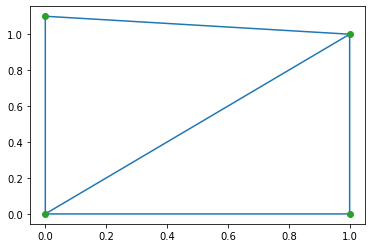

In [7]:
import matplotlib.pyplot as plt
plt.triplot(points[:,0], points[:,1], tri.simplices)
plt.plot(points[:,0], points[:,1], 'o')
plt.show()

<calculating b = 0.8>


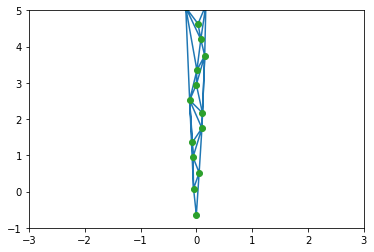

<calculating b = 0.8>


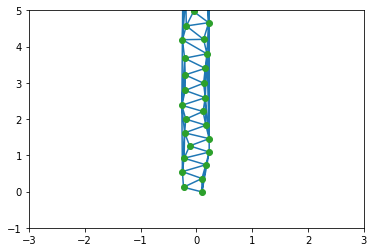

<calculating b = 0.8>


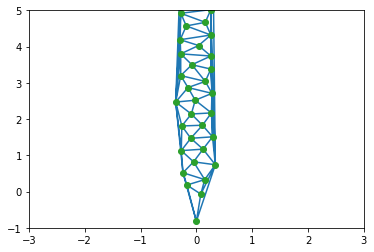

<calculating b = 0.8>


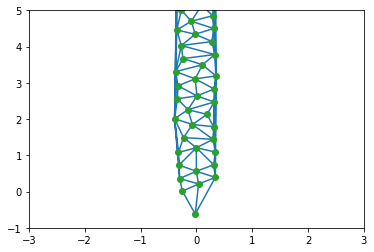

<calculating b = 0.8>


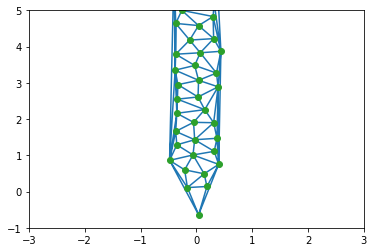

<calculating b = 0.8>


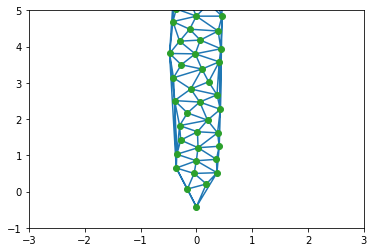

<calculating b = 0.8>


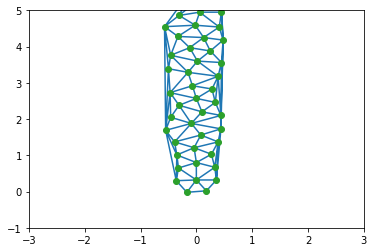

<calculating b = 0.8>


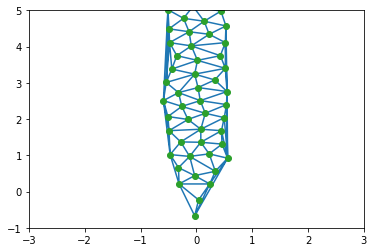

<calculating b = 0.8>


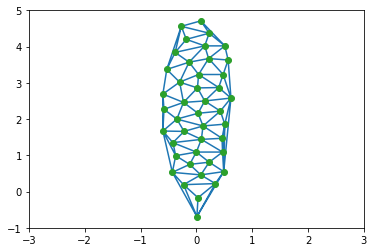

<calculating b = 0.8>


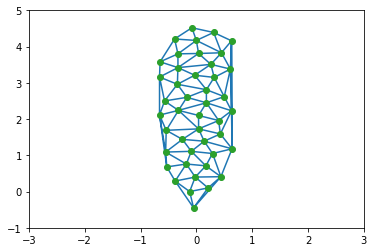

<calculating b = 0.8>


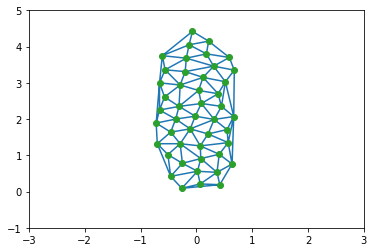

<calculating b = 0.8>


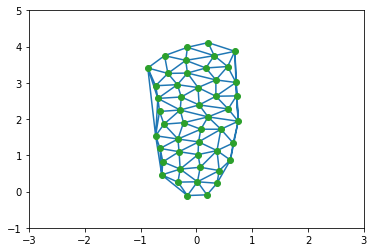

<calculating b = 0.8>


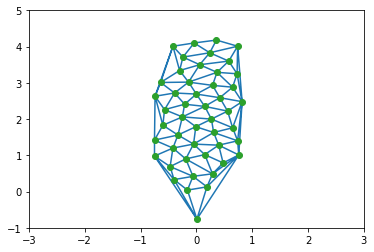

<calculating b = 0.8>


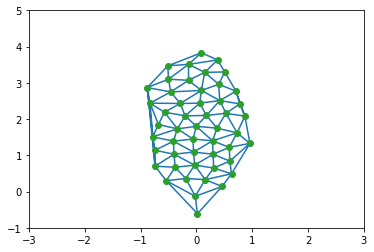

<calculating b = 0.8>


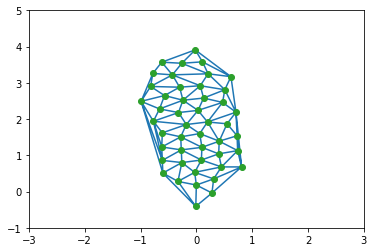

<calculating b = 0.8>


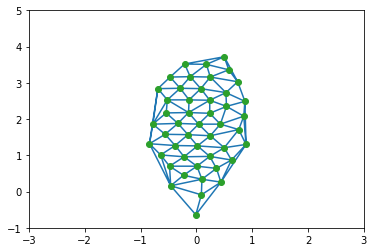

<calculating b = 0.8>


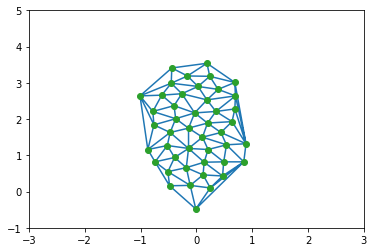

<calculating b = 0.8>


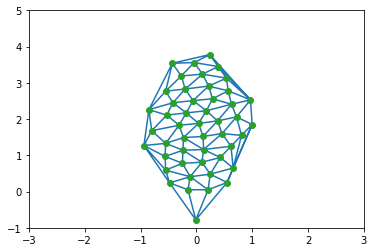

<calculating b = 0.8>


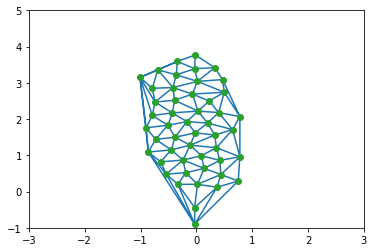

<calculating b = 0.8>


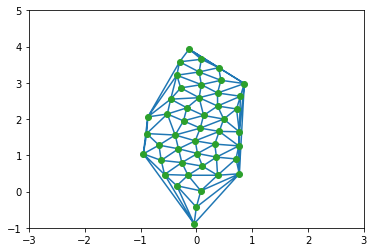

<calculating b = 0.8>


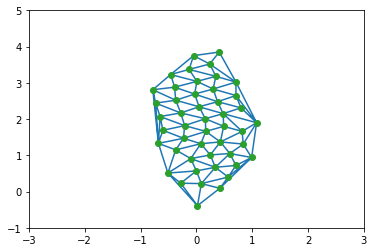

<calculating b = 0.8>


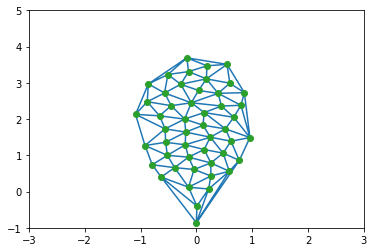

<calculating b = 0.8>


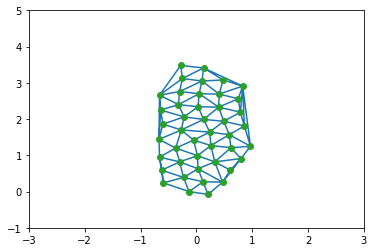

<calculating b = 0.8>


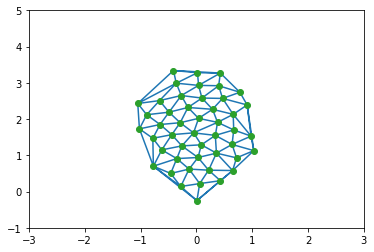

<calculating b = 0.8>


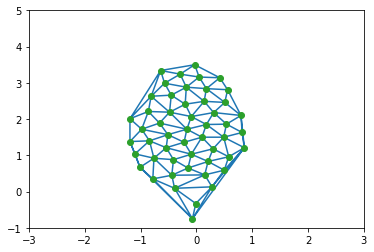

<calculating b = 0.8>


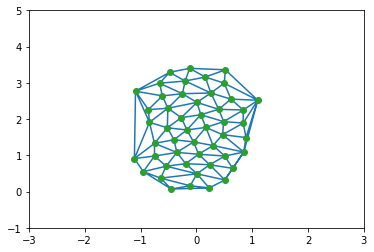

<calculating b = 0.8>


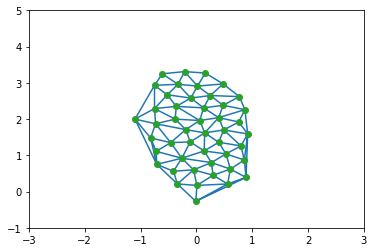

<calculating b = 0.8>


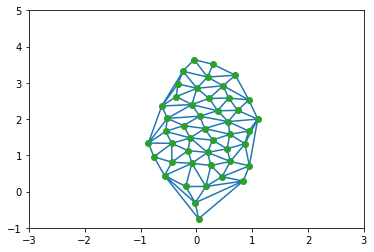

<calculating b = 0.8>


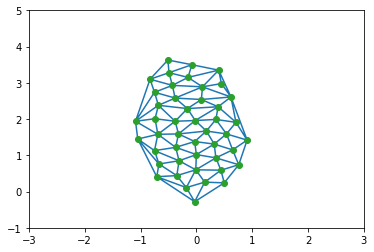

<calculating b = 0.8>


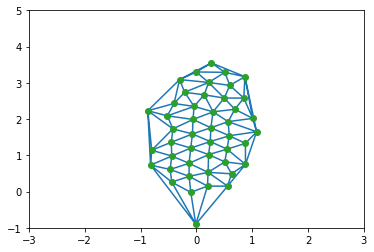

<calculating b = 0.8>


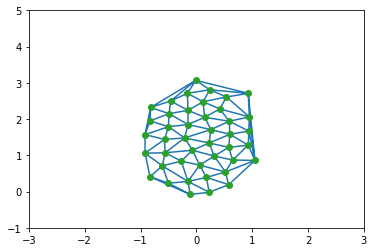

<calculating b = 0.8>


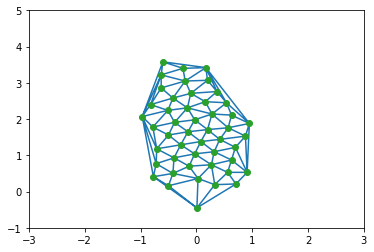

<calculating b = 0.8>


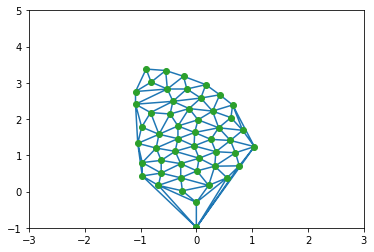

<calculating b = 0.8>


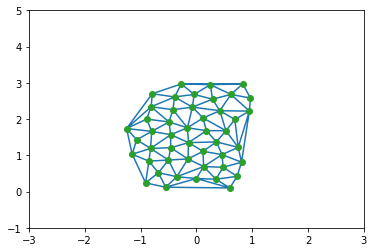

<calculating b = 0.8>


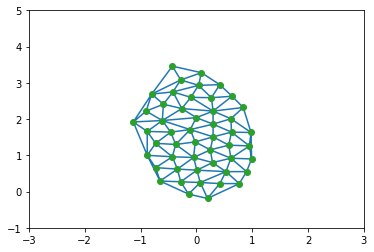

<calculating b = 0.8>


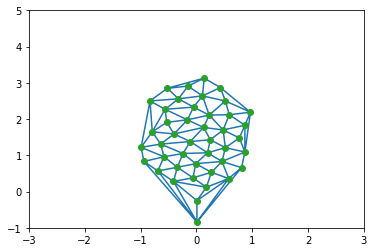

<calculating b = 0.8>


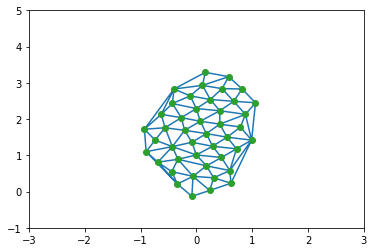

<calculating b = 0.8>


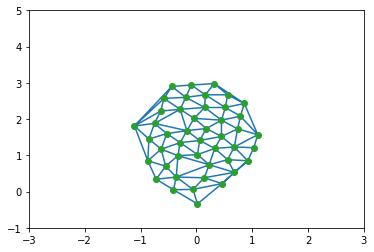

<calculating b = 0.8>


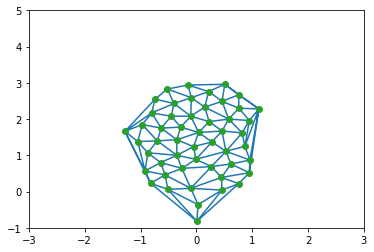

<calculating b = 0.8>


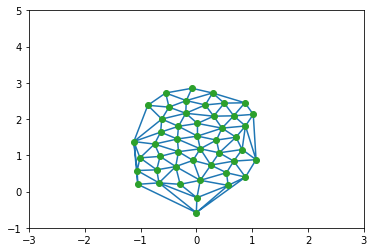

<calculating b = 0.8>


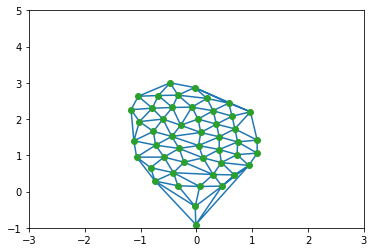

<calculating b = 0.8>


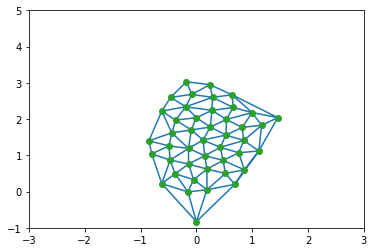

<calculating b = 0.8>


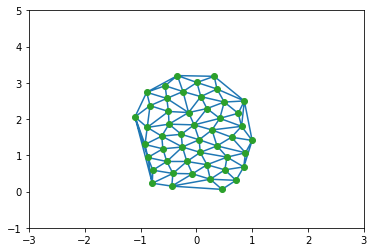

<calculating b = 0.8>


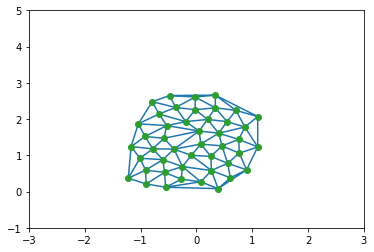

<calculating b = 0.8>


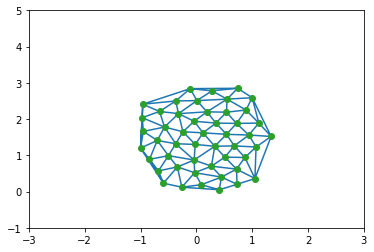

<calculating b = 0.8>


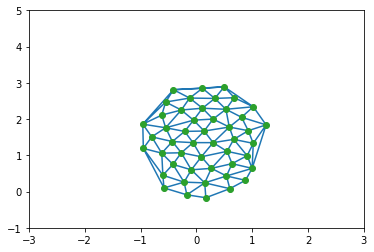

<calculating b = 0.8>


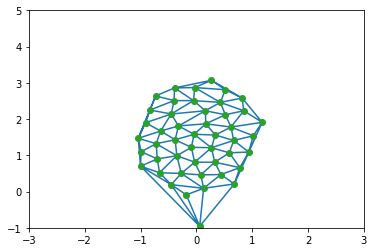

<calculating b = 0.8>


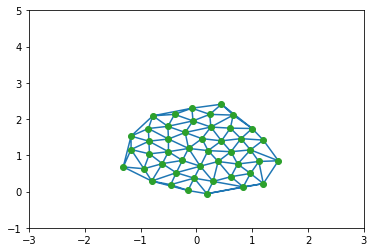

<calculating b = 0.8>


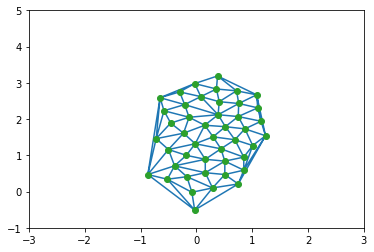

<calculating b = 0.8>


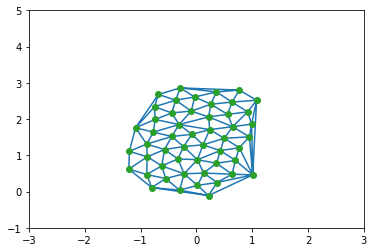

<calculating b = 0.8>


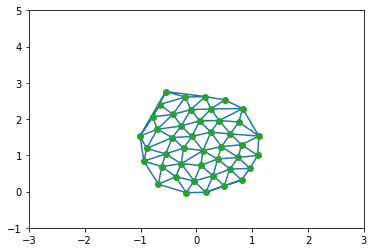

<calculating b = 0.8>


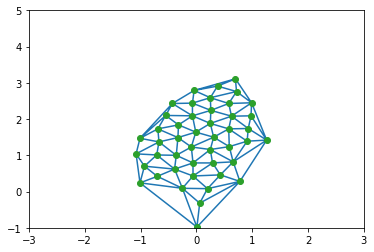

<calculating b = 0.8>


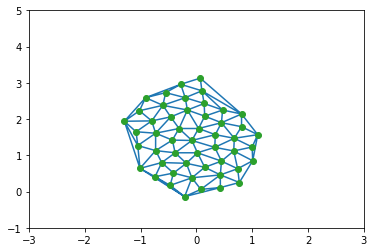

<calculating b = 0.8>


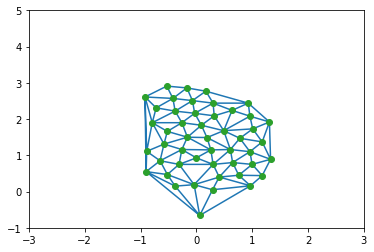

<calculating b = 0.8>


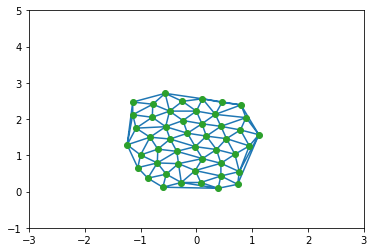

<calculating b = 0.8>


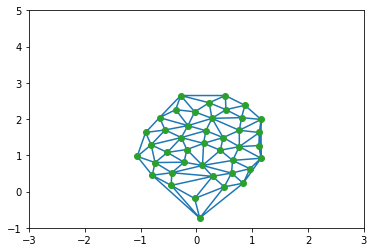

<calculating b = 0.8>


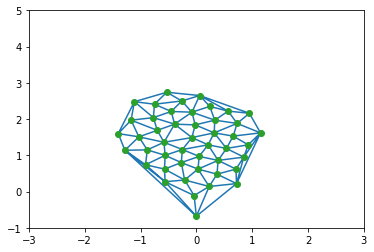

<calculating b = 0.8>


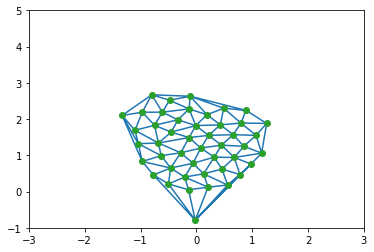

<calculating b = 0.8>


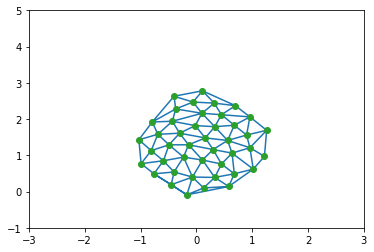

<calculating b = 0.8>


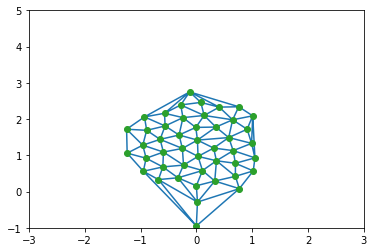

<calculating b = 0.8>


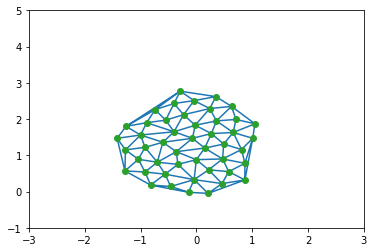

<calculating b = 0.8>


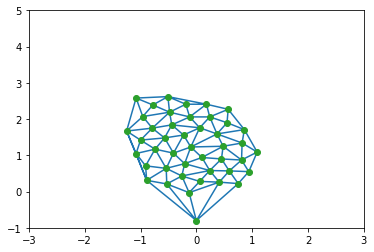

<calculating b = 0.8>


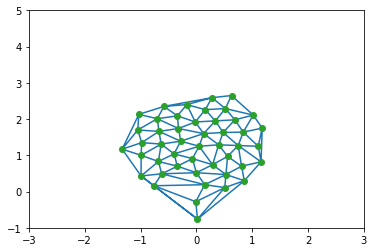

<calculating b = 0.8>


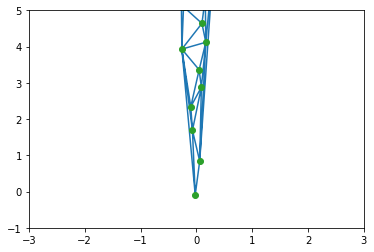

<calculating b = 0.8>


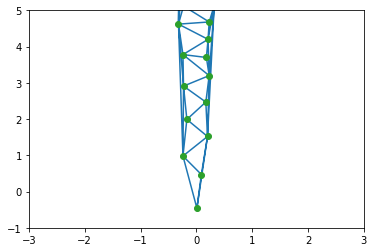

<calculating b = 0.8>


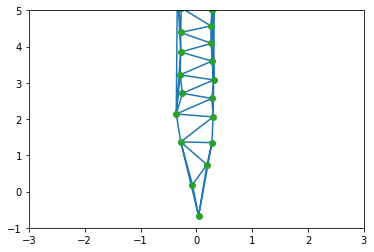

<calculating b = 0.8>


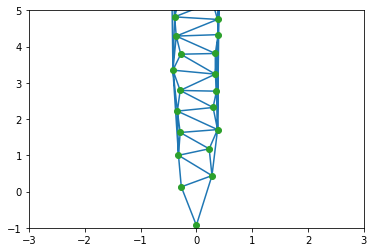

<calculating b = 0.8>


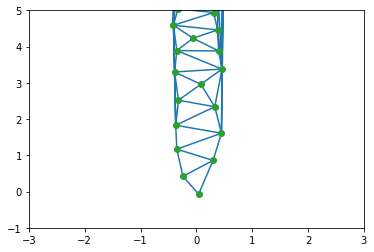

<calculating b = 0.8>


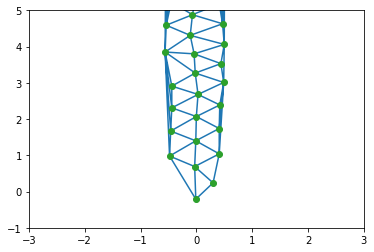

<calculating b = 0.8>


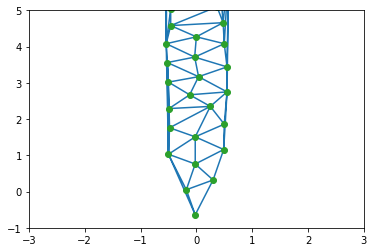

<calculating b = 0.8>


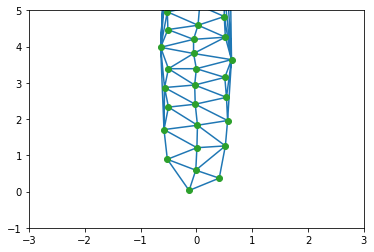

<calculating b = 0.8>


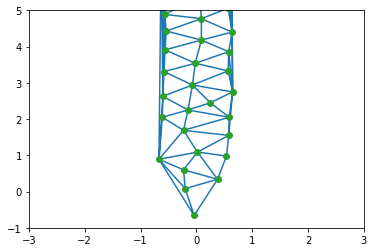

<calculating b = 0.8>


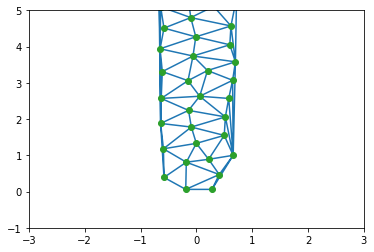

<calculating b = 0.8>


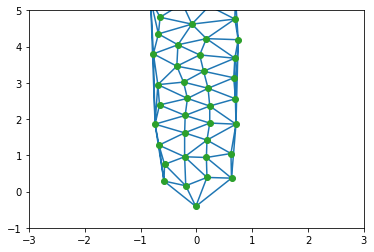

<calculating b = 0.8>


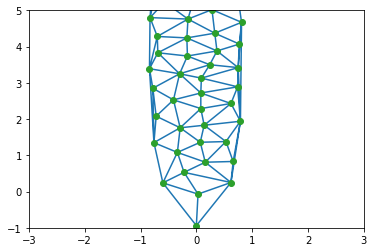

<calculating b = 0.8>


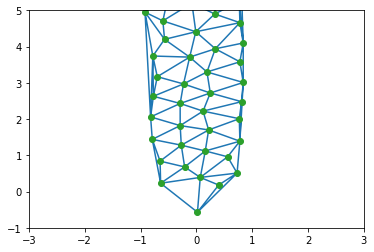

<calculating b = 0.8>


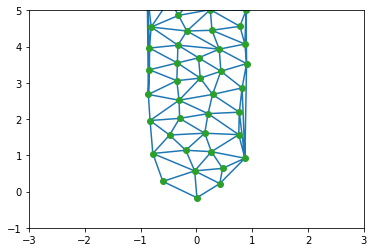

<calculating b = 0.8>


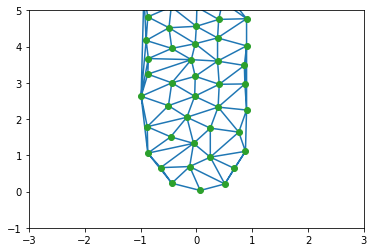

<calculating b = 0.8>


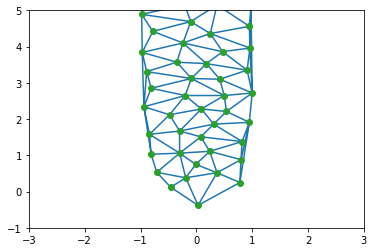

<calculating b = 0.8>


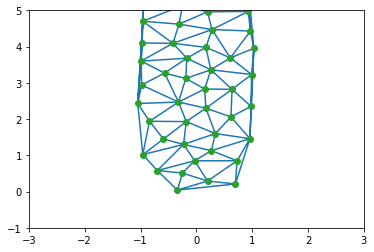

<calculating b = 0.8>


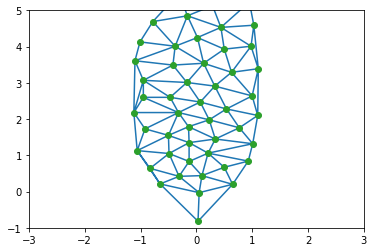

<calculating b = 0.8>


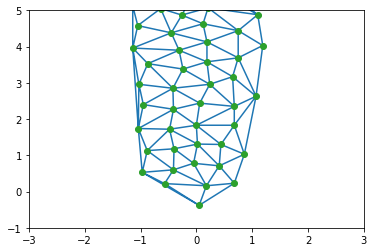

<calculating b = 0.8>


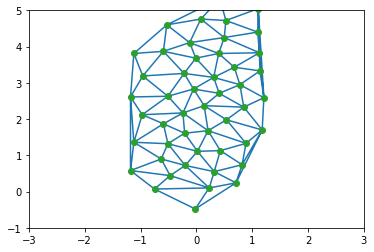

<calculating b = 0.8>


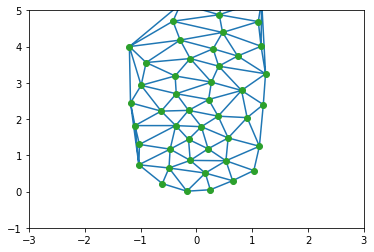

<calculating b = 0.8>


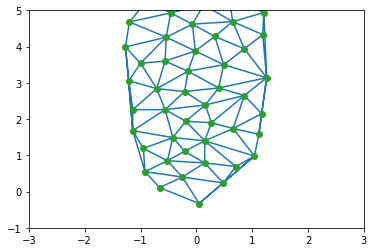

<calculating b = 0.8>


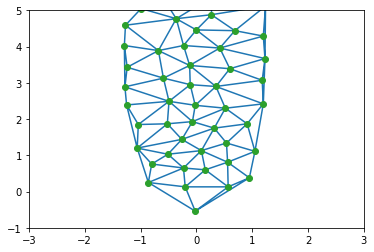

<calculating b = 0.8>


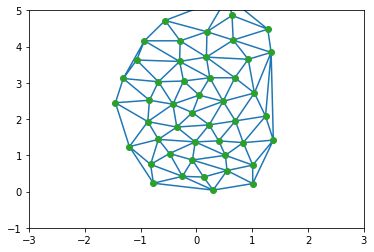

<calculating b = 0.8>


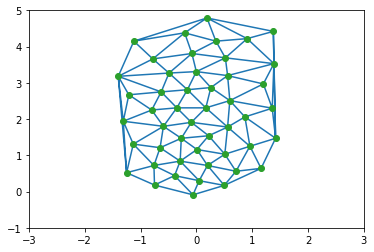

<calculating b = 0.8>


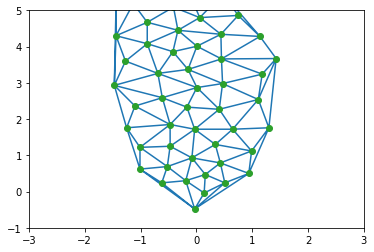

<calculating b = 0.8>


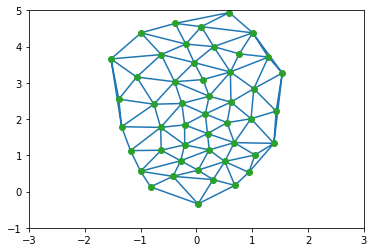

<calculating b = 0.8>


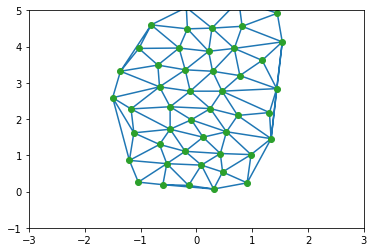

<calculating b = 0.8>


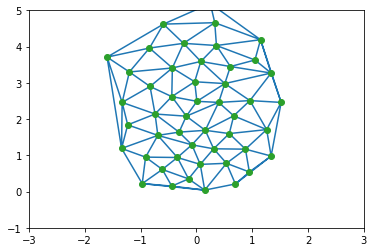

<calculating b = 0.8>


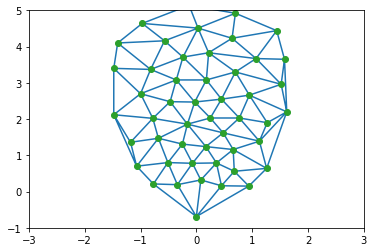

<calculating b = 0.8>


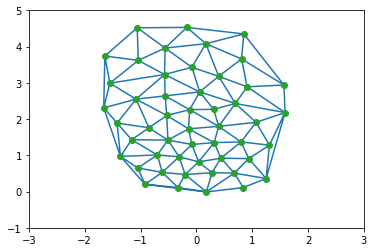

<calculating b = 0.8>


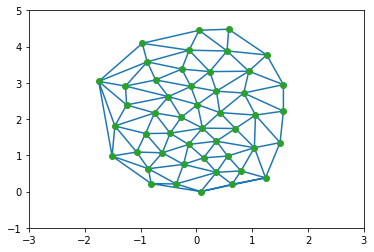

<calculating b = 0.8>


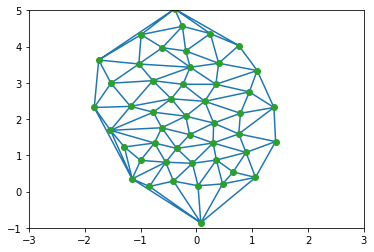

<calculating b = 0.8>


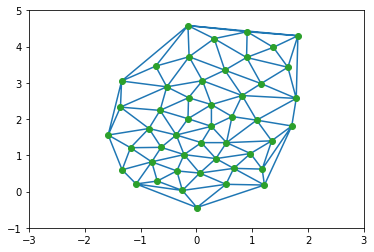

<calculating b = 0.8>


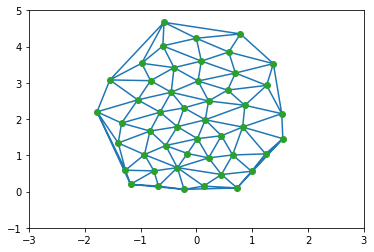

<calculating b = 0.8>


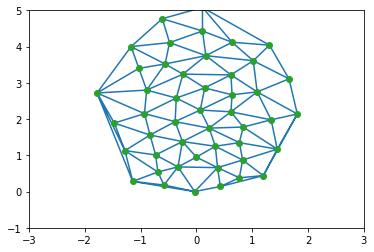

<calculating b = 0.8>


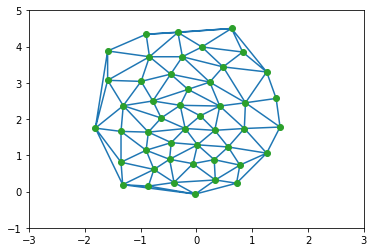

<calculating b = 0.8>


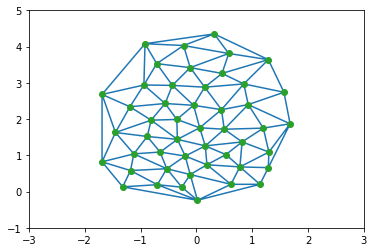

<calculating b = 0.8>


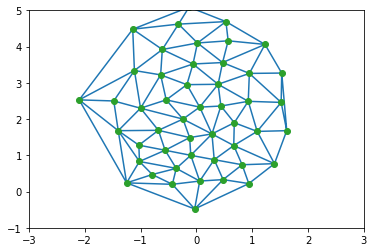

<calculating b = 0.8>


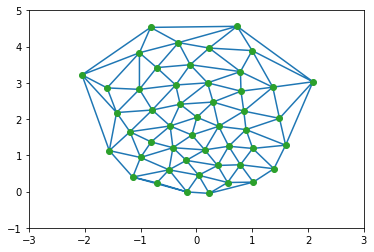

<calculating b = 0.8>


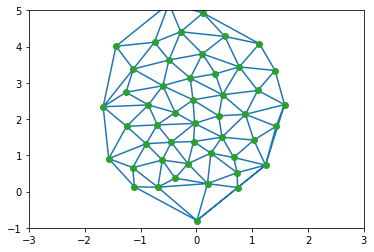

<calculating b = 0.8>


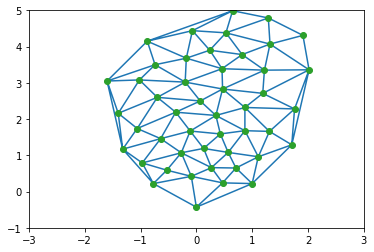

<calculating b = 0.8>


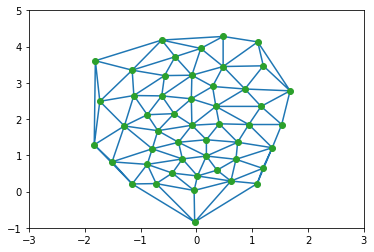

<calculating b = 0.8>


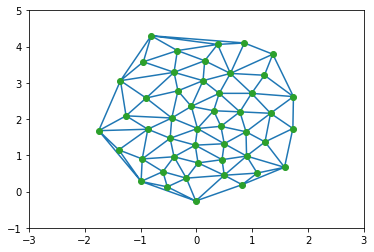

<calculating b = 0.8>


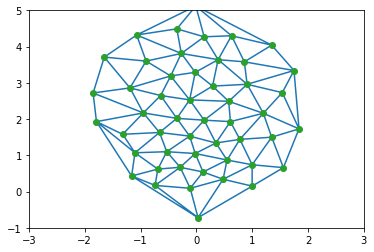

<calculating b = 0.8>


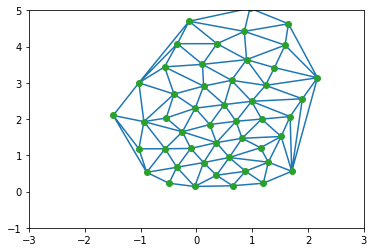

<calculating b = 0.8>


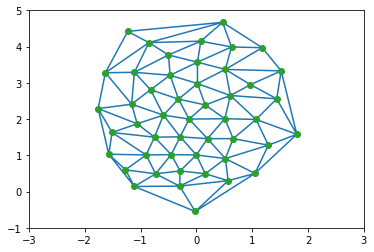

<calculating b = 0.8>


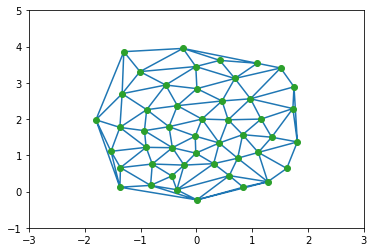

<calculating b = 0.8>


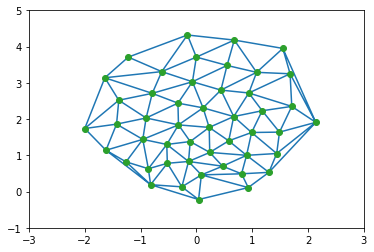

<calculating b = 0.8>


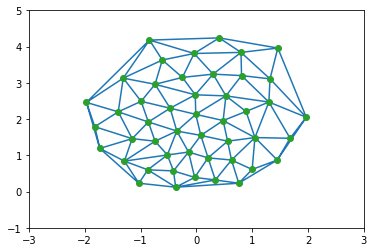

<calculating b = 0.8>


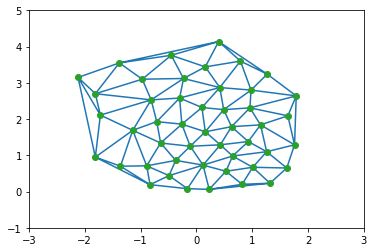

<calculating b = 0.8>


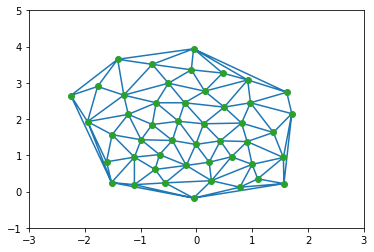

<calculating b = 0.8>


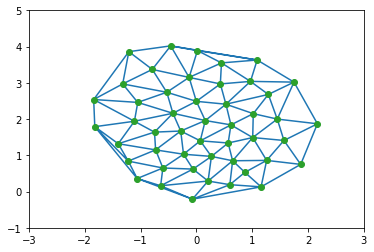

<calculating b = 0.8>


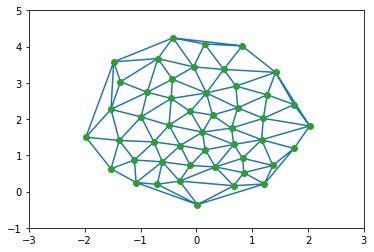

<calculating b = 0.8>


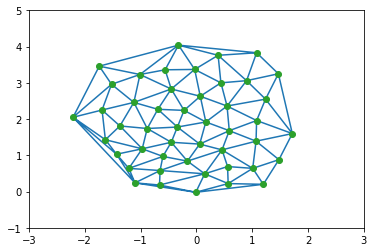

<calculating b = 0.8>


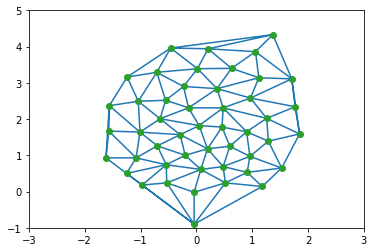

<calculating b = 0.8>


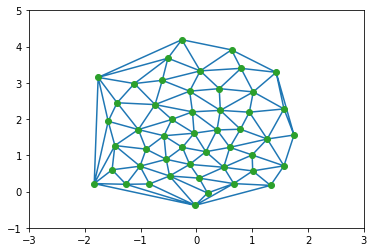

<calculating b = 0.8>


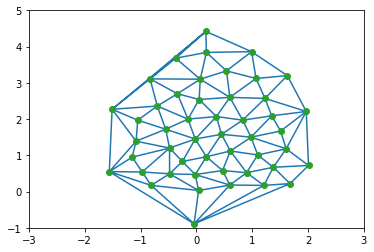

<calculating b = 0.8>


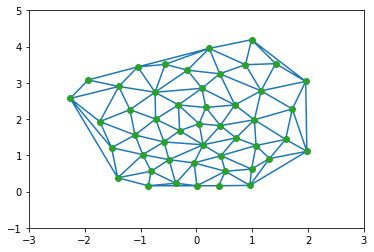

<calculating b = 0.8>


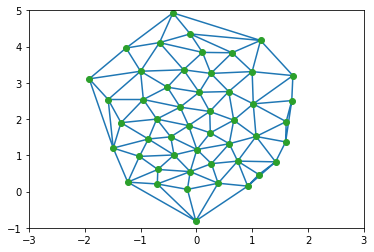

<calculating b = 0.8>


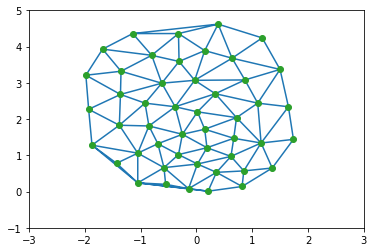

<calculating b = 0.8>


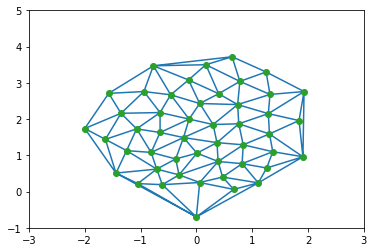

<calculating b = 0.8>


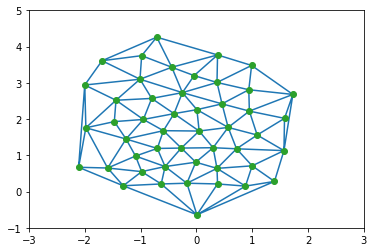

In [8]:
col = ["FR","X","Y","ID"]
blist = 2 * lin_var[test_var]
v_0_list = []
from itertools import groupby
N_del_i = 10
N_del = 10
for T_test in T_test_list:
    folder_frame_frac = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['ini_folder'])
    b_folder = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['b'])
    loc_list = [[path + folder + sl + "new_evac_traj_" + af.b_data_name(2 * bi, 3) + "_" + str(i) + ".txt" for i in
                 range(runs_tested)] for folder, bi in zip(folder_frame_frac, b_folder)]
    bi = 0
    for loc_list_runs in loc_list:
        print("<calculating " + test_str + " = " + str(2 * lin_var[test_var][bi]) + ">")
        p0count = 0
        count = 0
        incount = 0
        for loc in loc_list_runs[0:1]:
            if os.path.isfile(loc) == False:
                #print("WARNING: file " + loc + " not found.")
                continue
            df = pd.read_csv(loc, sep="\s+", header=0, comment="#",skipinitialspace=True, usecols=col)
            x = df[df['FR'] == 10 * 16]['X'].values
            y = df[df['FR'] == 10 * 16]['Y'].values
            points = np.vstack((x,y)).T
            tri = Delaunay(points)
            print(tri)
            plt.xlim([-3,3])
            plt.ylim([-1,5])
            plt.triplot(points[:,0], points[:,1], tri.simplices)
            plt.plot(points[:,0], points[:,1], 'o')
            plt.show()

In [15]:
col = ["FR","X","Y","ID","IntID"]
blist = 2 * lin_var[test_var]
v_0_list = []
from itertools import groupby
N_del_i = 10
N_del = 10
for T_test in T_test_list:
    folder_frame_frac = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['ini_folder'])
    b_folder = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['b'])
    loc_list = [[path + folder + sl + "new_evac_traj_" + af.b_data_name(2 * bi, 3) + "_" + str(i) + ".txt" for i in
                 range(runs_tested)] for folder, bi in zip(folder_frame_frac, b_folder)]
    bi = 0
    for loc_list_runs in loc_list[1:]:
        print("<calculating " + test_str + " = " + str(2 * lin_var[test_var][bi]) + ">")
        p0count = 0
        count = 0
        incount = 0
        for loc in loc_list_runs:
            if os.path.isfile(loc) == False:
                #print("WARNING: file " + loc + " not found.")
                continue
            df = pd.read_csv(loc, sep="\s+", header=0, comment="#",skipinitialspace=True, usecols=col)
            
            df_fr = df.groupby('ID')['FR'].max()
            df_fr = pd.DataFrame({'ID':df_fr.index.values,'FR':df_fr.values})
            print(df_fr)



<calculating b = 0.8>
    ID   FR
0    1   75
1    2  721
2    3  279
3    4  362
4    5  609
5    6  662
6    7  142
7    8  744
8    9  733
9   10  787
10  11  269
11  12  394
12  13  433
13  14  589
14  15  387
15  16  796
16  17  318
17  18   33
18  19  255
19  20  707
20  21  534
21  22  645
22  23  778
23  24  694
24  25  246
25  26  180
26  27  373
27  28  653
28  29  107
29  30  287
30  31  764
31  32   15
32  33  417
33  34  154
34  35  338
35  36  460
36  37  491
37  38  118
38  39  424
39  40  568
40  41  598
41  42  630
42  43  755
43  44  555
44  45  576
45  46  406
46  47  133
47  48  124
48  49  621
49  50  545
50  51  508
51  52   94
52  53  354
53  54  448
54  55  482
    ID   FR
0    1   88
1    2  773
2    3  146
3    4  943
4    5  828
5    6  603
6    7  275
7    8  536
8    9  287
9   10  668
10  11  369
11  12  953
12  13  468
13  14  750
14  15   79
15  16   19
16  17  658
17  18  643
18  19  594
19  20  577
20  21  895
21  22  485
22  23   60
23  24  836
24  25

    ID   FR
0    1  185
1    2  717
2    3   94
3    4  485
4    5  374
5    6  114
6    7  674
7    8  706
8    9  330
9   10  744
10  11   45
11  12  502
12  13  404
13  14  540
14  15   29
15  16  314
16  17  734
17  18  284
18  19  323
19  20  157
20  21  338
21  22  241
22  23  381
23  24  441
24  25  666
25  26  146
26  27  572
27  28  390
28  29  347
29  30  430
30  31  135
31  32  450
32  33   37
33  34   87
34  35  175
35  36  423
36  37  123
37  38  230
38  39  493
39  40  561
40  41  306
41  42  107
42  43  413
43  44   69
44  45  463
45  46  167
46  47   55
47  48  685
48  49  474
49  50  358
50  51  586
51  52  254
52  53  215
53  54  295
54  55   76
    ID   FR
0    1  469
1    2   72
2    3  396
3    4   30
4    5  376
5    6  549
6    7  608
7    8  200
8    9  682
9   10  565
10  11  154
11  12   92
12  13  108
13  14  717
14  15  783
15  16   40
16  17  706
17  18  776
18  19  189
19  20  301
20  21  320
21  22  386
22  23   63
23  24  287
24  25  350
25  26  515
26  

    ID   FR
0    1  279
1    2   66
2    3  424
3    4  395
4    5  462
5    6   96
6    7  443
7    8   86
8    9  671
9   10  480
10  11  124
11  12  202
12  13  649
13  14  133
14  15   73
15  16  172
16  17  639
17  18  543
18  19  190
19  20  209
20  21  384
21  22  179
22  23  472
23  24   57
24  25  630
25  26  373
26  27   37
27  28  314
28  29  112
29  30  488
30  31  433
31  32  520
32  33  563
33  34  143
34  35  103
35  36  660
36  37  454
37  38  583
38  39  501
39  40  291
40  41  253
41  42  231
42  43  592
43  44  531
44  45   46
45  46  574
46  47   26
47  48  239
48  49  300
49  50  221
50  51  510
51  52  602
52  53  154
53  54  413
54  55  161
    ID   FR
0    1  590
1    2   24
2    3   48
3    4  598
4    5  714
5    6  257
6    7  103
7    8  286
8    9  276
9   10  226
10  11  322
11  12  752
12  13  532
13  14  155
14  15  204
15  16  484
16  17  266
17  18  145
18  19  313
19  20  694
20  21  684
21  22  422
22  23   64
23  24  166
24  25  644
25  26  673
26  

    ID    FR
0    1   256
1    2   125
2    3   728
3    4   242
4    5   551
5    6   293
6    7   882
7    8   721
8    9   422
9   10   599
10  11   611
11  12  1012
12  13   335
13  14   144
14  15    17
15  16   786
16  17   933
17  18   823
18  19    72
19  20   275
20  21   104
21  22    49
22  23   220
23  24   534
24  25   981
25  26   945
26  27    84
27  28   646
28  29  1025
29  30    56
30  31   756
31  32   409
32  33   212
33  34   230
34  35   668
35  36   812
36  37   267
37  38    39
38  39   915
39  40   993
40  41   622
41  42   654
42  43   905
43  44   635
44  45    95
45  46   693
46  47   524
47  48   958
48  49   703
49  50  1002
50  51   741
51  52   115
52  53    29
53  54   679
54  55   842
    ID   FR
0    1  646
1    2  517
2    3  371
3    4  361
4    5  434
5    6   51
6    7  507
7    8  405
8    9  110
9   10  497
10  11  211
11  12  477
12  13  137
13  14  148
14  15  171
15  16  157
16  17  582
17  18  605
18  19  121
19  20  278
20  21  233
21  22  

    ID   FR
0    1  197
1    2  395
2    3  253
3    4  376
4    5  115
5    6  511
6    7   68
7    8  646
8    9  497
9   10  422
10  11  663
11  12   94
12  13   76
13  14  621
14  15  520
15  16  293
16  17  405
17  18   35
18  19   42
19  20  132
20  21   51
21  22  465
22  23  534
23  24  183
24  25  171
25  26  544
26  27   86
27  28  152
28  29  161
29  30  595
30  31  123
31  32  476
32  33  611
33  34  301
34  35  388
35  36  242
36  37  328
37  38   24
38  39  635
39  40  454
40  41  415
41  42  142
42  43  275
43  44  339
44  45  265
45  46  283
46  47  653
47  48  673
48  49  214
49  50  682
50  51  488
51  52  105
52  53  603
53  54  206
54  55  556
    ID   FR
0    1   58
1    2  272
2    3  251
3    4   28
4    5  328
5    6  343
6    7  537
7    8  244
8    9  293
9   10  178
10  11  111
11  12  719
12  13  705
13  14  494
14  15   85
15  16  355
16  17   68
17  18   77
18  19  301
19  20  615
20  21  697
21  22  690
22  23   39
23  24  524
24  25  233
25  26  212
26  

    ID   FR
0    1  380
1    2  672
2    3   81
3    4   37
4    5  758
5    6   58
6    7  389
7    8  434
8    9  358
9   10  663
10  11   49
11  12  791
12  13  313
13  14  515
14  15   73
15  16  525
16  17  457
17  18  275
18  19  649
19  20  681
20  21  259
21  22  291
22  23  175
23  24  717
24  25  621
25  26  830
26  27  335
27  28  418
28  29  368
29  30  301
30  31  800
31  32  776
32  33  122
33  34  399
34  35  807
35  36  188
36  37  240
37  38  849
38  39  351
39  40  840
40  41  406
41  42  534
42  43  692
43  44  820
44  45  250
45  46  136
46  47  635
47  48  326
48  49  110
49  50   29
50  51  502
51  52   65
52  53   94
53  54   22
54  55  767
    ID   FR
0    1  316
1    2  325
2    3  227
3    4  343
4    5   58
5    6  176
6    7  801
7    8  248
8    9  334
9   10  363
10  11  649
11  12  355
12  13  415
13  14  700
14  15  255
15  16  572
16  17  456
17  18  530
18  19  672
19  20  625
20  21   83
21  22  218
22  23  690
23  24  615
24  25  117
25  26  809
26  

    ID   FR
0    1  591
1    2  844
2    3  419
3    4  412
4    5  779
5    6  640
6    7  279
7    8  652
8    9  694
9   10  124
10  11  828
11  12  745
12  13  614
13  14  258
14  15  434
15  16  760
16  17  105
17  18  671
18  19  873
19  20  300
20  21  715
21  22  536
22  23  626
23  24   85
24  25  459
25  26  113
26  27  517
27  28   96
28  29  215
29  30   72
30  31  198
31  32  603
32  33  268
33  34  334
34  35  447
35  36  189
36  37  528
37  38  360
38  39  494
39  40  581
40  41  485
41  42  552
42  43  563
43  44  854
44  45  349
45  46  572
46  47  242
47  48  862
48  49  771
49  50  289
50  51  325
51  52  660
52  53   55
53  54  544
54  55  678
    ID   FR
0    1  146
1    2  326
2    3   60
3    4  512
4    5  612
5    6  586
6    7  200
7    8  368
8    9  638
9   10   70
10  11  728
11  12  530
12  13  440
13  14  411
14  15  559
15  16  568
16  17   18
17  18  285
18  19  358
19  20  829
20  21   36
21  22  456
22  23  686
23  24  157
24  25  325
25  26  595
26  

    ID   FR
0    1  667
1    2  587
2    3  318
3    4   40
4    5  149
5    6  136
6    7  523
7    8   53
8    9  414
9   10  611
10  11  624
11  12   31
12  13  634
13  14   74
14  15  555
15  16  398
16  17  496
17  18  334
18  19  595
19  20  249
20  21   82
21  22   62
22  23  180
23  24  258
24  25  815
25  26  427
26  27  695
27  28  240
28  29  503
29  30  468
30  31  654
31  32  307
32  33  801
33  34  512
34  35  603
35  36  448
36  37  201
37  38  102
38  39   91
39  40  129
40  41  229
41  42  193
42  43  389
43  44  766
44  45  578
45  46  739
46  47  277
47  48  756
48  49  674
49  50  486
50  51  539
51  52  343
52  53  287
53  54  436
54  55   22
    ID   FR
0    1  421
1    2  149
2    3  409
3    4  588
4    5   60
5    6  655
6    7  259
7    8  689
8    9  432
9   10  276
10  11   31
11  12  296
12  13  468
13  14   18
14  15  629
15  16  666
16  17  136
17  18  218
18  19  719
19  20  449
20  21  727
21  22  598
22  23   85
23  24  736
24  25  399
25  26   96
26  

    ID    FR
0    1    31
1    2   563
2    3   126
3    4   737
4    5   475
5    6   815
6    7   780
7    8   588
8    9   485
9   10   319
10  11   106
11  12   459
12  13   399
13  14   289
14  15   202
15  16   634
16  17   797
17  18   548
18  19   769
19  20  1041
20  21   465
21  22   620
22  23   412
23  24   113
24  25  1032
25  26   644
26  27   496
27  28  1021
28  29   175
29  30   675
30  31   727
31  32   666
32  33    19
33  34   279
34  35    41
35  36   516
36  37   389
37  38  1003
38  39   902
39  40   196
40  41   424
41  42   442
42  43   923
43  44   308
44  45   977
45  46   911
46  47   573
47  48   805
48  49   939
49  50   789
50  51   432
51  52   235
52  53   990
53  54   215
54  55   658
    ID    FR
0    1   411
1    2   318
2    3   909
3    4   687
4    5   656
5    6   896
6    7   553
7    8   346
8    9   991
9   10   358
10  11   461
11  12   623
12  13   374
13  14   195
14  15   265
15  16   765
16  17   978
17  18   591
18  19   387
19  20   641

    ID    FR
0    1   927
1    2   242
2    3   935
3    4   679
4    5   822
5    6   228
6    7   956
7    8   661
8    9   144
9   10   462
10  11   526
11  12  1070
12  13   841
13  14   855
14  15   610
15  16    46
16  17   542
17  18   587
18  19  1047
19  20   805
20  21   472
21  22   866
22  23   879
23  24  1056
24  25   492
25  26   480
26  27   619
27  28   643
28  29  1037
29  30   284
30  31   788
31  32   629
32  33   127
33  34   254
34  35   234
35  36   979
36  37   580
37  38   895
38  39   964
39  40    36
40  41   263
41  42   993
42  43   948
43  44   184
44  45   116
45  46   888
46  47   780
47  48   272
48  49   904
49  50   154
50  51   161
51  52   535
52  53   104
53  54   831
54  55   915
    ID   FR
0    1  752
1    2  293
2    3  112
3    4  136
4    5  493
5    6  128
6    7  532
7    8  549
8    9  179
9   10  523
10  11  232
11  12  882
12  13  502
13  14  715
14  15  908
15  16  101
16  17   33
17  18   64
18  19  802
19  20   40
20  21  283
21  22  

    ID   FR
0    1   30
1    2  182
2    3  725
3    4   86
4    5  339
5    6  702
6    7  554
7    8  605
8    9  840
9   10  564
10  11   19
11  12  639
12  13  920
13  14  756
14  15  881
15  16  235
16  17  105
17  18  775
18  19  901
19  20   37
20  21  626
21  22  438
22  23  948
23  24  512
24  25  523
25  26  859
26  27  619
27  28  482
28  29  460
29  30  667
30  31  686
31  32   77
32  33  141
33  34   96
34  35  983
35  36  379
36  37  745
37  38  893
38  39  541
39  40   58
40  41  848
41  42   48
42  43   68
43  44  244
44  45  349
45  46  935
46  47  678
47  48  575
48  49  449
49  50  972
50  51  501
51  52  191
52  53  593
53  54  388
54  55  767
    ID   FR
0    1   29
1    2  175
2    3   53
3    4  864
4    5  633
5    6  907
6    7  733
7    8  874
8    9  775
9   10  477
10  11  457
11  12  655
12  13  836
13  14  315
14  15  884
15  16  393
16  17  201
17  18  166
18  19  671
19  20  827
20  21  977
21  22  553
22  23  966
23  24  693
24  25  250
25  26  853
26  

    ID   FR
0    1  509
1    2   77
2    3  337
3    4  318
4    5  592
5    6  502
6    7  721
7    8  348
8    9  257
9   10  309
10  11  466
11  12  769
12  13  580
13  14  393
14  15  881
15  16  760
16  17  383
17  18  369
18  19  424
19  20   89
20  21  118
21  22   30
22  23  190
23  24  106
24  25  554
25  26  648
26  27  445
27  28  730
28  29  403
29  30   50
30  31  778
31  32  455
32  33   37
33  34  435
34  35  638
35  36  326
36  37  154
37  38  609
38  39  871
39  40  668
40  41  659
41  42  274
42  43  628
43  44   18
44  45  357
45  46  743
46  47  203
47  48  834
48  49  491
49  50  250
50  51  804
51  52  413
52  53  479
53  54  183
54  55  857
    ID   FR
0    1  343
1    2  594
2    3  373
3    4  165
4    5  461
5    6  602
6    7  690
7    8  617
8    9  276
9   10  440
10  11   84
11  12  432
12  13  721
13  14  353
14  15  494
15  16   28
16  17  242
17  18  505
18  19  335
19  20  474
20  21  325
21  22  292
22  23  226
23  24  743
24  25  259
25  26   21
26  

    ID   FR
0    1  790
1    2  209
2    3  979
3    4  938
4    5  228
5    6  571
6    7  870
7    8  488
8    9  925
9   10  850
10  11  680
11  12  430
12  13  762
13  14   54
14  15   45
15  16  126
16  17  591
17  18  182
18  19  476
19  20  751
20  21  529
21  22  237
22  23  672
23  24  968
24  25  151
25  26  496
26  27  360
27  28  275
28  29  415
29  30  743
30  31  218
31  32  115
32  33  384
33  34  344
34  35  544
35  36  171
36  37  863
37  38  948
38  39  371
39  40  405
40  41  538
41  42  332
42  43  191
43  44  265
44  45  248
45  46  800
46  47  840
47  48  324
48  49  140
49  50  441
50  51  392
51  52  693
52  53  464
53  54  782
54  55  451
    ID   FR
0    1  776
1    2  453
2    3   75
3    4  716
4    5  478
5    6  336
6    7  487
7    8  795
8    9  617
9   10  526
10  11  428
11  12  401
12  13  232
13  14  183
14  15   67
15  16  109
16  17  592
17  18  661
18  19  266
19  20   43
20  21  629
21  22   58
22  23  469
23  24  708
24  25  347
25  26  202
26  

    ID   FR
0    1  166
1    2  601
2    3   71
3    4  915
4    5  829
5    6  107
6    7  500
7    8  321
8    9  116
9   10  584
10  11  253
11  12  301
12  13  857
13  14  925
14  15  742
15  16  146
16  17  478
17  18  531
18  19  419
19  20  444
20  21  509
21  22  662
22  23  792
23  24   80
24  25  271
25  26  453
26  27  898
27  28  350
28  29  848
29  30  821
30  31  136
31  32  341
32  33  838
33  34  704
34  35  724
35  36  429
36  37  770
37  38  522
38  39  812
39  40  217
40  41  158
41  42  208
42  43  406
43  44  696
44  45  682
45  46  781
46  47  123
47  48  758
48  49   97
49  50  892
50  51  330
51  52  177
52  53  262
53  54  197
54  55  396
    ID   FR
0    1  257
1    2  126
2    3  439
3    4  574
4    5  456
5    6  287
6    7  384
7    8  745
8    9  801
9   10  152
10  11  330
11  12  667
12  13  755
13  14  117
14  15  481
15  16   76
16  17  780
17  18  838
18  19  368
19  20  860
20  21  391
21  22  564
22  23  638
23  24  317
24  25  648
25  26  620
26  

    ID    FR
0    1  1000
1    2   238
2    3   118
3    4   600
4    5   260
5    6   557
6    7  1172
7    8   202
8    9    19
9   10   539
10  11   747
11  12   679
12  13   564
13  14   756
14  15   943
15  16   503
16  17  1126
17  18    86
18  19  1025
19  20    45
20  21   317
21  22  1035
22  23   151
23  24   918
24  25    37
25  26  1107
26  27   341
27  28    56
28  29   413
29  30   184
30  31   991
31  32   371
32  33   459
33  34   210
34  35   513
35  36   420
36  37    96
37  38    29
38  39    71
39  40   327
40  41   448
41  42   493
42  43   391
43  44   642
44  45   250
45  46   784
46  47   381
47  48   934
48  49   481
49  50   130
50  51   764
51  52   527
52  53  1163
53  54   803
54  55  1118
    ID   FR
0    1  294
1    2  310
2    3  381
3    4   39
4    5  815
5    6  667
6    7  880
7    8  488
8    9  207
9   10  245
10  11  200
11  12  151
12  13   48
13  14  807
14  15  777
15  16  100
16  17  475
17  18  643
18  19  677
19  20  217
20  21  825
21  22  

    ID    FR
0    1   323
1    2    32
2    3   952
3    4   292
4    5   996
5    6   420
6    7    74
7    8   111
8    9   976
9   10   917
10  11   389
11  12   175
12  13   961
13  14    39
14  15   102
15  16   461
16  17   536
17  18   164
18  19   674
19  20    63
20  21   861
21  22   411
22  23    51
23  24   702
24  25  1023
25  26   183
26  27   546
27  28   682
28  29   150
29  30   441
30  31   938
31  32  1034
32  33   191
33  34   123
34  35   803
35  36   692
36  37    20
37  38   586
38  39   985
39  40   241
40  41   251
41  42   836
42  43   793
43  44  1011
44  45   302
45  46   430
46  47   511
47  48   200
48  49   713
49  50   134
50  51   577
51  52   558
52  53   731
53  54   316
54  55   880
    ID    FR
0    1   562
1    2   271
2    3   102
3    4   989
4    5    88
5    6   130
6    7   965
7    8   194
8    9   917
9   10   173
10  11   806
11  12   238
12  13   767
13  14   978
14  15   513
15  16    32
16  17   841
17  18   302
18  19   703
19  20   462

    ID    FR
0    1   978
1    2  1008
2    3   236
3    4   901
4    5    30
5    6   553
6    7   643
7    8   724
8    9   344
9   10   314
10  11   472
11  12   403
12  13   733
13  14   812
14  15    51
15  16   967
16  17   124
17  18    42
18  19   164
19  20   364
20  21   858
21  22   707
22  23  1118
23  24    97
24  25  1131
25  26   937
26  27   456
27  28    77
28  29   579
29  30   286
30  31   437
31  32   113
32  33   849
33  34   836
34  35  1036
35  36  1024
36  37   820
37  38   156
38  39  1090
39  40   690
40  41   910
41  42   144
42  43    69
43  44   866
44  45    20
45  46   296
46  47   567
47  48   324
48  49   634
49  50    60
50  51   174
51  52   742
52  53   133
53  54   227
54  55    86
    ID   FR
0    1  256
1    2  700
2    3  536
3    4  423
4    5  197
5    6   83
6    7  439
7    8  154
8    9  131
9   10  164
10  11  115
11  12  565
12  13  709
13  14  791
14  15  244
15  16  513
16  17  452
17  18  298
18  19  867
19  20  384
20  21  402
21  22  

    ID    FR
0    1   115
1    2   815
2    3  1053
3    4   196
4    5   280
5    6   907
6    7   289
7    8   826
8    9   846
9   10   155
10  11   546
11  12    19
12  13  1063
13  14    32
14  15   479
15  16   858
16  17   107
17  18  1012
18  19   369
19  20    76
20  21   486
21  22   266
22  23   320
23  24   682
24  25   648
25  26   204
26  27   341
27  28  1044
28  29    61
29  30   834
30  31   357
31  32   600
32  33   518
33  34    98
34  35   807
35  36    42
36  37  1071
37  38  1003
38  39    89
39  40   635
40  41   660
41  42   134
42  43   592
43  44   928
44  45   966
45  46   332
46  47   498
47  48   616
48  49   537
49  50   671
50  51   454
51  52   951
52  53   529
53  54   170
54  55   898
    ID    FR
0    1   434
1    2   847
2    3   234
3    4   796
4    5   141
5    6   586
6    7   638
7    8   302
8    9    51
9   10    27
10  11   559
11  12  1055
12  13  1001
13  14   285
14  15   291
15  16    58
16  17   836
17  18   315
18  19   728
19  20   261

    ID    FR
0    1   995
1    2   153
2    3   185
3    4    34
4    5   519
5    6   114
6    7  1081
7    8    19
8    9   706
9   10   146
10  11   429
11  12   574
12  13  1225
13  14   286
14  15  1116
15  16  1070
16  17   487
17  18   349
18  19   228
19  20  1205
20  21  1235
21  22   339
22  23   876
23  24   103
24  25   507
25  26   971
26  27   622
27  28   982
28  29  1153
29  30  1127
30  31    62
31  32  1104
32  33   422
33  34   922
34  35   244
35  36   218
36  37   274
37  38   765
38  39    82
39  40   773
40  41   955
41  42   564
42  43  1095
43  44  1168
44  45   696
45  46   635
46  47   359
47  48  1137
48  49   308
49  50   497
50  51  1146
51  52   686
52  53    94
53  54   170
54  55    74
    ID   FR
0    1  404
1    2  238
2    3  325
3    4  800
4    5  270
5    6  285
6    7  583
7    8  741
8    9  259
9   10  332
10  11  614
11  12  627
12  13  431
13  14   88
14  15  373
15  16   59
16  17  517
17  18  487
18  19  351
19  20  460
20  21  305
21  22  

    ID    FR
0    1   362
1    2    25
2    3    60
3    4   181
4    5   583
5    6   940
6    7   677
7    8   269
8    9   668
9   10   144
10  11   371
11  12   154
12  13   479
13  14   239
14  15   842
15  16  1051
16  17   510
17  18   765
18  19  1074
19  20   489
20  21   467
21  22   168
22  23   824
23  24  1101
24  25   693
25  26  1093
26  27    70
27  28   832
28  29   408
29  30   570
30  31   131
31  32    39
32  33   382
33  34   645
34  35   955
35  36   878
36  37   889
37  38   561
38  39   441
39  40   427
40  41   635
41  42    96
42  43   930
43  44   605
44  45   758
45  46   655
46  47    86
47  48    48
48  49   224
49  50  1060
50  51   595
51  52   248
52  53   856
53  54   393
54  55   275
    ID    FR
0    1   732
1    2   388
2    3   801
3    4   662
4    5   980
5    6   549
6    7   603
7    8   430
8    9   619
9   10   315
10  11   835
11  12   760
12  13   611
13  14   480
14  15   788
15  16   254
16  17   877
17  18   581
18  19   352
19  20   958

    ID   FR
0    1  362
1    2  613
2    3  814
3    4  758
4    5  111
5    6  153
6    7  967
7    8  196
8    9  313
9   10  668
10  11  225
11  12  418
12  13  838
13  14   49
14  15  734
15  16  328
16  17  926
17  18  204
18  19  438
19  20  881
20  21  284
21  22  743
22  23  161
23  24  448
24  25  954
25  26  134
26  27  852
27  28  781
28  29  187
29  30  250
30  31  870
31  32  125
32  33  770
33  34  559
34  35  172
35  36  626
36  37  276
37  38  104
38  39  977
39  40  823
40  41  305
41  42  863
42  43   57
43  44  587
44  45  258
45  46  946
46  47   17
47  48   31
48  49  605
49  50  578
50  51  662
51  52  803
52  53  934
53  54  893
54  55  426
    ID    FR
0    1    47
1    2   813
2    3   221
3    4   886
4    5  1046
5    6   462
6    7  1033
7    8   179
8    9   604
9   10   411
10  11   118
11  12   380
12  13   316
13  14   270
14  15  1019
15  16   534
16  17  1007
17  18   166
18  19   765
19  20   616
20  21   426
21  22   871
22  23   486
23  24   955
24 

    ID    FR
0    1   513
1    2   543
2    3   822
3    4   463
4    5   957
5    6   560
6    7   327
7    8   193
8    9    31
9   10   874
10  11   776
11  12   893
12  13   629
13  14   445
14  15  1009
15  16   169
16  17   980
17  18    46
18  19   137
19  20   948
20  21   881
21  22   999
22  23   351
23  24   930
24  25  1035
25  26   591
26  27   866
27  28   477
28  29   807
29  30   284
30  31   359
31  32   454
32  33   149
33  34   292
34  35   573
35  36   313
36  37   405
37  38   939
38  39   128
39  40   220
40  41   903
41  42   786
42  43   205
43  44   793
44  45   335
45  46   601
46  47   236
47  48   619
48  49   851
49  50   917
50  51  1026
51  52   972
52  53   115
53  54    22
54  55   529
    ID    FR
0    1  1134
1    2   542
2    3   585
3    4   325
4    5  1146
5    6   335
6    7  1112
7    8  1056
8    9   979
9   10   727
10  11   460
11  12   836
12  13   240
13  14   875
14  15   816
15  16   677
16  17   315
17  18    40
18  19  1005
19  20    64

    ID    FR
0    1  1022
1    2   716
2    3   596
3    4   204
4    5   482
5    6   531
6    7   346
7    8   138
8    9   828
9   10   798
10  11   867
11  12   887
12  13   767
13  14   355
14  15    17
15  16   706
16  17   904
17  18  1098
18  19    27
19  20  1004
20  21   807
21  22   981
22  23    75
23  24   253
24  25   195
25  26   582
26  27   896
27  28   928
28  29   574
29  30   546
30  31   694
31  32   473
32  33   685
33  34   182
34  35   464
35  36  1090
36  37   996
37  38   159
38  39   561
39  40   146
40  41   175
41  42   506
42  43    55
43  44   732
44  45   748
45  46   363
46  47   405
47  48  1107
48  49   781
49  50   244
50  51   449
51  52  1030
52  53   965
53  54   396
54  55   374
    ID   FR
0    1   93
1    2  776
2    3   71
3    4  686
4    5  301
5    6  962
6    7  464
7    8  405
8    9  849
9   10  656
10  11  442
11  12  544
12  13  520
13  14   83
14  15  906
15  16   61
16  17  971
17  18  103
18  19  665
19  20  432
20  21  392
21  22  

    ID    FR
0    1    41
1    2   677
2    3   111
3    4    96
4    5   453
5    6   144
6    7  1164
7    8    87
8    9  1074
9   10    31
10  11   196
11  12   187
12  13   432
13  14   821
14  15   132
15  16   644
16  17   665
17  18  1058
18  19   164
19  20   275
20  21   728
21  22   701
22  23   215
23  24   154
24  25   720
25  26   951
26  27    59
27  28   524
28  29   417
29  30   926
30  31   598
31  32   482
32  33   919
33  34  1104
34  35   228
35  36   575
36  37  1022
37  38   844
38  39  1029
39  40   686
40  41  1041
41  42  1049
42  43   473
43  44  1095
44  45   586
45  46   561
46  47   765
47  48   790
48  49   123
49  50   782
50  51   807
51  52  1112
52  53    18
53  54    74
54  55  1173
    ID   FR
0    1  543
1    2  349
2    3  102
3    4  626
4    5  640
5    6  977
6    7  436
7    8  907
8    9  393
9   10  939
10  11  169
11  12  261
12  13  862
13  14  321
14  15  446
15  16  126
16  17   93
17  18  304
18  19  494
19  20  530
20  21  454
21  22  

    ID    FR
0    1    85
1    2   591
2    3   144
3    4   536
4    5   241
5    6   803
6    7   231
7    8   333
8    9   136
9   10   982
10  11   653
11  12  1000
12  13    30
13  14   819
14  15   561
15  16   206
16  17   124
17  18   497
18  19   273
19  20   730
20  21   933
21  22   421
22  23   263
23  24   849
24  25   305
25  26   508
26  27   606
27  28   771
28  29   883
29  30   252
30  31   190
31  32   917
32  33    61
33  34   161
34  35   283
35  36   670
36  37   704
37  38   573
38  39   678
39  40    43
40  41   471
41  42   894
42  43   992
43  44   693
44  45   908
45  46   315
46  47   747
47  48    74
48  49   172
49  50   626
50  51   432
51  52   953
52  53   858
53  54   343
54  55   784
    ID   FR
0    1  827
1    2   45
2    3  375
3    4  699
4    5  635
5    6  724
6    7  925
7    8  470
8    9  203
9   10  544
10  11  191
11  12  314
12  13  934
13  14   15
14  15  172
15  16  454
16  17  305
17  18  125
18  19  896
19  20  517
20  21  426
21  22  

    ID   FR
0    1  326
1    2  390
2    3   44
3    4  778
4    5  501
5    6  601
6    7   73
7    8  592
8    9   24
9   10  788
10  11  153
11  12  182
12  13  808
13  14  276
14  15  688
15  16  415
16  17  664
17  18  485
18  19  609
19  20  293
20  21   62
21  22  130
22  23  754
23  24  512
24  25  676
25  26  536
26  27  172
27  28   53
28  29  642
29  30  799
30  31   31
31  32  436
32  33  399
33  34  112
34  35  741
35  36  630
36  37  338
37  38  883
38  39  381
39  40  705
40  41  267
41  42  817
42  43  361
43  44  766
44  45  901
45  46  892
46  47  653
47  48  875
48  49  577
49  50  315
50  51  139
51  52  827
52  53  559
53  54  569
54  55   86
    ID    FR
0    1   291
1    2   788
2    3   861
3    4   363
4    5  1105
5    6    88
6    7   972
7    8  1115
8    9   817
9   10   802
10  11   900
11  12   227
12  13    56
13  14    81
14  15   696
15  16   615
16  17   914
17  18   771
18  19   267
19  20   832
20  21   938
21  22   154
22  23   114
23  24    37
24 

    ID   FR
0    1  371
1    2  914
2    3  632
3    4  164
4    5  657
5    6  141
6    7  890
7    8  317
8    9  857
9   10  933
10  11  307
11  12  847
12  13  264
13  14  761
14  15  969
15  16  347
16  17  706
17  18  827
18  19  463
19  20  673
20  21   24
21  22  719
22  23  455
23  24  792
24  25  805
25  26  285
26  27  783
27  28  619
28  29  276
29  30   37
30  31  573
31  32  209
32  33  182
33  34  680
34  35  691
35  36  444
36  37  559
37  38  641
38  39  582
39  40  401
40  41  223
41  42  648
42  43  149
43  44  957
44  45   59
45  46   79
46  47  834
47  48  875
48  49   49
49  50  903
50  51  201
51  52  881
52  53  359
53  54  770
54  55   70
    ID    FR
0    1   365
1    2   152
2    3   644
3    4   338
4    5   872
5    6   409
6    7   271
7    8   279
8    9   890
9   10   141
10  11   731
11  12  1087
12  13  1235
13  14   460
14  15    19
15  16   213
16  17    27
17  18   716
18  19   973
19  20   478
20  21   623
21  22   103
22  23   610
23  24   659
24 

    ID   FR
0    1  895
1    2  420
2    3  232
3    4  282
4    5  804
5    6  242
6    7  924
7    8  781
8    9  930
9   10  974
10  11  174
11  12  688
12  13  751
13  14  724
14  15  337
15  16  607
16  17  496
17  18  679
18  19  433
19  20  319
20  21  397
21  22  619
22  23  627
23  24  130
24  25  854
25  26  991
26  27  885
27  28  833
28  29  847
29  30  816
30  31   95
31  32  914
32  33  139
33  34   70
34  35  467
35  36  741
36  37  481
37  38  655
38  39  981
39  40  956
40  41  166
41  42  185
42  43  877
43  44  904
44  45  409
45  46  153
46  47  249
47  48  203
48  49  946
49  50  664
50  51  792
51  52   86
52  53  290
53  54   60
54  55  363
    ID    FR
0    1   552
1    2   900
2    3   596
3    4  1028
4    5   127
5    6   478
6    7   700
7    8   244
8    9   721
9   10    90
10  11   616
11  12    67
12  13   398
13  14    57
14  15  1019
15  16   997
16  17   625
17  18   256
18  19   364
19  20   793
20  21   453
21  22   299
22  23   908
23  24    78
24 

    ID    FR
0    1   575
1    2  1012
2    3   906
3    4   176
4    5   639
5    6   591
6    7   136
7    8  1088
8    9   190
9   10   556
10  11   757
11  12    18
12  13   163
13  14   267
14  15  1097
15  16   566
16  17  1110
17  18   337
18  19  1072
19  20   214
20  21    90
21  22   956
22  23   227
23  24   865
24  25   918
25  26  1020
26  27   202
27  28   604
28  29   652
29  30   407
30  31   102
31  32   484
32  33    71
33  34   465
34  35   808
35  36   318
36  37    83
37  38   977
38  39   498
39  40   456
40  41   388
41  42   397
42  43   873
43  44   885
44  45   276
45  46   832
46  47   990
47  48  1035
48  49   327
49  50   616
50  51   693
51  52  1003
52  53   288
53  54   145
54  55   894
    ID    FR
0    1   710
1    2   683
2    3   205
3    4   224
4    5    19
5    6  1032
6    7  1019
7    8   282
8    9   432
9   10   107
10  11  1009
11  12   443
12  13   269
13  14   756
14  15   671
15  16  1113
16  17   743
17  18   660
18  19   246
19  20   129

    ID    FR
0    1   237
1    2    60
2    3  1181
3    4   343
4    5   604
5    6   703
6    7   374
7    8   331
8    9   875
9   10    27
10  11   350
11  12   985
12  13   844
13  14   858
14  15  1090
15  16   155
16  17   298
17  18   111
18  19   181
19  20   312
20  21  1268
21  22   103
22  23   649
23  24  1097
24  25   467
25  26  1223
26  27   997
27  28   362
28  29   615
29  30   634
30  31   737
31  32  1121
32  33   226
33  34  1188
34  35   132
35  36   978
36  37   122
37  38  1130
38  39  1111
39  40   190
40  41   747
41  42   623
42  43   246
43  44   835
44  45  1260
45  46   596
46  47  1138
47  48   729
48  49  1009
49  50  1230
50  51   322
51  52   453
52  53    88
53  54    47
54  55   508
    ID   FR
0    1  256
1    2  490
2    3  664
3    4  581
4    5  615
5    6  440
6    7  177
7    8  989
8    9  826
9   10  195
10  11   58
11  12  276
12  13  185
13  14  807
14  15  334
15  16  777
16  17  394
17  18  649
18  19  113
19  20   69
20  21  220
21  22  

    ID    FR
0    1   416
1    2   285
2    3   719
3    4   820
4    5   808
5    6   474
6    7    88
7    8   275
8    9   368
9   10   630
10  11   827
11  12   584
12  13   925
13  14   615
14  15  1029
15  16  1115
16  17    43
17  18  1037
18  19  1045
19  20   113
20  21   870
21  22   511
22  23  1163
23  24    36
24  25  1076
25  26  1103
26  27  1086
27  28   738
28  29   165
29  30   456
30  31   594
31  32   604
32  33  1140
33  34   839
34  35   649
35  36   712
36  37    66
37  38   246
38  39   860
39  40   492
40  41   560
41  42   466
42  43   302
43  44   128
44  45   916
45  46   100
46  47   239
47  48  1154
48  49   800
49  50    24
50  51    81
51  52   568
52  53   503
53  54   381
54  55   258
    ID    FR
0    1   725
1    2   783
2    3   305
3    4   295
4    5   283
5    6   863
6    7    85
7    8   107
8    9   491
9   10   951
10  11   644
11  12   674
12  13  1026
13  14   503
14  15   626
15  16   988
16  17   607
17  18   215
18  19   635
19  20   656

    ID    FR
0    1   246
1    2   359
2    3   289
3    4   917
4    5   924
5    6   937
6    7   998
7    8   595
8    9   174
9   10  1044
10  11   696
11  12   711
12  13    42
13  14  1034
14  15   513
15  16   238
16  17   467
17  18   523
18  19   583
19  20   270
20  21   548
21  22   478
22  23   326
23  24   446
24  25   557
25  26   620
26  27   493
27  28   146
28  29   888
29  30   302
30  31   784
31  32    85
32  33   126
33  34    29
34  35   750
35  36   136
36  37   759
37  38   338
38  39   905
39  40   256
40  41   455
41  42   432
42  43    51
43  44   720
44  45   539
45  46   734
46  47   162
47  48   224
48  49   878
49  50   110
50  51   505
51  52   101
52  53   897
53  54   350
54  55   686
    ID    FR
0    1   715
1    2   722
2    3   116
3    4    68
4    5   882
5    6   444
6    7   254
7    8   931
8    9   264
9   10   306
10  11   223
11  12    38
12  13   618
13  14   983
14  15   569
15  16  1015
16  17  1005
17  18   463
18  19   794
19  20   481

    ID    FR
0    1   827
1    2  1066
2    3   147
3    4   735
4    5   985
5    6   554
6    7   186
7    8  1054
8    9   809
9   10   106
10  11   220
11  12   200
12  13   465
13  14   716
14  15   411
15  16   456
16  17   969
17  18   365
18  19   279
19  20   723
20  21   398
21  22   703
22  23   253
23  24   160
24  25    47
25  26   330
26  27   261
27  28   297
28  29   540
29  30   664
30  31   386
31  32   930
32  33   746
33  34    71
34  35   244
35  36   894
36  37  1041
37  38   208
38  39   765
39  40   961
40  41    61
41  42   917
42  43    95
43  44    21
44  45   375
45  46   623
46  47   754
47  48   897
48  49   447
49  50   314
50  51  1032
51  52    37
52  53   613
53  54   172
54  55   431
    ID    FR
0    1  1002
1    2   335
2    3   163
3    4   286
4    5   906
5    6   792
6    7  1010
7    8   456
8    9   353
9   10   935
10  11   607
11  12   669
12  13   171
13  14   110
14  15   558
15  16   974
16  17   599
17  18   503
18  19   373
19  20   363

    ID   FR
0    1  617
1    2  717
2    3  343
3    4  626
4    5  120
5    6  526
6    7  165
7    8  986
8    9  726
9   10  812
10  11  389
11  12  921
12  13  418
13  14  361
14  15  604
15  16  173
16  17  534
17  18  895
18  19  132
19  20  411
20  21  781
21  22  495
22  23  645
23  24  995
24  25  635
25  26  353
26  27  474
27  28  373
28  29  270
29  30  468
30  31  257
31  32  792
32  33   24
33  34  583
34  35  401
35  36   66
36  37   81
37  38  460
38  39  978
39  40  705
40  41   37
41  42  187
42  43  214
43  44  752
44  45   93
45  46  930
46  47  153
47  48  241
48  49  964
49  50  574
50  51  228
51  52  801
52  53  506
53  54  559
54  55  330
    ID   FR
0    1  698
1    2   96
2    3  756
3    4   87
4    5  732
5    6  248
6    7  277
7    8  935
8    9  397
9   10  107
10  11  997
11  12  531
12  13  966
13  14   79
14  15  990
15  16  305
16  17   18
17  18  559
18  19  670
19  20  361
20  21   55
21  22  680
22  23  501
23  24  223
24  25  405
25  26  980
26  

    ID   FR
0    1  379
1    2  361
2    3  571
3    4  934
4    5  554
5    6  313
6    7  884
7    8  901
8    9  658
9   10  682
10  11  294
11  12  158
12  13  581
13  14  428
14  15  737
15  16  689
16  17  329
17  18  441
18  19  950
19  20  774
20  21  819
21  22  148
22  23  171
23  24  561
24  25  871
25  26  420
26  27  132
27  28  202
28  29  541
29  30  616
30  31  321
31  32   64
32  33  592
33  34  755
34  35  477
35  36  960
36  37  253
37  38  722
38  39  701
39  40  140
40  41  793
41  42  101
42  43  179
43  44  967
44  45   51
45  46   82
46  47  492
47  48  244
48  49  343
49  50  831
50  51  858
51  52  301
52  53   31
53  54  642
54  55   91
    ID    FR
0    1   821
1    2   623
2    3  1135
3    4  1105
4    5   150
5    6   917
6    7   763
7    8  1071
8    9    32
9   10  1038
10  11   656
11  12   293
12  13   437
13  14   549
14  15   333
15  16   747
16  17   961
17  18   194
18  19   739
19  20   800
20  21   345
21  22   668
22  23   771
23  24   557
24 

    ID    FR
0    1   753
1    2   681
2    3  1116
3    4  1020
4    5    34
5    6   786
6    7   994
7    8  1270
8    9    67
9   10   635
10  11   734
11  12   196
12  13   536
13  14   933
14  15   251
15  16   161
16  17   624
17  18  1127
18  19  1277
19  20   563
20  21   495
21  22   374
22  23   837
23  24    98
24  25   509
25  26   814
26  27  1010
27  28  1095
28  29   228
29  30   658
30  31   827
31  32   950
32  33   240
33  34   851
34  35  1030
35  36   895
36  37   777
37  38   802
38  39  1162
39  40  1175
40  41   384
41  42   745
42  43  1186
43  44   520
44  45   421
45  46  1103
46  47    44
47  48   438
48  49   408
49  50   529
50  51   169
51  52   866
52  53    57
53  54   642
54  55   985
    ID   FR
0    1  923
1    2  822
2    3  453
3    4  341
4    5  833
5    6  987
6    7  533
7    8  908
8    9  242
9   10  139
10  11  952
11  12  465
12  13  794
13  14  300
14  15   26
15  16  112
16  17  749
17  18  396
18  19  572
19  20  490
20  21  896
21  22  

    ID    FR
0    1   169
1    2   586
2    3  1003
3    4  1015
4    5    25
5    6    82
6    7    60
7    8  1044
8    9   995
9   10   635
10  11   564
11  12   985
12  13   331
13  14   726
14  15   306
15  16   577
16  17   442
17  18   549
18  19   199
19  20   274
20  21   351
21  22   898
22  23   267
23  24   595
24  25   340
25  26  1026
26  27   410
27  28   220
28  29   887
29  30   843
30  31   282
31  32   926
32  33   853
33  34    72
34  35   966
35  36   955
36  37   909
37  38   938
38  39    92
39  40   149
40  41  1051
41  42   105
42  43   805
43  44   814
44  45   209
45  46   376
46  47   450
47  48   315
48  49   870
49  50   191
50  51   538
51  52   117
52  53   831
53  54   401
54  55   643
    ID    FR
0    1   617
1    2   244
2    3   313
3    4   483
4    5   165
5    6   698
6    7    86
7    8   383
8    9   933
9   10  1050
10  11   507
11  12   779
12  13   549
13  14   456
14  15   684
15  16   493
16  17   306
17  18   115
18  19   415
19  20   927

    ID    FR
0    1  1017
1    2   298
2    3  1026
3    4   880
4    5   588
5    6   618
6    7    81
7    8  1004
8    9   549
9   10  1087
10  11   500
11  12    22
12  13   951
13  14   116
14  15   325
15  16   131
16  17   399
17  18   962
18  19   429
19  20   761
20  21   729
21  22   858
22  23   447
23  24   772
24  25   736
25  26   344
26  27   833
27  28    88
28  29   240
29  30   213
30  31   143
31  32   206
32  33   332
33  34   611
34  35   355
35  36  1107
36  37   994
37  38  1042
38  39   704
39  40   107
40  41   511
41  42   519
42  43   541
43  44   626
44  45   843
45  46   983
46  47   973
47  48   718
48  49   941
49  50   850
50  51   821
51  52   890
52  53  1099
53  54   640
54  55   901
    ID    FR
0    1   166
1    2   495
2    3    96
3    4  1152
4    5   541
5    6   751
6    7   180
7    8  1239
8    9  1012
9   10   456
10  11   528
11  12  1161
12  13   382
13  14  1224
14  15   504
15  16   393
16  17   131
17  18   895
18  19  1093
19  20   999

    ID    FR
0    1   469
1    2   938
2    3    63
3    4    20
4    5    70
5    6   995
6    7   122
7    8   154
8    9   112
9   10   667
10  11   210
11  12   327
12  13   929
13  14   858
14  15   679
15  16   634
16  17   614
17  18   976
18  19   849
19  20   504
20  21   294
21  22    29
22  23   252
23  24   385
24  25   644
25  26  1172
26  27  1119
27  28   137
28  29   692
29  30   815
30  31    99
31  32   482
32  33  1192
33  34   606
34  35    91
35  36  1162
36  37    50
37  38   490
38  39  1108
39  40   318
40  41  1039
41  42   261
42  43   988
43  44   659
44  45  1052
45  46   217
46  47   562
47  48  1100
48  49   535
49  50   524
50  51   841
51  52   570
52  53   377
53  54  1181
54  55   744
    ID    FR
0    1   240
1    2    99
2    3   868
3    4  1029
4    5   932
5    6   442
6    7   515
7    8   621
8    9    83
9   10   999
10  11   813
11  12  1068
12  13   453
13  14   857
14  15    53
15  16   203
16  17   313
17  18    28
18  19   698
19  20  1011

    ID    FR
0    1  1045
1    2   882
2    3  1179
3    4   456
4    5   986
5    6   530
6    7  1205
7    8   978
8    9   286
9   10    30
10  11   945
11  12   358
12  13  1215
13  14   516
14  15  1033
15  16   199
16  17   409
17  18   389
18  19   232
19  20  1140
20  21   220
21  22    75
22  23   900
23  24  1147
24  25   375
25  26   467
26  27  1023
27  28   873
28  29   996
29  30   561
30  31    17
31  32   396
32  33   589
33  34   765
34  35   275
35  36   322
36  37   261
37  38   916
38  39    84
39  40   208
40  41    45
41  42   506
42  43   131
43  44    98
44  45   117
45  46    62
46  47   786
47  48  1128
48  49   890
49  50   311
50  51   299
51  52  1194
52  53   963
53  54   615
54  55   539
    ID    FR
0    1  1066
1    2   166
2    3   236
3    4   100
4    5   325
5    6  1126
6    7   878
7    8   294
8    9   449
9   10   980
10  11   522
11  12   732
12  13   113
13  14   411
14  15  1036
15  16   134
16  17   634
17  18   284
18  19   428
19  20   441

    ID    FR
0    1   480
1    2   673
2    3  1098
3    4   263
4    5   102
5    6    33
6    7    95
7    8   829
8    9   398
9   10   901
10  11  1124
11  12   464
12  13   989
13  14  1152
14  15   957
15  16   155
16  17   491
17  18   375
18  19   886
19  20  1090
20  21   586
21  22   601
22  23   769
23  24   550
24  25   308
25  26   146
26  27   732
27  28   558
28  29  1116
29  30   758
30  31   572
31  32   517
32  33  1142
33  34   192
34  35   321
35  36   972
36  37   204
37  38   369
38  39   663
39  40   777
40  41   615
41  42   749
42  43    21
43  44   163
44  45   943
45  46   594
46  47   812
47  48   798
48  49   625
49  50   422
50  51   413
51  52   354
52  53   788
53  54   300
54  55   840
    ID   FR
0    1  700
1    2  422
2    3  316
3    4  537
4    5  684
5    6  551
6    7  349
7    8  216
8    9  741
9   10  605
10  11  187
11  12   90
12  13  412
13  14  513
14  15   49
15  16  589
16  17  884
17  18  919
18  19  306
19  20  646
20  21  401
21  22  

    ID    FR
0    1   467
1    2   864
2    3    21
3    4  1038
4    5   612
5    6   143
6    7   629
7    8   335
8    9   107
9   10   474
10  11   723
11  12   561
12  13   985
13  14   934
14  15   844
15  16   153
16  17   636
17  18   587
18  19   734
19  20  1077
20  21   997
21  22   509
22  23   238
23  24   222
24  25   130
25  26   771
26  27   761
27  28   964
28  29   260
29  30    54
30  31   855
31  32   791
32  33   193
33  34   783
34  35   948
35  36  1123
36  37   653
37  38   116
38  39   810
39  40   175
40  41  1060
41  42   354
42  43   248
43  44   822
44  45   403
45  46   500
46  47   520
47  48    31
48  49   325
49  50   716
50  51  1111
51  52   435
52  53  1051
53  54   201
54  55    45
    ID    FR
0    1   876
1    2  1032
2    3   118
3    4  1013
4    5   801
5    6   100
6    7   436
7    8   779
8    9   569
9   10   144
10  11   644
11  12  1003
12  13   760
13  14   216
14  15   845
15  16   379
16  17   169
17  18    37
18  19   401
19  20   544

    ID    FR
0    1   763
1    2   631
2    3   512
3    4   821
4    5   640
5    6   309
6    7   560
7    8  1123
8    9   290
9   10   612
10  11   856
11  12   420
12  13   127
13  14   117
14  15   876
15  16   770
16  17   715
17  18   230
18  19   991
19  20    76
20  21    95
21  22  1115
22  23   620
23  24   794
24  25   316
25  26   490
26  27   250
27  28  1000
28  29  1056
29  30   836
30  31   135
31  32   926
32  33   910
33  34    45
34  35   883
35  36   678
36  37   241
37  38    87
38  39  1091
39  40  1070
40  41    24
41  42   698
42  43    67
43  44    35
44  45   412
45  46   402
46  47   571
47  48   158
48  49   496
49  50   521
50  51  1106
51  52   808
52  53   195
53  54   723
54  55   105
    ID    FR
0    1   288
1    2   375
2    3   922
3    4   934
4    5   570
5    6   511
6    7   140
7    8   839
8    9    23
9   10   759
10  11   247
11  12   366
12  13   296
13  14   958
14  15   942
15  16  1015
16  17   849
17  18   457
18  19   977
19  20   411

    ID    FR
0    1   962
1    2   270
2    3   151
3    4   482
4    5   868
5    6   191
6    7   927
7    8    33
8    9    73
9   10   953
10  11   354
11  12   778
12  13   419
13  14   548
14  15   888
15  16   720
16  17   518
17  18   631
18  19  1037
19  20   251
20  21   336
21  22    18
22  23   575
23  24   227
24  25   859
25  26    56
26  27   428
27  28   322
28  29   941
29  30   370
30  31  1044
31  32   541
32  33   563
33  34   287
34  35   747
35  36    90
36  37   975
37  38   296
38  39   830
39  40   234
40  41   511
41  42   850
42  43   787
43  44   594
44  45   739
45  46   345
46  47   143
47  48   214
48  49   456
49  50   606
50  51   260
51  52   105
52  53   445
53  54   804
54  55   201
    ID   FR
0    1  883
1    2   74
2    3   51
3    4  177
4    5   29
5    6  728
6    7  389
7    8  217
8    9  438
9   10  355
10  11  151
11  12  917
12  13  315
13  14  406
14  15  300
15  16  605
16  17  894
17  18  595
18  19  541
19  20  532
20  21  209
21  22  

    ID   FR
0    1  225
1    2  371
2    3  562
3    4  807
4    5  133
5    6  124
6    7  896
7    8  888
8    9  155
9   10  463
10  11  797
11  12  743
12  13  905
13  14  288
14  15  571
15  16  333
16  17  236
17  18  769
18  19  432
19  20  173
20  21  541
21  22  474
22  23  326
23  24  402
24  25  636
25  26   45
26  27   21
27  28  278
28  29  301
29  30  815
30  31  450
31  32  756
32  33  245
33  34  142
34  35  628
35  36  837
36  37  191
37  38  440
38  39  387
39  40  824
40  41   79
41  42  780
42  43  917
43  44  533
44  45  262
45  46  484
46  47  789
47  48  198
48  49  686
49  50  205
50  51   69
51  52   60
52  53  496
53  54   36
54  55  518
    ID    FR
0    1   157
1    2  1079
2    3   790
3    4   489
4    5    64
5    6   802
6    7   818
7    8    31
8    9   198
9   10   498
10  11    92
11  12    17
12  13  1014
13  14   875
14  15   168
15  16  1060
16  17   245
17  18  1069
18  19  1051
19  20   555
20  21   293
21  22   945
22  23   540
23  24   319
24 

    ID   FR
0    1  236
1    2  821
2    3  594
3    4  735
4    5  714
5    6  174
6    7  403
7    8  759
8    9   28
9   10  945
10  11  473
11  12  370
12  13  150
13  14  935
14  15  158
15  16  959
16  17  548
17  18  306
18  19  903
19  20  628
20  21  555
21  22  507
22  23  725
23  24  647
24  25   18
25  26  459
26  27  777
27  28   36
28  29  206
29  30  564
30  31  828
31  32  607
32  33  681
33  34  277
34  35  522
35  36  100
36  37  787
37  38  394
38  39  378
39  40  449
40  41  749
41  42  913
42  43  285
43  44  255
44  45   72
45  46  107
46  47  483
47  48   87
48  49  267
49  50  767
50  51  692
51  52  795
52  53  346
53  54  493
54  55   57
    ID    FR
0    1   753
1    2   964
2    3   811
3    4    31
4    5    99
5    6   423
6    7   146
7    8   138
8    9   911
9   10   893
10  11  1068
11  12   167
12  13   976
13  14   903
14  15  1042
15  16   696
16  17  1051
17  18   412
18  19   484
19  20   469
20  21    83
21  22   842
22  23    74
23  24   549
24 

    ID   FR
0    1  853
1    2  222
2    3   86
3    4  498
4    5  152
5    6  617
6    7  333
7    8  743
8    9   73
9   10  558
10  11  405
11  12  635
12  13  468
13  14  490
14  15  189
15  16  540
16  17  167
17  18  342
18  19  267
19  20  138
20  21  821
21  22  252
22  23  394
23  24   49
24  25  703
25  26  934
26  27  673
27  28   35
28  29  453
29  30  480
30  31  661
31  32  624
32  33   95
33  34  582
34  35  895
35  36  574
36  37  200
37  38  231
38  39   18
39  40  773
40  41  549
41  42  101
42  43  786
43  44  764
44  45  914
45  46  754
46  47  178
47  48  531
48  49  718
49  50  797
50  51  924
51  52  379
52  53  814
53  54  945
54  55  645
    ID    FR
0    1   659
1    2   177
2    3   754
3    4  1077
4    5   471
5    6   494
6    7   154
7    8   302
8    9   337
9   10   430
10  11   479
11  12   957
12  13   136
13  14   325
14  15   573
15  16  1170
16  17   697
17  18   966
18  19   905
19  20  1122
20  21   690
21  22  1112
22  23   414
23  24  1227
24 

    ID    FR
0    1   333
1    2   414
2    3   364
3    4   672
4    5  1043
5    6   559
6    7   285
7    8   193
8    9   536
9   10  1009
10  11   489
11  12    38
12  13   761
13  14   405
14  15   273
15  16   325
16  17  1029
17  18   654
18  19   469
19  20   296
20  21   663
21  22   354
22  23   570
23  24   938
24  25   705
25  26   799
26  27   787
27  28    87
28  29   730
29  30   512
30  31  1017
31  32   721
32  33  1001
33  34   684
34  35   948
35  36   956
36  37   984
37  38   599
38  39   894
39  40   588
40  41   111
41  42   972
42  43   480
43  44   906
44  45   752
45  46   150
46  47   141
47  48   924
48  49   343
49  50   263
50  51    19
51  52   547
52  53   817
53  54   914
54  55   808
    ID    FR
0    1   471
1    2  1077
2    3   594
3    4   652
4    5   917
5    6   586
6    7   315
7    8   195
8    9   973
9   10   206
10  11    19
11  12    72
12  13   878
13  14   527
14  15   179
15  16   445
16  17    61
17  18  1022
18  19   856
19  20  1057

    ID    FR
0    1   789
1    2   352
2    3   576
3    4   626
4    5   646
5    6   163
6    7   867
7    8    55
8    9   514
9   10   152
10  11   173
11  12   474
12  13   337
13  14   821
14  15   429
15  16   598
16  17   268
17  18   912
18  19   450
19  20   874
20  21   849
21  22   885
22  23   330
23  24   584
24  25   566
25  26   143
26  27   924
27  28   361
28  29   720
29  30   374
30  31   946
31  32   992
32  33   207
33  34   971
34  35   225
35  36   249
36  37   706
37  38   694
38  39   132
39  40   658
40  41    21
41  42   522
42  43    30
43  44   609
44  45   798
45  46   218
46  47   828
47  48   933
48  49   811
49  50  1016
50  51   979
51  52   480
52  53   896
53  54   279
54  55  1002
    ID   FR
0    1  826
1    2  407
2    3  839
3    4  654
4    5  420
5    6  808
6    7  849
7    8  818
8    9  263
9   10  630
10  11  165
11  12  457
12  13  433
13  14  399
14  15  275
15  16  715
16  17  210
17  18   62
18  19  154
19  20  751
20  21  763
21  22  

    ID    FR
0    1   833
1    2   939
2    3   136
3    4   199
4    5    59
5    6   339
6    7   821
7    8   654
8    9   211
9   10   464
10  11   444
11  12   790
12  13   554
13  14    23
14  15  1001
15  16   436
16  17    96
17  18   927
18  19    69
19  20   529
20  21   646
21  22   571
22  23   426
23  24   842
24  25   738
25  26   376
26  27   686
27  28   953
28  29   393
29  30   614
30  31   497
31  32  1019
32  33   983
33  34   332
34  35   541
35  36  1029
36  37   362
37  38   110
38  39   564
39  40   783
40  41   813
41  42   189
42  43   962
43  44   485
44  45   517
45  46   678
46  47   748
47  48   990
48  49   149
49  50   594
50  51  1011
51  52   920
52  53   349
53  54   505
54  55   385
    ID    FR
0    1   780
1    2    46
2    3   122
3    4  1061
4    5   719
5    6   503
6    7   130
7    8   364
8    9   595
9   10   932
10  11   874
11  12   859
12  13  1002
13  14   703
14  15   618
15  16   513
16  17   532
17  18   882
18  19  1140
19  20   350

    ID    FR
0    1    79
1    2   238
2    3   844
3    4   560
4    5   729
5    6    41
6    7   721
7    8    16
8    9   246
9   10   695
10  11   628
11  12   388
12  13  1036
13  14   549
14  15   788
15  16   115
16  17   103
17  18   798
18  19   537
19  20   864
20  21   324
21  22   411
22  23   906
23  24   167
24  25   573
25  26   401
26  27   652
27  28   955
28  29   703
29  30  1029
30  31   975
31  32    51
32  33   640
33  34   964
34  35   437
35  36   297
36  37   149
37  38   899
38  39    30
39  40   257
40  41   196
41  42   499
42  43   157
43  44   922
44  45   608
45  46   997
46  47   517
47  48   210
48  49  1010
49  50   856
50  51   430
51  52    89
52  53   660
53  54   989
54  55   807
    ID   FR
0    1  877
1    2  434
2    3  799
3    4  491
4    5  370
5    6  135
6    7  564
7    8  122
8    9  326
9   10  174
10  11  543
11  12   43
12  13  379
13  14  646
14  15  601
15  16  555
16  17  525
17  18  188
18  19  459
19  20   35
20  21  698
21  22  

    ID    FR
0    1   444
1    2  1122
2    3   611
3    4   182
4    5  1102
5    6   755
6    7   540
7    8   724
8    9   551
9   10   480
10  11   501
11  12   322
12  13   790
13  14   275
14  15   834
15  16   453
16  17    95
17  18   841
18  19   193
19  20   508
20  21  1249
21  22   354
22  23   268
23  24  1025
24  25   997
25  26   743
26  27  1056
27  28   626
28  29   591
29  30   887
30  31    17
31  32   334
32  33   203
33  34  1150
34  35  1136
35  36   653
36  37   602
37  38  1203
38  39  1281
39  40  1219
40  41   421
41  42   261
42  43   580
43  44   645
44  45   687
45  46   695
46  47   902
47  48  1233
48  49   111
49  50  1269
50  51   529
51  52   805
52  53   125
53  54   864
54  55   432
    ID    FR
0    1   965
1    2   343
2    3   711
3    4   725
4    5   123
5    6   250
6    7   768
7    8   442
8    9   735
9   10   236
10  11   501
11  12   874
12  13   947
13  14   664
14  15   797
15  16   351
16  17   641
17  18   402
18  19   536
19  20   690

    ID   FR
0    1  702
1    2  524
2    3  792
3    4  112
4    5   84
5    6  394
6    7  995
7    8  954
8    9  773
9   10  288
10  11   72
11  12  802
12  13   43
13  14  438
14  15  574
15  16   25
16  17  505
17  18  137
18  19  342
19  20  785
20  21  514
21  22  236
22  23  755
23  24  765
24  25  721
25  26  901
26  27  296
27  28  746
28  29  893
29  30  811
30  31  886
31  32  966
32  33  365
33  34  709
34  35  600
35  36  447
36  37  860
37  38  986
38  39  841
39  40   94
40  41  824
41  42  239
42  43  265
43  44  924
44  45  611
45  46  846
46  47  351
47  48   58
48  49  537
49  50  313
50  51   36
51  52  144
52  53  416
53  54  125
54  55  378
    ID    FR
0    1   720
1    2   496
2    3   816
3    4   230
4    5   239
5    6   570
6    7   561
7    8   480
8    9   636
9   10   616
10  11  1034
11  12   927
12  13   730
13  14   910
14  15   618
15  16   645
16  17   199
17  18   832
18  19   549
19  20   750
20  21   400
21  22   347
22  23  1041
23  24    31
24 

    ID   FR
0    1  495
1    2  388
2    3  845
3    4  183
4    5  443
5    6  578
6    7   89
7    8  853
8    9  350
9   10  748
10  11  718
11  12  827
12  13  629
13  14  379
14  15  257
15  16  286
16  17  434
17  18  967
18  19  201
19  20  304
20  21  639
21  22   57
22  23  454
23  24  108
24  25  595
25  26  550
26  27  192
27  28  404
28  29  270
29  30   77
30  31   97
31  32  482
32  33  808
33  34  725
34  35  416
35  36  757
36  37  960
37  38   30
38  39   19
39  40  837
40  41  313
41  42  948
42  43  883
43  44  342
44  45  462
45  46  247
46  47  866
47  48  543
48  49  801
49  50   42
50  51  322
51  52  143
52  53  334
53  54  605
54  55  648
    ID    FR
0    1   249
1    2   996
2    3   943
3    4   841
4    5   852
5    6   230
6    7   643
7    8   459
8    9  1061
9   10   241
10  11   392
11  12   416
12  13   588
13  14   663
14  15    18
15  16   175
16  17    65
17  18   430
18  19   399
19  20   580
20  21    55
21  22   362
22  23   571
23  24   885
24 

    ID    FR
0    1   990
1    2   849
2    3  1005
3    4   825
4    5   676
5    6    27
6    7   551
7    8   420
8    9   665
9   10   620
10  11   314
11  12    89
12  13   105
13  14    69
14  15   508
15  16   123
16  17   391
17  18   714
18  19   268
19  20   518
20  21   577
21  22   980
22  23   276
23  24   756
24  25   382
25  26  1023
26  27   324
27  28   285
28  29   603
29  30   627
30  31   446
31  32   682
32  33   949
33  34   765
34  35   360
35  36   334
36  37   706
37  38   432
38  39   373
39  40   833
40  41   469
41  42   969
42  43   301
43  44   958
44  45   744
45  46  1016
46  47    77
47  48   879
48  49   612
49  50   566
50  51   134
51  52   815
52  53   782
53  54   182
54  55   189
    ID    FR
0    1   448
1    2   470
2    3   844
3    4   722
4    5   317
5    6   930
6    7   593
7    8   290
8    9   481
9   10  1002
10  11   154
11  12   416
12  13   538
13  14   646
14  15   371
15  16   222
16  17   307
17  18    57
18  19   330
19  20   714

    ID   FR
0    1  283
1    2  622
2    3  232
3    4  835
4    5  714
5    6  655
6    7  271
7    8  484
8    9  762
9   10  355
10  11  543
11  12   53
12  13  442
13  14  678
14  15  346
15  16  600
16  17  197
17  18  334
18  19  242
19  20  101
20  21  749
21  22  475
22  23  207
23  24  790
24  25  635
25  26  569
26  27  504
27  28  175
28  29  802
29  30  528
30  31  826
31  32   31
32  33  593
33  34  520
34  35   65
35  36  309
36  37  323
37  38  705
38  39   89
39  40  168
40  41  293
41  42  364
42  43   76
43  44  581
44  45  494
45  46  843
46  47  118
47  48  737
48  49  377
49  50  645
50  51  254
51  52  213
52  53  812
53  54   19
54  55  223
    ID   FR
0    1  572
1    2  731
2    3  369
3    4  774
4    5  852
5    6  610
6    7  846
7    8  677
8    9   51
9   10  763
10  11  539
11  12  333
12  13  262
13  14  326
14  15  629
15  16  803
16  17   37
17  18  836
18  19  359
19  20  115
20  21  688
21  22   82
22  23  315
23  24  483
24  25  740
25  26  698
26  

    ID    FR
0    1   522
1    2   859
2    3   383
3    4  1047
4    5  1058
5    6   322
6    7   634
7    8   868
8    9   180
9   10   797
10  11   538
11  12  1118
12  13   393
13  14  1034
14  15   462
15  16   142
16  17   351
17  18   172
18  19   667
19  20   501
20  21   261
21  22   203
22  23   470
23  24  1105
24  25   268
25  26  1071
26  27   311
27  28   439
28  29   279
29  30    40
30  31   221
31  32   372
32  33   806
33  34   411
34  35   362
35  36   479
36  37   429
37  38   578
38  39   152
39  40   678
40  41   492
41  42   511
42  43   998
43  44   616
44  45   402
45  46   845
46  47   623
47  48   687
48  49   605
49  50   132
50  51   213
51  52   302
52  53   340
53  54   567
54  55  1015
    ID   FR
0    1  551
1    2  581
2    3  728
3    4  287
4    5  312
5    6  146
6    7  350
7    8  180
8    9   97
9   10  416
10  11  609
11  12  670
12  13  319
13  14  451
14  15  748
15  16  860
16  17  769
17  18  520
18  19  341
19  20  832
20  21   88
21  22  

    ID    FR
0    1   116
1    2   154
2    3   678
3    4   528
4    5   780
5    6   587
6    7   805
7    8    76
8    9   944
9   10   303
10  11   667
11  12   739
12  13    52
13  14  1101
14  15   124
15  16   442
16  17   546
17  18    63
18  19    35
19  20   338
20  21   960
21  22   193
22  23   572
23  24   560
24  25  1116
25  26  1066
26  27   466
27  28   895
28  29   347
29  30   430
30  31   579
31  32  1078
32  33   260
33  34   871
34  35   513
35  36   248
36  37  1058
37  38   880
38  39   768
39  40   927
40  41   905
41  42   538
42  43    94
43  44   725
44  45   797
45  46   704
46  47   717
47  48   915
48  49   694
49  50  1125
50  51   830
51  52   309
52  53   107
53  54   477
54  55   937
    ID   FR
0    1  340
1    2  263
2    3  105
3    4  931
4    5  558
5    6  583
6    7  181
7    8  471
8    9  697
9   10  151
10  11  801
11  12  789
12  13  810
13  14  284
14  15  669
15  16  952
16  17   82
17  18  169
18  19  990
19  20  400
20  21  854
21  22  

    ID    FR
0    1    38
1    2   756
2    3   622
3    4   493
4    5    31
5    6   556
6    7   890
7    8   811
8    9    16
9   10   598
10  11   293
11  12   301
12  13   100
13  14   915
14  15   111
15  16   819
16  17   701
17  18   384
18  19  1011
19  20   330
20  21   614
21  22   458
22  23   941
23  24   962
24  25    92
25  26   516
26  27   197
27  28   434
28  29    62
29  30   569
30  31  1042
31  32  1021
32  33   901
33  34   311
34  35   775
35  36   249
36  37  1034
37  38   255
38  39   525
39  40   534
40  41   582
41  42   141
42  43   479
43  44   358
44  45   188
45  46   153
46  47   788
47  48   421
48  49   948
49  50   801
50  51   871
51  52   506
52  53   397
53  54   731
54  55   442
    ID    FR
0    1   592
1    2   181
2    3   631
3    4   974
4    5   547
5    6   706
6    7   478
7    8   620
8    9   600
9   10   394
10  11  1047
11  12   320
12  13   331
13  14    27
14  15   340
15  16   255
16  17   494
17  18    20
18  19   982
19  20   990

    ID   FR
0    1  143
1    2  151
2    3  408
3    4  341
4    5  742
5    6   58
6    7  354
7    8  791
8    9  536
9   10  718
10  11  464
11  12  754
12  13  514
13  14  605
14  15  388
15  16  212
16  17  224
17  18  635
18  19  131
19  20  362
20  21  801
21  22  678
22  23  437
23  24  547
24  25  668
25  26  265
26  27  774
27  28  163
28  29  784
29  30  183
30  31  813
31  32  472
32  33  558
33  34  619
34  35  731
35  36  236
36  37  584
37  38  699
38  39  280
39  40  321
40  41  523
41  42  246
42  43  310
43  44  568
44  45   95
45  46  255
46  47  762
47  48   70
48  49  397
49  50  422
50  51  331
51  52  628
52  53  449
53  54  199
54  55  300
    ID    FR
0    1   925
1    2   334
2    3   736
3    4  1038
4    5   344
5    6   596
6    7   408
7    8   114
8    9   134
9   10   225
10  11   995
11  12   874
12  13   759
13  14  1047
14  15   563
15  16   835
16  17   517
17  18  1004
18  19    73
19  20   255
20  21   382
21  22   847
22  23  1068
23  24   708
24 

    ID    FR
0    1   569
1    2   345
2    3   750
3    4   219
4    5   764
5    6   278
6    7   431
7    8   800
8    9   928
9   10   510
10  11   366
11  12   652
12  13   961
13  14   562
14  15   642
15  16    35
16  17    88
17  18   775
18  19   129
19  20    97
20  21   185
21  22   285
22  23   356
23  24   947
24  25   231
25  26   669
26  27   210
27  28   399
28  29   877
29  30   240
30  31   992
31  32    78
32  33  1009
33  34   539
34  35   482
35  36   296
36  37   972
37  38   660
38  39   416
39  40   374
40  41    68
41  42   680
42  43   176
43  44    53
44  45   809
45  46   551
46  47  1003
47  48   596
48  49    45
49  50   832
50  51   868
51  52   493
52  53   939
53  54   818
54  55    24
    ID   FR
0    1  859
1    2  919
2    3  229
3    4  191
4    5  367
5    6  277
6    7  681
7    8  868
8    9  498
9   10  557
10  11  731
11  12  382
12  13  418
13  14  143
14  15  903
15  16   49
16  17  288
17  18  953
18  19  162
19  20  891
20  21  643
21  22  

    ID    FR
0    1   438
1    2   343
2    3   917
3    4   125
4    5   951
5    6   355
6    7   171
7    8   773
8    9   146
9   10   309
10  11   185
11  12    19
12  13   194
13  14   530
14  15   924
15  16   335
16  17   263
17  18   498
18  19   836
19  20   679
20  21   374
21  22   981
22  23   204
23  24   631
24  25   253
25  26   134
26  27   163
27  28   726
28  29    37
29  30   643
30  31   290
31  32   469
32  33  1001
33  34   655
34  35   959
35  36   908
36  37   935
37  38   509
38  39   301
39  40   102
40  41   850
41  42   792
42  43   154
43  44   665
44  45   543
45  46   743
46  47   802
47  48   272
48  49   321
49  50   216
50  51   672
51  52    46
52  53   992
53  54   489
54  55   817
    ID    FR
0    1    32
1    2   650
2    3   671
3    4   404
4    5   369
5    6  1036
6    7   889
7    8   133
8    9  1012
9   10   618
10  11   478
11  12   279
12  13   981
13  14  1020
14  15   765
15  16   393
16  17   455
17  18   264
18  19   108
19  20   777

    ID   FR
0    1  370
1    2  455
2    3  729
3    4  352
4    5  145
5    6  721
6    7   77
7    8   26
8    9  647
9   10  189
10  11  105
11  12  615
12  13  867
13  14  410
14  15  399
15  16  478
16  17  487
17  18  708
18  19  794
19  20  639
20  21   43
21  22  515
22  23  680
23  24  300
24  25  853
25  26  272
26  27  748
27  28  467
28  29  129
29  30  659
30  31  524
31  32   93
32  33  174
33  34  203
34  35  598
35  36  534
36  37  389
37  38  281
38  39  776
39  40  558
40  41  607
41  42  688
42  43  121
43  44  840
44  45  568
45  46   50
46  47  830
47  48  628
48  49  380
49  50  165
50  51  811
51  52  879
52  53  310
53  54  766
54  55  671
    ID    FR
0    1    49
1    2   680
2    3   710
3    4  1220
4    5  1530
5    6   579
6    7   801
7    8  1177
8    9  1310
9   10   773
10  11   738
11  12   860
12  13  1351
13  14   249
14  15   514
15  16  1569
16  17   534
17  18  1042
18  19  1016
19  20  1024
20  21  1445
21  22  1559
22  23  1520
23  24   872
24 

    ID    FR
0    1   101
1    2   126
2    3   665
3    4   806
4    5    39
5    6   305
6    7   587
7    8   977
8    9   848
9   10   987
10  11   865
11  12   897
12  13   228
13  14   689
14  15  1020
15  16   564
16  17   636
17  18   141
18  19    30
19  20   644
20  21   708
21  22   114
22  23   964
23  24   342
24  25   594
25  26   272
26  27   173
27  28   920
28  29   817
29  30   736
30  31  1032
31  32   886
32  33   912
33  34   394
34  35   482
35  36   150
36  37   838
37  38   349
38  39  1012
39  40   284
40  41   672
41  42   497
42  43   955
43  44   458
44  45   716
45  46   320
46  47   616
47  48   554
48  49   875
49  50   831
50  51   624
51  52    52
52  53    63
53  54   654
54  55    21
    ID    FR
0    1  1027
1    2   419
2    3   570
3    4   620
4    5    37
5    6   865
6    7   967
7    8   166
8    9   320
9   10    98
10  11   710
11  12   885
12  13    76
13  14   673
14  15   543
15  16   922
16  17   369
17  18   251
18  19    19
19  20   361

    ID   FR
0    1  570
1    2  865
2    3  581
3    4  668
4    5  720
5    6  325
6    7  962
7    8  637
8    9  613
9   10  701
10  11  210
11  12   43
12  13  627
13  14  309
14  15  812
15  16  875
16  17  219
17  18   35
18  19  178
19  20  442
20  21  527
21  22  750
22  23  227
23  24  276
24  25  690
25  26  832
26  27  918
27  28  470
28  29  549
29  30  760
30  31  731
31  32  416
32  33  782
33  34  791
34  35  266
35  36  493
36  37  936
37  38  802
38  39  499
39  40  430
40  41  894
41  42  952
42  43  481
43  44   61
44  45  151
45  46  258
46  47  391
47  48  517
48  49  401
49  50  969
50  51  887
51  52   81
52  53  251
53  54  848
54  55  928
    ID    FR
0    1   625
1    2   742
2    3   359
3    4   279
4    5   855
5    6   315
6    7   464
7    8    70
8    9   810
9   10   694
10  11   430
11  12   493
12  13   326
13  14   159
14  15   142
15  16   869
16  17   899
17  18    91
18  19   981
19  20   547
20  21   912
21  22   935
22  23   943
23  24   732
24 

    ID    FR
0    1  1021
1    2   534
2    3   896
3    4    47
4    5   576
5    6   127
6    7   597
7    8   913
8    9   834
9   10   692
10  11   680
11  12   861
12  13   240
13  14   666
14  15  1046
15  16   609
16  17    69
17  18   647
18  19   488
19  20   937
20  21   871
21  22   904
22  23    21
23  24   783
24  25   655
25  26   292
26  27   543
27  28   774
28  29   880
29  30   262
30  31  1068
31  32   795
32  33    92
33  34   516
34  35   954
35  36   218
36  37    38
37  38   199
38  39   766
39  40   208
40  41   463
41  42  1055
42  43   587
43  44   639
44  45   974
45  46   753
46  47   843
47  48   743
48  49    82
49  50   985
50  51   629
51  52   226
52  53   506
53  54   103
54  55   307
    ID   FR
0    1   69
1    2  241
2    3  637
3    4  687
4    5  771
5    6  626
6    7  248
7    8  312
8    9  910
9   10  617
10  11  396
11  12  509
12  13  826
13  14  603
14  15   24
15  16  464
16  17  782
17  18  274
18  19  486
19  20  891
20  21  199
21  22  

    ID    FR
0    1   937
1    2   518
2    3   333
3    4   100
4    5   805
5    6   742
6    7   208
7    8   776
8    9   128
9   10  1067
10  11   188
11  12  1054
12  13    20
13  14   580
14  15  1082
15  16    30
16  17  1023
17  18  1044
18  19   308
19  20   230
20  21   727
21  22   950
22  23  1014
23  24   402
24  25    42
25  26   620
26  27   836
27  28   413
28  29   688
29  30   351
30  31   614
31  32  1101
32  33  1034
33  34   500
34  35   485
35  36   856
36  37   299
37  38   462
38  39   266
39  40   471
40  41   590
41  42   178
42  43   680
43  44   796
44  45   786
45  46   426
46  47   257
47  48   958
48  49  1089
49  50   568
50  51   107
51  52   321
52  53   199
53  54   243
54  55   845
    ID    FR
0    1   320
1    2  1077
2    3  1086
3    4   695
4    5   536
5    6  1037
6    7   946
7    8  1022
8    9  1133
9   10   992
10  11   780
11  12   574
12  13   243
13  14   956
14  15  1045
15  16   938
16  17   548
17  18   337
18  19   163
19  20   788

    ID    FR
0    1   915
1    2   268
2    3   784
3    4   144
4    5   565
5    6   527
6    7  1015
7    8   587
8    9   961
9   10   122
10  11   831
11  12   680
12  13   938
13  14   614
14  15   252
15  16   580
16  17   311
17  18   635
18  19   860
19  20    54
20  21  1110
21  22   999
22  23  1054
23  24  1037
24  25   692
25  26  1099
26  27   478
27  28   279
28  29   714
29  30  1073
30  31  1122
31  32    40
32  33   517
33  34  1007
34  35   949
35  36   302
36  37   466
37  38   231
38  39   209
39  40   427
40  41   191
41  42   160
42  43   414
43  44   850
44  45   870
45  46   924
46  47   216
47  48  1063
48  49   671
49  50   840
50  51   135
51  52   406
52  53   654
53  54  1044
54  55   510
    ID   FR
0    1  511
1    2  854
2    3  434
3    4  844
4    5  311
5    6   58
6    7  211
7    8   30
8    9  199
9   10  549
10  11  812
11  12   47
12  13  569
13  14  751
14  15  889
15  16  655
16  17  368
17  18  597
18  19  323
19  20  301
20  21  560
21  22  

    ID    FR
0    1   897
1    2   379
2    3   470
3    4    63
4    5  1000
5    6   419
6    7   111
7    8   671
8    9   427
9   10   961
10  11   332
11  12   817
12  13   101
13  14    20
14  15   636
15  16   196
16  17   807
17  18   351
18  19   757
19  20   397
20  21   243
21  22   179
22  23   861
23  24   280
24  25   307
25  26   977
26  27   915
27  28    38
28  29   362
29  30   848
30  31   698
31  32   647
32  33   293
33  34   147
34  35   161
35  36   259
36  37   235
37  38   140
38  39   734
39  40   485
40  41  1009
41  42   268
42  43   905
43  44   436
44  45   125
45  46   212
46  47   341
47  48   523
48  49    29
49  50   189
50  51    51
51  52   532
52  53   219
53  54    73
54  55   387
    ID    FR
0    1   203
1    2    78
2    3   172
3    4    65
4    5  1009
5    6  1053
6    7    87
7    8   120
8    9   614
9   10   301
10  11   337
11  12  1046
12  13   744
13  14   645
14  15   352
15  16   113
16  17   765
17  18   471
18  19   449
19  20   673

    ID    FR
0    1    78
1    2   948
2    3   682
3    4   396
4    5   263
5    6   878
6    7   517
7    8   282
8    9    98
9   10   898
10  11   405
11  12   816
12  13    67
13  14   612
14  15  1010
15  16   524
16  17   271
17  18   886
18  19   631
19  20   958
20  21    57
21  22   603
22  23   671
23  24   311
24  25   808
25  26   733
26  27  1066
27  28   144
28  29   335
29  30    33
30  31   717
31  32   596
32  33   978
33  34   780
34  35   386
35  36   967
36  37   664
37  38   908
38  39  1057
39  40   707
40  41   830
41  42  1030
42  43   758
43  44  1080
44  45   252
45  46   534
46  47   297
47  48  1092
48  49   769
49  50   748
50  51   107
51  52   356
52  53   375
53  54   128
54  55  1021
    ID    FR
0    1   757
1    2  1031
2    3   541
3    4   676
4    5    19
5    6  1128
6    7   966
7    8   342
8    9    79
9   10   956
10  11    49
11  12   149
12  13   158
13  14   133
14  15   190
15  16   169
16  17    57
17  18   351
18  19   665
19  20   385

    ID    FR
0    1   585
1    2   274
2    3   520
3    4  1052
4    5   811
5    6   351
6    7   846
7    8  1036
8    9   333
9   10   198
10  11   709
11  12   653
12  13   942
13  14   210
14  15    94
15  16   154
16  17   454
17  18    84
18  19   997
19  20   597
20  21   831
21  22   664
22  23   625
23  24   784
24  25   739
25  26   379
26  27   132
27  28   796
28  29  1045
29  30   618
30  31   445
31  32   465
32  33   326
33  34   219
34  35   723
35  36   105
36  37   858
37  38   473
38  39   361
39  40   399
40  41   343
41  42   528
42  43   141
43  44   908
44  45   868
45  46   699
46  47   284
47  48   775
48  49   881
49  50   430
50  51   986
51  52   162
52  53   370
53  54   238
54  55   190
    ID    FR
0    1   192
1    2   138
2    3   617
3    4   367
4    5   919
5    6   895
6    7    69
7    8   524
8    9   734
9   10   460
10  11   926
11  12   859
12  13   170
13  14   538
14  15   359
15  16   215
16  17   451
17  18   129
18  19   203
19  20   792

    ID   FR
0    1  762
1    2  351
2    3  243
3    4   46
4    5  313
5    6  400
6    7  749
7    8  170
8    9  455
9   10  235
10  11  429
11  12  417
12  13  588
13  14  703
14  15  720
15  16  823
16  17  770
17  18  161
18  19  469
19  20  625
20  21  510
21  22  204
22  23  803
23  24  581
24  25   53
25  26   62
26  27  787
27  28  813
28  29  380
29  30  439
30  31  633
31  32  361
32  33  409
33  34  645
34  35  256
35  36  607
36  37  343
37  38   20
38  39  181
39  40   94
40  41  729
41  42  599
42  43  102
43  44  683
44  45  693
45  46  499
46  47  373
47  48  519
48  49  741
49  50   35
50  51   75
51  52  438
52  53  446
53  54  326
54  55  196
    ID   FR
0    1  872
1    2  193
2    3  575
3    4  185
4    5  512
5    6  859
6    7  452
7    8  133
8    9  610
9   10  656
10  11  799
11  12  445
12  13   47
13  14  337
14  15   24
15  16  329
16  17  291
17  18  933
18  19  619
19  20  920
20  21  118
21  22  690
22  23  315
23  24  704
24  25  481
25  26  429
26  

    ID    FR
0    1  1187
1    2   797
2    3  1122
3    4   887
4    5   757
5    6   352
6    7   422
7    8   501
8    9   781
9   10   725
10  11   403
11  12   412
12  13  1066
13  14   525
14  15   908
15  16   162
16  17   514
17  18   899
18  19  1160
19  20   766
20  21   612
21  22   981
22  23   289
23  24   665
24  25  1044
25  26   989
26  27  1112
27  28   172
28  29   553
29  30   334
30  31   366
31  32   673
32  33   805
33  34   193
34  35  1080
35  36   741
36  37  1143
37  38   619
38  39   313
39  40   152
40  41   711
41  42  1175
42  43   603
43  44  1130
44  45   433
45  46    93
46  47   483
47  48  1031
48  49    83
49  50   183
50  51   628
51  52   642
52  53   580
53  54   568
54  55   734
    ID    FR
0    1   639
1    2   934
2    3   816
3    4   402
4    5   322
5    6   512
6    7  1080
7    8   564
8    9   236
9   10   894
10  11   302
11  12   654
12  13   717
13  14    71
14  15   945
15  16   252
16  17   489
17  18  1105
18  19   761
19  20   101

    ID   FR
0    1  487
1    2  290
2    3  703
3    4  872
4    5  573
5    6  530
6    7   46
7    8  343
8    9  504
9   10  115
10  11  217
11  12  311
12  13  407
13  14  721
14  15  136
15  16  302
16  17  584
17  18  679
18  19  421
19  20  631
20  21   18
21  22  105
22  23  283
23  24  603
24  25  766
25  26  750
26  27  759
27  28  439
28  29  610
29  30  595
30  31  551
31  32  205
32  33  784
33  34  666
34  35   34
35  36  849
36  37  856
37  38  148
38  39  274
39  40   74
40  41   54
41  42  915
42  43   90
43  44   65
44  45  924
45  46  892
46  47  355
47  48  428
48  49  837
49  50  813
50  51  472
51  52  821
52  53  448
53  54  884
54  55  741
    ID   FR
0    1  881
1    2  115
2    3  914
3    4  476
4    5  197
5    6  426
6    7  418
7    8   49
8    9  275
9   10  922
10  11  743
11  12   19
12  13  303
13  14   40
14  15  823
15  16  505
16  17  264
17  18  759
18  19  206
19  20  792
20  21  469
21  22  973
22  23  596
23  24  956
24  25  802
25  26  285
26  

    ID    FR
0    1   515
1    2  1050
2    3   921
3    4   526
4    5   914
5    6   252
6    7   856
7    8   737
8    9   998
9   10   784
10  11   932
11  12   333
12  13    44
13  14    32
14  15   885
15  16   747
16  17   705
17  18   901
18  19   840
19  20   161
20  21   863
21  22   716
22  23    71
23  24   756
24  25    81
25  26  1068
26  27   775
27  28   625
28  29   594
29  30  1027
30  31   674
31  32   484
32  33   874
33  34   969
34  35   294
35  36    61
36  37   365
37  38   961
38  39   372
39  40   504
40  41  1011
41  42  1058
42  43   801
43  44   537
44  45   665
45  46   167
46  47   577
47  48   948
48  49   609
49  50   323
50  51   791
51  52   304
52  53   472
53  54    97
54  55   985
    ID    FR
0    1   666
1    2   343
2    3   900
3    4   214
4    5   133
5    6   772
6    7   805
7    8   564
8    9    71
9   10   353
10  11   100
11  12   909
12  13   965
13  14    42
14  15    23
15  16   291
16  17   865
17  18  1005
18  19   727
19  20   849

    ID   FR
0    1  602
1    2  531
2    3  828
3    4  371
4    5  116
5    6  903
6    7  541
7    8  139
8    9  944
9   10   85
10  11  591
11  12  506
12  13  876
13  14  106
14  15  495
15  16  272
16  17  130
17  18  888
18  19  640
19  20   52
20  21  314
21  22   43
22  23  445
23  24  250
24  25  282
25  26  912
26  27  759
27  28   73
28  29  937
29  30  517
30  31  425
31  32  769
32  33  736
33  34  800
34  35  782
35  36  815
36  37  347
37  38   25
38  39  565
39  40  409
40  41  260
41  42  727
42  43  866
43  44  327
44  45  744
45  46  302
46  47  650
47  48  293
48  49  338
49  50  582
50  51  842
51  52  229
52  53  484
53  54   63
54  55  557
    ID    FR
0    1  1127
1    2   751
2    3   166
3    4   265
4    5   765
5    6   728
6    7   944
7    8   930
8    9    55
9   10   471
10  11   124
11  12  1178
12  13   982
13  14   740
14  15  1112
15  16   638
16  17   434
17  18   836
18  19   774
19  20   247
20  21  1136
21  22    62
22  23   783
23  24   885
24 

    ID    FR
0    1   773
1    2   498
2    3  1008
3    4   427
4    5   923
5    6    29
6    7   228
7    8   417
8    9    62
9   10   736
10  11    39
11  12   791
12  13  1018
13  14   783
14  15   548
15  16    76
16  17   706
17  18    82
18  19   531
19  20   967
20  21   123
21  22   462
22  23   471
23  24   591
24  25   185
25  26   577
26  27   194
27  28   491
28  29   799
29  30   513
30  31   820
31  32   846
32  33   729
33  34   738
34  35   238
35  36   526
36  37   218
37  38   720
38  39   564
39  40   278
40  41   858
41  42   247
42  43   957
43  44   111
44  45   948
45  46   811
46  47   538
47  48   839
48  49   325
49  50   408
50  51    94
51  52   299
52  53   914
53  54    47
54  55   307
    ID   FR
0    1  823
1    2  267
2    3  608
3    4  504
4    5  660
5    6  632
6    7  907
7    8  518
8    9  849
9   10   40
10  11  452
11  12  198
12  13  898
13  14  551
14  15  216
15  16  367
16  17  352
17  18  924
18  19   89
19  20  207
20  21  671
21  22  

    ID   FR
0    1  243
1    2  182
2    3  564
3    4  264
4    5  281
5    6  233
6    7  320
7    8  803
8    9  643
9   10  444
10  11  172
11  12  895
12  13  455
13  14  860
14  15  361
15  16  273
16  17  929
17  18  748
18  19  691
19  20  699
20  21  416
21  22  255
22  23  473
23  24  139
24  25  850
25  26   61
26  27  407
27  28  665
28  29  214
29  30  528
30  31  152
31  32  938
32  33   82
33  34  537
34  35  781
35  36  756
36  37  545
37  38  509
38  39  831
39  40   91
40  41  113
41  42  205
42  43  493
43  44  913
44  45  465
45  46   54
46  47  332
47  48  130
48  49  589
49  50  730
50  51  793
51  52  609
52  53  485
53  54  873
54  55  349
    ID    FR
0    1   872
1    2   182
2    3   171
3    4  1060
4    5   213
5    6   905
6    7   807
7    8   539
8    9   385
9   10   750
10  11   996
11  12  1043
12  13   667
13  14   790
14  15   685
15  16   370
16  17   645
17  18   257
18  19    87
19  20   106
20  21   895
21  22   417
22  23   523
23  24   394
24 

    ID    FR
0    1   890
1    2    67
2    3   458
3    4   137
4    5   321
5    6    55
6    7   913
7    8   150
8    9   192
9   10   306
10  11   923
11  12   272
12  13   331
13  14   974
14  15   402
15  16   902
16  17   868
17  18   672
18  19   808
19  20   210
20  21   279
21  22   877
22  23   250
23  24   734
24  25   658
25  26   452
26  27   934
27  28   743
28  29   227
29  30   966
30  31    30
31  32   685
32  33   946
33  34   341
34  35   988
35  36   529
36  37   184
37  38  1058
38  39   565
39  40  1048
40  41   289
41  42   392
42  43   756
43  44   379
44  45   476
45  46  1039
46  47   844
47  48   558
48  49   467
49  50   798
50  51   790
51  52   428
52  53   855
53  54   537
54  55   999
    ID   FR
0    1   92
1    2  479
2    3  403
3    4  425
4    5  697
5    6  318
6    7   26
7    8  215
8    9  133
9   10  804
10  11  859
11  12  362
12  13  833
13  14  435
14  15  586
15  16  142
16  17  309
17  18  196
18  19   42
19  20  823
20  21   35
21  22  

    ID    FR
0    1   743
1    2  1007
2    3   761
3    4   355
4    5   256
5    6  1523
6    7   120
7    8   884
8    9  1484
9   10   839
10  11   394
11  12  1296
12  13   701
13  14  1251
14  15   771
15  16  1000
16  17   687
17  18  1376
18  19  1128
19  20   130
20  21   721
21  22   293
22  23  1167
23  24  1143
24  25   378
25  26  1508
26  27   386
27  28  1187
28  29   920
29  30   910
30  31  1500
31  32    35
32  33  1306
33  34   731
34  35  1230
35  36  1178
36  37   489
37  38   302
38  39  1244
39  40   753
40  41   437
41  42  1284
42  43   514
43  44  1217
44  45  1159
45  46  1362
46  47   942
47  48   832
48  49   233
49  50   930
50  51   426
51  52   451
52  53   714
53  54   367
54  55   975
    ID   FR
0    1  863
1    2  510
2    3  582
3    4  282
4    5  710
5    6  832
6    7  616
7    8  179
8    9  483
9   10  640
10  11  491
11  12  736
12  13  200
13  14  703
14  15  189
15  16  427
16  17   25
17  18  371
18  19  468
19  20  900
20  21  561
21  22  

    ID    FR
0    1   167
1    2   912
2    3   418
3    4   384
4    5  1019
5    6   502
6    7   354
7    8   291
8    9   870
9   10   762
10  11    57
11  12   488
12  13   739
13  14   938
14  15   340
15  16   953
16  17   729
17  18   809
18  19   257
19  20   653
20  21   887
21  22   268
22  23   432
23  24   752
24  25   206
25  26    39
26  27   249
27  28   595
28  29   179
29  30    70
30  31   644
31  32   546
32  33   404
33  34   801
34  35   377
35  36   673
36  37   607
37  38   923
38  39   614
39  40   365
40  41   758
41  42   902
42  43   333
43  44    30
44  45   299
45  46   772
46  47   961
47  48   664
48  49  1028
49  50   555
50  51   845
51  52   717
52  53   394
53  54   838
54  55   277
    ID    FR
0    1   538
1    2   301
2    3   225
3    4    18
4    5   695
5    6   310
6    7   840
7    8   465
8    9   345
9   10   255
10  11  1093
11  12   704
12  13   951
13  14  1071
14  15  1121
15  16   209
16  17   597
17  18   759
18  19   529
19  20  1140

    ID    FR
0    1   273
1    2   852
2    3   618
3    4   783
4    5    57
5    6   899
6    7   195
7    8   841
8    9   495
9   10   289
10  11   326
11  12    18
12  13   689
13  14   926
14  15   240
15  16   679
16  17  1026
17  18   531
18  19   870
19  20   377
20  21   523
21  22   943
22  23   390
23  24    27
24  25   994
25  26   632
26  27   913
27  28   860
28  29  1058
29  30   164
30  31  1033
31  32   482
32  33   429
33  34    36
34  35  1047
35  36   608
36  37   298
37  38   470
38  39   563
39  40   954
40  41   987
41  42    96
42  43  1084
43  44   262
44  45   229
45  46  1091
46  47   961
47  48   460
48  49   314
49  50   184
50  51  1073
51  52   971
52  53   554
53  54   511
54  55    71
    ID   FR
0    1  857
1    2  824
2    3  959
3    4  179
4    5  173
5    6  837
6    7  757
7    8  199
8    9  729
9   10  379
10  11  718
11  12  105
12  13  667
13  14  908
14  15  160
15  16  774
16  17  388
17  18  341
18  19  700
19  20   97
20  21  568
21  22  

    ID   FR
0    1  448
1    2   30
2    3  543
3    4  763
4    5  940
5    6   73
6    7  455
7    8  740
8    9  585
9   10  949
10  11  772
11  12  620
12  13  148
13  14   61
14  15  248
15  16  285
16  17  810
17  18  699
18  19  838
19  20  677
20  21   85
21  22  239
22  23  798
23  24  388
24  25  100
25  26  866
26  27  717
27  28  543
28  29  960
29  30  379
30  31  483
31  32  754
32  33  295
33  34  857
34  35  466
35  36  209
36  37  576
37  38  663
38  39  110
39  40   40
40  41  433
41  42  685
42  43  185
43  44  913
44  45  165
45  46  900
46  47  257
47  48  596
48  49  312
49  50  845
50  51  325
51  52  492
52  53  174
53  54  333
54  55  728
    ID    FR
0    1   211
1    2   972
2    3   962
3    4   706
4    5   287
5    6   567
6    7   219
7    8   842
8    9   736
9   10  1161
10  11   755
11  12   311
12  13   477
13  14   462
14  15   298
15  16  1091
16  17   521
17  18   495
18  19  1141
19  20   450
20  21  1170
21  22   357
22  23   768
23  24   926
24 

    ID    FR
0    1    31
1    2   267
2    3  1092
3    4   803
4    5  1069
5    6   952
6    7   238
7    8    62
8    9   131
9   10  1084
10  11   740
11  12   991
12  13   589
13  14   834
14  15   773
15  16   550
16  17   810
17  18   731
18  19   696
19  20   867
20  21  1025
21  22   278
22  23   362
23  24    76
24  25   207
25  26   753
26  27   706
27  28   103
28  29   256
29  30   885
30  31  1047
31  32   404
32  33   563
33  34   911
34  35   963
35  36    20
36  37   713
37  38   980
38  39   119
39  40   579
40  41   894
41  42    86
42  43   372
43  44   414
44  45  1059
45  46   543
46  47    94
47  48   231
48  49   382
49  50   396
50  51   852
51  52   218
52  53  1035
53  54   353
54  55   142
    ID   FR
0    1   29
1    2  221
2    3  316
3    4  635
4    5  832
5    6  103
6    7  570
7    8  449
8    9  273
9   10  701
10  11  298
11  12  114
12  13  544
13  14  810
14  15  782
15  16  486
16  17  557
17  18  175
18  19  232
19  20  327
20  21   21
21  22  

    ID   FR
0    1  614
1    2  131
2    3  593
3    4  545
4    5  508
5    6  242
6    7  787
7    8  776
8    9  264
9   10  123
10  11  625
11  12  467
12  13  481
13  14  517
14  15  663
15  16  169
16  17  329
17  18  534
18  19  219
19  20  157
20  21  111
21  22  813
22  23  101
23  24   64
24  25  447
25  26  140
26  27  751
27  28  730
28  29  350
29  30  644
30  31  211
31  32  737
32  33  653
33  34  458
34  35  672
35  36  232
36  37  764
37  38  635
38  39  201
39  40  284
40  41   42
41  42  370
42  43  381
43  44  604
44  45  357
45  46  272
46  47  720
47  48   17
48  49  412
49  50  570
50  51   29
51  52  149
52  53  695
53  54  803
54  55   57
    ID   FR
0    1  840
1    2  851
2    3  230
3    4   26
4    5  399
5    6  911
6    7  482
7    8  511
8    9  501
9   10  341
10  11  387
11  12  555
12  13  158
13  14  294
14  15  731
15  16  695
16  17  567
17  18  616
18  19  248
19  20  303
20  21  260
21  22  902
22  23  952
23  24  624
24  25  658
25  26  742
26  

    ID   FR
0    1  294
1    2  831
2    3  913
3    4  453
4    5  901
5    6   29
6    7  415
7    8  688
8    9  559
9   10  342
10  11  162
11  12  887
12  13   85
13  14  599
14  15  274
15  16  679
16  17  240
17  18  539
18  19  548
19  20  429
20  21  633
21  22  921
22  23  315
23  24  485
24  25  525
25  26  403
26  27  261
27  28  304
28  29  646
29  30  174
30  31  869
31  32  108
32  33  114
33  34  514
34  35  751
35  36  670
36  37  131
37  38   97
38  39  876
39  40  332
40  41  184
41  42  805
42  43  496
43  44  506
44  45  839
45  46  585
46  47  620
47  48  323
48  49  230
49  50   20
50  51  443
51  52  356
52  53  660
53  54  469
54  55  858
    ID    FR
0    1   232
1    2   761
2    3   969
3    4   883
4    5   838
5    6   354
6    7   873
7    8   116
8    9   307
9   10   712
10  11  1012
11  12   212
12  13   473
13  14   224
14  15   253
15  16   496
16  17   844
17  18   559
18  19   427
19  20   534
20  21  1037
21  22   169
22  23   464
23  24   510
24 

    ID   FR
0    1  766
1    2  377
2    3  482
3    4  840
4    5  320
5    6  113
6    7   60
7    8  804
8    9  312
9   10   38
10  11   95
11  12  398
12  13  130
13  14   73
14  15  792
15  16  729
16  17  368
17  18  849
18  19  175
19  20  527
20  21  148
21  22  604
22  23  817
23  24  273
24  25  754
25  26  567
26  27  662
27  28  736
28  29  682
29  30  575
30  31  346
31  32  693
32  33  154
33  34  166
34  35  858
35  36  283
36  37  775
37  38  632
38  39  355
39  40  391
40  41  542
41  42   81
42  43  230
43  44  675
44  45  644
45  46  303
46  47   27
47  48  223
48  49  831
49  50  504
50  51  719
51  52  238
52  53  618
53  54  597
54  55  106
    ID   FR
0    1  514
1    2  647
2    3  382
3    4  301
4    5   65
5    6   28
6    7  219
7    8  796
8    9  129
9   10  429
10  11  208
11  12  182
12  13  441
13  14  804
14  15  711
15  16  258
16  17  521
17  18  872
18  19   37
19  20  249
20  21  333
21  22  417
22  23  657
23  24  312
24  25   17
25  26  281
26  

    ID    FR
0    1  1100
1    2  1014
2    3   772
3    4   986
4    5   899
5    6  1057
6    7   695
7    8  1005
8    9   847
9   10  1027
10  11   308
11  12   404
12  13   344
13  14   602
14  15   213
15  16   760
16  17   628
17  18   940
18  19   782
19  20   377
20  21   857
21  22  1071
22  23   542
23  24   636
24  25    43
25  26   448
26  27   494
27  28   463
28  29   932
29  30   425
30  31   587
31  32   394
32  33    93
33  34   119
34  35  1087
35  36   721
36  37   709
37  38   874
38  39   909
39  40   481
40  41   838
41  42   386
42  43   998
43  44   616
44  45   742
45  46   104
46  47   793
47  48   472
48  49   882
49  50   595
50  51   751
51  52   415
52  53   950
53  54   353
54  55   203
    ID    FR
0    1   770
1    2   348
2    3  1035
3    4  1069
4    5   990
5    6  1014
6    7   199
7    8   857
8    9   826
9   10   897
10  11   815
11  12   316
12  13   435
13  14   213
14  15  1049
15  16   803
16  17  1143
17  18   244
18  19   225
19  20   407

    ID    FR
0    1   734
1    2   529
2    3  1103
3    4  1211
4    5  1123
5    6  1145
6    7   458
7    8   647
8    9   508
9   10   379
10  11   435
11  12    99
12  13   471
13  14    71
14  15   923
15  16   197
16  17   119
17  18  1028
18  19   448
19  20    17
20  21   131
21  22   558
22  23   770
23  24   357
24  25   368
25  26  1017
26  27   388
27  28   218
28  29   791
29  30    62
30  31   905
31  32  1079
32  33  1071
33  34   518
34  35  1221
35  36   961
36  37  1005
37  38  1153
38  39    90
39  40   109
40  41    32
41  42   723
42  43   654
43  44  1058
44  45   798
45  46  1203
46  47   230
47  48   181
48  49   744
49  50   424
50  51   173
51  52   949
52  53  1163
53  54   549
54  55   898
    ID    FR
0    1   293
1    2   720
2    3   986
3    4   937
4    5   993
5    6    84
6    7   414
7    8   132
8    9   531
9   10   704
10  11   283
11  12   277
12  13   909
13  14   629
14  15   774
15  16   958
16  17   502
17  18   789
18  19   917
19  20   423

    ID   FR
0    1  811
1    2  819
2    3  830
3    4  663
4    5  466
5    6  636
6    7  623
7    8  501
8    9  181
9   10  256
10  11  958
11  12  410
12  13  518
13  14  159
14  15  126
15  16  652
16  17  194
17  18  854
18  19  117
19  20  490
20  21  292
21  22  774
22  23  761
23  24  913
24  25  313
25  26  102
26  27  281
27  28  985
28  29  459
29  30   92
30  31  765
31  32  173
32  33  845
33  34  933
34  35  430
35  36  786
36  37  676
37  38  741
38  39  899
39  40  863
40  41  573
41  42  995
42  43  327
43  44  615
44  45  949
45  46  443
46  47  352
47  48  303
48  49  394
49  50   16
50  51   28
51  52  264
52  53  563
53  54  341
54  55  799
    ID   FR
0    1  444
1    2  535
2    3  776
3    4  185
4    5   43
5    6  113
6    7  344
7    8  941
8    9  310
9   10   78
10  11  845
11  12  685
12  13  251
13  14  527
14  15  156
15  16   33
16  17  903
17  18  334
18  19  432
19  20  279
20  21   60
21  22  670
22  23  362
23  24  712
24  25  852
25  26  466
26  

    ID    FR
0    1  1070
1    2   716
2    3   380
3    4   919
4    5   367
5    6   230
6    7   579
7    8   437
8    9   284
9   10   555
10  11   878
11  12   607
12  13  1008
13  14   907
14  15   275
15  16   997
16  17   786
17  18   426
18  19   220
19  20   149
20  21   453
21  22   529
22  23   966
23  24   130
24  25   723
25  26   350
26  27   705
27  28   762
28  29    16
29  30  1089
30  31   677
31  32   954
32  33    26
33  34   485
34  35   521
35  36   864
36  37  1112
37  38   445
38  39  1079
39  40   388
40  41   696
41  42   852
42  43   563
43  44   245
44  45   140
45  46   814
46  47   754
47  48   358
48  49   687
49  50   463
50  51  1100
51  52   888
52  53   745
53  54   805
54  55  1058
    ID   FR
0    1  217
1    2  225
2    3  667
3    4  725
4    5   44
5    6  740
6    7  493
7    8  677
8    9  580
9   10  465
10  11  315
11  12  117
12  13  811
13  14  802
14  15  555
15  16  526
16  17  538
17  18   22
18  19  546
19  20  777
20  21  375
21  22  

    ID   FR
0    1  247
1    2  897
2    3  294
3    4  549
4    5  123
5    6   94
6    7  512
7    8   68
8    9  255
9   10  172
10  11  105
11  12   39
12  13  402
13  14  363
14  15  609
15  16  828
16  17  776
17  18  819
18  19  381
19  20  191
20  21  917
21  22  908
22  23  764
23  24  185
24  25  223
25  26  448
26  27  389
27  28  587
28  29  633
29  30  597
30  31  264
31  32  570
32  33  533
33  34  685
34  35  477
35  36  719
36  37  734
37  38  337
38  39  646
39  40  668
40  41  456
41  42   32
42  43  205
43  44  700
44  45  756
45  46   53
46  47  878
47  48  469
48  49  540
49  50  678
50  51  141
51  52  617
52  53  129
53  54   75
54  55  274
    ID    FR
0    1   490
1    2   329
2    3   254
3    4   407
4    5   791
5    6    22
6    7   605
7    8   318
8    9  1070
9   10   952
10  11   630
11  12   338
12  13   891
13  14   678
14  15  1077
15  16   933
16  17   397
17  18   188
18  19   421
19  20   501
20  21   526
21  22    36
22  23   614
23  24   816
24 

    ID    FR
0    1   210
1    2    20
2    3   190
3    4   685
4    5  1089
5    6  1107
6    7   505
7    8   100
8    9    32
9   10   757
10  11   967
11  12   398
12  13   694
13  14  1065
14  15   537
15  16   491
16  17   929
17  18   350
18  19  1047
19  20  1100
20  21   900
21  22   458
22  23   627
23  24   577
24  25   389
25  26   722
26  27   323
27  28  1058
28  29   743
29  30   340
30  31   546
31  32   843
32  33   364
33  34   794
34  35   295
35  36   636
36  37   520
37  38   890
38  39   287
39  40   647
40  41   553
41  42   306
42  43   219
43  44   616
44  45   785
45  46   568
46  47   947
47  48   260
48  49   511
49  50   466
50  51   587
51  52   675
52  53    92
53  54   851
54  55   556
    ID    FR
0    1   847
1    2   787
2    3   937
3    4   725
4    5  1082
5    6    27
6    7   290
7    8   777
8    9   967
9   10   914
10  11   697
11  12   925
12  13   300
13  14    68
14  15   233
15  16   975
16  17   354
17  18   471
18  19   610
19  20   877

    ID   FR
0    1  673
1    2  219
2    3  782
3    4  196
4    5  771
5    6  443
6    7  147
7    8  102
8    9  140
9   10  648
10  11  549
11  12  458
12  13  410
13  14   33
14  15  241
15  16  963
16  17  189
17  18  897
18  19  812
19  20   64
20  21  664
21  22  286
22  23  232
23  24  799
24  25  519
25  26  979
26  27  753
27  28  584
28  29  497
29  30  920
30  31  420
31  32  527
32  33  912
33  34  110
34  35   77
35  36  121
36  37  310
37  38  537
38  39  209
39  40  619
40  41  357
41  42   45
42  43  399
43  44   89
44  45  385
45  46  320
46  47  370
47  48  572
48  49  990
49  50  430
50  51  154
51  52  885
52  53  792
53  54  845
54  55  854
    ID    FR
0    1   633
1    2  1139
2    3   590
3    4   370
4    5  1111
5    6    88
6    7   858
7    8   385
8    9  1184
9   10   635
10  11   750
11  12   972
12  13   351
13  14    96
14  15   909
15  16   231
16  17   505
17  18    37
18  19  1027
19  20   263
20  21   996
21  22  1190
22  23   965
23  24   109
24 

    ID    FR
0    1   734
1    2   222
2    3   523
3    4   429
4    5   524
5    6   309
6    7   103
7    8   569
8    9  1025
9   10   300
10  11   185
11  12   714
12  13   179
13  14   747
14  15  1045
15  16   497
16  17   797
17  18   882
18  19   477
19  20   808
20  21   447
21  22   505
22  23   285
23  24   997
24  25   673
25  26   137
26  27   922
27  28   775
28  29    89
29  30  1033
30  31   466
31  32   787
32  33   420
33  34    78
34  35   694
35  36   726
36  37   875
37  38    59
38  39    27
39  40   455
40  41   577
41  42   973
42  43   210
43  44   278
44  45   948
45  46   982
46  47   603
47  48   667
48  49   488
49  50   682
50  51  1010
51  52   111
52  53   323
53  54    36
54  55   587
    ID    FR
0    1   407
1    2  1010
2    3   669
3    4   883
4    5   983
5    6   542
6    7   814
7    8   993
8    9   677
9   10   836
10  11   270
11  12   945
12  13  1003
13  14    19
14  15   899
15  16   857
16  17   725
17  18   568
18  19   661
19  20   147

    ID   FR
0    1  408
1    2  754
2    3   32
3    4  792
4    5   81
5    6  934
6    7  167
7    8  120
8    9  824
9   10  479
10  11  925
11  12  281
12  13  583
13  14  112
14  15  231
15  16   54
16  17  765
17  18  707
18  19  533
19  20  517
20  21   63
21  22  650
22  23  457
23  24  566
24  25  199
25  26  554
26  27  573
27  28  950
28  29  154
29  30  727
30  31  298
31  32   90
32  33  105
33  34  849
34  35  642
35  36  218
36  37  330
37  38  714
38  39  307
39  40  684
40  41  597
41  42  544
42  43  694
43  44  416
44  45  675
45  46  488
46  47  468
47  48  802
48  49  833
49  50  506
50  51  447
51  52  781
52  53  178
53  54  960
54  55  134
    ID    FR
0    1  1038
1    2  1013
2    3   916
3    4   143
4    5   797
5    6   181
6    7   810
7    8   339
8    9   543
9   10   504
10  11   386
11  12   224
12  13  1046
13  14   464
14  15   168
15  16    86
16  17  1027
17  18   397
18  19  1004
19  20   135
20  21   840
21  22   517
22  23   451
23  24   528
24 

    ID    FR
0    1    30
1    2  1007
2    3   693
3    4   396
4    5   225
5    6   366
6    7   441
7    8   788
8    9   971
9   10   771
10  11   452
11  12   564
12  13    69
13  14   166
14  15   216
15  16   128
16  17   799
17  18   348
18  19   411
19  20   880
20  21   475
21  22   636
22  23    40
23  24   235
24  25    77
25  26   249
26  27    21
27  28   517
28  29   857
29  30   680
30  31   279
31  32   116
32  33   663
33  34   711
34  35   780
35  36   109
36  37    50
37  38  1016
38  39   764
39  40   650
40  41   890
41  42   462
42  43    58
43  44   573
44  45   258
45  46   329
46  47   385
47  48   528
48  49   867
49  50   540
50  51   374
51  52   150
52  53   704
53  54   947
54  55   961
    ID    FR
0    1   647
1    2   234
2    3   277
3    4    99
4    5   255
5    6   140
6    7    56
7    8   860
8    9   602
9   10  1130
10  11   931
11  12  1055
12  13   244
13  14  1096
14  15   952
15  16   974
16  17   506
17  18  1106
18  19   588
19  20  1118

    ID    FR
0    1   170
1    2   675
2    3   954
3    4   740
4    5   294
5    6   771
6    7  1126
7    8    84
8    9   278
9   10   328
10  11  1074
11  12   308
12  13  1118
13  14   898
14  15   689
15  16   879
16  17   360
17  18   762
18  19   252
19  20   607
20  21   698
21  22   240
22  23   728
23  24   538
24  25   286
25  26   918
26  27   801
27  28   455
28  29    23
29  30   600
30  31   107
31  32   661
32  33  1083
33  34   623
34  35  1178
35  36   493
36  37   232
37  38   748
38  39   907
39  40   637
40  41  1187
41  42   964
42  43   341
43  44   158
44  45    75
45  46  1062
46  47   369
47  48   848
48  49   548
49  50   224
50  51   779
51  52   151
52  53    36
53  54   316
54  55   793
    ID    FR
0    1   363
1    2   723
2    3   960
3    4   276
4    5   941
5    6   633
6    7  1046
7    8   286
8    9   887
9   10   111
10  11   489
11  12   501
12  13    37
13  14   319
14  15   596
15  16   306
16  17   121
17  18   333
18  19   830
19  20   177

    ID    FR
0    1  1102
1    2   353
2    3   941
3    4   190
4    5  1010
5    6   951
6    7   330
7    8   300
8    9   971
9   10   496
10  11   668
11  12  1027
12  13   601
13  14  1072
14  15   280
15  16   576
16  17   371
17  18   922
18  19   608
19  20  1113
20  21    70
21  22   866
22  23  1081
23  24   265
24  25   636
25  26   874
26  27   898
27  28   230
28  29   237
29  30   720
30  31   454
31  32    40
32  33   737
33  34    24
34  35   883
35  36   469
36  37   777
37  38   436
38  39   321
39  40    48
40  41   119
41  42   766
42  43   727
43  44   310
44  45   113
45  46   175
46  47   383
47  48  1092
48  49    80
49  50   906
50  51   675
51  52   447
52  53   998
53  54   215
54  55   642
    ID    FR
0    1   238
1    2   827
2    3   290
3    4   637
4    5   783
5    6    79
6    7   865
7    8   321
8    9   260
9   10    69
10  11   954
11  12   942
12  13  1031
13  14   887
14  15    47
15  16   791
16  17   983
17  18   929
18  19   245
19  20   223

    ID    FR
0    1   910
1    2   124
2    3   685
3    4   775
4    5   823
5    6   787
6    7   796
7    8    60
8    9   158
9   10   280
10  11   248
11  12   614
12  13   693
13  14   142
14  15   296
15  16   621
16  17   397
17  18   578
18  19   102
19  20   804
20  21   974
21  22  1005
22  23   701
23  24   369
24  25   632
25  26   677
26  27   713
27  28   832
28  29   480
29  30   352
30  31   259
31  32   133
32  33   326
33  34   309
34  35   728
35  36   923
36  37   240
37  38    71
38  39  1030
39  40  1018
40  41   852
41  42   588
42  43   231
43  44   389
44  45   995
45  46   380
46  47   934
47  48   209
48  49   560
49  50    93
50  51   861
51  52   359
52  53   221
53  54   570
54  55   470
    ID   FR
0    1  145
1    2  538
2    3  593
3    4  836
4    5  316
5    6  395
6    7  606
7    8  447
8    9  290
9   10  787
10  11  340
11  12  364
12  13  847
13  14  927
14  15  181
15  16   69
16  17  636
17  18  794
18  19  612
19  20  666
20  21  917
21  22  

    ID    FR
0    1    68
1    2   389
2    3  1032
3    4   762
4    5   491
5    6   371
6    7   861
7    8   225
8    9   105
9   10   465
10  11   751
11  12   380
12  13   927
13  14   335
14  15  1087
15  16   473
16  17   739
17  18   187
18  19   117
19  20   328
20  21   195
21  22    57
22  23  1098
23  24   810
24  25    48
25  26   484
26  27   802
27  28   875
28  29   159
29  30   542
30  31   550
31  32   214
32  33   831
33  34   125
34  35   706
35  36   730
36  37   771
37  38   397
38  39   649
39  40  1008
40  41  1115
41  42   288
42  43  1020
43  44   298
44  45   568
45  46   790
46  47   822
47  48   676
48  49   692
49  50   915
50  51   203
51  52   658
52  53   257
53  54   559
54  55  1125
    ID    FR
0    1   397
1    2  1036
2    3   680
3    4    70
4    5   234
5    6   546
6    7   878
7    8    47
8    9    99
9   10   920
10  11    60
11  12   140
12  13   370
13  14  1010
14  15   125
15  16   983
16  17   360
17  18  1084
18  19   773
19  20   114

    ID    FR
0    1   542
1    2   984
2    3   765
3    4   357
4    5   298
5    6   145
6    7   695
7    8   809
8    9   652
9   10   411
10  11   928
11  12    81
12  13   137
13  14    59
14  15  1060
15  16   229
16  17   209
17  18    28
18  19    20
19  20   130
20  21   307
21  22    67
22  23   707
23  24   737
24  25   866
25  26   973
26  27   555
27  28   398
28  29   682
29  30  1022
30  31   776
31  32   157
32  33   201
33  34   629
34  35   585
35  36   475
36  37   742
37  38   320
38  39   714
39  40   801
40  41   491
41  42   638
42  43   936
43  44  1069
44  45   329
45  46   600
46  47    47
47  48   874
48  49   533
49  50   348
50  51   118
51  52   566
52  53   194
53  54   723
54  55   283
    ID    FR
0    1   276
1    2    52
2    3  1000
3    4   992
4    5   394
5    6   725
6    7   372
7    8   625
8    9   131
9   10    73
10  11   601
11  12   161
12  13   657
13  14   265
14  15   385
15  16   526
16  17   684
17  18   187
18  19   316
19  20   247

    ID    FR
0    1   177
1    2   654
2    3   243
3    4  1118
4    5   734
5    6   572
6    7   913
7    8   370
8    9   613
9   10   444
10  11   434
11  12   753
12  13   383
13  14   793
14  15   234
15  16   999
16  17   939
17  18   400
18  19   744
19  20  1053
20  21   879
21  22   102
22  23   673
23  24   257
24  25    90
25  26    31
26  27   583
27  28   935
28  29   145
29  30  1110
30  31   843
31  32   971
32  33   495
33  34   411
34  35   724
35  36  1037
36  37  1128
37  38   786
38  39  1071
39  40   989
40  41   944
41  42   167
42  43   892
43  44   982
44  45   923
45  46  1062
46  47  1135
47  48   623
48  49   603
49  50   952
50  51   561
51  52   761
52  53   632
53  54  1022
54  55   484
    ID    FR
0    1   517
1    2   107
2    3   223
3    4   270
4    5   929
5    6   410
6    7    19
7    8   461
8    9   769
9   10   401
10  11   920
11  12    37
12  13    28
13  14   260
14  15   808
15  16   711
16  17  1008
17  18   975
18  19   391
19  20   628

    ID   FR
0    1  672
1    2  737
2    3  511
3    4  693
4    5  163
5    6  328
6    7  366
7    8  494
8    9  708
9   10  318
10  11   88
11  12  577
12  13  656
13  14  342
14  15   74
15  16  447
16  17  728
17  18  547
18  19  535
19  20  620
20  21  389
21  22  357
22  23  718
23  24  134
24  25  205
25  26  373
26  27  663
27  28  759
28  29  412
29  30  421
30  31  644
31  32  700
32  33  589
33  34  146
34  35  196
35  36  185
36  37  115
37  38  526
38  39  747
39  40  556
40  41   50
41  42  111
42  43  604
43  44  467
44  45   23
45  46  565
46  47  502
47  48  297
48  49  397
49  50  155
50  51  223
51  52  125
52  53  632
53  54  309
54  55  101
    ID    FR
0    1   344
1    2   583
2    3    43
3    4   900
4    5  1030
5    6   615
6    7   601
7    8   297
8    9  1146
9   10   589
10  11    29
11  12   875
12  13  1125
13  14   757
14  15   441
15  16   490
16  17   864
17  18   833
18  19  1091
19  20   256
20  21   415
21  22   555
22  23   891
23  24    67
24 

    ID    FR
0    1   999
1    2   544
2    3   265
3    4   792
4    5   750
5    6   203
6    7  1011
7    8  1023
8    9   738
9   10   496
10  11    19
11  12   682
12  13   525
13  14  1089
14  15   886
15  16   134
16  17   757
17  18   125
18  19   535
19  20   690
20  21   106
21  22   380
22  23   599
23  24    45
24  25    66
25  26   145
26  27   927
27  28    84
28  29  1100
29  30   322
30  31    31
31  32   507
32  33   401
33  34   488
34  35   805
35  36   226
36  37   713
37  38   553
38  39   333
39  40   196
40  41   412
41  42   728
42  43  1064
43  44   615
44  45   993
45  46   155
46  47   663
47  48   184
48  49   705
49  50   653
50  51  1074
51  52   234
52  53   915
53  54   589
54  55   257
    ID   FR
0    1  304
1    2  718
2    3  873
3    4   33
4    5  617
5    6  756
6    7  339
7    8  951
8    9  769
9   10  962
10  11  505
11  12   60
12  13  201
13  14  325
14  15  455
15  16  864
16  17  520
17  18  573
18  19  402
19  20   89
20  21  706
21  22  

    ID   FR
0    1  585
1    2  732
2    3  479
3    4  333
4    5  554
5    6  264
6    7  422
7    8  669
8    9  131
9   10  345
10  11  856
11  12   91
12  13  458
13  14  920
14  15  147
15  16  932
16  17  227
17  18  680
18  19  885
19  20  801
20  21  390
21  22  609
22  23  628
23  24  595
24  25  913
25  26  794
26  27  375
27  28  468
28  29   61
29  30   71
30  31  561
31  32  295
32  33  837
33  34  689
34  35  775
35  36  494
36  37  947
37  38  274
38  39  447
39  40  215
40  41  752
41  42  384
42  43  480
43  44  742
44  45  101
45  46  183
46  47  285
47  48  355
48  49   52
49  50  955
50  51  868
51  52  765
52  53  173
53  54  502
54  55  253
    ID    FR
0    1   955
1    2   208
2    3    20
3    4  1003
4    5   264
5    6   599
6    7   165
7    8   326
8    9   294
9   10   983
10  11   965
11  12   107
12  13   320
13  14   548
14  15   844
15  16   230
16  17   892
17  18   619
18  19   377
19  20   536
20  21    39
21  22   423
22  23   155
23  24   457
24 

    ID    FR
0    1   737
1    2   552
2    3   481
3    4   395
4    5   935
5    6   720
6    7   602
7    8   745
8    9   179
9   10   913
10  11   196
11  12  1024
12  13   309
13  14   328
14  15   378
15  16    20
16  17   764
17  18   630
18  19   772
19  20   848
20  21   594
21  22   827
22  23   134
23  24   837
24  25   319
25  26   469
26  27   953
27  28  1015
28  29   189
29  30   248
30  31   964
31  32    62
32  33   157
33  34   148
34  35   586
35  36   438
36  37   904
37  38   678
38  39   495
39  40    77
40  41   707
41  42    54
42  43   943
43  44   232
44  45    34
45  46   665
46  47   452
47  48   206
48  49   386
49  50   405
50  51   225
51  52   619
52  53   430
53  54   539
54  55   123
    ID   FR
0    1  647
1    2  304
2    3  151
3    4   97
4    5  636
5    6  362
6    7  596
7    8  570
8    9  441
9   10  159
10  11  669
11  12  245
12  13  200
13  14  621
14  15  563
15  16  349
16  17  401
17  18  328
18  19  220
19  20  166
20  21  231
21  22  

    ID    FR
0    1   783
1    2   737
2    3   968
3    4  1051
4    5  1117
5    6  1028
6    7   462
7    8    70
8    9   717
9   10  1156
10  11   664
11  12  1076
12  13   526
13  14   277
14  15   254
15  16  1128
16  17   796
17  18  1166
18  19  1067
19  20   474
20  21  1147
21  22   728
22  23   998
23  24   179
24  25   603
25  26   242
26  27    60
27  28   343
28  29   870
29  30   746
30  31   805
31  32   438
32  33   634
33  34   389
34  35   655
35  36   612
36  37   186
37  38   100
38  39   196
39  40   989
40  41   406
41  42  1040
42  43    87
43  44   309
44  45   953
45  46   384
46  47   219
47  48   326
48  49   267
49  50   944
50  51   768
51  52  1008
52  53   317
53  54   206
54  55   430
    ID    FR
0    1  1015
1    2   602
2    3  1029
3    4   156
4    5   638
5    6    96
6    7   783
7    8   921
8    9   281
9   10   470
10  11   854
11  12   106
12  13   731
13  14   456
14  15    84
15  16  1064
16  17   796
17  18   587
18  19   329
19  20   831

    ID    FR
0    1   141
1    2   192
2    3   887
3    4  1010
4    5   445
5    6   224
6    7   855
7    8   870
8    9   703
9   10   797
10  11    68
11  12   588
12  13   769
13  14   173
14  15   466
15  16   495
16  17   215
17  18   422
18  19   782
19  20   267
20  21   206
21  22   638
22  23    61
23  24   183
24  25   719
25  26   476
26  27   763
27  28    79
28  29   894
29  30  1018
30  31   528
31  32   618
32  33   823
33  34   811
34  35   694
35  36   844
36  37   486
37  38   992
38  39   998
39  40    30
40  41   911
41  42   515
42  43   736
43  44   153
44  45   536
45  46    49
46  47   831
47  48   283
48  49    94
49  50   597
50  51   129
51  52    38
52  53   628
53  54   161
54  55   414
    ID    FR
0    1   748
1    2   198
2    3   803
3    4   130
4    5   469
5    6   476
6    7   283
7    8   602
8    9   529
9   10   944
10  11   874
11  12   791
12  13   850
13  14    88
14  15    32
15  16   393
16  17   896
17  18   932
18  19   917
19  20   972

    ID   FR
0    1  900
1    2  795
2    3  893
3    4  542
4    5  725
5    6  136
6    7  683
7    8   36
8    9  955
9   10  584
10  11  915
11  12  193
12  13  231
13  14  596
14  15  656
15  16  292
16  17  935
17  18  325
18  19  346
19  20  599
20  21  125
21  22  878
22  23  628
23  24  219
24  25  648
25  26  714
26  27   80
27  28  762
28  29   69
29  30  428
30  31  669
31  32  691
32  33  611
33  34  774
34  35  500
35  36   26
36  37   58
37  38  238
38  39  944
39  40  186
40  41  284
41  42  251
42  43  207
43  44  552
44  45  273
45  46  512
46  47  335
47  48  926
48  49  415
49  50  352
50  51  491
51  52  479
52  53  532
53  54   88
54  55  783
    ID    FR
0    1   895
1    2   153
2    3   271
3    4   973
4    5   836
5    6   794
6    7   209
7    8    35
8    9   179
9   10   633
10  11   540
11  12   691
12  13   789
13  14   754
14  15   661
15  16   521
16  17   531
17  18   817
18  19   395
19  20   402
20  21   115
21  22   189
22  23   582
23  24   572
24 

    ID    FR
0    1   295
1    2   367
2    3   510
3    4   532
4    5   948
5    6   707
6    7   427
7    8   738
8    9   125
9   10   213
10  11  1000
11  12    68
12  13    87
13  14   500
14  15  1013
15  16   604
16  17   408
17  18    56
18  19   164
19  20   314
20  21   173
21  22   788
22  23   899
23  24   932
24  25   237
25  26   285
26  27   613
27  28   632
28  29   672
29  30   989
30  31   663
31  32   880
32  33    77
33  34   273
34  35   183
35  36  1019
36  37   396
37  38   479
38  39   492
39  40   699
40  41   220
41  42  1029
42  43   137
43  44   728
44  45   890
45  46   718
46  47   861
47  48   520
48  49   799
49  50   102
50  51   850
51  52   623
52  53   245
53  54   955
54  55   453
    ID    FR
0    1  1160
1    2   995
2    3   860
3    4  1152
4    5   660
5    6   359
6    7   953
7    8  1040
8    9   884
9   10   693
10  11   430
11  12   468
12  13    44
13  14   798
14  15   780
15  16  1111
16  17   318
17  18   405
18  19   240
19  20   988

    ID    FR
0    1   177
1    2   874
2    3   433
3    4   902
4    5   265
5    6   471
6    7   121
7    8   108
8    9  1037
9   10    82
10  11   254
11  12   817
12  13   577
13  14   861
14  15   586
15  16   236
16  17   417
17  18   499
18  19    90
19  20   680
20  21   145
21  22   797
22  23   917
23  24   480
24  25   207
25  26   639
26  27   610
27  28   706
28  29   197
29  30   569
30  31   444
31  32    68
32  33  1006
33  34   317
34  35   997
35  36    58
36  37   527
37  38   925
38  39    48
39  40   247
40  41   622
41  42   277
42  43   455
43  44   295
44  45   672
45  46   602
46  47   101
47  48  1020
48  49   829
49  50   690
50  51   788
51  52   766
52  53   307
53  54  1029
54  55   516
    ID    FR
0    1  1003
1    2   290
2    3    61
3    4   190
4    5   981
5    6   719
6    7   972
7    8   141
8    9   868
9   10   836
10  11   304
11  12   730
12  13   656
13  14   325
14  15   992
15  16    33
16  17   693
17  18   785
18  19   229
19  20   709

    ID   FR
0    1  236
1    2  294
2    3  210
3    4  935
4    5  535
5    6  406
6    7  923
7    8  115
8    9  255
9   10  863
10  11  270
11  12   76
12  13   39
13  14  326
14  15  966
15  16  803
16  17  648
17  18  774
18  19  850
19  20  957
20  21  547
21  22  194
22  23  101
23  24  124
24  25   68
25  26  753
26  27  823
27  28  221
28  29  698
29  30  355
30  31  246
31  32  554
32  33  842
33  34  382
34  35   53
35  36  659
36  37  367
37  38   88
38  39  741
39  40  666
40  41  162
41  42  202
42  43  310
43  44  459
44  45  524
45  46  136
46  47  780
47  48  813
48  49  376
49  50  687
50  51  448
51  52  570
52  53  284
53  54  914
54  55  585
    ID   FR
0    1  751
1    2  762
2    3  809
3    4  548
4    5  830
5    6  731
6    7  634
7    8  559
8    9  720
9   10  687
10  11  202
11  12   76
12  13   93
13  14  321
14  15  304
15  16  410
16  17  887
17  18  159
18  19  124
19  20  793
20  21  879
21  22  443
22  23  595
23  24  641
24  25  585
25  26  770
26  

    ID    FR
0    1   764
1    2   179
2    3   850
3    4    36
4    5   775
5    6   251
6    7   381
7    8   464
8    9   947
9   10   121
10  11   933
11  12   100
12  13   190
13  14   641
14  15   417
15  16  1032
16  17    78
17  18    72
18  19   878
19  20   987
20  21   441
21  22   576
22  23   338
23  24   369
24  25   598
25  26   328
26  27   427
27  28   201
28  29   487
29  30    68
30  31   609
31  32   555
32  33   509
33  34  1025
34  35   975
35  36   904
36  37   783
37  38   567
38  39   302
39  40   316
40  41   968
41  42   586
42  43   899
43  44   652
44  45  1012
45  46   238
46  47   131
47  48   265
48  49    89
49  50   919
50  51   497
51  52   517
52  53   346
53  54   290
54  55   958
    ID   FR
0    1  873
1    2  732
2    3  110
3    4   68
4    5  846
5    6   60
6    7  298
7    8  368
8    9  473
9   10  571
10  11  853
11  12  947
12  13   41
13  14  788
14  15  713
15  16  251
16  17  779
17  18  703
18  19  194
19  20  600
20  21  933
21  22  

    ID    FR
0    1   206
1    2   456
2    3   285
3    4  1112
4    5   342
5    6  1123
6    7    45
7    8  1154
8    9   220
9   10   846
10  11   245
11  12  1088
12  13    68
13  14  1011
14  15   670
15  16  1235
16  17   478
17  18   590
18  19   262
19  20   179
20  21  1244
21  22   948
22  23  1224
23  24  1188
24  25  1026
25  26   356
26  27  1210
27  28   520
28  29   839
29  30   398
30  31  1201
31  32  1141
32  33   159
33  34  1161
34  35   166
35  36   549
36  37   896
37  38    57
38  39   277
39  40   464
40  41    83
41  42   440
42  43   197
43  44   886
44  45    27
45  46   830
46  47   662
47  48   511
48  49   957
49  50    18
50  51   860
51  52   559
52  53   577
53  54   540
54  55   320
    ID   FR
0    1   39
1    2  331
2    3  183
3    4   27
4    5   51
5    6  636
6    7   82
7    8  562
8    9  861
9   10  837
10  11  803
11  12  612
12  13  539
13  14  687
14  15  897
15  16  598
16  17   89
17  18  461
18  19  656
19  20  510
20  21  730
21  22  

    ID    FR
0    1   688
1    2   567
2    3   927
3    4   964
4    5   310
5    6   868
6    7   641
7    8   667
8    9    53
9   10    28
10  11   786
11  12   716
12  13   975
13  14   191
14  15    39
15  16   119
16  17  1090
17  18   760
18  19  1133
19  20   877
20  21  1110
21  22  1000
22  23   141
23  24   590
24  25   303
25  26   621
26  27   593
27  28    73
28  29   728
29  30   472
30  31  1010
31  32   937
32  33   657
33  34   649
34  35   708
35  36  1101
36  37   127
37  38   586
38  39   549
39  40   908
40  41  1071
41  42   830
42  43   675
43  44    81
44  45   793
45  46   698
46  47   552
47  48  1082
48  49   809
49  50   605
50  51   210
51  52  1118
52  53   775
53  54   613
54  55   885
    ID    FR
0    1   994
1    2   824
2    3   466
3    4   758
4    5   729
5    6   984
6    7   229
7    8   457
8    9   110
9   10    67
10  11   168
11  12   616
12  13   318
13  14   950
14  15   552
15  16   921
16  17   126
17  18   494
18  19   158
19  20   849

    ID   FR
0    1  554
1    2  257
2    3  268
3    4  682
4    5  208
5    6   27
6    7  446
7    8  895
8    9  641
9   10  745
10  11  340
11  12  354
12  13  808
13  14  494
14  15  727
15  16  652
16  17  854
17  18  573
18  19  331
19  20  630
20  21  134
21  22  540
22  23  456
23  24  846
24  25  718
25  26  236
26  27  602
27  28  376
28  29   57
29  30  867
30  31  154
31  32   40
32  33  753
33  34  903
34  35  276
35  36  140
36  37   67
37  38  709
38  39  224
39  40  618
40  41  530
41  42  477
42  43   74
43  44  246
44  45  877
45  46  582
46  47  321
47  48  506
48  49  366
49  50  589
50  51  517
51  52  836
52  53  172
53  54  308
54  55  662
    ID    FR
0    1   829
1    2   406
2    3   524
3    4   590
4    5   532
5    6   231
6    7  1016
7    8   655
8    9   599
9   10   916
10  11   366
11  12    78
12  13   125
13  14   845
14  15   503
15  16   979
16  17   307
17  18  1035
18  19   927
19  20   268
20  21   298
21  22   134
22  23   246
23  24   329
24 

    ID   FR
0    1  915
1    2  125
2    3  807
3    4  734
4    5  588
5    6  350
6    7  481
7    8   36
8    9  136
9   10  854
10  11  530
11  12  756
12  13  359
13  14  102
14  15  797
15  16  295
16  17  282
17  18  468
18  19  651
19  20  819
20  21   17
21  22  926
22  23  626
23  24  542
24  25  302
25  26  384
26  27  324
27  28  312
28  29  419
29  30  746
30  31  712
31  32   79
32  33  175
33  34  616
34  35   86
35  36  876
36  37  669
37  38  253
38  39  428
39  40  341
40  41  724
41  42  245
42  43  147
43  44  165
44  45  902
45  46  561
46  47  571
47  48  603
48  49  409
49  50  232
50  51  397
51  52  458
52  53  186
53  54  661
54  55  865
    ID   FR
0    1  236
1    2  208
2    3  320
3    4  200
4    5  129
5    6   34
6    7  606
7    8  726
8    9  412
9   10   51
10  11  566
11  12  221
12  13  344
13  14  471
14  15  804
15  16  592
16  17   27
17  18  654
18  19  370
19  20  751
20  21  838
21  22  857
22  23  624
23  24  296
24  25  119
25  26  136
26  

    ID   FR
0    1  842
1    2   43
2    3  295
3    4  584
4    5  163
5    6  822
6    7  392
7    8  383
8    9  103
9   10  371
10  11  659
11  12  527
12  13  593
13  14   67
14  15  745
15  16  317
16  17  636
17  18  500
18  19  207
19  20  574
20  21  698
21  22  273
22  23  411
23  24  668
24  25  463
25  26  404
26  27   95
27  28  850
28  29  350
29  30  608
30  31  860
31  32  615
32  33   99
33  34  239
34  35  758
35  36  805
36  37  519
37  38  177
38  39  771
39  40  678
40  41  252
41  42  796
42  43  188
43  44  779
44  45  263
45  46  741
46  47  111
47  48  687
48  49  335
49  50   52
50  51  281
51  52  645
52  53  426
53  54  493
54  55  470
    ID   FR
0    1  407
1    2  518
2    3  576
3    4  685
4    5  852
5    6  564
6    7  498
7    8  485
8    9  912
9   10   61
10  11  539
11  12  419
12  13  600
13  14  765
14  15  341
15  16   71
16  17  100
17  18  904
18  19  245
19  20  451
20  21  477
21  22  526
22  23  257
23  24   35
24  25  787
25  26  610
26  

    ID    FR
0    1   955
1    2   114
2    3   690
3    4   782
4    5   718
5    6   546
6    7   707
7    8   102
8    9   801
9   10  1004
10  11   163
11  12   281
12  13   371
13  14   377
14  15   219
15  16   209
16  17   432
17  18   422
18  19   576
19  20   944
20  21   142
21  22   312
22  23    52
23  24   963
24  25   981
25  26   537
26  27    61
27  28   342
28  29   815
29  30   477
30  31   172
31  32   351
32  33   358
33  34  1033
34  35  1074
35  36    68
36  37   838
37  38   828
38  39   303
39  40    35
40  41   292
41  42   615
42  43   874
43  44  1043
44  45  1066
45  46   775
46  47   635
47  48   990
48  49   624
49  50   762
50  51   131
51  52  1054
52  53   584
53  54   755
54  55    28
    ID   FR
0    1  396
1    2  874
2    3  231
3    4  987
4    5  101
5    6  540
6    7  301
7    8  384
8    9  773
9   10  946
10  11  845
11  12  257
12  13  966
13  14  240
14  15  153
15  16  448
16  17   55
17  18  574
18  19  128
19  20  855
20  21  686
21  22  

    ID    FR
0    1   866
1    2   318
2    3   152
3    4   131
4    5   176
5    6   765
6    7  1026
7    8   389
8    9   945
9   10   515
10  11   525
11  12    36
12  13   686
13  14   698
14  15   792
15  16   104
16  17   756
17  18  1035
18  19   121
19  20   635
20  21  1002
21  22   733
22  23   401
23  24   183
24  25   552
25  26   625
26  27   211
27  28   598
28  29   746
29  30   816
30  31   882
31  32   966
32  33   362
33  34   426
34  35   913
35  36    23
36  37   113
37  38   930
38  39   437
39  40   575
40  41   354
41  42   652
42  43   853
43  44   955
44  45   583
45  46   875
46  47  1014
47  48   980
48  49   369
49  50   798
50  51   564
51  52   163
52  53   919
53  54   894
54  55   903
    ID   FR
0    1  270
1    2  417
2    3  280
3    4  234
4    5  770
5    6  379
6    7  573
7    8  629
8    9  155
9   10  808
10  11  565
11  12   43
12  13  252
13  14  196
14  15  690
15  16  790
16  17  518
17  18  325
18  19  356
19  20  740
20  21  165
21  22  

    ID   FR
0    1  466
1    2  226
2    3  487
3    4   63
4    5  905
5    6  144
6    7   71
7    8  897
8    9  220
9   10  345
10  11  388
11  12  395
12  13  475
13  14  201
14  15   93
15  16   28
16  17  888
17  18  855
18  19  136
19  20  709
20  21  800
21  22  700
22  23  617
23  24  267
24  25  331
25  26  546
26  27  582
27  28  508
28  29  590
29  30  788
30  31  374
31  32  497
32  33  257
33  34  763
34  35  405
35  36  918
36  37   38
37  38  866
38  39  356
39  40  459
40  41  303
41  42  107
42  43  772
43  44  127
44  45  570
45  46  519
46  47  155
47  48  845
48  49  365
49  50  780
50  51  321
51  52  312
52  53  535
53  54  208
54  55  878
<calculating b = 0.8>
    ID    FR
0    1   251
1    2   595
2    3   762
3    4  1056
4    5   981
5    6   188
6    7   149
7    8   583
8    9   202
9   10  1128
10  11   482
11  12   960
12  13   989
13  14    35
14  15   469
15  16  1101
16  17   177
17  18   224
18  19   870
19  20   921
20  21   967
21  22  1021
22  23 

    ID   FR
0    1  486
1    2  638
2    3  361
3    4  711
4    5   80
5    6  349
6    7  204
7    8  527
8    9  196
9   10  224
10  11  510
11  12  887
12  13  591
13  14  679
14  15  370
15  16  690
16  17  326
17  18   22
18  19  615
19  20  235
20  21  155
21  22   87
22  23  247
23  24  878
24  25  388
25  26  296
26  27  143
27  28  725
28  29  743
29  30   39
30  31  215
31  32  305
32  33   29
33  34  853
34  35  701
35  36  810
36  37  671
37  38  836
38  39  102
39  40   67
40  41  538
41  42  497
42  43  629
43  44  338
44  45  469
45  46  275
46  47  109
47  48  789
48  49  555
49  50  458
50  51  801
51  52  601
52  53  732
53  54  769
54  55  258
    ID   FR
0    1  836
1    2  169
2    3   40
3    4  904
4    5  801
5    6  259
6    7  628
7    8  856
8    9  384
9   10  558
10  11  704
11  12  551
12  13  478
13  14  149
14  15  375
15  16  683
16  17  533
17  18  407
18  19  440
19  20  487
20  21  272
21  22   27
22  23  912
23  24  581
24  25  501
25  26  824
26  

    ID    FR
0    1   748
1    2   669
2    3   534
3    4   902
4    5   630
5    6   992
6    7    29
7    8   335
8    9   929
9   10   657
10  11   818
11  12    62
12  13   983
13  14   726
14  15   790
15  16   733
16  17   712
17  18   586
18  19   680
19  20   969
20  21   222
21  22   316
22  23   827
23  24   200
24  25   485
25  26   466
26  27    40
27  28  1022
28  29   959
29  30   577
30  31   909
31  32    19
32  33   837
33  34   890
34  35   687
35  36   800
36  37   847
37  38   757
38  39   478
39  40   492
40  41  1056
41  42  1031
42  43   233
43  44   619
44  45   644
45  46   351
46  47   374
47  48   917
48  49   365
49  50   266
50  51   522
51  52  1046
52  53   869
53  54   515
54  55   296
    ID    FR
0    1   265
1    2   581
2    3   708
3    4   867
4    5   906
5    6   560
6    7   319
7    8   494
8    9   890
9   10  1096
10  11   738
11  12   433
12  13   544
13  14  1087
14  15   853
15  16   762
16  17   662
17  18  1077
18  19   426
19  20   882

    ID   FR
0    1  108
1    2  337
2    3  666
3    4  422
4    5  687
5    6   63
6    7  867
7    8  242
8    9  289
9   10  747
10  11   33
11  12  883
12  13  895
13  14  430
14  15  710
15  16  485
16  17  364
17  18  443
18  19  499
19  20  566
20  21  221
21  22  250
22  23  155
23  24  530
24  25   94
25  26  859
26  27  905
27  28  182
28  29  699
29  30  602
30  31  576
31  32  556
32  33  588
33  34  773
34  35  136
35  36   44
36  37  765
37  38  208
38  39  477
39  40  349
40  41  677
41  42  656
42  43  300
43  44  414
44  45  173
45  46  542
46  47  329
47  48  611
48  49  384
49  50   86
50  51  755
51  52   52
52  53  519
53  54  280
54  55   76
    ID    FR
0    1   844
1    2   730
2    3   406
3    4    55
4    5   760
5    6   738
6    7   205
7    8   397
8    9   129
9   10   150
10  11   158
11  12   598
12  13   522
13  14   896
14  15  1017
15  16   683
16  17   250
17  18   856
18  19   234
19  20   191
20  21   702
21  22   833
22  23   469
23  24   609
24 

    ID   FR
0    1  345
1    2   34
2    3  485
3    4  403
4    5  752
5    6  573
6    7  182
7    8  389
8    9  288
9   10  729
10  11   19
11  12  714
12  13  366
13  14  168
14  15  193
15  16  464
16  17  119
17  18  130
18  19  529
19  20  514
20  21  864
21  22  895
22  23  876
23  24  563
24  25  543
25  26  552
26  27  450
27  28  836
28  29  426
29  30  503
30  31  648
31  32  140
32  33  473
33  34  353
34  35  237
35  36   55
36  37  373
37  38  886
38  39   97
39  40  296
40  41  281
41  42  522
42  43  492
43  44  855
44  45  829
45  46  796
46  47  739
47  48  107
48  49  848
49  50  513
50  51  159
51  52  638
52  53  581
53  54  766
54  55  414
    ID    FR
0    1   243
1    2    25
2    3   122
3    4   204
4    5   949
5    6   930
6    7   360
7    8   506
8    9    62
9   10   474
10  11  1040
11  12   786
12  13   385
13  14   130
14  15   645
15  16  1093
16  17   636
17  18   320
18  19   848
19  20   734
20  21   773
21  22   307
22  23    74
23  24   250
24 

    ID    FR
0    1  1001
1    2   687
2    3   606
3    4   455
4    5  1066
5    6   486
6    7   109
7    8   322
8    9   992
9   10   506
10  11    88
11  12   770
12  13   496
13  14   568
14  15   477
15  16   633
16  17   390
17  18    29
18  19   298
19  20   876
20  21   132
21  22   289
22  23   593
23  24    74
24  25   162
25  26   696
26  27    97
27  28   919
28  29   410
29  30  1042
30  31   778
31  32   858
32  33    22
33  34   894
34  35   649
35  36    52
36  37   252
37  38   341
38  39   373
39  40   154
40  41   943
41  42   954
42  43   709
43  44   908
44  45    42
45  46  1074
46  47   353
47  48   116
48  49   515
49  50    61
50  51  1018
51  52  1057
52  53   271
53  54   752
54  55   934
    ID   FR
0    1  479
1    2  519
2    3  402
3    4  160
4    5  507
5    6  642
6    7  542
7    8  769
8    9  266
9   10  731
10  11  202
11  12  663
12  13  243
13  14  461
14  15  301
15  16  257
16  17  119
17  18   25
18  19  873
19  20  273
20  21  820
21  22  

    ID    FR
0    1   672
1    2   890
2    3   724
3    4   399
4    5   507
5    6   665
6    7   692
7    8   942
8    9   825
9   10   598
10  11   701
11  12   252
12  13   164
13  14   141
14  15   788
15  16   340
16  17   578
17  18   951
18  19   343
19  20   410
20  21   120
21  22   222
22  23   683
23  24   212
24  25   710
25  26   328
26  27    63
27  28   233
28  29   179
29  30   487
30  31   630
31  32   777
32  33   243
33  34   641
34  35   743
35  36   870
36  37   312
37  38   800
38  39   151
39  40    99
40  41    34
41  42  1037
42  43   616
43  44   366
44  45   837
45  46   607
46  47   736
47  48    74
48  49   515
49  50    52
50  51   963
51  52   130
52  53   928
53  54   203
54  55  1047
    ID    FR
0    1   891
1    2   117
2    3   576
3    4  1037
4    5   163
5    6   419
6    7   752
7    8   923
8    9   466
9   10   337
10  11   862
11  12  1003
12  13   957
13  14   994
14  15  1016
15  16   981
16  17  1048
17  18   185
18  19   137
19  20   310

    ID   FR
0    1  347
1    2  954
2    3  543
3    4  559
4    5  468
5    6  176
6    7  966
7    8  515
8    9  724
9   10  479
10  11  121
11  12  288
12  13  988
13  14  104
14  15  903
15  16  998
16  17  641
17  18  129
18  19  247
19  20  613
20  21  651
21  22   31
22  23  862
23  24  830
24  25  702
25  26  157
26  27  488
27  28  311
28  29  147
29  30  570
30  31  977
31  32  276
32  33  443
33  34  331
34  35  915
35  36  575
36  37   67
37  38  302
38  39  738
39  40  188
40  41  199
41  42  600
42  43  256
43  44   58
44  45  533
45  46  628
46  47  355
47  48  453
48  49  506
49  50  712
50  51  840
51  52  166
52  53   16
53  54  943
54  55  460
    ID   FR
0    1  330
1    2  947
2    3  653
3    4  809
4    5  893
5    6  369
6    7  115
7    8  354
8    9  561
9   10  256
10  11  580
11  12  720
12  13  433
13  14  159
14  15  634
15  16  205
16  17   43
17  18  482
18  19   73
19  20  453
20  21  624
21  22  124
22  23  551
23  24  729
24  25  375
25  26  572
26  

    ID    FR
0    1   180
1    2   193
2    3   505
3    4  1017
4    5   980
5    6    46
6    7    69
7    8   262
8    9  1002
9   10   946
10  11   370
11  12   800
12  13   569
13  14   925
14  15   693
15  16   335
16  17   411
17  18   390
18  19   382
19  20   754
20  21   867
21  22   296
22  23   936
23  24   712
24  25   355
25  26   419
26  27   455
27  28   311
28  29    33
29  30   775
30  31   841
31  32    96
32  33   287
33  34   746
34  35   343
35  36   909
36  37   538
37  38   809
38  39   447
39  40   583
40  41   855
41  42    17
42  43   992
43  44   200
44  45  1063
45  46   897
46  47   525
47  48   728
48  49   126
49  50   467
50  51    62
51  52   109
52  53   279
53  54  1055
54  55   787
    ID    FR
0    1   135
1    2   427
2    3   572
3    4   462
4    5   232
5    6   136
6    7   451
7    8   211
8    9   946
9   10    46
10  11   415
11  12   114
12  13  1035
13  14   916
14  15   406
15  16   157
16  17   696
17  18   362
18  19    19
19  20   746

    ID   FR
0    1  168
1    2  775
2    3  117
3    4  726
4    5  691
5    6  551
6    7  277
7    8  573
8    9  360
9   10  638
10  11  710
11  12  814
12  13  304
13  14  549
14  15  427
15  16  783
16  17  444
17  18  348
18  19  602
19  20   30
20  21  149
21  22  807
22  23  373
23  24  629
24  25  190
25  26  755
26  27  646
27  28  335
28  29  581
29  30  505
30  31  139
31  32  594
32  33  741
33  34  158
34  35   96
35  36  314
36  37  494
37  38  421
38  39  653
39  40  285
40  41  267
41  42  181
42  43  719
43  44  557
44  45   52
45  46   67
46  47  199
47  48  323
48  49  128
49  50   76
50  51  793
51  52  211
52  53  613
53  54  680
54  55  701
    ID    FR
0    1  1070
1    2  1100
2    3   852
3    4   368
4    5   882
5    6   435
6    7   100
7    8   891
8    9   794
9   10  1093
10  11   386
11  12   142
12  13   193
13  14  1082
14  15    61
15  16   397
16  17   161
17  18   446
18  19   426
19  20  1154
20  21   284
21  22   240
22  23    91
23  24   967
24 

    ID    FR
0    1   413
1    2   833
2    3   274
3    4   797
4    5   694
5    6   711
6    7   398
7    8   871
8    9   683
9   10   970
10  11   380
11  12   960
12  13   805
13  14   187
14  15    22
15  16  1003
16  17   804
17  18   389
18  19   735
19  20   114
20  21   158
21  22    59
22  23   982
23  24    51
24  25   878
25  26   824
26  27   252
27  28  1023
28  29   449
29  30   178
30  31   319
31  32   106
32  33   311
33  34   363
34  35   991
35  36   902
36  37   789
37  38   814
38  39   328
39  40   746
40  41   927
41  42    72
42  43   439
43  44    34
44  45    88
45  46  1013
46  47   719
47  48   263
48  49   953
49  50   352
50  51   943
51  52   642
52  53   914
53  54   338
54  55    44
    ID    FR
0    1   384
1    2   730
2    3   844
3    4   686
4    5   768
5    6   835
6    7   737
7    8   565
8    9   414
9   10   434
10  11    29
11  12   780
12  13   193
13  14    94
14  15    40
15  16  1054
16  17   937
17  18  1061
18  19    60
19  20   402

    ID    FR
0    1   183
1    2    23
2    3  1036
3    4   758
4    5   219
5    6  1054
6    7   989
7    8   560
8    9   511
9   10   657
10  11   539
11  12   895
12  13   209
13  14   308
14  15   520
15  16   681
16  17   736
17  18   570
18  19   690
19  20    99
20  21   614
21  22    71
22  23   295
23  24   671
24  25   627
25  26   248
26  27   176
27  28   963
28  29   841
29  30   531
30  31  1092
31  32   856
32  33   341
33  34   650
34  35   769
35  36   324
36  37    37
37  38   906
38  39    90
39  40   471
40  41   700
41  42   801
42  43   591
43  44   809
44  45   934
45  46   233
46  47   792
47  48   942
48  49  1072
49  50   830
50  51  1043
51  52  1082
52  53   972
53  54   580
54  55   604
    ID   FR
0    1  273
1    2  784
2    3  407
3    4  348
4    5  582
5    6  675
6    7  604
7    8  193
8    9  245
9   10  914
10  11  211
11  12  311
12  13  379
13  14  742
14  15  658
15  16  303
16  17  283
17  18  687
18  19  236
19  20  226
20  21   23
21  22  

    ID   FR
0    1  309
1    2  725
2    3  798
3    4  677
4    5  493
5    6  785
6    7  254
7    8  148
8    9  602
9   10  684
10  11  382
11  12  515
12  13  276
13  14  506
14  15   84
15  16  864
16  17  874
17  18  854
18  19  757
19  20  168
20  21  604
21  22   51
22  23  318
23  24  628
24  25  838
25  26   77
26  27  371
27  28  419
28  29  404
29  30  188
30  31  131
31  32  813
32  33   19
33  34  209
34  35  225
35  36   43
36  37  553
37  38  235
38  39  200
39  40  388
40  41  615
41  42  545
42  43  707
43  44  659
44  45  357
45  46  333
46  47  738
47  48  341
48  49  768
49  50  160
50  51  106
51  52  533
52  53  289
53  54  434
54  55  299
    ID    FR
0    1   469
1    2   765
2    3    86
3    4   271
4    5   294
5    6  1144
6    7   319
7    8   214
8    9   630
9   10   516
10  11  1170
11  12   409
12  13   478
13  14   161
14  15   434
15  16    51
16  17   329
17  18   731
18  19   505
19  20   205
20  21   715
21  22    59
22  23   554
23  24  1159
24 

    ID    FR
0    1   107
1    2    27
2    3   543
3    4  1070
4    5   887
5    6   620
6    7  1058
7    8  1024
8    9    75
9   10   508
10  11  1050
11  12   839
12  13   380
13  14  1008
14  15   628
15  16   359
16  17   915
17  18   194
18  19   797
19  20   436
20  21   497
21  22   753
22  23   470
23  24   419
24  25   388
25  26   879
26  27   518
27  28   646
28  29   276
29  30   933
30  31    89
31  32   462
32  33    48
33  34   828
34  35   982
35  36   115
36  37    57
37  38   393
38  39   612
39  40   733
40  41   369
41  42   742
42  43   975
43  44   449
44  45   724
45  46   403
46  47   411
47  48   903
48  49   203
49  50  1037
50  51   785
51  52   594
52  53   265
53  54   999
54  55   635
    ID    FR
0    1   570
1    2   883
2    3   328
3    4    93
4    5   898
5    6   109
6    7   620
7    8   758
8    9   652
9   10   199
10  11   784
11  12   934
12  13   633
13  14   278
14  15   102
15  16   258
16  17   182
17  18   768
18  19    19
19  20   959

    ID    FR
0    1   121
1    2   241
2    3   877
3    4  1093
4    5   353
5    6   431
6    7   517
7    8   154
8    9   984
9   10    24
10  11   267
11  12   908
12  13   413
13  14   701
14  15   344
15  16   840
16  17    90
17  18   811
18  19   476
19  20   857
20  21   849
21  22   676
22  23   714
23  24   449
24  25   789
25  26   311
26  27  1039
27  28   820
28  29  1085
29  30   439
30  31  1018
31  32   923
32  33   141
33  34   831
34  35   660
35  36   277
36  37    34
37  38   939
38  39  1060
39  40    47
40  41    60
41  42  1101
42  43   398
43  44   464
44  45   799
45  46   312
46  47   964
47  48   995
48  49   669
49  50   831
50  51  1051
51  52   526
52  53   633
53  54   976
54  55  1111
    ID    FR
0    1   124
1    2   832
2    3   474
3    4   433
4    5   250
5    6   698
6    7   505
7    8   785
8    9   175
9   10   323
10  11   312
11  12  1105
12  13   134
13  14   768
14  15  1127
15  16    67
16  17   956
17  18   598
18  19  1116
19  20   901

    ID   FR
0    1  406
1    2  322
2    3  151
3    4  917
4    5  945
5    6  497
6    7  698
7    8   99
8    9  566
9   10  547
10  11  345
11  12  615
12  13  686
13  14  606
14  15  842
15  16  216
16  17  371
17  18  714
18  19  527
19  20  633
20  21  383
21  22  312
22  23  296
23  24  863
24  25  906
25  26  677
26  27  421
27  28   20
28  29  596
29  30  244
30  31   79
31  32  467
32  33  400
33  34  488
34  35  360
35  36  805
36  37  441
37  38  168
38  39  832
39  40  936
40  41  452
41  42  300
42  43  722
43  44   47
44  45  876
45  46   39
46  47  927
47  48  821
48  49  656
49  50  665
50  51  159
51  52  335
52  53  541
53  54  644
54  55  811
    ID    FR
0    1   194
1    2   987
2    3   625
3    4   761
4    5   605
5    6   365
6    7    65
7    8   588
8    9  1000
9   10   942
10  11   750
11  12   230
12  13   789
13  14   422
14  15   372
15  16   298
16  17   894
17  18   390
18  19   344
19  20  1006
20  21   414
21  22    30
22  23   548
23  24    38
24 

    ID    FR
0    1   403
1    2   318
2    3   608
3    4   274
4    5   645
5    6   807
6    7   578
7    8    33
8    9   902
9   10   278
10  11   788
11  12    20
12  13   535
13  14   241
14  15   112
15  16   415
16  17  1102
17  18   565
18  19   295
19  20   388
20  21  1068
21  22   689
22  23   142
23  24   160
24  25   895
25  26   854
26  27  1111
27  28    52
28  29   426
29  30   133
30  31   681
31  32   307
32  33  1015
33  34  1002
34  35   628
35  36   933
36  37   867
37  38   326
38  39   441
39  40   618
40  41   555
41  42  1123
42  43    42
43  44   452
44  45   815
45  46  1053
46  47   378
47  48   250
48  49   847
49  50   524
50  51   266
51  52   922
52  53   797
53  54  1079
54  55   839
    ID    FR
0    1   994
1    2   361
2    3   808
3    4   832
4    5   126
5    6   587
6    7   730
7    8   147
8    9   157
9   10   820
10  11   283
11  12   799
12  13   187
13  14   539
14  15   463
15  16    81
16  17   303
17  18   738
18  19   290
19  20   272

    ID   FR
0    1  375
1    2  661
2    3  396
3    4  600
4    5  231
5    6  712
6    7  329
7    8   82
8    9   43
9   10  198
10  11  744
11  12  426
12  13  446
13  14  359
14  15   28
15  16  280
16  17   99
17  18  766
18  19  795
19  20  733
20  21  504
21  22  476
22  23  539
23  24  590
24  25  825
25  26  623
26  27  817
27  28  113
28  29  189
29  30  807
30  31  786
31  32  675
32  33  525
33  34  210
34  35  435
35  36  409
36  37  487
37  38  241
38  39  348
39  40  835
40  41  844
41  42  494
42  43  554
43  44   90
44  45  689
45  46  851
46  47  779
47  48  255
48  49  131
49  50  221
50  51  642
51  52  720
52  53  633
53  54  581
54  55  508
    ID    FR
0    1   673
1    2   294
2    3   119
3    4   937
4    5   428
5    6   436
6    7   750
7    8   695
8    9   593
9   10   760
10  11   323
11  12   950
12  13   904
13  14   776
14  15   200
15  16   347
16  17   660
17  18   260
18  19   461
19  20   602
20  21   894
21  22   798
22  23   960
23  24   820
24 

    ID   FR
0    1  181
1    2  829
2    3  531
3    4  611
4    5  406
5    6  785
6    7  285
7    8  911
8    9  937
9   10  742
10  11   19
11  12  626
12  13  161
13  14  105
14  15  229
15  16  810
16  17  598
17  18  369
18  19  884
19  20   53
20  21  144
21  22  759
22  23  333
23  24  125
24  25  315
25  26  474
26  27  797
27  28  500
28  29  343
29  30  732
30  31  584
31  32  571
32  33   38
33  34  114
34  35  137
35  36  285
36  37  446
37  38  521
38  39  255
39  40  870
40  41  894
41  42  646
42  43  385
43  44  267
44  45  666
45  46  777
46  47  633
47  48  710
48  49  560
49  50  245
50  51  417
51  52  352
52  53  718
53  54  925
54  55   28
    ID    FR
0    1  1158
1    2   111
2    3   640
3    4   557
4    5   893
5    6    93
6    7   659
7    8   330
8    9   781
9   10    65
10  11   531
11  12   321
12  13   235
13  14  1183
14  15   976
15  16   376
16  17   903
17  18  1083
18  19   139
19  20   101
20  21   480
21  22   367
22  23   466
23  24   967
24 

    ID    FR
0    1  1027
1    2   916
2    3   100
3    4   487
4    5   369
5    6  1015
6    7   469
7    8   583
8    9   730
9   10   123
10  11   241
11  12   405
12  13  1164
13  14   712
14  15   510
15  16   413
16  17   855
17  18   202
18  19   447
19  20   592
20  21   378
21  22   807
22  23   982
23  24  1174
24  25  1235
25  26   764
26  27   399
27  28   249
28  29   974
29  30  1005
30  31  1075
31  32   356
32  33   820
33  34   690
34  35   286
35  36   477
36  37  1086
37  38   455
38  39  1124
39  40   946
40  41  1245
41  42  1225
42  43   273
43  44   996
44  45   358
45  46   629
46  47  1216
47  48   212
48  49  1191
49  50   867
50  51   297
51  52  1094
52  53   752
53  54  1103
54  55  1206
    ID    FR
0    1   784
1    2   738
2    3    28
3    4   994
4    5   330
5    6   436
6    7    19
7    8   362
8    9   813
9   10   320
10  11   307
11  12   228
12  13   142
13  14   973
14  15   709
15  16   121
16  17   242
17  18   687
18  19   820
19  20   954

    ID    FR
0    1    72
1    2   942
2    3   826
3    4   615
4    5   812
5    6   487
6    7   731
7    8  1003
8    9   302
9   10   389
10  11   310
11  12   960
12  13   970
13  14   758
14  15   714
15  16   253
16  17   662
17  18   927
18  19   534
19  20   338
20  21   812
21  22   244
22  23   835
23  24   746
24  25   725
25  26   674
26  27   804
27  28   907
28  29   286
29  30    96
30  31   683
31  32   794
32  33   883
33  34   196
34  35   855
35  36   369
36  37   767
37  38   526
38  39   407
39  40    31
40  41   277
41  42   980
42  43   443
43  44    37
44  45   451
45  46   706
46  47   465
47  48    51
48  49   993
49  50   846
50  51   113
51  52   778
52  53    58
53  54   430
54  55   917
    ID    FR
0    1   600
1    2   179
2    3   762
3    4   431
4    5   334
5    6   568
6    7   470
7    8  1076
8    9   774
9   10  1150
10  11   412
11  12  1034
12  13   946
13  14   877
14  15   593
15  16   324
16  17   526
17  18   238
18  19   218
19  20   167

    ID   FR
0    1  823
1    2  394
2    3  941
3    4  291
4    5  770
5    6  712
6    7  847
7    8  463
8    9  174
9   10  610
10  11  833
11  12  540
12  13  523
13  14  299
14  15  196
15  16  895
16  17  799
17  18   68
18  19  115
19  20  346
20  21  132
21  22  932
22  23  164
23  24  965
24  25  815
25  26  234
26  27  499
27  28  222
28  29  332
29  30  104
30  31  974
31  32   89
32  33  185
33  34   25
34  35  579
35  36   76
36  37  683
37  38   56
38  39  406
39  40  280
40  41  140
41  42  534
42  43  487
43  44  761
44  45   47
45  46  417
46  47  591
47  48   34
48  49  955
49  50  475
50  51  509
51  52  372
52  53  881
53  54  319
54  55  362
    ID   FR
0    1  572
1    2  745
2    3  537
3    4  591
4    5   95
5    6  504
6    7  184
7    8  482
8    9  382
9   10  195
10  11  810
11  12  876
12  13  779
13  14  423
14  15  447
15  16  406
16  17  554
17  18  233
18  19  604
19  20  389
20  21  670
21  22  375
22  23  865
23  24   22
24  25  725
25  26   42
26  

    ID    FR
0    1   930
1    2    30
2    3   236
3    4   771
4    5   886
5    6   940
6    7   979
7    8    95
8    9   989
9   10   429
10  11   562
11  12   176
12  13   972
13  14   559
14  15  1068
15  16   826
16  17   297
17  18   550
18  19   532
19  20   872
20  21   599
21  22   305
22  23   778
23  24  1050
24  25   919
25  26   154
26  27   440
27  28   838
28  29   102
29  30    42
30  31   332
31  32   518
32  33   867
33  34   717
34  35   493
35  36   730
36  37   168
37  38   193
38  39   255
39  40  1029
40  41   146
41  42  1075
42  43   479
43  44   573
44  45   269
45  46   961
46  47   206
47  48   683
48  49  1061
49  50  1039
50  51   212
51  52   449
52  53   859
53  54   999
54  55  1019
    ID   FR
0    1  639
1    2  431
2    3  801
3    4   22
4    5  590
5    6  753
6    7  104
7    8  525
8    9   72
9   10  572
10  11  156
11  12  391
12  13   36
13  14  581
14  15  382
15  16  254
16  17   93
17  18   42
18  19  669
19  20  240
20  21  737
21  22  

    ID   FR
0    1  391
1    2   47
2    3  946
3    4  972
4    5  225
5    6   56
6    7  101
7    8   26
8    9  234
9   10  263
10  11  297
11  12  717
12  13  562
13  14   39
14  15  420
15  16  542
16  17   82
17  18  805
18  19  862
19  20  134
20  21  319
21  22  708
22  23  576
23  24  817
24  25  369
25  26  343
26  27  360
27  28  287
28  29  989
29  30  633
30  31  895
31  32  782
32  33  599
33  34  550
34  35  308
35  36  411
36  37  215
37  38  728
38  39  146
39  40  328
40  41  903
41  42  833
42  43  652
43  44  925
44  45  275
45  46  981
46  47  380
47  48   93
48  49  846
49  50  756
50  51  735
51  52  607
52  53  254
53  54  935
54  55  121
    ID   FR
0    1  821
1    2  700
2    3  174
3    4  976
4    5  555
5    6  681
6    7  289
7    8  218
8    9  587
9   10  546
10  11   85
11  12  565
12  13  690
13  14  496
14  15  335
15  16  296
16  17  306
17  18  709
18  19  649
19  20  233
20  21  538
21  22   39
22  23  154
23  24   74
24  25  900
25  26  758
26  

    ID    FR
0    1   224
1    2   844
2    3    77
3    4   176
4    5   803
5    6   317
6    7    27
7    8   960
8    9   938
9   10   947
10  11    90
11  12   183
12  13   154
13  14   520
14  15  1009
15  16   480
16  17   300
17  18   745
18  19   441
19  20   202
20  21    38
21  22   194
22  23   490
23  24   268
24  25   256
25  26   245
26  27   594
27  28    55
28  29   729
29  30   818
30  31   374
31  32   382
32  33   285
33  34   508
34  35  1001
35  36   983
36  37   665
37  38   451
38  39   117
39  40   351
40  41   459
41  42   753
42  43   679
43  44   790
44  45   238
45  46   530
46  47   430
47  48   719
48  49   277
49  50   831
50  51   780
51  52   309
52  53   126
53  54    99
54  55   609
    ID    FR
0    1   950
1    2   289
2    3   299
3    4   340
4    5   282
5    6   177
6    7    45
7    8   272
8    9   349
9   10   663
10  11   602
11  12   504
12  13   159
13  14  1065
14  15    99
15  16   330
16  17   445
17  18   465
18  19   706
19  20   311

    ID    FR
0    1   585
1    2    42
2    3   373
3    4   706
4    5   691
5    6   894
6    7   630
7    8   341
8    9   951
9   10   565
10  11    33
11  12  1053
12  13   331
13  14   857
14  15   917
15  16   362
16  17   101
17  18   353
18  19    92
19  20   671
20  21  1045
21  22   157
22  23   829
23  24    76
24  25   803
25  26   905
26  27   575
27  28   617
28  29   638
29  30   190
30  31   528
31  32   549
32  33   985
33  34   681
34  35   320
35  36   199
36  37   656
37  38   648
38  39   729
39  40  1031
40  41   885
41  42  1017
42  43   243
43  44   623
44  45   815
45  46   962
46  47   147
47  48    64
48  49   540
49  50   940
50  51    50
51  52   557
52  53   121
53  54   720
54  55   255
    ID    FR
0    1   458
1    2  1041
2    3   736
3    4  1124
4    5  1160
5    6    20
6    7   994
7    8    87
8    9   546
9   10   498
10  11   268
11  12   691
12  13   623
13  14   565
14  15   226
15  16   602
16  17   915
17  18   558
18  19   924
19  20    28

    ID    FR
0    1   735
1    2    52
2    3   115
3    4   190
4    5   219
5    6    62
6    7   975
7    8   533
8    9   126
9   10   182
10  11   683
11  12  1008
12  13   394
13  14   665
14  15   642
15  16   286
16  17  1085
17  18   210
18  19  1107
19  20   170
20  21   575
21  22   545
22  23    23
23  24   355
24  25   728
25  26   137
26  27   694
27  28   416
28  29   462
29  30   318
30  31    33
31  32   716
32  33   706
33  34   891
34  35  1097
35  36   504
36  37   672
37  38   163
38  39   236
39  40   454
40  41   493
41  42   374
42  43   631
43  44   621
44  45   940
45  46   994
46  47   900
47  48   603
48  49   780
49  50   743
50  51   964
51  52   524
52  53   386
53  54   294
54  55   309
    ID    FR
0    1   743
1    2   289
2    3   882
3    4   938
4    5   555
5    6  1085
6    7  1001
7    8   972
8    9   907
9   10  1073
10  11   248
11  12   168
12  13   315
13  14   637
14  15   616
15  16   629
16  17   565
17  18  1008
18  19    81
19  20   499

    ID   FR
0    1  109
1    2  821
2    3  916
3    4  793
4    5  291
5    6  523
6    7  161
7    8  417
8    9  694
9   10  326
10  11  139
11  12  260
12  13  430
13  14  665
14  15   30
15  16  894
16  17  624
17  18  269
18  19  306
19  20  906
20  21  467
21  22  833
22  23  283
23  24  945
24  25  685
25  26  476
26  27   37
27  28  545
28  29  873
29  30  706
30  31  386
31  32  370
32  33  953
33  34  809
34  35  731
35  36  719
36  37  315
37  38  121
38  39   55
39  40  744
40  41  171
41  42  966
42  43  394
43  44  933
44  45  204
45  46  650
46  47  515
47  48  631
48  49  614
49  50  537
50  51  676
51  52  840
52  53  338
53  54  870
54  55  251
    ID   FR
0    1  584
1    2  666
2    3  816
3    4  878
4    5  554
5    6  609
6    7  274
7    8  142
8    9  197
9   10  119
10  11  687
11  12  441
12  13  312
13  14  108
14  15  131
15  16  396
16  17   20
17  18  364
18  19  695
19  20  742
20  21  893
21  22   66
22  23  807
23  24  718
24  25  565
25  26   58
26  

    ID    FR
0    1   830
1    2   146
2    3  1095
3    4   673
4    5  1218
5    6   868
6    7  1082
7    8   488
8    9  1170
9   10   717
10  11  1267
11  12   884
12  13  1015
13  14   645
14  15   155
15  16   114
16  17  1276
17  18   359
18  19   395
19  20    94
20  21   624
21  22  1194
22  23   432
23  24   946
24  25   121
25  26  1238
26  27   453
27  28   710
28  29  1231
29  30   660
30  31   616
31  32   822
32  33   203
33  34   956
34  35   985
35  36   386
36  37   133
37  38   901
38  39  1178
39  40  1045
40  41   506
41  42   585
42  43  1038
43  44   193
44  45   444
45  46   102
46  47   604
47  48   461
48  49  1003
49  50  1061
50  51   375
51  52  1105
52  53   971
53  54   928
54  55   498
    ID   FR
0    1  907
1    2  600
2    3   79
3    4  320
4    5  772
5    6  477
6    7  639
7    8   25
8    9  575
9   10  385
10  11  213
11  12  300
12  13  369
13  14  651
14  15  220
15  16  681
16  17  528
17  18  791
18  19  820
19  20  392
20  21  110
21  22  

    ID    FR
0    1   736
1    2   229
2    3    59
3    4   882
4    5   671
5    6   662
6    7   631
7    8   285
8    9   524
9   10   108
10  11   873
11  12   550
12  13   910
13  14   183
14  15   762
15  16   414
16  17   959
17  18    37
18  19   989
19  20   123
20  21   929
21  22   265
22  23   393
23  24    29
24  25   365
25  26   782
26  27   340
27  28   351
28  29   295
29  30   746
30  31   330
31  32   617
32  33   405
33  34   774
34  35   424
35  36   192
36  37   997
37  38   717
38  39   586
39  40   433
40  41    81
41  42   507
42  43   156
43  44    48
44  45   200
45  46   974
46  47   141
47  48   275
48  49   476
49  50   728
50  51   597
51  52   132
52  53  1005
53  54   949
54  55   576
    ID    FR
0    1   329
1    2  1223
2    3  1138
3    4   169
4    5   425
5    6   160
6    7    18
7    8    59
8    9   241
9   10   378
10  11    70
11  12   661
12  13   132
13  14  1251
14  15    78
15  16  1050
16  17   777
17  18   621
18  19   714
19  20   414

    ID    FR
0    1   581
1    2   545
2    3   638
3    4   554
4    5   254
5    6    40
6    7   610
7    8   517
8    9   928
9   10   237
10  11   209
11  12   695
12  13   172
13  14  1096
14  15   336
15  16  1006
16  17   901
17  18   107
18  19   892
19  20   247
20  21    24
21  22   459
22  23   935
23  24  1058
24  25    64
25  26   962
26  27    97
27  28   537
28  29    90
29  30   527
30  31   279
31  32   147
32  33  1067
33  34   202
34  35   490
35  36    54
36  37   321
37  38  1018
38  39   312
39  40   473
40  41   425
41  42   735
42  43   869
43  44   703
44  45  1121
45  46   272
46  47  1105
47  48  1039
48  49   414
49  50   138
50  51   241
51  52   972
52  53  1086
53  54   946
54  55  1112
    ID   FR
0    1  441
1    2  580
2    3  161
3    4  599
4    5   38
5    6  560
6    7  811
7    8  296
8    9  249
9   10  145
10  11  275
11  12  136
12  13  819
13  14  612
14  15  894
15  16  452
16  17  905
17  18  589
18  19   49
19  20  421
20  21  256
21  22  

    ID   FR
0    1  334
1    2  277
2    3  132
3    4   85
4    5  896
5    6   71
6    7   20
7    8  738
8    9  825
9   10  455
10  11  574
11  12   99
12  13  237
13  14  268
14  15  434
15  16  889
16  17  388
17  18  260
18  19  596
19  20   62
20  21  472
21  22  867
22  23   39
23  24  140
24  25  543
25  26  603
26  27  615
27  28  626
28  29  426
29  30  410
30  31  366
31  32  206
32  33  906
33  34  353
34  35  732
35  36  765
36  37  149
37  38  534
38  39  855
39  40  292
40  41  248
41  42   31
42  43  642
43  44  751
44  45  321
45  46  775
46  47  442
47  48  172
48  49  187
49  50  816
50  51   54
51  52  379
52  53  181
53  54  655
54  55  517
    ID    FR
0    1   284
1    2  1076
2    3   957
3    4   127
4    5   704
5    6  1001
6    7   929
7    8   638
8    9   518
9   10   156
10  11   174
11  12   717
12  13   852
13  14  1171
14  15  1209
15  16  1199
16  17   626
17  18   579
18  19  1119
19  20   298
20  21   665
21  22   314
22  23   739
23  24   341
24 

    ID    FR
0    1  1204
1    2  1179
2    3  1094
3    4    26
4    5   717
5    6   308
6    7   210
7    8   929
8    9   316
9   10   217
10  11   104
11  12   238
12  13   172
13  14   505
14  15   252
15  16   554
16  17   779
17  18   840
18  19  1171
19  20   459
20  21  1248
21  22  1081
22  23   458
23  24   330
24  25   917
25  26  1223
26  27  1118
27  28   342
28  29   707
29  30   681
30  31  1149
31  32   110
32  33  1102
33  34   291
34  35   788
35  36   126
36  37   671
37  38   513
38  39   535
39  40  1232
40  41   272
41  42   522
42  43    91
43  44   829
44  45   358
45  46   141
46  47   798
47  48  1158
48  49   191
49  50   852
50  51  1257
51  52  1214
52  53   162
53  54   263
54  55   809
    ID    FR
0    1   119
1    2   157
2    3   322
3    4   881
4    5   182
5    6   501
6    7  1025
7    8   102
8    9   677
9   10   408
10  11   983
11  12   705
12  13   476
13  14   309
14  15   839
15  16   253
16  17   768
17  18   849
18  19   439
19  20   487

    ID    FR
0    1    98
1    2   778
2    3   901
3    4   643
4    5   324
5    6   618
6    7   306
7    8   535
8    9   406
9   10   796
10  11   215
11  12  1102
12  13  1050
13  14   380
14  15  1037
15  16   921
16  17   117
17  18    23
18  19   695
19  20   110
20  21    89
21  22  1079
22  23   545
23  24   151
24  25   290
25  26   254
26  27  1024
27  28   202
28  29   131
29  30   737
30  31   331
31  32   396
32  33   767
33  34   233
34  35   315
35  36    80
36  37   176
37  38   282
38  39   189
39  40   686
40  41   241
41  42  1062
42  43   820
43  44   651
44  45   759
45  46   997
46  47   610
47  48  1113
48  49   158
49  50   883
50  51   371
51  52   556
52  53   632
53  54  1094
54  55   785
    ID    FR
0    1   432
1    2   144
2    3   633
3    4   134
4    5   543
5    6   792
6    7    54
7    8    45
8    9   310
9   10   910
10  11   264
11  12  1106
12  13   525
13  14   842
14  15   453
15  16   124
16  17  1019
17  18  1096
18  19   562
19  20   833

    ID    FR
0    1   390
1    2   307
2    3   734
3    4   548
4    5  1223
5    6   114
6    7   900
7    8  1215
8    9  1179
9   10   201
10  11  1097
11  12  1155
12  13   192
13  14   827
14  15   933
15  16   761
16  17    79
17  18   432
18  19    55
19  20   462
20  21  1166
21  22  1131
22  23  1018
23  24   873
24  25   106
25  26    68
26  27   333
27  28   142
28  29   365
29  30   298
30  31  1139
31  32   445
32  33  1186
33  34   801
34  35   453
35  36   224
36  37   885
37  38   149
38  39   705
39  40   538
40  41   961
41  42   923
42  43   184
43  44  1073
44  45   909
45  46    29
46  47  1083
47  48   893
48  49  1034
49  50   340
50  51   969
51  52   839
52  53   374
53  54   785
54  55   721
    ID    FR
0    1   825
1    2  1013
2    3   359
3    4   232
4    5   442
5    6  1047
6    7   696
7    8   794
8    9    84
9   10   837
10  11   541
11  12   875
12  13   248
13  14   343
14  15   965
15  16   716
16  17   864
17  18    56
18  19  1038
19  20   517

    ID   FR
0    1  203
1    2  591
2    3  459
3    4  182
4    5   28
5    6  477
6    7   60
7    8  289
8    9  852
9   10  810
10  11  569
11  12  243
12  13  757
13  14  148
14  15   50
15  16  299
16  17  826
17  18  743
18  19  512
19  20  484
20  21  818
21  22  686
22  23   70
23  24  925
24  25  539
25  26  548
26  27  913
27  28  403
28  29  418
29  30   42
30  31  562
31  32  601
32  33  446
33  34  467
34  35  884
35  36  530
36  37  122
37  38  712
38  39  214
39  40  191
40  41  391
41  42  906
42  43  318
43  44  371
44  45   18
45  46  343
46  47  722
47  48  493
48  49  936
49  50  893
50  51  110
51  52  382
52  53  325
53  54  223
54  55  166
    ID    FR
0    1   886
1    2   472
2    3   284
3    4   987
4    5   526
5    6   139
6    7   376
7    8   397
8    9   128
9   10    94
10  11   515
11  12   739
12  13   448
13  14   456
14  15    73
15  16   730
16  17   924
17  18   955
18  19   878
19  20   436
20  21   314
21  22   945
22  23   148
23  24   545
24 

    ID    FR
0    1   205
1    2   769
2    3   643
3    4   924
4    5   972
5    6  1256
6    7   457
7    8   831
8    9  1219
9   10   595
10  11   884
11  12   901
12  13  1265
13  14   566
14  15  1180
15  16  1168
16  17    47
17  18  1188
18  19  1065
19  20   909
20  21   101
21  22   194
22  23    71
23  24   336
24  25   656
25  26   155
26  27  1207
27  28   994
28  29   630
29  30  1085
30  31   383
31  32  1026
32  33  1136
33  34  1077
34  35   183
35  36   871
36  37  1015
37  38   619
38  39    83
39  40   863
40  41   604
41  42   820
42  43  1276
43  44   797
44  45   391
45  46  1149
46  47   466
47  48    56
48  49    64
49  50  1229
50  51   776
51  52   741
52  53    29
53  54  1159
54  55   171
    ID   FR
0    1  788
1    2  450
2    3  107
3    4  918
4    5  529
5    6  887
6    7  286
7    8  307
8    9  188
9   10  566
10  11  341
11  12  620
12  13  264
13  14   37
14  15  230
15  16  472
16  17  780
17  18  631
18  19  145
19  20  495
20  21  299
21  22  

    ID   FR
0    1  439
1    2  524
2    3  553
3    4  371
4    5  772
5    6  680
6    7  950
7    8  423
8    9  581
9   10  538
10  11  173
11  12  881
12  13   98
13  14  342
14  15  694
15  16  896
16  17  757
17  18  221
18  19  720
19  20  625
20  21  933
21  22  303
22  23  236
23  24  290
24  25  857
25  26  261
26  27  183
27  28  868
28  29  351
29  30   89
30  31  416
31  32  568
32  33  314
33  34  607
34  35  616
35  36   35
36  37  635
37  38  727
38  39  983
39  40  162
40  41  659
41  42  668
42  43  707
43  44  394
44  45  906
45  46  589
46  47  107
47  48  406
48  49  152
49  50  120
50  51  251
51  52  322
52  53  971
53  54  959
54  55  279
    ID   FR
0    1  630
1    2  746
2    3  428
3    4  878
4    5  453
5    6  542
6    7  393
7    8  967
8    9  692
9   10  550
10  11  706
11  12  406
12  13  619
13  14  733
14  15   94
15  16   60
16  17  197
17  18  445
18  19  767
19  20  335
20  21  436
21  22  670
22  23  819
23  24  288
24  25  680
25  26  654
26  

    ID   FR
0    1  630
1    2   19
2    3  639
3    4  682
4    5  171
5    6   25
6    7  240
7    8  382
8    9  491
9   10  203
10  11  252
11  12  848
12  13  673
13  14  783
14  15  726
15  16  900
16  17  554
17  18  920
18  19  482
19  20  530
20  21  939
21  22  119
22  23  227
23  24  149
24  25  434
25  26  606
26  27  391
27  28  694
28  29  104
29  30   87
30  31  792
31  32  706
32  33  757
33  34  862
34  35  373
35  36  908
36  37  513
37  38  546
38  39  193
39  40  181
40  41  461
41  42   70
42  43   36
43  44  873
44  45  468
45  46  593
46  47  562
47  48  713
48  49   61
49  50  416
50  51  424
51  52  501
52  53  767
53  54  927
54  55   95
    ID   FR
0    1   37
1    2  372
2    3  378
3    4  500
4    5  762
5    6   87
6    7  895
7    8  508
8    9  817
9   10   65
10  11  751
11  12  585
12  13  961
13  14  141
14  15  538
15  16  628
16  17  161
17  18  971
18  19  908
19  20  358
20  21  931
21  22  940
22  23  217
23  24  742
24  25  647
25  26  490
26  

    ID    FR
0    1   756
1    2   408
2    3  1138
3    4  1180
4    5   296
5    6  1173
6    7   483
7    8  1016
8    9  1060
9   10   464
10  11   563
11  12   799
12  13   940
13  14  1037
14  15   555
15  16   666
16  17    89
17  18   388
18  19   731
19  20   697
20  21   265
21  22  1047
22  23   185
23  24   444
24  25   111
25  26  1029
26  27    42
27  28   708
28  29   136
29  30  1118
30  31   906
31  32  1071
32  33   101
33  34    28
34  35   455
35  36  1009
36  37  1109
37  38   495
38  39  1089
39  40   913
40  41   890
41  42   324
42  43   421
43  44   246
44  45   306
45  46   278
46  47  1096
47  48   433
48  49   377
49  50   122
50  51    79
51  52   174
52  53   156
53  54   255
54  55   882
    ID    FR
0    1   730
1    2   688
2    3   657
3    4   505
4    5   424
5    6   909
6    7   524
7    8   699
8    9   189
9   10    99
10  11   978
11  12   321
12  13   882
13  14   861
14  15   931
15  16   498
16  17    26
17  18   940
18  19   243
19  20   176

    ID   FR
0    1  874
1    2  630
2    3  164
3    4  602
4    5  620
5    6  558
6    7   93
7    8  454
8    9  689
9   10  446
10  11  969
11  12  272
12  13  659
13  14  247
14  15  257
15  16  216
16  17  425
17  18   28
18  19  522
19  20  434
20  21  890
21  22  205
22  23  800
23  24  941
24  25  979
25  26   86
26  27  349
27  28  336
28  29  280
29  30  733
30  31  358
31  32  466
32  33  534
33  34  718
34  35  103
35  36  574
36  37  792
37  38  140
38  39  195
39  40  899
40  41  379
41  42  585
42  43  237
43  44  155
44  45   40
45  46  225
46  47  319
47  48   69
48  49  549
49  50  266
50  51  487
51  52  478
52  53  950
53  54  807
54  55  699
    ID   FR
0    1  706
1    2  724
2    3   53
3    4   94
4    5  651
5    6  105
6    7  897
7    8  273
8    9  621
9   10  391
10  11  876
11  12   27
12  13  255
13  14  885
14  15  965
15  16  748
16  17  133
17  18   69
18  19  447
19  20  123
20  21  861
21  22  404
22  23  531
23  24  235
24  25  513
25  26  671
26  

    ID    FR
0    1   518
1    2   900
2    3   499
3    4   548
4    5   928
5    6   227
6    7   174
7    8   296
8    9   184
9   10   670
10  11   831
11  12   741
12  13   562
13  14    26
14  15   214
15  16   366
16  17   872
17  18   756
18  19  1014
19  20   539
20  21    56
21  22    45
22  23    98
23  24   889
24  25   855
25  26   841
26  27   425
27  28   982
28  29   491
29  30  1003
30  31   864
31  32  1023
32  33   143
33  34   647
34  35   974
35  36   992
36  37   416
37  38   615
38  39   822
39  40   152
40  41   911
41  42   167
42  43   272
43  44    17
44  45   204
45  46   507
46  47    34
47  48   467
48  49   404
49  50   631
50  51   359
51  52   945
52  53   658
53  54   724
54  55   397
    ID    FR
0    1   881
1    2    98
2    3   545
3    4    59
4    5   358
5    6   513
6    7   574
7    8   865
8    9   596
9   10   465
10  11   262
11  12   449
12  13    52
13  14   844
14  15   999
15  16   689
16  17    72
17  18   933
18  19   160
19  20   661

    ID   FR
0    1  398
1    2  708
2    3  140
3    4  643
4    5  618
5    6  332
6    7   30
7    8  304
8    9  673
9   10  585
10  11  459
11  12  417
12  13  491
13  14  315
14  15   54
15  16  230
16  17  292
17  18  366
18  19  220
19  20  325
20  21  212
21  22  691
22  23  600
23  24  438
24  25   77
25  26  782
26  27  774
27  28  259
28  29   43
29  30  506
30  31   92
31  32   68
32  33  249
33  34  384
34  35  132
35  36  148
36  37  197
37  38   22
38  39  721
39  40  732
40  41  814
41  42  793
42  43  478
43  44  450
44  45  804
45  46  285
46  47  241
47  48  625
48  49  634
49  50  664
50  51  113
51  52  374
52  53  345
53  54  684
54  55  423
    ID   FR
0    1  685
1    2  706
2    3  348
3    4  823
4    5  147
5    6  511
6    7  520
7    8  849
8    9  555
9   10  626
10  11  841
11  12  247
12  13  459
13  14  600
14  15  398
15  16  735
16  17  424
17  18  769
18  19  273
19  20  228
20  21  795
21  22  915
22  23  298
23  24  475
24  25  323
25  26  282
26  

    ID    FR
0    1   363
1    2   205
2    3   624
3    4   266
4    5  1074
5    6   332
6    7  1045
7    8   600
8    9   683
9   10   592
10  11   855
11  12  1226
12  13   404
13  14   455
14  15   696
15  16    27
16  17   445
17  18   287
18  19   794
19  20   897
20  21    57
21  22   372
22  23   296
23  24  1155
24  25   383
25  26    66
26  27  1121
27  28  1098
28  29  1112
29  30   225
30  31   277
31  32  1252
32  33   886
33  34   815
34  35  1167
35  36  1009
36  37   979
37  38  1019
38  39   807
39  40   571
40  41   870
41  42    97
42  43   583
43  44   257
44  45   307
45  46   945
46  47  1244
47  48   990
48  49    77
49  50   642
50  51  1000
51  52   217
52  53   247
53  54   782
54  55  1032
    ID    FR
0    1  1002
1    2   186
2    3   408
3    4   430
4    5   705
5    6   158
6    7   808
7    8   115
8    9   840
9   10   126
10  11   877
11  12   300
12  13   214
13  14  1068
14  15   737
15  16   989
16  17   928
17  18    96
18  19   179
19  20   647

    ID    FR
0    1   675
1    2  1046
2    3   684
3    4   993
4    5   783
5    6   718
6    7   139
7    8   825
8    9   202
9   10   147
10  11   632
11  12   800
12  13   767
13  14  1053
14  15    75
15  16   898
16  17   417
17  18   774
18  19   140
19  20    33
20  21   336
21  22   527
22  23   620
23  24  1030
24  25   700
25  26   287
26  27   312
27  28   190
28  29   645
29  30   434
30  31   949
31  32   607
32  33   654
33  34   964
34  35   804
35  36   517
36  37   161
37  38   832
38  39   426
39  40   223
40  41   556
41  42    96
42  43   663
43  44   792
44  45   461
45  46   537
46  47   290
47  48   926
48  49    85
49  50   911
50  51   126
51  52   727
52  53   969
53  54   321
54  55   209
    ID    FR
0    1   102
1    2   589
2    3   918
3    4   965
4    5   621
5    6   500
6    7   801
7    8   491
8    9   909
9   10   978
10  11   253
11  12   518
12  13   774
13  14   195
14  15   579
15  16   834
16  17   216
17  18   139
18  19   957
19  20   121

    ID    FR
0    1   316
1    2   139
2    3   602
3    4   583
4    5   617
5    6   915
6    7   444
7    8   785
8    9   128
9   10   906
10  11  1028
11  12  1038
12  13   661
13  14   808
14  15   768
15  16   346
16  17  1020
17  18   204
18  19   462
19  20    19
20  21   180
21  22   394
22  23   778
23  24   604
24  25   594
25  26   576
26  27   707
27  28   646
28  29    29
29  30   283
30  31   276
31  32   476
32  33   567
33  34   896
34  35   637
35  36   493
36  37   422
37  38   293
38  39   353
39  40   679
40  41   928
41  42   362
42  43    68
43  44    37
44  45   307
45  46   250
46  47   224
47  48    60
48  49   670
49  50   434
50  51  1009
51  52   453
52  53   798
53  54   406
54  55  1048
    ID    FR
0    1  1034
1    2   679
2    3   126
3    4    90
4    5   607
5    6    64
6    7  1046
7    8    56
8    9   560
9   10   311
10  11   720
11  12   732
12  13   979
13  14   970
14  15   807
15  16   288
16  17   326
17  18   819
18  19   927
19  20   234

    ID    FR
0    1    29
1    2   668
2    3   467
3    4   729
4    5   357
5    6   844
6    7   454
7    8   835
8    9   228
9   10   547
10  11   636
11  12   746
12  13   319
13  14   580
14  15   380
15  16    36
16  17   785
17  18   645
18  19   479
19  20    70
20  21    21
21  22   951
22  23   824
23  24    44
24  25  1032
25  26   971
26  27   961
27  28   505
28  29   365
29  30   978
30  31  1020
31  32   900
32  33   535
33  34   516
34  35   796
35  36    79
36  37   339
37  38  1004
38  39   495
39  40   891
40  41   525
41  42   989
42  43   566
43  44   266
44  45   933
45  46   326
46  47   853
47  48  1040
48  49   908
49  50   205
50  51   125
51  52   677
52  53   698
53  54   278
54  55   445
    ID    FR
0    1   925
1    2    39
2    3   790
3    4   416
4    5    93
5    6   573
6    7   221
7    8  1052
8    9  1060
9   10   657
10  11   667
11  12   831
12  13   772
13  14   281
14  15   138
15  16   229
16  17   341
17  18    62
18  19   446
19  20   677

    ID   FR
0    1  766
1    2  195
2    3  353
3    4  582
4    5  851
5    6  627
6    7  637
7    8  645
8    9  878
9   10  140
10  11  866
11  12  519
12  13  531
13  14  886
14  15   84
15  16  394
16  17  617
17  18  746
18  19  316
19  20  737
20  21  703
21  22  170
22  23   27
23  24  455
24  25   43
25  26  691
26  27  712
27  28  418
28  29  432
29  30   69
30  31  571
31  32  226
32  33  272
33  34  303
34  35  666
35  36  343
36  37  239
37  38  840
38  39  759
39  40  777
40  41  655
41  42  443
42  43  724
43  44  560
44  45  831
45  46   51
46  47  148
47  48  206
48  49   60
49  50  408
50  51  678
51  52  600
52  53  387
53  54   97
54  55  161
    ID   FR
0    1  487
1    2  556
2    3  404
3    4  374
4    5  465
5    6   18
6    7  922
7    8  237
8    9  882
9   10   35
10  11  912
11  12  192
12  13  865
13  14  893
14  15  538
15  16  509
16  17  456
17  18  802
18  19  702
19  20  445
20  21  736
21  22   97
22  23  830
23  24  420
24  25  527
25  26  171
26  

    ID    FR
0    1   218
1    2    20
2    3   401
3    4   651
4    5   616
5    6   986
6    7    92
7    8   472
8    9   962
9   10   873
10  11   995
11  12   584
12  13   548
13  14  1096
14  15    29
15  16    51
16  17   976
17  18   177
18  19   348
19  20   371
20  21   821
21  22  1116
22  23   661
23  24   308
24  25   363
25  26   689
26  27   534
27  28   114
28  29   379
29  30   560
30  31   713
31  32   462
32  33   231
33  34   103
34  35   798
35  36    77
36  37   516
37  38   835
38  39   392
39  40   486
40  41   605
41  42   809
42  43   706
43  44   421
44  45   500
45  46   211
46  47  1083
47  48   724
48  49   150
49  50   410
50  51   903
51  52   574
52  53  1107
53  54   678
54  55   296
    ID    FR
0    1   629
1    2   398
2    3   920
3    4   367
4    5   300
5    6   965
6    7   905
7    8    82
8    9   261
9   10   346
10  11   841
11  12   407
12  13   871
13  14    34
14  15   683
15  16   948
16  17    74
17  18   851
18  19    57
19  20   144

    ID    FR
0    1   970
1    2    71
2    3   819
3    4   993
4    5   731
5    6   320
6    7   674
7    8    94
8    9   358
9   10   197
10  11   473
11  12   103
12  13   557
13  14    18
14  15   709
15  16   868
16  17    35
17  18   746
18  19   310
19  20   808
20  21   654
21  22  1010
22  23   484
23  24   722
24  25   633
25  26   981
26  27   340
27  28   466
28  29  1024
29  30   364
30  31   940
31  32   581
32  33   615
33  34   700
34  35   134
35  36   957
36  37    46
37  38   216
38  39   779
39  40   920
40  41   643
41  42    82
42  43   567
43  44    54
44  45   328
45  46   852
46  47   801
47  48   840
48  49   207
49  50   111
50  51   665
51  52   768
52  53   455
53  54  1003
54  55   930
    ID    FR
0    1   492
1    2  1123
2    3   948
3    4   391
4    5    37
5    6   504
6    7   205
7    8   433
8    9   782
9   10   974
10  11   452
11  12   384
12  13   701
13  14   142
14  15   603
15  16  1134
16  17   843
17  18   611
18  19   324
19  20   881

    ID   FR
0    1  290
1    2   99
2    3  684
3    4  329
4    5   66
5    6  881
6    7  537
7    8  707
8    9  282
9   10  485
10  11  800
11  12  339
12  13   72
13  14  665
14  15  435
15  16  170
16  17  693
17  18  409
18  19  473
19  20  350
20  21  828
21  22   35
22  23  419
23  24   26
24  25  596
25  26  963
26  27  987
27  28  675
28  29  443
29  30  108
30  31  271
31  32  240
32  33  301
33  34  548
34  35  179
35  36  138
36  37  148
37  38  217
38  39  837
39  40  260
40  41  394
41  42  869
42  43  163
43  44  901
44  45  250
45  46  587
46  47  206
47  48  980
48  49  819
49  50  307
50  51  926
51  52  723
52  53  571
53  54  564
54  55   85
    ID    FR
0    1   739
1    2   351
2    3   185
3    4  1188
4    5   420
5    6   797
6    7   221
7    8   257
8    9   431
9   10   211
10  11   305
11  12   157
12  13   594
13  14   726
14  15   927
15  16   586
16  17    41
17  18   319
18  19    53
19  20  1119
20  21   575
21  22  1153
22  23   846
23  24   768
24 

    ID    FR
0    1   803
1    2   667
2    3   821
3    4   396
4    5   910
5    6   297
6    7   873
7    8   657
8    9   694
9   10    26
10  11   739
11  12   186
12  13  1031
13  14   478
14  15    63
15  16   923
16  17   145
17  18    70
18  19   773
19  20  1013
20  21   468
21  22   702
22  23   716
23  24   952
24  25  1042
25  26   681
26  27   933
27  28  1079
28  29   840
29  30   309
30  31   623
31  32    47
32  33   792
33  34   894
34  35   866
35  36   634
36  37   285
37  38   237
38  39    36
39  40  1059
40  41   624
41  42   645
42  43   832
43  44   748
44  45   266
45  46   374
46  47   381
47  48   135
48  49   250
49  50  1071
50  51   885
51  52   783
52  53   942
53  54   567
54  55   726
    ID   FR
0    1  743
1    2  278
2    3   30
3    4  906
4    5  593
5    6  673
6    7  610
7    8  915
8    9   83
9   10  369
10  11  397
11  12  557
12  13  289
13  14  474
14  15  426
15  16  753
16  17  550
17  18  642
18  19  735
19  20  726
20  21  482
21  22  

    ID    FR
0    1  1141
1    2   268
2    3    65
3    4  1337
4    5   990
5    6   104
6    7  1197
7    8   328
8    9   709
9   10  1243
10  11   926
11  12   585
12  13   891
13  14   847
14  15  1150
15  16   842
16  17  1398
17  18   868
18  19  1206
19  20   949
20  21  1389
21  22   964
22  23  1226
23  24   120
24  25   596
25  26   314
26  27  1005
27  28  1280
28  29   474
29  30   383
30  31   937
31  32    41
32  33   303
33  34    76
34  35   849
35  36   898
36  37   577
37  38   509
38  39   128
39  40   431
40  41   905
41  42   289
42  43   438
43  44    29
44  45   500
45  46   877
46  47   830
47  48  1217
48  49   917
49  50    56
50  51    83
51  52  1256
52  53   956
53  54  1267
54  55   700
    ID    FR
0    1   578
1    2   526
2    3   238
3    4  1023
4    5   728
5    6    73
6    7   146
7    8   502
8    9   668
9   10    64
10  11   187
11  12   274
12  13   768
13  14   676
14  15   916
15  16  1049
16  17   711
17  18   620
18  19   519
19  20   936

    ID   FR
0    1  780
1    2  134
2    3  462
3    4  523
4    5  676
5    6  743
6    7   75
7    8  802
8    9  323
9   10  252
10  11  470
11  12  722
12  13  157
13  14  171
14  15  263
15  16  591
16  17  331
17  18  614
18  19  603
19  20  295
20  21  640
21  22  396
22  23  114
23  24  387
24  25  484
25  26  730
26  27  143
27  28   59
28  29  447
29  30  515
30  31  658
31  32  436
32  33  344
33  34  242
34  35  233
35  36  427
36  37  302
37  38  545
38  39  312
39  40   36
40  41  370
41  42  753
42  43  667
43  44  124
44  45  100
45  46  172
46  47   50
47  48  561
48  49  535
49  50  272
50  51   24
51  52  772
52  53  416
53  54  761
54  55  711
    ID    FR
0    1   407
1    2   425
2    3    34
3    4   850
4    5   827
5    6  1019
6    7   709
7    8  1095
8    9   166
9   10   647
10  11   919
11  12   920
12  13  1072
13  14   335
14  15   618
15  16   699
16  17    18
17  18   732
18  19   779
19  20   908
20  21   418
21  22   722
22  23   224
23  24   290
24 

    ID    FR
0    1   605
1    2   759
2    3    82
3    4   227
4    5   713
5    6   724
6    7   858
7    8    50
8    9   583
9   10   966
10  11   198
11  12   566
12  13   951
13  14   179
14  15    30
15  16   494
16  17   986
17  18   263
18  19   453
19  20   345
20  21   592
21  22   241
22  23   614
23  24   151
24  25   900
25  26   325
26  27   501
27  28   822
28  29   435
29  30   919
30  31    92
31  32   285
32  33   274
33  34   875
34  35   102
35  36   251
36  37   170
37  38    60
38  39   928
39  40   336
40  41   692
41  42   483
42  43   750
43  44    39
44  45   632
45  46   794
46  47   700
47  48   159
48  49  1007
49  50   845
50  51   998
51  52   467
52  53   836
53  54   780
54  55   978
    ID    FR
0    1   276
1    2   834
2    3   214
3    4   313
4    5   921
5    6   806
6    7   724
7    8   120
8    9   949
9   10   771
10  11   399
11  12   500
12  13  1002
13  14   128
14  15    83
15  16   695
16  17   465
17  18   173
18  19   782
19  20   746

    ID    FR
0    1   303
1    2   872
2    3   396
3    4  1038
4    5   162
5    6   517
6    7   596
7    8   704
8    9  1026
9   10   661
10  11   543
11  12   272
12  13   573
13  14   171
14  15   906
15  16   971
16  17   316
17  18   338
18  19   894
19  20    41
20  21   151
21  22   884
22  23   407
23  24   668
24  25    29
25  26   416
26  27    70
27  28  1082
28  29   285
29  30   478
30  31   457
31  32   254
32  33   107
33  34   958
34  35    50
35  36   386
36  37   262
37  38   467
38  39  1071
39  40   612
40  41   118
41  42    94
42  43  1058
43  44   649
44  45   234
45  46   345
46  47  1009
47  48   246
48  49   553
49  50   693
50  51   840
51  52  1050
52  53    60
53  54   980
54  55   528
    ID    FR
0    1   994
1    2   376
2    3   387
3    4   332
4    5   550
5    6   206
6    7   228
7    8   196
8    9   237
9   10   895
10  11   473
11  12    44
12  13   541
13  14   366
14  15   163
15  16   634
16  17   613
17  18   801
18  19   412
19  20   741

    ID    FR
0    1   747
1    2   415
2    3   850
3    4   689
4    5   106
5    6   914
6    7    73
7    8   133
8    9   288
9   10   709
10  11   671
11  12   656
12  13   407
13  14   541
14  15   340
15  16   872
16  17    98
17  18   147
18  19   612
19  20   770
20  21   861
21  22   164
22  23   156
23  24   173
24  25   957
25  26   637
26  27   473
27  28   238
28  29    35
29  30   188
30  31   948
31  32    87
32  33   213
33  34   986
34  35   727
35  36   329
36  37   254
37  38  1019
38  39   300
39  40   761
40  41   700
41  42   270
42  43   601
43  44   221
44  45   311
45  46   534
46  47   196
47  48   938
48  49   424
49  50   720
50  51   261
51  52   782
52  53   645
53  54   592
54  55  1009
    ID    FR
0    1   977
1    2   945
2    3   427
3    4    99
4    5   177
5    6   721
6    7   658
7    8   559
8    9   159
9   10   535
10  11   626
11  12   824
12  13  1068
13  14    80
14  15  1032
15  16   149
16  17   254
17  18  1046
18  19   676
19  20   986

    ID   FR
0    1  733
1    2  541
2    3   35
3    4  187
4    5  825
5    6  876
6    7  283
7    8  228
8    9  250
9   10  776
10  11  614
11  12   98
12  13  526
13  14  744
14  15  561
15  16  398
16  17  600
17  18  345
18  19  534
19  20   62
20  21  723
21  22  900
22  23  834
23  24  797
24  25  869
25  26  910
26  27  474
27  28  243
28  29  179
29  30  483
30  31  890
31  32  159
32  33  267
33  34  235
34  35  299
35  36  788
36  37  624
37  38  860
38  39  755
39  40  312
40  41  674
41  42   86
42  43  918
43  44  847
44  45  149
45  46   52
46  47  592
47  48  389
48  49  500
49  50  448
50  51  816
51  52  465
52  53  763
53  54  510
54  55  711
    ID    FR
0    1    30
1    2   996
2    3   761
3    4   452
4    5   729
5    6   589
6    7    62
7    8    85
8    9   770
9   10   956
10  11   270
11  12   404
12  13   976
13  14   459
14  15   778
15  16   945
16  17   441
17  18   576
18  19   674
19  20   392
20  21   739
21  22  1096
22  23   636
23  24   841
24 

    ID    FR
0    1   679
1    2  1088
2    3  1140
3    4   174
4    5   378
5    6   696
6    7   777
7    8   853
8    9   254
9   10   899
10  11   125
11  12   577
12  13   830
13  14   300
14  15   770
15  16   621
16  17    84
17  18   361
18  19    72
19  20   909
20  21  1067
21  22   231
22  23   526
23  24   321
24  25   166
25  26   740
26  27  1128
27  28  1120
28  29   388
29  30  1027
30  31   244
31  32   731
32  33   688
33  34   309
34  35   917
35  36   633
36  37   839
37  38    49
38  39   647
39  40   567
40  41   283
41  42  1149
42  43   218
43  44    97
44  45   371
45  46   936
46  47   658
47  48   192
48  49    35
49  50   210
50  51   665
51  52   717
52  53  1038
53  54   105
54  55  1104
    ID   FR
0    1   30
1    2  655
2    3   65
3    4  274
4    5  146
5    6  381
6    7  787
7    8  501
8    9  314
9   10  134
10  11  645
11  12  773
12  13   80
13  14  833
14  15  884
15  16  664
16  17  858
17  18  544
18  19  600
19  20  192
20  21  359
21  22  

    ID   FR
0    1  362
1    2   23
2    3  210
3    4  851
4    5  115
5    6  827
6    7  624
7    8  533
8    9  447
9   10  750
10  11  713
11  12  237
12  13  525
13  14  838
14  15  730
15  16  738
16  17  543
17  18  894
18  19  558
19  20  103
20  21  422
21  22  590
22  23  413
23  24  376
24  25  221
25  26  576
26  27  253
27  28  612
28  29  122
29  30  476
30  31   44
31  32   54
32  33  678
33  34  774
34  35  766
35  36  861
36  37  457
37  38  243
38  39  785
39  40  274
40  41   32
41  42  133
42  43  654
43  44  464
44  45  180
45  46  886
46  47  874
47  48  172
48  49  326
49  50   70
50  51  347
51  52  643
52  53  915
53  54  925
54  55  565
    ID   FR
0    1  866
1    2  850
2    3  559
3    4  508
4    5  755
5    6  839
6    7  485
7    8   87
8    9  913
9   10  953
10  11  646
11  12   25
12  13  767
13  14  620
14  15  335
15  16  270
16  17  571
17  18  353
18  19  786
19  20  943
20  21  719
21  22  686
22  23  313
23  24  370
24  25  429
25  26  829
26  

    ID   FR
0    1  425
1    2  942
2    3  918
3    4   49
4    5  215
5    6  145
6    7  878
7    8  702
8    9  101
9   10  743
10  11  245
11  12  528
12  13  765
13  14  709
14  15  307
15  16  612
16  17  401
17  18  803
18  19  471
19  20  120
20  21   60
21  22  656
22  23  894
23  24  168
24  25  902
25  26   41
26  27  108
27  28  350
28  29   91
29  30  327
30  31  273
31  32  411
32  33  646
33  34  262
34  35  810
35  36  155
36  37  377
37  38  777
38  39  232
39  40  592
40  41   67
41  42  183
42  43   28
43  44  623
44  45  727
45  46  638
46  47  584
47  48  370
48  49  538
49  50  793
50  51  673
51  52  241
52  53  446
53  54  318
54  55  932
    ID    FR
0    1   882
1    2   394
2    3   633
3    4   838
4    5   817
5    6   703
6    7   849
7    8   516
8    9   263
9   10   711
10  11   476
11  12    51
12  13   782
13  14   485
14  15   508
15  16   351
16  17    24
17  18   409
18  19   495
19  20   255
20  21    69
21  22   549
22  23   903
23  24   766
24 

    ID   FR
0    1  680
1    2  802
2    3   84
3    4  811
4    5  179
5    6  901
6    7  147
7    8  452
8    9   32
9   10  787
10  11  394
11  12  752
12  13  650
13  14  605
14  15  365
15  16  271
16  17  889
17  18   98
18  19  355
19  20  213
20  21  261
21  22  378
22  23  690
23  24  326
24  25  633
25  26  247
26  27  623
27  28   39
28  29  503
29  30  781
30  31  585
31  32  558
32  33  192
33  34  116
34  35  878
35  36  939
36  37  292
37  38  283
38  39  666
39  40  921
40  41  948
41  42  302
42  43  229
43  44  640
44  45  138
45  46  463
46  47  870
47  48  514
48  49  443
49  50  823
50  51  385
51  52  311
52  53   64
53  54  765
54  55  201
    ID   FR
0    1  659
1    2  226
2    3  979
3    4  272
4    5  860
5    6  876
6    7  592
7    8  118
8    9   97
9   10  601
10  11  531
11  12  557
12  13   40
13  14  309
14  15   31
15  16  683
16  17  885
17  18   78
18  19  127
19  20  244
20  21  482
21  22   88
22  23  400
23  24  465
24  25  330
25  26  144
26  

    ID    FR
0    1  1050
1    2   756
2    3   851
3    4   447
4    5   164
5    6   506
6    7  1118
7    8    18
8    9   947
9   10   244
10  11  1106
11  12   518
12  13   728
13  14   204
14  15   864
15  16   222
16  17   255
17  18   569
18  19   975
19  20   794
20  21   786
21  22   920
22  23   533
23  24   960
24  25   433
25  26   872
26  27  1081
27  28   175
28  29  1159
29  30   456
30  31   559
31  32   232
32  33   927
33  34   353
34  35   900
35  36   326
36  37   806
37  38   743
38  39   687
39  40   621
40  41  1091
41  42    46
42  43   342
43  44   312
44  45  1025
45  46   986
46  47   721
47  48   152
48  49   370
49  50   424
50  51  1147
51  52   700
52  53   816
53  54   402
54  55   265
    ID    FR
0    1  1060
1    2   207
2    3   449
3    4   985
4    5   862
5    6   839
6    7   699
7    8   906
8    9   176
9   10    31
10  11   995
11  12  1013
12  13   428
13  14   196
14  15   521
15  16   619
16  17   140
17  18   554
18  19   542
19  20   763

    ID    FR
0    1    40
1    2   461
2    3  1042
3    4   543
4    5   407
5    6   765
6    7   608
7    8   396
8    9   814
9   10    89
10  11   471
11  12  1033
12  13   229
13  14   919
14  15   528
15  16   484
16  17   744
17  18   201
18  19   314
19  20   868
20  21   238
21  22   679
22  23   285
23  24   295
24  25   942
25  26   834
26  27   274
27  28   633
28  29   796
29  30   453
30  31   909
31  32   326
32  33   805
33  34   887
34  35   554
35  36   896
36  37   505
37  38  1022
38  39   572
39  40   304
40  41   783
41  42   341
42  43   334
43  44   214
44  45   493
45  46   954
46  47   825
47  48    55
48  49   859
49  50   756
50  51    31
51  52  1014
52  53   265
53  54   622
54  55    65
    ID    FR
0    1   483
1    2  1129
2    3   655
3    4   760
4    5  1058
5    6   286
6    7   918
7    8  1093
8    9   869
9   10   200
10  11   455
11  12  1144
12  13   513
13  14  1167
14  15   730
15  16   880
16  17   436
17  18   299
18  19   499
19  20   190

    ID   FR
0    1  500
1    2  194
2    3  453
3    4  488
4    5  877
5    6  791
6    7  813
7    8  155
8    9  328
9   10  902
10  11  251
11  12  946
12  13  574
13  14  628
14  15  964
15  16  645
16  17  135
17  18  270
18  19  764
19  20  783
20  21  374
21  22  887
22  23  183
23  24  412
24  25  243
25  26  802
26  27  910
27  28  121
28  29  919
29  30  975
30  31  200
31  32  838
32  33  424
33  34  225
34  35  343
35  36  861
36  37   89
37  38  365
38  39   19
39  40  317
40  41  387
41  42  460
42  43   61
43  44  235
44  45  396
45  46  753
46  47  308
47  48   36
48  49   69
49  50  851
50  51  353
51  52  585
52  53  443
53  54  746
54  55  638
    ID   FR
0    1  315
1    2  810
2    3  545
3    4  294
4    5  195
5    6  760
6    7  864
7    8  140
8    9  188
9   10  704
10  11  649
11  12  885
12  13  382
13  14  611
14  15  269
15  16  251
16  17  120
17  18  180
18  19  677
19  20   47
20  21  751
21  22  152
22  23  167
23  24  599
24  25  376
25  26  821
26  

    ID    FR
0    1  1034
1    2    49
2    3   984
3    4   552
4    5    94
5    6   202
6    7   514
7    8    17
8    9   545
9   10   914
10  11   576
11  12   105
12  13  1024
13  14   922
14  15   339
15  16   940
16  17    85
17  18   449
18  19   123
19  20   968
20  21   825
21  22   562
22  23   533
23  24   603
24  25   229
25  26   839
26  27   859
27  28   957
28  29  1002
29  30   402
30  31    39
31  32   209
32  33    57
33  34   331
34  35   263
35  36   131
36  37   699
37  38   471
38  39   930
39  40   817
40  41   596
41  42   457
42  43   434
43  44   776
44  45   846
45  46   949
46  47   151
47  48   523
48  49   169
49  50   162
50  51   904
51  52   689
52  53   657
53  54  1014
54  55    69
    ID    FR
0    1   679
1    2   434
2    3   104
3    4   159
4    5   384
5    6   718
6    7   494
7    8   242
8    9   730
9   10   925
10  11   426
11  12   508
12  13   932
13  14   811
14  15    39
15  16   685
16  17   558
17  18  1016
18  19   862
19  20   983

    ID   FR
0    1  941
1    2  197
2    3  997
3    4  285
4    5  400
5    6  525
6    7  792
7    8  492
8    9  651
9   10  329
10  11  140
11  12  354
12  13  628
13  14   38
14  15  510
15  16  613
16  17  601
17  18  437
18  19  949
19  20   81
20  21  832
21  22  808
22  23  726
23  24  684
24  25  449
25  26  105
26  27  229
27  28  740
28  29  242
29  30  393
30  31  573
31  32  761
32  33  363
33  34  152
34  35   20
35  36  537
36  37  986
37  38  503
38  39  928
39  40  785
40  41  124
41  42  748
42  43  842
43  44  162
44  45  961
45  46  557
46  47  699
47  48  546
48  49  381
49  50  118
50  51  584
51  52  312
52  53  709
53  54  429
54  55  659
    ID   FR
0    1  595
1    2   78
2    3  117
3    4  578
4    5  654
5    6  522
6    7  379
7    8  419
8    9  408
9   10  479
10  11  810
11  12  262
12  13   88
13  14  612
14  15  509
15  16  449
16  17  311
17  18  896
18  19  602
19  20   66
20  21  109
21  22  646
22  23  678
23  24  759
24  25  833
25  26  886
26  

    ID   FR
0    1  862
1    2  258
2    3  247
3    4  537
4    5  504
5    6  298
6    7  605
7    8  583
8    9  407
9   10  192
10  11  749
11  12  740
12  13  155
13  14  341
14  15  136
15  16  205
16  17  768
17  18  615
18  19  851
19  20   26
20  21  465
21  22  872
22  23  574
23  24  484
24  25  663
25  26  124
26  27  477
27  28  457
28  29  235
29  30  653
30  31  950
31  32  310
32  33  352
33  34  115
34  35  786
35  36  732
36  37  670
37  38  929
38  39  184
39  40  904
40  41  696
41  42  146
42  43  282
43  44  527
44  45   62
45  46  430
46  47  317
47  48   85
48  49  565
49  50   93
50  51  836
51  52  684
52  53  879
53  54   77
54  55  940
    ID   FR
0    1  685
1    2  580
2    3   92
3    4   61
4    5  379
5    6  862
6    7  639
7    8   40
8    9  792
9   10  342
10  11  735
11  12  764
12  13  189
13  14  813
14  15   52
15  16  715
16  17  921
17  18  843
18  19  278
19  20  424
20  21  929
21  22  722
22  23  413
23  24  100
24  25  909
25  26  534
26  

    ID   FR
0    1  375
1    2  342
2    3  751
3    4  204
4    5   81
5    6  471
6    7   46
7    8  162
8    9   33
9   10  141
10  11  126
11  12  112
12  13  319
13  14   91
14  15  806
15  16  600
16  17  152
17  18   23
18  19  355
19  20  406
20  21  826
21  22  335
22  23   58
23  24  219
24  25  725
25  26  182
26  27  815
27  28  568
28  29   73
29  30  843
30  31  591
31  32  676
32  33  584
33  34  773
34  35  232
35  36  734
36  37  522
37  38  549
38  39  257
39  40  171
40  41  506
41  42  196
42  43  392
43  44  643
44  45  363
45  46  653
46  47  628
47  48  854
48  49  454
49  50  540
50  51  383
51  52  560
52  53  765
53  54  241
54  55  531
    ID   FR
0    1  884
1    2   93
2    3  359
3    4  301
4    5  242
5    6   55
6    7  451
7    8  278
8    9  195
9   10  640
10  11  585
11  12  104
12  13  800
13  14  373
14  15  219
15  16  855
16  17   24
17  18  260
18  19  250
19  20  209
20  21  130
21  22  595
22  23  391
23  24  188
24  25   33
25  26  710
26  

    ID   FR
0    1  235
1    2  807
2    3  210
3    4  342
4    5   72
5    6  266
6    7  550
7    8  604
8    9  411
9   10  276
10  11  541
11  12  486
12  13  127
13  14   39
14  15  560
15  16  354
16  17  468
17  18  636
18  19  798
19  20  863
20  21  533
21  22  248
22  23  102
23  24  376
24  25   28
25  26  616
26  27  163
27  28  427
28  29  656
29  30  773
30  31  498
31  32  402
32  33  365
33  34  334
34  35  445
35  36  509
36  37  891
37  38   83
38  39  750
39  40  666
40  41  876
41  42  453
42  43  335
43  44  120
44  45  924
45  46  678
46  47  226
47  48  478
48  49  740
49  50  765
50  51  912
51  52  151
52  53  323
53  54  138
54  55  438
    ID   FR
0    1  754
1    2  158
2    3  736
3    4  651
4    5  927
5    6  778
6    7  796
7    8  424
8    9  456
9   10  831
10  11  147
11  12  824
12  13   63
13  14  138
14  15  640
15  16  407
16  17  415
17  18  101
18  19   29
19  20   49
20  21  538
21  22   81
22  23  679
23  24  306
24  25  325
25  26  520
26  

    ID    FR
0    1   453
1    2   634
2    3   688
3    4    27
4    5   221
5    6   672
6    7   954
7    8   962
8    9    59
9   10    47
10  11   121
11  12  1005
12  13    38
13  14   362
14  15   149
15  16   799
16  17  1048
17  18  1014
18  19  1031
19  20   808
20  21   787
21  22   434
22  23   475
23  24   596
24  25   207
25  26   892
26  27   345
27  28   291
28  29   465
29  30   354
30  31    93
31  32   885
32  33   995
33  34  1021
34  35    81
35  36   255
36  37   137
37  38   613
38  39   896
39  40    70
40  41   180
41  42   243
42  43   823
43  44   570
44  45   737
45  46   200
46  47   840
47  48   776
48  49   621
49  50   588
50  51  1058
51  52   698
52  53   942
53  54   978
54  55   309
    ID   FR
0    1  874
1    2  448
2    3  146
3    4  727
4    5  746
5    6   67
6    7  154
7    8  398
8    9  680
9   10  242
10  11  915
11  12  430
12  13  364
13  14  965
14  15  235
15  16  679
16  17  464
17  18  420
18  19  807
19  20  923
20  21  975
21  22  

    ID   FR
0    1  134
1    2  662
2    3   17
3    4   35
4    5  981
5    6  527
6    7  957
7    8  722
8    9  843
9   10  545
10  11  360
11  12  559
12  13  988
13  14  568
14  15  217
15  16  210
16  17  321
17  18  693
18  19  447
19  20  746
20  21  125
21  22  755
22  23  852
23  24  633
24  25  520
25  26  304
26  27  967
27  28  436
28  29  392
29  30  173
30  31  372
31  32  454
32  33  157
33  34  506
34  35  605
35  36  145
36  37  598
37  38  653
38  39  791
39  40  764
40  41  781
41  42  672
42  43  230
43  44  683
44  45  191
45  46  616
46  47  311
47  48  534
48  49  199
49  50  496
50  51   59
51  52  713
52  53  332
53  54  113
54  55  623
    ID   FR
0    1  469
1    2  549
2    3   94
3    4   59
4    5  437
5    6  615
6    7  938
7    8  105
8    9  804
9   10  119
10  11  625
11  12  338
12  13  720
13  14  320
14  15  266
15  16  648
16  17   17
17  18  414
18  19  403
19  20  225
20  21  310
21  22  699
22  23  770
23  24  537
24  25  761
25  26  205
26  

    ID   FR
0    1  783
1    2  374
2    3  132
3    4  346
4    5  481
5    6  584
6    7  706
7    8  123
8    9  207
9   10  420
10  11  488
11  12   25
12  13  721
13  14  934
14  15  528
15  16   73
16  17  403
17  18   55
18  19  109
19  20  430
20  21  632
21  22  942
22  23  333
23  24  412
24  25  747
25  26  357
26  27  323
27  28  179
28  29  198
29  30   63
30  31  864
31  32  620
32  33  440
33  34  642
34  35  291
35  36  873
36  37  685
37  38  366
38  39  450
39  40  269
40  41   34
41  42  506
42  43  595
43  44  189
44  45  696
45  46  662
46  47   45
47  48  977
48  49  520
49  50  969
50  51  915
51  52  957
52  53  919
53  54  823
54  55  754
    ID   FR
0    1  488
1    2  955
2    3  404
3    4  299
4    5  550
5    6  222
6    7  884
7    8  633
8    9  114
9   10  749
10  11  779
11  12  395
12  13  271
13  14  789
14  15  313
15  16  462
16  17  452
17  18  166
18  19  229
19  20  562
20  21   15
21  22  352
22  23  212
23  24  623
24  25   62
25  26  384
26  

    ID    FR
0    1   702
1    2   112
2    3   792
3    4   460
4    5   210
5    6   225
6    7   857
7    8   729
8    9   942
9   10    30
10  11   832
11  12  1008
12  13   524
13  14    38
14  15    19
15  16   217
16  17   434
17  18  1030
18  19   328
19  20   651
20  21  1054
21  22   870
22  23    58
23  24   266
24  25   254
25  26   964
26  27   569
27  28   606
28  29   146
29  30   822
30  31   470
31  32   978
32  33   103
33  34   950
34  35   663
35  36   925
36  37   516
37  38   987
38  39   692
39  40   123
40  41   233
41  42   275
42  43  1066
43  44   814
44  45   483
45  46   557
46  47   533
47  48   894
48  49   718
49  50   246
50  51   338
51  52   643
52  53   998
53  54   627
54  55   598
    ID   FR
0    1  956
1    2  399
2    3  223
3    4  681
4    5  410
5    6   94
6    7  714
7    8  105
8    9  603
9   10  766
10  11   32
11  12  824
12  13  558
13  14  904
14  15  376
15  16  213
16  17  786
17  18  389
18  19   73
19  20  128
20  21  117
21  22  

    ID    FR
0    1  1098
1    2   509
2    3   762
3    4   143
4    5   569
5    6   406
6    7   193
7    8  1108
8    9   348
9   10   594
10  11   482
11  12   603
12  13   646
13  14  1048
14  15    25
15  16   931
16  17   342
17  18   278
18  19   911
19  20   186
20  21   160
21  22  1028
22  23  1069
23  24  1086
24  25    40
25  26   414
26  27  1060
27  28   661
28  29    92
29  30   640
30  31   944
31  32   742
32  33   259
33  34   130
34  35   332
35  36  1019
36  37   857
37  38   773
38  39   923
39  40   465
40  41  1077
41  42   108
42  43   422
43  44   832
44  45   122
45  46   357
46  47  1007
47  48   267
48  49   304
49  50   751
50  51   892
51  52   218
52  53   323
53  54   558
54  55    85
    ID    FR
0    1    61
1    2   660
2    3   910
3    4   800
4    5   728
5    6    71
6    7   951
7    8   931
8    9   974
9   10   643
10  11   994
11  12   386
12  13   903
13  14   941
14  15   803
15  16   233
16  17   264
17  18   770
18  19   507
19  20   819

    ID   FR
0    1  522
1    2  237
2    3  279
3    4   43
4    5  623
5    6  550
6    7   80
7    8  573
8    9  925
9   10  261
10  11  914
11  12   54
12  13  710
13  14  515
14  15  681
15  16  830
16  17  808
17  18  840
18  19  657
19  20  417
20  21  700
21  22  667
22  23  304
23  24  861
24  25  906
25  26  483
26  27  290
27  28  885
28  29  249
29  30   95
30  31  341
31  32  456
32  33  196
33  34  397
34  35   29
35  36  229
36  37  873
37  38  893
38  39  205
39  40  613
40  41  819
41  42  492
42  43  718
43  44  561
44  45  647
45  46  740
46  47  106
47  48  463
48  49  939
49  50  406
50  51  539
51  52  154
52  53  443
53  54  431
54  55  601
    ID    FR
0    1   183
1    2   799
2    3   720
3    4   873
4    5   650
5    6   384
6    7   738
7    8  1009
8    9   691
9   10   576
10  11   637
11  12   364
12  13   206
13  14   550
14  15   373
15  16   402
16  17   561
17  18   824
18  19   500
19  20   334
20  21   627
21  22   394
22  23   709
23  24   356
24 

    ID    FR
0    1   618
1    2   190
2    3    88
3    4   507
4    5   650
5    6   536
6    7   149
7    8   179
8    9   167
9   10   799
10  11  1086
11  12   705
12  13  1110
13  14  1144
14  15   629
15  16   370
16  17   414
17  18  1095
18  19    41
19  20   391
20  21  1135
21  22   884
22  23    96
23  24   400
24  25   846
25  26   361
26  27   579
27  28   817
28  29   891
29  30  1047
30  31   699
31  32   999
32  33   501
33  34   676
34  35   549
35  36   382
36  37   867
37  38   221
38  39   436
39  40   236
40  41   791
41  42  1102
42  43   493
43  44    20
44  45   940
45  46  1009
46  47    52
47  48   855
48  49   119
49  50   610
50  51   688
51  52   953
52  53   140
53  54   211
54  55   159
    ID    FR
0    1   496
1    2   300
2    3   344
3    4   992
4    5   362
5    6  1021
6    7   538
7    8    52
8    9   263
9   10   964
10  11   182
11  12   529
12  13   978
13  14   705
14  15   921
15  16   399
16  17  1030
17  18   642
18  19   199
19  20   353

    ID    FR
0    1   684
1    2    45
2    3   171
3    4  1102
4    5  1159
5    6   627
6    7   984
7    8   132
8    9   712
9   10   404
10  11   576
11  12   424
12  13  1204
13  14   290
14  15  1095
15  16   160
16  17   868
17  18   612
18  19    52
19  20   531
20  21   862
21  22   900
22  23   568
23  24   659
24  25   879
25  26   264
26  27   314
27  28   725
28  29   348
29  30   910
30  31  1062
31  32   952
32  33   302
33  34   666
34  35   676
35  36   372
36  37   736
37  38    27
38  39  1167
39  40   383
40  41   637
41  42   546
42  43   360
43  44   437
44  45   943
45  46   196
46  47  1197
47  48  1176
48  49  1050
49  50   413
50  51   648
51  52   849
52  53   122
53  54   116
54  55   330
    ID   FR
0    1  103
1    2  469
2    3  696
3    4  277
4    5  832
5    6  170
6    7  267
7    8  205
8    9  214
9   10  267
10  11  581
11  12  421
12  13  340
13  14  806
14  15  798
15  16  680
16  17  760
17  18  385
18  19  459
19  20  479
20  21  446
21  22  

    ID    FR
0    1   287
1    2   948
2    3   374
3    4   433
4    5   228
5    6   565
6    7   999
7    8   196
8    9   442
9   10   205
10  11   902
11  12    37
12  13   957
13  14   865
14  15   275
15  16   309
16  17   252
17  18   344
18  19   534
19  20  1028
20  21   382
21  22   612
22  23    64
23  24   553
24  25   323
25  26   690
26  27    73
27  28   491
28  29   986
29  30   545
30  31   185
31  32    49
32  33   469
33  34   626
34  35   655
35  36   758
36  37   749
37  38  1035
38  39   602
39  40    83
40  41   391
41  42   639
42  43   330
43  44   940
44  45   453
45  46   359
46  47   406
47  48   670
48  49   913
49  50   929
50  51   299
51  52   481
52  53   415
53  54   853
54  55   970
    ID    FR
0    1   985
1    2   280
2    3   596
3    4   906
4    5   924
5    6   445
6    7   466
7    8   914
8    9   639
9   10   185
10  11   409
11  12   203
12  13   748
13  14   110
14  15   547
15  16   194
16  17   261
17  18    32
18  19   268
19  20   668

    ID    FR
0    1   611
1    2   504
2    3   979
3    4   473
4    5   207
5    6   513
6    7   364
7    8   685
8    9   657
9   10  1121
10  11   960
11  12  1111
12  13   893
13  14   909
14  15   869
15  16   641
16  17   333
17  18   745
18  19    22
19  20   666
20  21    97
21  22   969
22  23   487
23  24   919
24  25   353
25  26   560
26  27   326
27  28   344
28  29   286
29  30   336
30  31   927
31  32   373
32  33   800
33  34   319
34  35    86
35  36   951
36  37    69
37  38   125
38  39   199
39  40  1067
40  41    33
41  42  1010
42  43   783
43  44  1094
44  45   308
45  46   856
46  47  1082
47  48   298
48  49  1025
49  50  1056
50  51   720
51  52   170
52  53   269
53  54   550
54  55   790
    ID   FR
0    1  143
1    2  653
2    3  661
3    4  970
4    5  135
5    6  618
6    7  502
7    8  389
8    9   81
9   10  265
10  11  573
11  12  252
12  13  351
13  14  171
14  15  192
15  16   94
16  17  183
17  18  585
18  19  691
19  20   25
20  21  723
21  22  

    ID   FR
0    1  540
1    2  803
2    3  356
3    4  583
4    5  177
5    6  117
6    7  198
7    8   29
8    9  688
9   10  275
10  11  386
11  12  285
12  13   87
13  14  167
14  15  417
15  16   40
16  17  780
17  18  763
18  19  813
19  20  244
20  21  697
21  22  156
22  23  949
23  24  517
24  25  597
25  26   21
26  27  932
27  28   76
28  29  109
29  30  509
30  31  488
31  32  456
32  33  955
33  34  834
34  35  649
35  36  742
36  37  468
37  38  497
38  39  549
39  40  655
40  41  146
41  42  189
42  43  232
43  44  771
44  45  728
45  46  620
46  47  262
47  48  917
48  49  895
49  50  965
50  51  752
51  52  367
52  53  223
53  54  707
54  55  130
    ID   FR
0    1   30
1    2  945
2    3  819
3    4  636
4    5  467
5    6  144
6    7  206
7    8  103
8    9  955
9   10  785
10  11  522
11  12  829
12  13  127
13  14  265
14  15  258
15  16  330
16  17  192
17  18   49
18  19  282
19  20  304
20  21  322
21  22  690
22  23  924
23  24  675
24  25  448
25  26  396
26  

    ID    FR
0    1   411
1    2   619
2    3   940
3    4   532
4    5   436
5    6   424
6    7   287
7    8  1054
8    9   400
9   10   371
10  11   152
11  12   299
12  13   384
13  14   833
14  15   961
15  16   978
16  17  1208
17  18   869
18  19   308
19  20   654
20  21   877
21  22  1179
22  23    29
23  24   160
24  25   850
25  26   841
26  27   640
27  28  1027
28  29   859
29  30   997
30  31    55
31  32    19
32  33   541
33  34  1016
34  35   194
35  36    44
36  37  1039
37  38   609
38  39   211
39  40  1162
40  41  1189
41  42   629
42  43   551
43  44   912
44  45  1199
45  46   321
46  47   900
47  48   223
48  49   933
49  50  1064
50  51   134
51  52   181
52  53  1153
53  54   826
54  55   144
    ID    FR
0    1   221
1    2   393
2    3   901
3    4   859
4    5  1065
5    6   715
6    7   589
7    8    18
8    9   847
9   10   504
10  11   956
11  12   702
12  13   238
13  14   581
14  15  1102
15  16   735
16  17  1081
17  18   436
18  19   360
19  20   724

    ID   FR
0    1  367
1    2  516
2    3  415
3    4  138
4    5  720
5    6  634
6    7  490
7    8  666
8    9  432
9   10  327
10  11  683
11  12  173
12  13  267
13  14  480
14  15  316
15  16  609
16  17  183
17  18  154
18  19   46
19  20  406
20  21  593
21  22  166
22  23  809
23  24   84
24  25  110
25  26  299
26  27  232
27  28  252
28  29  817
29  30  656
30  31  196
31  32  442
32  33  424
33  34  801
34  35  146
35  36  527
36  37  460
37  38  676
38  39  211
39  40  626
40  41  577
41  42  120
42  43  693
43  44  616
44  45  787
45  46  377
46  47  742
47  48  259
48  49   28
49  50  570
50  51  309
51  52  778
52  53  387
53  54   75
54  55  506
    ID    FR
0    1    20
1    2   525
2    3   963
3    4  1026
4    5   135
5    6   151
6    7   646
7    8   178
8    9   215
9   10   918
10  11   490
11  12   204
12  13   454
13  14   532
14  15  1036
15  16    34
16  17   354
17  18   920
18  19   103
19  20   420
20  21   945
21  22   733
22  23   725
23  24   622
24 

    ID   FR
0    1  821
1    2  445
2    3  397
3    4  769
4    5  132
5    6  701
6    7  870
7    8  888
8    9  920
9   10  651
10  11  575
11  12  373
12  13  108
13  14  601
14  15  346
15  16   71
16  17  298
17  18   35
18  19  840
19  20  418
20  21  610
21  22  122
22  23  482
23  24  748
24  25  389
25  26  458
26  27  901
27  28   24
28  29  566
29  30  812
30  31  911
31  32  803
32  33  625
33  34  559
34  35   45
35  36  363
36  37  778
37  38  659
38  39  711
39  40  860
40  41  724
41  42   63
42  43  667
43  44  473
44  45  759
45  46   88
46  47  356
47  48  547
48  49   56
49  50  229
50  51  593
51  52  637
52  53  538
53  54   96
54  55  853
    ID   FR
0    1   97
1    2  335
2    3  534
3    4  554
4    5  366
5    6  566
6    7  256
7    8  810
8    9  242
9   10   71
10  11  916
11  12  542
12  13   18
13  14  825
14  15  104
15  16  325
16  17  619
17  18   39
18  19  838
19  20  432
20  21  653
21  22  965
22  23  512
23  24  188
24  25  904
25  26  634
26  

    ID    FR
0    1   270
1    2   578
2    3   388
3    4   799
4    5    46
5    6  1003
6    7   535
7    8  1106
8    9   641
9   10  1028
10  11  1113
11  12    80
12  13    54
13  14   490
14  15  1125
15  16   875
16  17   885
17  18   470
18  19   296
19  20   499
20  21   788
21  22   556
22  23   449
23  24  1073
24  25   755
25  26   778
26  27   587
27  28   351
28  29   629
29  30    24
30  31   605
31  32   766
32  33   480
33  34  1085
34  35   463
35  36    37
36  37   543
37  38   914
38  39   925
39  40   321
40  41  1038
41  42    65
42  43  1065
43  44   430
44  45   713
45  46   513
46  47   661
47  48  1017
48  49   620
49  50   598
50  51   994
51  52   934
52  53   441
53  54  1094
54  55   310
    ID   FR
0    1  542
1    2  623
2    3  653
3    4  380
4    5  574
5    6  826
6    7  111
7    8  807
8    9  898
9   10   26
10  11   18
11  12  552
12  13  676
13  14  348
14  15   98
15  16  642
16  17  612
17  18  923
18  19  938
19  20  250
20  21  519
21  22  

    ID    FR
0    1   867
1    2    77
2    3   164
3    4   758
4    5   977
5    6   853
6    7  1148
7    8   635
8    9   529
9   10    94
10  11   268
11  12   572
12  13   134
13  14   480
14  15   624
15  16  1060
16  17   174
17  18   374
18  19   192
19  20   739
20  21   674
21  22  1157
22  23   965
23  24   615
24  25   911
25  26   731
26  27    62
27  28   157
28  29   954
29  30   773
30  31  1068
31  32   522
32  33   366
33  34  1139
34  35   582
35  36   125
36  37   278
37  38   987
38  39   595
39  40  1123
40  41   995
41  42   512
42  43  1165
43  44    53
44  45   664
45  46   809
46  47   653
47  48   750
48  49  1098
49  50   265
50  51   564
51  52   718
52  53   818
53  54  1091
54  55    20
    ID   FR
0    1  196
1    2  143
2    3  263
3    4  183
4    5  769
5    6   76
6    7  707
7    8  251
8    9   42
9   10  734
10  11  819
11  12  358
12  13  297
13  14  107
14  15   67
15  16  727
16  17  924
17  18  525
18  19  623
19  20   96
20  21  587
21  22  

    ID    FR
0    1   438
1    2   323
2    3  1030
3    4   924
4    5   777
5    6  1009
6    7   703
7    8   686
8    9  1196
9   10  1019
10  11   478
11  12   407
12  13   301
13  14   287
14  15  1171
15  16   229
16  17   809
17  18   886
18  19   601
19  20  1221
20  21   506
21  22    28
22  23  1298
23  24   767
24  25   632
25  26   956
26  27   820
27  28  1136
28  29   514
29  30   198
30  31  1069
31  32   789
32  33   371
33  34   947
34  35   609
35  36   384
36  37   575
37  38   693
38  39  1251
39  40   428
40  41   545
41  42  1288
42  43   453
43  44  1124
44  45   522
45  46   563
46  47   641
47  48   467
48  49   874
49  50  1229
50  51   416
51  52   831
52  53   798
53  54   311
54  55  1046
    ID    FR
0    1   721
1    2   778
2    3    69
3    4  1183
4    5   478
5    6    90
6    7   732
7    8   790
8    9  1166
9   10   701
10  11   322
11  12    37
12  13   905
13  14   564
14  15   122
15  16  1291
16  17  1254
17  18  1274
18  19   658
19  20  1207

    ID   FR
0    1  510
1    2  445
2    3  240
3    4  185
4    5  400
5    6  178
6    7  911
7    8  566
8    9  550
9   10  132
10  11  649
11  12  685
12  13  671
13  14  191
14  15  200
15  16  924
16  17  583
17  18  374
18  19  304
19  20  543
20  21   51
21  22   62
22  23  411
23  24  247
24  25   31
25  26   38
26  27  779
27  28  422
28  29  333
29  30  499
30  31  432
31  32  216
32  33  524
33  34  275
34  35  880
35  36  658
36  37  680
37  38  145
38  39  342
39  40  387
40  41  718
41  42  322
42  43  893
43  44  602
44  45  265
45  46  358
46  47  491
47  48  745
48  49  256
49  50  159
50  51  227
51  52  166
52  53  790
53  54  756
54  55  705
    ID   FR
0    1  807
1    2  857
2    3  608
3    4  500
4    5  546
5    6  695
6    7  435
7    8  902
8    9  489
9   10  742
10  11  134
11  12  763
12  13  109
13  14  419
14  15  147
15  16  214
16  17  735
17  18  870
18  19  310
19  20  556
20  21  244
21  22  911
22  23  170
23  24  726
24  25  163
25  26  507
26  

    ID   FR
0    1  912
1    2  391
2    3  246
3    4   95
4    5  435
5    6   86
6    7  329
7    8   44
8    9  199
9   10  311
10  11  262
11  12  466
12  13  874
13  14  515
14  15  339
15  16  899
16  17  588
17  18  793
18  19  737
19  20  528
20  21  174
21  22  153
22  23  181
23  24  552
24  25  370
25  26  923
26  27  934
27  28  854
28  29  475
29  30   62
30  31  145
31  32  382
32  33  112
33  34  597
34  35   20
35  36   34
36  37  444
37  38   55
38  39  164
39  40  120
40  41  303
41  42  847
42  43  749
43  44  818
44  45  717
45  46  255
46  47  206
47  48  575
48  49  804
49  50  319
50  51  232
51  52  224
52  53  758
53  54  868
54  55  534
    ID   FR
0    1  496
1    2  240
2    3  484
3    4  458
4    5  337
5    6  759
6    7  800
7    8  148
8    9  439
9   10   37
10  11  854
11  12  222
12  13  608
13  14  783
14  15  121
15  16   72
16  17  514
17  18  486
18  19  249
19  20  304
20  21  269
21  22  555
22  23  589
23  24  738
24  25  703
25  26  212
26  

    ID   FR
0    1  888
1    2  672
2    3  473
3    4  777
4    5  391
5    6  531
6    7  927
7    8  173
8    9  853
9   10  565
10  11  227
11  12  197
12  13   48
13  14  915
14  15  433
15  16  299
16  17  520
17  18  382
18  19  597
19  20  460
20  21  452
21  22  740
22  23  712
23  24  588
24  25  364
25  26  704
26  27   99
27  28  660
28  29  242
29  30  693
30  31  766
31  32  208
32  33   90
33  34  833
34  35   40
35  36  865
36  37  182
37  38  145
38  39   80
39  40  821
40  41  421
41  42  687
42  43  936
43  44  307
44  45  810
45  46  658
46  47  945
47  48  785
48  49   72
49  50  796
50  51   59
51  52  576
52  53  906
53  54  749
54  55  898
<calculating b = 0.8>
    ID    FR
0    1    57
1    2  1022
2    3   348
3    4   554
4    5   999
5    6    19
6    7   758
7    8   872
8    9   380
9   10    50
10  11   106
11  12   902
12  13   589
13  14   774
14  15  1006
15  16   942
16  17   318
17  18   677
18  19   596
19  20   542
20  21   288
21  22   418
22  23 

    ID   FR
0    1  509
1    2   37
2    3  267
3    4  243
4    5  135
5    6  568
6    7  186
7    8  776
8    9  736
9   10  437
10  11  832
11  12  221
12  13  896
13  14  308
14  15  519
15  16  356
16  17  861
17  18   27
18  19  349
19  20  789
20  21  410
21  22  577
22  23  850
23  24  465
24  25  136
25  26  229
26  27   88
27  28  626
28  29   98
29  30  885
30  31  537
31  32  616
32  33  548
33  34  127
34  35  206
35  36  500
36  37  484
37  38  691
38  39   75
39  40  106
40  41  840
41  42  876
42  43  338
43  44  447
44  45  757
45  46  608
46  47  258
47  48  868
48  49  724
49  50  820
50  51  675
51  52  400
52  53  147
53  54  456
54  55  176
    ID    FR
0    1    27
1    2   459
2    3   263
3    4   175
4    5    40
5    6    84
6    7   429
7    8   237
8    9   934
9   10   987
10  11   627
11  12   755
12  13   816
13  14   516
14  15   422
15  16   282
16  17   558
17  18   253
18  19   808
19  20   853
20  21   824
21  22   548
22  23   289
23  24   363
24 

    ID    FR
0    1   454
1    2   323
2    3   811
3    4   245
4    5   840
5    6   660
6    7   707
7    8   170
8    9   101
9   10   685
10  11    78
11  12   146
12  13   190
13  14   531
14  15   349
15  16  1048
16  17   870
17  18   434
18  19   789
19  20   977
20  21   983
21  22   384
22  23   159
23  24   511
24  25   199
25  26   966
26  27   602
27  28   214
28  29   593
29  30   108
30  31   652
31  32   493
32  33   779
33  34   729
34  35   313
35  36   826
36  37   769
37  38   554
38  39   303
39  40   483
40  41   376
41  42   283
42  43   994
43  44    16
44  45   535
45  46   584
46  47    44
47  48   753
48  49   194
49  50   573
50  51   717
51  52    31
52  53   877
53  54   257
54  55  1035
    ID   FR
0    1  692
1    2  470
2    3  393
3    4  278
4    5  736
5    6  681
6    7  509
7    8  425
8    9  755
9   10  763
10  11  267
11  12  619
12  13  554
13  14  635
14  15  100
15  16  925
16  17  403
17  18  308
18  19  108
19  20  351
20  21  360
21  22  

    ID    FR
0    1   373
1    2   324
2    3  1001
3    4   723
4    5   817
5    6   513
6    7   965
7    8   935
8    9   626
9   10  1115
10  11    19
11  12   110
12  13    28
13  14   872
14  15  1059
15  16  1035
16  17   127
17  18  1097
18  19   146
19  20   292
20  21   716
21  22   271
22  23   332
23  24   882
24  25   221
25  26   758
26  27  1044
27  28  1131
28  29   238
29  30  1106
30  31    73
31  32    82
32  33   651
33  34   990
34  35   418
35  36   981
36  37   155
37  38   862
38  39   641
39  40  1087
40  41    98
41  42   632
42  43   202
43  44   777
44  45   434
45  46   522
46  47   956
47  48   344
48  49   767
49  50   313
50  51   569
51  52   851
52  53    88
53  54   301
54  55   367
    ID   FR
0    1  941
1    2  605
2    3  525
3    4  301
4    5  153
5    6  368
6    7  180
7    8  488
8    9  870
9   10  503
10  11  908
11  12  586
12  13  341
13  14  161
14  15  511
15  16  837
16  17  563
17  18  649
18  19  470
19  20  685
20  21  730
21  22  

    ID    FR
0    1   829
1    2   976
2    3    32
3    4  1105
4    5   768
5    6   855
6    7  1155
7    8   258
8    9  1086
9   10   755
10  11   474
11  12  1061
12  13  1124
13  14   706
14  15  1165
15  16    97
16  17   788
17  18   533
18  19   882
19  20   717
20  21   159
21  22   315
22  23    42
23  24  1075
24  25    63
25  26   190
26  27   199
27  28   986
28  29  1145
29  30   325
30  31   293
31  32   646
32  33   842
33  34    84
34  35   697
35  36    55
36  37  1095
37  38   455
38  39   804
39  40  1136
40  41   120
41  42  1116
42  43    74
43  44   363
44  45   657
45  46   507
46  47   996
47  48   371
48  49   491
49  50   230
50  51   781
51  52   889
52  53   109
53  54   812
54  55   637
    ID    FR
0    1   621
1    2   550
2    3    42
3    4   303
4    5   194
5    6   630
6    7   279
7    8   761
8    9  1003
9   10   521
10  11   966
11  12   218
12  13   349
13  14   711
14  15   926
15  16   328
16  17   430
17  18   139
18  19    32
19  20   647

    ID   FR
0    1  400
1    2  803
2    3  833
3    4  628
4    5  924
5    6  184
6    7  934
7    8  331
8    9  755
9   10  614
10  11  353
11  12  320
12  13  446
13  14  369
14  15  191
15  16  362
16  17  410
17  18  724
18  19  102
19  20  712
20  21  823
21  22  218
22  23  199
23  24  241
24  25  769
25  26  638
26  27  583
27  28  605
28  29  571
29  30  977
30  31  261
31  32  762
32  33  295
33  34  527
34  35  814
35  36  491
36  37  462
37  38  284
38  39  469
39  40  647
40  41  110
41  42  735
42  43  230
43  44  518
44  45  418
45  46   46
46  47   30
47  48  254
48  49  503
49  50  623
50  51  536
51  52  843
52  53  985
53  54  691
54  55  121
    ID   FR
0    1  547
1    2  322
2    3  606
3    4  648
4    5  559
5    6  705
6    7  675
7    8  500
8    9  659
9   10   82
10  11  381
11  12  446
12  13  724
13  14  183
14  15  569
15  16  315
16  17  714
17  18  758
18  19  735
19  20  534
20  21  307
21  22  157
22  23  690
23  24  796
24  25  621
25  26  630
26  

    ID    FR
0    1   163
1    2   751
2    3  1205
3    4  1228
4    5   350
5    6   196
6    7   507
7    8   173
8    9   180
9   10    69
10  11   299
11  12   328
12  13  1190
13  14  1018
14  15   447
15  16   729
16  17   226
17  18   145
18  19   530
19  20   893
20  21   255
21  22   905
22  23   610
23  24   343
24  25   852
25  26   600
26  27   241
27  28   264
28  29    57
29  30   696
30  31  1238
31  32   430
32  33   542
33  34   136
34  35    43
35  36   290
36  37   438
37  38    84
38  39    34
39  40  1247
40  41   362
41  42   206
42  43   686
43  44   461
44  45  1165
45  46   741
46  47   883
47  48   720
48  49   870
49  50   915
50  51   979
51  52   661
52  53   518
53  54  1153
54  55   988
    ID    FR
0    1    25
1    2   274
2    3   120
3    4   995
4    5   662
5    6   130
6    7   772
7    8   539
8    9   639
9   10   138
10  11   955
11  12  1029
12  13   154
13  14   376
14  15   189
15  16   656
16  17   527
17  18   847
18  19   886
19  20   201

    ID    FR
0    1   454
1    2   473
2    3   976
3    4   410
4    5   864
5    6    59
6    7   375
7    8   330
8    9   386
9   10   246
10  11   982
11  12   294
12  13   164
13  14   255
14  15   237
15  16   892
16  17   100
17  18    91
18  19  1041
19  20   831
20  21   305
21  22   993
22  23   800
23  24   873
24  25   445
25  26   173
26  27  1010
27  28   365
28  29   319
29  30   659
30  31   265
31  32    66
32  33   850
33  34    22
34  35   487
35  36   700
36  37   881
37  38   913
38  39  1030
39  40   108
40  41   285
41  42   576
42  43   534
43  44   432
44  45    42
45  46   541
46  47   400
47  48   904
48  49    81
49  50  1018
50  51   641
51  52   418
52  53   505
53  54   184
54  55   684
    ID   FR
0    1   62
1    2  649
2    3  827
3    4  356
4    5  907
5    6  597
6    7  849
7    8  639
8    9   73
9   10  897
10  11  728
11  12  130
12  13  735
13  14  268
14  15  865
15  16  623
16  17   83
17  18  483
18  19  174
19  20  494
20  21  876
21  22  

    ID    FR
0    1   966
1    2   176
2    3   550
3    4   168
4    5   715
5    6   426
6    7  1039
7    8   560
8    9   252
9   10   737
10  11  1002
11  12   943
12  13   478
13  14    46
14  15   277
15  16    93
16  17   914
17  18   605
18  19  1047
19  20   587
20  21  1011
21  22   236
22  23   604
23  24   634
24  25   694
25  26   622
26  27   158
27  28   847
28  29   125
29  30   488
30  31   440
31  32   111
32  33   102
33  34   149
34  35   814
35  36   827
36  37   367
37  38   653
38  39   646
39  40   613
40  41   731
41  42   747
42  43    69
43  44   264
44  45    60
45  46  1024
46  47   383
47  48   374
48  49   512
49  50   932
50  51   767
51  52   685
52  53   502
53  54   956
54  55   991
    ID   FR
0    1  138
1    2  562
2    3  122
3    4  344
4    5   24
5    6  824
6    7  550
7    8  667
8    9  924
9   10  779
10  11   47
11  12  326
12  13  625
13  14  902
14  15  684
15  16  655
16  17  295
17  18  881
18  19  150
19  20  237
20  21   93
21  22  

    ID   FR
0    1  798
1    2  375
2    3  750
3    4  651
4    5  383
5    6   35
6    7  354
7    8  567
8    9  667
9   10  471
10  11  601
11  12  218
12  13   99
13  14   75
14  15  871
15  16  810
16  17  683
17  18  760
18  19  464
19  20  171
20  21  590
21  22  631
22  23  771
23  24  402
24  25  880
25  26   42
26  27  500
27  28   67
28  29  640
29  30  191
30  31  486
31  32  509
32  33  529
33  34  199
34  35  520
35  36  578
36  37  163
37  38  820
38  39  127
39  40  892
40  41  700
41  42  298
42  43  828
43  44  279
44  45  226
45  46  848
46  47  252
47  48  363
48  49  689
49  50  620
50  51  854
51  52  265
52  53  838
53  54  238
54  55   90
    ID    FR
0    1   889
1    2   545
2    3   441
3    4   974
4    5   998
5    6    44
6    7   690
7    8   158
8    9   110
9   10   331
10  11   421
11  12   320
12  13   955
13  14  1022
14  15   904
15  16   149
16  17   782
17  18   120
18  19   828
19  20   508
20  21   492
21  22   523
22  23   658
23  24   178
24 

    ID    FR
0    1   492
1    2   824
2    3   431
3    4   833
4    5   502
5    6   353
6    7   843
7    8   932
8    9    79
9   10   282
10  11    69
11  12   764
12  13   311
13  14   662
14  15   923
15  16   321
16  17    35
17  18   424
18  19   649
19  20  1107
20  21  1174
21  22   173
22  23  1185
23  24   192
24  25   803
25  26   770
26  27   304
27  28    56
28  29  1090
29  30   946
30  31  1026
31  32  1194
32  33   362
33  34  1154
34  35  1144
35  36  1121
36  37   749
37  38  1055
38  39   339
39  40   795
40  41   580
41  42  1136
42  43   678
43  44   329
44  45  1039
45  46  1161
46  47   903
47  48   997
48  49   687
49  50   632
50  51   988
51  52   411
52  53   915
53  54   740
54  55   484
    ID    FR
0    1   808
1    2  1007
2    3   783
3    4   690
4    5   426
5    6   171
6    7   953
7    8   589
8    9  1015
9   10   773
10  11   671
11  12   653
12  13   513
13  14   183
14  15   437
15  16   599
16  17  1032
17  18   629
18  19   606
19  20   960

    ID   FR
0    1  586
1    2  253
2    3  724
3    4  117
4    5  775
5    6  883
6    7  344
7    8  601
8    9  151
9   10  543
10  11  478
11  12   30
12  13   39
13  14  625
14  15  857
15  16  384
16  17  299
17  18  796
18  19  206
19  20  715
20  21  788
21  22  131
22  23   67
23  24  140
24  25  866
25  26  559
26  27  187
27  28  194
28  29   57
29  30   96
30  31  358
31  32  706
32  33  264
33  34  431
34  35  460
35  36  487
36  37   87
37  38  272
38  39  910
39  40  406
40  41  535
41  42  844
42  43  500
43  44  617
44  45  920
45  46  439
46  47  394
47  48  213
48  49  873
49  50  370
50  51  513
51  52  108
52  53  576
53  54  239
54  55   79
    ID    FR
0    1   439
1    2   279
2    3   580
3    4   131
4    5   410
5    6   506
6    7   268
7    8  1122
8    9   622
9   10    81
10  11   533
11  12   834
12  13   251
13  14   459
14  15   341
15  16   995
16  17  1020
17  18  1156
18  19   923
19  20  1030
20  21   292
21  22   663
22  23   748
23  24   902
24 

    ID    FR
0    1    44
1    2   455
2    3   973
3    4   945
4    5    27
5    6   698
6    7   384
7    8  1067
8    9   871
9   10   414
10  11   628
11  12   843
12  13  1003
13  14   447
14  15   880
15  16  1186
16  17   688
17  18   962
18  19   125
19  20   913
20  21  1251
21  22  1177
22  23    18
23  24    62
24  25   152
25  26   693
26  27  1105
27  28  1224
28  29   718
29  30   464
30  31   639
31  32  1135
32  33   313
33  34  1124
34  35  1094
35  36  1076
36  37   589
37  38  1200
38  39   980
39  40   826
40  41  1167
41  42   924
42  43   601
43  44  1011
44  45   375
45  46    71
46  47   429
47  48   850
48  49   609
49  50   951
50  51  1147
51  52  1260
52  53   580
53  54   709
54  55   142
    ID    FR
0    1   519
1    2    36
2    3   801
3    4   425
4    5   773
5    6   751
6    7  1133
7    8   401
8    9  1047
9   10   712
10  11  1063
11  12   498
12  13   261
13  14  1017
14  15  1107
15  16    90
16  17   882
17  18   215
18  19   809
19  20    97

    ID   FR
0    1  386
1    2  803
2    3  304
3    4  171
4    5   29
5    6  768
6    7  709
7    8  957
8    9  890
9   10  359
10  11  324
11  12  336
12  13   89
13  14  531
14  15  492
15  16  520
16  17  737
17  18  700
18  19  632
19  20  625
20  21  944
21  22  461
22  23  727
23  24  841
24  25  585
25  26   96
26  27  964
27  28  576
28  29  254
29  30  292
30  31  872
31  32  123
32  33  196
33  34   74
34  35  814
35  36  262
36  37  479
37  38  500
38  39  851
39  40  186
40  41  881
41  42  641
42  43  511
43  44  452
44  45  824
45  46  691
46  47  368
47  48  164
48  49  904
49  50  778
50  51  914
51  52   50
52  53  719
53  54  314
54  55  247
    ID   FR
0    1  923
1    2  901
2    3  410
3    4   59
4    5  322
5    6  302
6    7  790
7    8  614
8    9  800
9   10   84
10  11  204
11  12  844
12  13  539
13  14  311
14  15  606
15  16  192
16  17  754
17  18  264
18  19  692
19  20  360
20  21  890
21  22  778
22  23  285
23  24  933
24  25  529
25  26  215
26  

    ID    FR
0    1   582
1    2   625
2    3  1020
3    4    67
4    5   527
5    6   734
6    7   172
7    8   298
8    9   855
9   10    54
10  11   892
11  12   548
12  13    47
13  14  1088
14  15   982
15  16   785
16  17    29
17  18   189
18  19    20
19  20   811
20  21   309
21  22   561
22  23   152
23  24   653
24  25   722
25  26    82
26  27   914
27  28   710
28  29  1063
29  30  1008
30  31  1098
31  32   643
32  33   958
33  34   179
34  35   512
35  36   845
36  37   107
37  38   334
38  39   796
39  40   904
40  41   951
41  42   321
42  43   417
43  44   697
44  45   995
45  46   661
46  47   571
47  48   765
48  49   604
49  50    90
50  51   616
51  52   688
52  53   776
53  54   675
54  55   114
    ID    FR
0    1   770
1    2   384
2    3   562
3    4    76
4    5  1137
5    6   298
6    7   869
7    8   353
8    9   978
9   10   701
10  11   927
11  12   507
12  13   473
13  14    66
14  15   417
15  16   833
16  17   486
17  18   992
18  19   280
19  20   801

    ID    FR
0    1   326
1    2  1142
2    3   195
3    4   502
4    5   385
5    6   377
6    7  1051
7    8   512
8    9  1067
9   10   560
10  11   569
11  12  1041
12  13    91
13  14   715
14  15   945
15  16   457
16  17   353
17  18   672
18  19  1004
19  20   252
20  21   339
21  22    49
22  23    57
23  24    66
24  25   442
25  26   749
26  27   733
27  28   260
28  29   224
29  30   395
30  31   404
31  32   849
32  33   976
33  34   612
34  35   579
35  36   660
36  37   124
37  38   537
38  39   417
39  40   304
40  41   317
41  42  1151
42  43   467
43  44   913
44  45  1159
45  46   239
46  47   930
47  48   984
48  49   428
49  50   960
50  51  1126
51  52   759
52  53   871
53  54  1091
54  55   208
    ID    FR
0    1  1080
1    2   869
2    3   505
3    4  1138
4    5   349
5    6   339
6    7   953
7    8   152
8    9   142
9   10   231
10  11    16
11  12   369
12  13   309
13  14   284
14  15   802
15  16   639
16  17   602
17  18   790
18  19   681
19  20  1042

    ID   FR
0    1  842
1    2  741
2    3  143
3    4  396
4    5  879
5    6  514
6    7   39
7    8  811
8    9  333
9   10  681
10  11  429
11  12  672
12  13  795
13  14  122
14  15  371
15  16  349
16  17  896
17  18  889
18  19  215
19  20   78
20  21  787
21  22  859
22  23  868
23  24  440
24  25  828
25  26  717
26  27  648
27  28  595
28  29  255
29  30  499
30  31  115
31  32  265
32  33  751
33  34  244
34  35  292
35  36  821
36  37  523
37  38  302
38  39  403
39  40  324
40  41   58
41  42  106
42  43  452
43  44  133
44  45  664
45  46  559
46  47  637
47  48  604
48  49  546
49  50  386
50  51   87
51  52  245
52  53  235
53  54  460
54  55  361
    ID   FR
0    1  506
1    2  513
2    3  296
3    4  658
4    5  869
5    6  668
6    7  883
7    8  758
8    9  494
9   10  406
10  11  766
11  12  427
12  13  270
13  14  900
14  15  416
15  16  376
16  17  610
17  18  546
18  19   95
19  20  844
20  21  284
21  22  890
22  23  639
23  24  216
24  25  224
25  26  482
26  

    ID    FR
0    1  1122
1    2   210
2    3  1041
3    4   267
4    5   794
5    6   580
6    7   487
7    8   782
8    9   988
9   10  1034
10  11  1280
11  12  1160
12  13   471
13  14   765
14  15  1212
15  16   681
16  17   870
17  18  1236
18  19    74
19  20   529
20  21  1111
21  22   803
22  23   338
23  24   772
24  25   599
25  26   703
26  27   282
27  28    26
28  29    46
29  30  1168
30  31   121
31  32   667
32  33   589
33  34   659
34  35  1269
35  36   130
36  37  1081
37  38   922
38  39   449
39  40   496
40  41   298
41  42  1220
42  43   606
43  44   223
44  45   349
45  46    63
46  47   862
47  48    96
48  49   727
49  50   717
50  51  1071
51  52   260
52  53   903
53  54   111
54  55   893
    ID    FR
0    1  1067
1    2  1036
2    3   895
3    4   113
4    5   773
5    6   625
6    7    71
7    8   449
8    9   866
9   10   616
10  11   740
11  12   784
12  13   151
13  14   121
14  15  1043
15  16   438
16  17    81
17  18  1077
18  19   971
19  20  1109

    ID   FR
0    1  732
1    2  517
2    3  739
3    4  244
4    5  506
5    6   63
6    7  256
7    8  367
8    9  569
9   10  664
10  11  327
11  12  146
12  13  199
13  14  827
14  15  801
15  16  780
16  17  810
17  18  723
18  19  791
19  20  558
20  21  233
21  22  548
22  23  769
23  24  126
24  25   99
25  26  225
26  27  524
27  28  279
28  29  335
29  30  294
30  31  180
31  32  376
32  33  539
33  34  433
34  35  215
35  36   54
36  37   36
37  38  343
38  39  156
39  40  136
40  41  608
41  42   75
42  43  852
43  44  354
44  45  207
45  46  414
46  47  264
47  48  674
48  49  836
49  50  577
50  51  110
51  52  748
52  53  621
53  54  423
54  55  759
    ID   FR
0    1  445
1    2  778
2    3  402
3    4  730
4    5  683
5    6  948
6    7  672
7    8   36
8    9  717
9   10  341
10  11  785
11  12  972
12  13  854
13  14  708
14  15   99
15  16  630
16  17  126
17  18  174
18  19   85
19  20  322
20  21  843
21  22  807
22  23  923
23  24  795
24  25  864
25  26  612
26  

    ID    FR
0    1   436
1    2   838
2    3   107
3    4    47
4    5    36
5    6   976
6    7   836
7    8   394
8    9   371
9   10   643
10  11   623
11  12   589
12  13   922
13  14   121
14  15    56
15  16   403
16  17   577
17  18  1034
18  19   156
19  20   598
20  21    68
21  22  1133
22  23   423
23  24  1122
24  25   712
25  26   163
26  27   914
27  28  1043
28  29   416
29  30   484
30  31   986
31  32   667
32  33   902
33  34  1160
34  35   361
35  36   280
36  37  1060
37  38   964
38  39  1141
39  40   463
40  41   633
41  42  1110
42  43   100
43  44   297
44  45   829
45  46   492
46  47   475
47  48   686
48  49   821
49  50   570
50  51   282
51  52  1154
52  53   289
53  54   611
54  55   695
    ID    FR
0    1   468
1    2  1126
2    3   875
3    4   460
4    5   979
5    6  1024
6    7    69
7    8  1097
8    9   632
9   10   231
10  11   810
11  12   623
12  13   792
13  14   597
14  15   868
15  16   173
16  17   451
17  18  1118
18  19  1063
19  20   224

    ID    FR
0    1   442
1    2   273
2    3   578
3    4   859
4    5   990
5    6   852
6    7  1079
7    8   846
8    9   830
9   10   482
10  11    93
11  12   167
12  13   205
13  14   510
14  15   329
15  16   730
16  17   748
17  18   951
18  19   782
19  20   531
20  21   802
21  22   102
22  23   289
23  24   622
24  25   196
25  26   614
26  27   925
27  28   782
28  29   959
29  30   259
30  31   586
31  32   914
32  33   818
33  34   316
34  35   188
35  36  1023
36  37   432
37  38   436
38  39   561
39  40    42
40  41   249
41  42   453
42  43   473
43  44  1033
44  45   904
45  46   520
46  47   542
47  48  1050
48  49    21
49  50  1065
50  51   931
51  52   757
52  53   789
53  54   982
54  55   553
    ID   FR
0    1  601
1    2  838
2    3  259
3    4  187
4    5  106
5    6  385
6    7  625
7    8  454
8    9  177
9   10  160
10  11   28
11  12  537
12  13  901
13  14  271
14  15   75
15  16  150
16  17  892
17  18   93
18  19  499
19  20  485
20  21  287
21  22  

    ID   FR
0    1  674
1    2  591
2    3  338
3    4  195
4    5  823
5    6  582
6    7  809
7    8  653
8    9  446
9   10  687
10  11  252
11  12  489
12  13  624
13  14  265
14  15  744
15  16   29
16  17  460
17  18  208
18  19  137
19  20  530
20  21  154
21  22  764
22  23  557
23  24  735
24  25  479
25  26  500
26  27  176
27  28  540
28  29  355
29  30  166
30  31  816
31  32  837
32  33  710
33  34  547
34  35  238
35  36   75
36  37  218
37  38  642
38  39  754
39  40  564
40  41  273
41  42  130
42  43  635
43  44  183
44  45  773
45  46  795
46  47  470
47  48  369
48  49  610
49  50   86
50  51  784
51  52  433
52  53  286
53  54  423
54  55  848
    ID    FR
0    1   689
1    2   552
2    3   139
3    4  1052
4    5   830
5    6   886
6    7    97
7    8  1010
8    9   851
9   10   337
10  11   981
11  12  1078
12  13   196
13  14   245
14  15   922
15  16   743
16  17   808
17  18    44
18  19  1085
19  20   594
20  21   963
21  22   843
22  23   766
23  24   725
24 

    ID    FR
0    1   100
1    2   376
2    3    40
3    4   815
4    5   533
5    6  1063
6    7   258
7    8   707
8    9   339
9   10   786
10  11   834
11  12   626
12  13   647
13  14   689
14  15   504
15  16   878
16  17   749
17  18   127
18  19   243
19  20   760
20  21   200
21  22   761
22  23  1017
23  24   886
24  25  1100
25  26   510
26  27   772
27  28   521
28  29   412
29  30   311
30  31   272
31  32   114
32  33   636
33  34    52
34  35   367
35  36  1091
36  37   696
37  38   728
38  39   495
39  40   741
40  41   798
41  42   322
42  43   330
43  44   148
44  45   395
45  46  1039
46  47   824
47  48   659
48  49   351
49  50   135
50  51   546
51  52  1049
52  53   225
53  54   187
54  55    24
    ID    FR
0    1   692
1    2   726
2    3   706
3    4   435
4    5   866
5    6   713
6    7   681
7    8   453
8    9  1045
9   10  1039
10  11   357
11  12   269
12  13   922
13  14   883
14  15  1055
15  16   893
16  17   507
17  18    29
18  19   527
19  20   232

    ID    FR
0    1   771
1    2   393
2    3   523
3    4   780
4    5   239
5    6   424
6    7    79
7    8  1092
8    9    71
9   10   675
10  11   430
11  12   271
12  13   482
13  14    93
14  15   894
15  16   513
16  17   473
17  18   723
18  19   961
19  20  1103
20  21   558
21  22    40
22  23   850
23  24   115
24  25   734
25  26   613
26  27  1023
27  28   568
28  29   297
29  30   685
30  31   412
31  32   583
32  33   383
33  34   909
34  35   983
35  36  1033
36  37   866
37  38  1043
38  39   498
39  40    47
40  41   858
41  42   315
42  43   261
43  44   710
44  45   249
45  46   281
46  47   440
47  48    30
48  49   105
49  50   975
50  51   165
51  52   366
52  53   929
53  54   622
54  55   884
    ID   FR
0    1  916
1    2  256
2    3  907
3    4  666
4    5  786
5    6  445
6    7  594
7    8  847
8    9  546
9   10  166
10  11   53
11  12  575
12  13  863
13  14  622
14  15  618
15  16  805
16  17  279
17  18  454
18  19  305
19  20  159
20  21   64
21  22  

    ID   FR
0    1  653
1    2  808
2    3  709
3    4  226
4    5  776
5    6  785
6    7  504
7    8  153
8    9  764
9   10   50
10  11  598
11  12  488
12  13  345
13  14  843
14  15   23
15  16  629
16  17   41
17  18  671
18  19  662
19  20  379
20  21  479
21  22  882
22  23  144
23  24  568
24  25  857
25  26  302
26  27  285
27  28   71
28  29  691
29  30  102
30  31  699
31  32  201
32  33  519
33  34  247
34  35  742
35  36  609
36  37  189
37  38  512
38  39  561
39  40  292
40  41  722
41  42  894
42  43  755
43  44  170
44  45  584
45  46  530
46  47  619
47  48  468
48  49  734
49  50  370
50  51  234
51  52  455
52  53  636
53  54  867
54  55  163
    ID   FR
0    1  560
1    2  967
2    3  772
3    4  833
4    5  760
5    6  656
6    7  936
7    8  229
8    9  297
9   10  419
10  11  978
11  12   85
12  13   57
13  14   37
14  15  546
15  16  359
16  17  271
17  18  237
18  19  812
19  20  666
20  21  680
21  22  928
22  23  697
23  24   25
24  25  399
25  26  202
26  

    ID    FR
0    1   836
1    2    85
2    3    38
3    4   678
4    5   388
5    6   714
6    7   807
7    8   215
8    9   379
9   10   345
10  11   867
11  12   668
12  13    76
13  14   484
14  15   693
15  16   328
16  17   204
17  18   615
18  19   167
19  20   249
20  21   637
21  22   271
22  23   982
23  24   149
24  25   648
25  26   924
26  27   705
27  28   998
28  29   222
29  30   848
30  31   967
31  32   371
32  33  1009
33  34   236
34  35   773
35  36   194
36  37   788
37  38   455
38  39   828
39  40   915
40  41   728
41  42   361
42  43   256
43  44   498
44  45  1018
45  46   905
46  47   658
47  48    53
48  49   447
49  50   955
50  51   315
51  52   431
52  53   934
53  54   184
54  55   471
    ID   FR
0    1  436
1    2  859
2    3  707
3    4  730
4    5  795
5    6  584
6    7   21
7    8  112
8    9  527
9   10  888
10  11  632
11  12  644
12  13  931
13  14  419
14  15  100
15  16  445
16  17  739
17  18   82
18  19  672
19  20  696
20  21  881
21  22  

    ID    FR
0    1   627
1    2   261
2    3    99
3    4    68
4    5   317
5    6   524
6    7   388
7    8   636
8    9   202
9   10    61
10  11   734
11  12   759
12  13   974
13  14   644
14  15   165
15  16   398
16  17   744
17  18  1006
18  19   804
19  20   972
20  21   419
21  22   935
22  23   616
23  24   660
24  25   873
25  26   515
26  27   466
27  28   339
28  29    52
29  30   150
30  31  1015
31  32    36
32  33   473
33  34   446
34  35   945
35  36   361
36  37   236
37  38   117
38  39   703
39  40   626
40  41   299
41  42   432
42  43   768
43  44   892
44  45  1000
45  46   882
46  47   124
47  48   251
48  49   834
49  50   287
50  51   711
51  52   653
52  53   107
53  54   181
54  55    88
    ID    FR
0    1   461
1    2   737
2    3   877
3    4   568
4    5    43
5    6  1038
6    7   102
7    8   710
8    9   693
9   10   321
10  11   273
11  12   596
12  13   808
13  14  1087
14  15   854
15  16   554
16  17   206
17  18  1103
18  19   511
19  20   919

    ID   FR
0    1  393
1    2  372
2    3  842
3    4  533
4    5  849
5    6  132
6    7  622
7    8  597
8    9  710
9   10  790
10  11  907
11  12  914
12  13  812
13  14  572
14  15  478
15  16  247
16  17  800
17  18  513
18  19  541
19  20  642
20  21  230
21  22  156
22  23  649
23  24  118
24  25  691
25  26  451
26  27  729
27  28  554
28  29  424
29  30  680
30  31  879
31  32   26
32  33  403
33  34   35
34  35   85
35  36   72
36  37  887
37  38  142
38  39  675
39  40  237
40  41  833
41  42  820
42  43  106
43  44  754
44  45  668
45  46  737
46  47  356
47  48  326
48  49  215
49  50   97
50  51  563
51  52  493
52  53  584
53  54  896
54  55  197
    ID    FR
0    1    69
1    2   639
2    3   491
3    4   366
4    5   890
5    6   583
6    7   218
7    8   411
8    9    57
9   10   307
10  11   133
11  12   673
12  13   620
13  14   614
14  15   574
15  16   226
16  17   800
17  18   321
18  19  1042
19  20   297
20  21  1096
21  22   145
22  23  1067
23  24   528
24 

    ID    FR
0    1   796
1    2  1003
2    3    44
3    4    90
4    5   488
5    6   675
6    7   210
7    8   386
8    9   445
9   10   981
10  11   752
11  12   302
12  13   411
13  14   326
14  15   919
15  16   551
16  17   379
17  18   313
18  19   561
19  20   607
20  21   223
21  22   785
22  23    98
23  24   764
24  25   779
25  26    71
26  27   201
27  28   232
28  29   851
29  30   476
30  31   519
31  32   274
32  33   863
33  34   715
34  35   180
35  36   690
36  37   702
37  38    56
38  39   873
39  40   581
40  41   453
41  42   344
42  43   539
43  44   261
44  45   306
45  46   994
46  47   906
47  48   335
48  49   970
49  50   187
50  51   620
51  52   592
52  53   400
53  54   952
54  55   498
    ID    FR
0    1   731
1    2   614
2    3   965
3    4   974
4    5   765
5    6   158
6    7    98
7    8    82
8    9   228
9   10   381
10  11   420
11  12   783
12  13   190
13  14   306
14  15   529
15  16  1002
16  17   179
17  18   140
18  19    27
19  20   792

    ID   FR
0    1  340
1    2   31
2    3  521
3    4  490
4    5  130
5    6  855
6    7  818
7    8   86
8    9  729
9   10  385
10  11  480
11  12  830
12  13  800
13  14  456
14  15  330
15  16  988
16  17  115
17  18  571
18  19  711
19  20  933
20  21  720
21  22  744
22  23  772
23  24  926
24  25  501
25  26  604
26  27  289
27  28  763
28  29  106
29  30   24
30  31  363
31  32  510
32  33   93
33  34  659
34  35   44
35  36  278
36  37  204
37  38  557
38  39  596
39  40  274
40  41  845
41  42  947
42  43  356
43  44  623
44  45  689
45  46  665
46  47  582
47  48  393
48  49  415
49  50  468
50  51  613
51  52  953
52  53  809
53  54   73
54  55  977
    ID   FR
0    1  805
1    2  679
2    3  215
3    4  564
4    5  494
5    6  481
6    7  552
7    8  964
8    9  958
9   10   82
10  11  636
11  12  505
12  13  183
13  14  788
14  15   28
15  16  709
16  17  671
17  18  849
18  19   61
19  20  190
20  21  815
21  22  753
22  23  357
23  24  881
24  25   18
25  26  831
26  

    ID   FR
0    1  618
1    2  416
2    3  487
3    4  762
4    5  431
5    6  697
6    7  821
7    8  792
8    9  478
9   10  156
10  11  577
11  12  165
12  13  598
13  14  849
14  15  280
15  16  512
16  17   98
17  18  228
18  19  328
19  20  400
20  21  639
21  22  203
22  23  237
23  24  753
24  25  588
25  26  894
26  27  727
27  28  339
28  29  860
29  30  712
30  31   89
31  32  670
32  33  316
33  34  373
34  35  659
35  36  258
36  37  291
37  38  533
38  39  782
39  40  683
40  41  496
41  42  246
42  43  801
43  44   29
44  45  212
45  46  359
46  47  872
47  48  268
48  49  195
49  50  466
50  51  392
51  52  457
52  53  173
53  54  886
54  55  772
    ID   FR
0    1  711
1    2  655
2    3  279
3    4  327
4    5  391
5    6  418
6    7   99
7    8  773
8    9  664
9   10  762
10  11  571
11  12  798
12  13  201
13  14  833
14  15  436
15  16   91
16  17  654
17  18  427
18  19  783
19  20  743
20  21  754
21  22  491
22  23   29
23  24   45
24  25   80
25  26  369
26  

    ID    FR
0    1   728
1    2   397
2    3   843
3    4   936
4    5   229
5    6   240
6    7   251
7    8   196
8    9  1086
9   10   321
10  11    26
11  12    74
12  13   409
13  14   352
14  15  1050
15  16   507
16  17    52
17  18   433
18  19   390
19  20   670
20  21   295
21  22   834
22  23  1063
23  24   548
24  25   455
25  26   694
26  27  1094
27  28  1039
28  29   737
29  30   516
30  31   535
31  32   331
32  33   980
33  34   524
34  35   762
35  36   784
36  37   185
37  38   287
38  39   578
39  40   824
40  41   269
41  42  1074
42  43   746
43  44   965
44  45   467
45  46   495
46  47   564
47  48   215
48  49   957
49  50   682
50  51    40
51  52   971
52  53   261
53  54   946
54  55   707
    ID    FR
0    1   263
1    2   290
2    3   700
3    4   100
4    5   599
5    6   440
6    7   677
7    8   974
8    9   121
9   10   587
10  11   548
11  12   844
12  13   781
13  14   176
14  15   531
15  16   938
16  17   904
17  18    69
18  19   721
19  20  1047

    ID    FR
0    1   761
1    2  1033
2    3   234
3    4   559
4    5   631
5    6  1077
6    7   886
7    8   338
8    9   601
9   10   734
10  11   125
11  12   945
12  13   256
13  14  1061
14  15   621
15  16    63
16  17   714
17  18   206
18  19    50
19  20  1156
20  21  1128
21  22    35
22  23   952
23  24   907
24  25   873
25  26  1172
26  27   772
27  28  1136
28  29   849
29  30   984
30  31   135
31  32   245
32  33   704
33  34   744
34  35   176
35  36  1100
36  37   724
37  38   189
38  39    26
39  40   960
40  41   120
41  42    98
42  43   971
43  44   798
44  45   107
45  46    80
46  47   606
47  48    71
48  49   789
49  50  1023
50  51  1147
51  52   864
52  53   660
53  54   349
54  55   144
    ID   FR
0    1  946
1    2  325
2    3  802
3    4  316
4    5  134
5    6  225
6    7  483
7    8  567
8    9  849
9   10  658
10  11   77
11  12  423
12  13  157
13  14  549
14  15  107
15  16  187
16  17  197
17  18  832
18  19  582
19  20  813
20  21   22
21  22  

    ID    FR
0    1   415
1    2   851
2    3   801
3    4   766
4    5   240
5    6   905
6    7   394
7    8   613
8    9   426
9   10   179
10  11   712
11  12    34
12  13   748
13  14   447
14  15   532
15  16   584
16  17   509
17  18   737
18  19   136
19  20   165
20  21   859
21  22   159
22  23   602
23  24    65
24  25   887
25  26   825
26  27   231
27  28    24
28  29  1021
29  30   402
30  31   937
31  32   661
32  33   375
33  34   559
34  35   219
35  36   722
36  37   521
37  38   961
38  39   622
39  40   544
40  41   812
41  42   684
42  43  1008
43  44   872
44  45   895
45  46   592
46  47   982
47  48  1027
48  49    74
49  50   926
50  51   360
51  52   833
52  53   434
53  54   651
54  55   675
    ID    FR
0    1   399
1    2   675
2    3   321
3    4   590
4    5   344
5    6   766
6    7   974
7    8   985
8    9   196
9   10   568
10  11   239
11  12   223
12  13   167
13  14   780
14  15  1070
15  16  1009
16  17   116
17  18  1018
18  19   313
19  20   248

    ID    FR
0    1   347
1    2   514
2    3   671
3    4   802
4    5   246
5    6   168
6    7   638
7    8   414
8    9    65
9   10   740
10  11   992
11  12   729
12  13   656
13  14   899
14  15   187
15  16   754
16  17   402
17  18   873
18  19   175
19  20   422
20  21   844
21  22   338
22  23   706
23  24   917
24  25   941
25  26    24
26  27   543
27  28   931
28  29   101
29  30   678
30  31   226
31  32   299
32  33   647
33  34    45
34  35   591
35  36   432
36  37  1003
37  38   576
38  39   283
39  40   699
40  41   834
41  42   888
42  43    82
43  44   853
44  45   566
45  46   955
46  47  1032
47  48  1019
48  49   443
49  50   556
50  51   310
51  52  1047
52  53   623
53  54  1057
54  55   273
    ID    FR
0    1    50
1    2   926
2    3   843
3    4  1062
4    5   385
5    6   828
6    7   500
7    8   658
8    9   419
9   10  1197
10  11   347
11  12  1146
12  13   406
13  14   161
14  15  1164
15  16   531
16  17   973
17  18   797
18  19   585
19  20    31

    ID    FR
0    1   668
1    2   986
2    3   192
3    4   404
4    5    38
5    6  1002
6    7   479
7    8   943
8    9    27
9   10   864
10  11   576
11  12   587
12  13   750
13  14   278
14  15   875
15  16   224
16  17   467
17  18  1015
18  19   556
19  20   838
20  21   737
21  22   817
22  23    61
23  24   682
24  25   127
25  26   525
26  27   716
27  28  1026
28  29   969
29  30   376
30  31   727
31  32   292
32  33   766
33  34   848
34  35   441
35  36   611
36  37   568
37  38   895
38  39   596
39  40   301
40  41   691
41  42  1034
42  43   548
43  44   705
44  45    74
45  46   908
46  47   884
47  48   320
48  49   205
49  50   136
50  51   953
51  52   412
52  53   151
53  54   103
54  55   928
    ID   FR
0    1  215
1    2  304
2    3  828
3    4  174
4    5  636
5    6  202
6    7  545
7    8  782
8    9   63
9   10  333
10  11  959
11  12   80
12  13  629
13  14  314
14  15  427
15  16  793
16  17   98
17  18  378
18  19  602
19  20  896
20  21  977
21  22  

    ID    FR
0    1   357
1    2   735
2    3   374
3    4   116
4    5  1001
5    6    40
6    7   653
7    8    50
8    9   435
9   10   615
10  11   640
11  12   365
12  13   781
13  14   384
14  15   771
15  16   237
16  17   230
17  18   933
18  19   908
19  20   825
20  21   793
21  22    23
22  23  1010
23  24   313
24  25  1042
25  26   979
26  27   106
27  28   462
28  29   349
29  30    86
30  31   324
31  32  1031
32  33   609
33  34   748
34  35   833
35  36  1051
36  37  1060
37  38   513
38  39   971
39  40   491
40  41   802
41  42   412
42  43   423
43  44   811
44  45   991
45  46   447
46  47   503
47  48   545
48  49   943
49  50   522
50  51   723
51  52   555
52  53   955
53  54   247
54  55   337
    ID    FR
0    1   331
1    2   875
2    3   849
3    4   182
4    5   193
5    6   794
6    7   719
7    8   579
8    9   224
9   10    86
10  11   381
11  12   685
12  13   389
13  14   534
14  15   322
15  16   479
16  17    96
17  18   982
18  19   599
19  20   803

    ID    FR
0    1    82
1    2   779
2    3   877
3    4   632
4    5   134
5    6   522
6    7  1160
7    8   480
8    9   921
9   10  1070
10  11  1016
11  12  1153
12  13   572
13  14   812
14  15   821
15  16   857
16  17   933
17  18   110
18  19    71
19  20   257
20  21   395
21  22   771
22  23   247
23  24    47
24  25   708
25  26  1061
26  27   158
27  28   406
28  29   171
29  30   830
30  31   910
31  32   716
32  33   144
33  34   757
34  35   510
35  36  1169
36  37   328
37  38   687
38  39   126
39  40    58
40  41   699
41  42    38
42  43   560
43  44  1037
44  45   503
45  46   100
46  47   490
47  48   585
48  49  1003
49  50  1179
50  51   844
51  52   727
52  53   868
53  54    92
54  55   368
    ID    FR
0    1   490
1    2   127
2    3   807
3    4   987
4    5   329
5    6   538
6    7   967
7    8   138
8    9    59
9   10   856
10  11   624
11  12   546
12  13   757
13  14   890
14  15   725
15  16   290
16  17   314
17  18   981
18  19   661
19  20    96

    ID    FR
0    1   335
1    2   133
2    3   860
3    4    39
4    5   144
5    6  1005
6    7   569
7    8   382
8    9   689
9   10   123
10  11   546
11  12   323
12  13   277
13  14   180
14  15    47
15  16   911
16  17   661
17  18   610
18  19   343
19  20   897
20  21   475
21  22  1066
22  23   922
23  24   674
24  25   365
25  26   188
26  27    56
27  28   940
28  29    82
29  30   447
30  31   873
31  32   962
32  33   887
33  34   586
34  35   623
35  36   466
36  37   449
37  38   289
38  39  1057
39  40   455
40  41   158
41  42   195
42  43   107
43  44   439
44  45   595
45  46   954
46  47   527
47  48  1024
48  49   539
49  50    97
50  51   785
51  52   264
52  53   556
53  54   246
54  55   508
    ID    FR
0    1   726
1    2  1111
2    3   258
3    4   632
4    5   313
5    6   323
6    7   867
7    8   949
8    9    96
9   10  1139
10  11    45
11  12   413
12  13  1052
13  14   859
14  15   186
15  16   220
16  17    56
17  18   230
18  19   452
19  20   776

    ID   FR
0    1  173
1    2  841
2    3  799
3    4  749
4    5  984
5    6  530
6    7   93
7    8  656
8    9  138
9   10  730
10  11  565
11  12  622
12  13  680
13  14  289
14  15  961
15  16  297
16  17  491
17  18  463
18  19   29
19  20  830
20  21  404
21  22   35
22  23  522
23  24  668
24  25  454
25  26  217
26  27  772
27  28  388
28  29  971
29  30  265
30  31  275
31  32  198
32  33  874
33  34  308
34  35  207
35  36  120
36  37  227
37  38  184
38  39  129
39  40  892
40  41  155
41  42  110
42  43  556
43  44  255
44  45  442
45  46  416
46  47  865
47  48  540
48  49  145
49  50  642
50  51  512
51  52  612
52  53  780
53  54  427
54  55  945
    ID   FR
0    1  848
1    2  876
2    3  484
3    4  477
4    5  128
5    6  955
6    7   31
7    8  363
8    9   70
9   10  352
10  11   79
11  12  120
12  13  345
13  14  563
14  15  143
15  16  240
16  17  431
17  18  418
18  19  639
19  20  337
20  21  739
21  22  261
22  23  680
23  24  170
24  25  655
25  26  662
26  

    ID   FR
0    1  102
1    2  353
2    3   35
3    4  193
4    5  549
5    6  415
6    7  454
7    8  291
8    9   92
9   10  385
10  11  830
11  12  732
12  13  530
13  14  896
14  15  363
15  16  515
16  17  798
17  18  203
18  19  775
19  20  765
20  21  324
21  22  314
22  23  279
23  24  426
24  25  124
25  26  784
26  27  165
27  28  444
28  29  840
29  30  607
30  31  537
31  32  251
32  33  212
33  34  918
34  35   75
35  36  852
36  37  337
37  38  267
38  39   27
39  40  818
40  41   46
41  42  135
42  43  300
43  44  723
44  45  240
45  46  499
46  47  905
47  48  559
48  49  406
49  50  157
50  51  113
51  52  806
52  53   84
53  54  590
54  55  616
    ID   FR
0    1   48
1    2  649
2    3  498
3    4  310
4    5  489
5    6  111
6    7  928
7    8  470
8    9  135
9   10  423
10  11  480
11  12  582
12  13  271
13  14  237
14  15  858
15  16  753
16  17  661
17  18  647
18  19   98
19  20  676
20  21  281
21  22  342
22  23  546
23  24  441
24  25  301
25  26  358
26  

    ID   FR
0    1  692
1    2   70
2    3   62
3    4   83
4    5  817
5    6  381
6    7  196
7    8  374
8    9  604
9   10  882
10  11  552
11  12  777
12  13  871
13  14  750
14  15  475
15  16  205
16  17  126
17  18  931
18  19  571
19  20  174
20  21  506
21  22  479
22  23  798
23  24  287
24  25  789
25  26   52
26  27  127
27  28  593
28  29  262
29  30  524
30  31  906
31  32  620
32  33  651
33  34  807
34  35  922
35  36  739
36  37  862
37  38  896
38  39  840
39  40  536
40  41  152
41  42  322
42  43  671
43  44  219
44  45  461
45  46  274
46  47   95
47  48  628
48  49  334
49  50  561
50  51  163
51  52  471
52  53  827
53  54  143
54  55  584
    ID   FR
0    1  111
1    2  160
2    3  851
3    4  450
4    5  986
5    6  443
6    7  534
7    8  812
8    9  884
9   10  433
10  11  292
11  12  324
12  13  196
13  14  183
14  15  644
15  16  246
16  17   61
17  18  485
18  19  599
19  20  331
20  21  358
21  22  305
22  23  827
23  24  918
24  25  205
25  26  141
26  

    ID    FR
0    1  1123
1    2   743
2    3  1258
3    4  1287
4    5   678
5    6   487
6    7   150
7    8   386
8    9   596
9   10  1148
10  11   159
11  12   290
12  13   363
13  14   799
14  15   215
15  16   229
16  17   721
17  18   276
18  19   259
19  20   270
20  21   882
21  22  1170
22  23   140
23  24   669
24  25   877
25  26  1198
26  27   180
27  28  1139
28  29  1278
29  30   503
30  31   111
31  32   643
32  33   476
33  34   732
34  35  1109
35  36   946
36  37   761
37  38  1088
38  39   790
39  40  1187
40  41   191
41  42  1158
42  43   239
43  44   750
44  45   170
45  46   704
46  47   129
47  48   393
48  49  1235
49  50   584
50  51   918
51  52   902
52  53   774
53  54    48
54  55  1247
    ID   FR
0    1  224
1    2  196
2    3  303
3    4  486
4    5  670
5    6   62
6    7  706
7    8   49
8    9  171
9   10   88
10  11  317
11  12  618
12  13  188
13  14  631
14  15  574
15  16  429
16  17   97
17  18  335
18  19  529
19  20  244
20  21  553
21  22  

    ID   FR
0    1  922
1    2  538
2    3  657
3    4  912
4    5  206
5    6  242
6    7  738
7    8   37
8    9  335
9   10  317
10  11  874
11  12   59
12  13  121
13  14  788
14  15  705
15  16  363
16  17  635
17  18  896
18  19  601
19  20  288
20  21  581
21  22  505
22  23  376
23  24  253
24  25  132
25  26  394
26  27  186
27  28  197
28  29  780
29  30  263
30  31  714
31  32  461
32  33  215
33  34  149
34  35  166
35  36  672
36  37  408
37  38  355
38  39  931
39  40  625
40  41  797
41  42  179
42  43  296
43  44   25
44  45  728
45  46  492
46  47  140
47  48  546
48  49   77
49  50  277
50  51   51
51  52  306
52  53  481
53  54  772
54  55  882
    ID    FR
0    1   537
1    2   403
2    3  1208
3    4   808
4    5   502
5    6   583
6    7  1105
7    8  1188
8    9   650
9   10   594
10  11   118
11  12   858
12  13   768
13  14  1018
14  15  1139
15  16  1131
16  17   683
17  18   272
18  19   698
19  20   531
20  21   492
21  22  1195
22  23   787
23  24   368
24 

    ID    FR
0    1   811
1    2   664
2    3   982
3    4   520
4    5   329
5    6   635
6    7   962
7    8   973
8    9   573
9   10   764
10  11   832
11  12   543
12  13    27
13  14   464
14  15   312
15  16   893
16  17    61
17  18   320
18  19   421
19  20   599
20  21   258
21  22   343
22  23   228
23  24    43
24  25   654
25  26   238
26  27   528
27  28   138
28  29   873
29  30   739
30  31   584
31  32   122
32  33   244
33  34   618
34  35   882
35  36   445
36  37   147
37  38   775
38  39   456
39  40   919
40  41   607
41  42  1001
42  43   844
43  44   932
44  45   788
45  46   825
46  47   430
47  48   994
48  49   431
49  50   113
50  51   641
51  52   360
52  53   477
53  54   731
54  55   489
    ID   FR
0    1  356
1    2  173
2    3  653
3    4   73
4    5  273
5    6  112
6    7  197
7    8  296
8    9  489
9   10   62
10  11  286
11  12  744
12  13  764
13  14  140
14  15  754
15  16  844
16  17  218
17  18  641
18  19   81
19  20  153
20  21  724
21  22  

    ID   FR
0    1  872
1    2  717
2    3  686
3    4  986
4    5  996
5    6  901
6    7  974
7    8  265
8    9  803
9   10  160
10  11  216
11  12  297
12  13  913
13  14  698
14  15  491
15  16  407
16  17  587
17  18   56
18  19   79
19  20   35
20  21  517
21  22  852
22  23  445
23  24  113
24  25  551
25  26  420
26  27  607
27  28  310
28  29  202
29  30  768
30  31  428
31  32  791
32  33  452
33  34  527
34  35  374
35  36  366
36  37  572
37  38  355
38  39   22
39  40  469
40  41  539
41  42  227
42  43  937
43  44  965
44  45  707
45  46  886
46  47  285
47  48  398
48  49  724
49  50  780
50  51  193
51  52   67
52  53  633
53  54  255
54  55  621
    ID   FR
0    1  395
1    2  757
2    3  864
3    4  519
4    5  242
5    6  534
6    7  263
7    8  885
8    9  876
9   10  591
10  11  981
11  12  184
12  13   50
13  14  904
14  15   59
15  16  654
16  17  164
17  18  598
18  19  333
19  20  743
20  21  788
21  22  287
22  23  447
23  24  607
24  25  352
25  26  841
26  

    ID    FR
0    1  1029
1    2   252
2    3   219
3    4   283
4    5   477
5    6    42
6    7   954
7    8   962
8    9   363
9   10   809
10  11   653
11  12    84
12  13   642
13  14   799
14  15   981
15  16   232
16  17   384
17  18   437
18  19   502
19  20    30
20  21   354
21  22   407
22  23  1136
23  24   923
24  25   511
25  26  1020
26  27   944
27  28   683
28  29   391
29  30   469
30  31   564
31  32   570
32  33   321
33  34   373
34  35   901
35  36   912
36  37   170
37  38   273
38  39  1119
39  40   672
40  41  1042
41  42   707
42  43   872
43  44   717
44  45   263
45  46   239
46  47   315
47  48  1127
48  49    96
49  50   493
50  51   697
51  52   447
52  53   935
53  54   305
54  55   415
    ID    FR
0    1   822
1    2   390
2    3    49
3    4   459
4    5   680
5    6   630
6    7  1024
7    8   305
8    9  1054
9   10   424
10  11   126
11  12    40
12  13    71
13  14   641
14  15    83
15  16   365
16  17   705
17  18   281
18  19   782
19  20  1067

    ID    FR
0    1   991
1    2  1011
2    3   945
3    4  1016
4    5   821
5    6   304
6    7   402
7    8   292
8    9   437
9   10   880
10  11    39
11  12   564
12  13   181
13  14   110
14  15   797
15  16   415
16  17   228
17  18   859
18  19  1027
19  20   599
20  21  1000
21  22   870
22  23   577
23  24   538
24  25    93
25  26   531
26  27   778
27  28   239
28  29   217
29  30   450
30  31   719
31  32   101
32  33   140
33  34   979
34  35   959
35  36   787
36  37   905
37  38    55
38  39   318
39  40   119
40  41   917
41  42   491
42  43   169
43  44   199
44  45   894
45  46   148
46  47    28
47  48   129
48  49   837
49  50   188
50  51   925
51  52   325
52  53   861
53  54   710
54  55   616
    ID   FR
0    1  685
1    2  535
2    3  480
3    4  146
4    5  797
5    6   86
6    7  566
7    8  278
8    9  371
9   10  676
10  11  575
11  12  717
12  13  503
13  14  357
14  15  608
15  16  329
16  17  637
17  18  844
18  19  554
19  20  709
20  21  455
21  22  

    ID    FR
0    1   857
1    2   733
2    3    58
3    4   334
4    5   240
5    6  1019
6    7   332
7    8  1000
8    9  1012
9   10   140
10  11   518
11  12   875
12  13   764
13  14   509
14  15   123
15  16   433
16  17   105
17  18   441
18  19   578
19  20   923
20  21   702
21  22   568
22  23   980
23  24   313
24  25   772
25  26   489
26  27   632
27  28    36
28  29   284
29  30  1039
30  31   116
31  32   885
32  33   261
33  34   366
34  35   355
35  36   711
36  37   304
37  38   532
38  39   497
39  40   864
40  41   461
41  42   251
42  43   588
43  44   935
44  45  1050
45  46  1032
46  47   560
47  48   375
48  49   966
49  50   615
50  51   545
51  52   987
52  53   599
53  54   639
54  55   722
    ID    FR
0    1   887
1    2   899
2    3   281
3    4   810
4    5   472
5    6   133
6    7   445
7    8  1055
8    9    47
9   10   638
10  11   817
11  12   453
12  13   399
13  14   503
14  15   858
15  16    61
16  17    95
17  18   346
18  19   618
19  20    72

    ID    FR
0    1   557
1    2   864
2    3   819
3    4   853
4    5   152
5    6   277
6    7   137
7    8   498
8    9   172
9   10   200
10  11   289
11  12    65
12  13   531
13  14   454
14  15   467
15  16   607
16  17   948
17  18  1050
18  19    81
19  20  1041
20  21   729
21  22   430
22  23   373
23  24   311
24  25   686
25  26  1031
26  27   163
27  28   296
28  29   109
29  30   743
30  31    88
31  32   520
32  33   826
33  34   362
34  35   874
35  36    18
36  37   220
37  38   693
38  39    58
39  40    96
40  41    34
41  42   488
42  43   676
43  44   438
44  45   477
45  46   975
46  47   595
47  48  1057
48  49   510
49  50   196
50  51   190
51  52  1001
52  53    42
53  54   615
54  55   988
    ID   FR
0    1  535
1    2  743
2    3  104
3    4   65
4    5  625
5    6  657
6    7  543
7    8  609
8    9  421
9   10  433
10  11  348
11  12  477
12  13  803
13  14  716
14  15  497
15  16  252
16  17  320
17  18  446
18  19  587
19  20  686
20  21  648
21  22  

    ID    FR
0    1   849
1    2   160
2    3   924
3    4   871
4    5   581
5    6   817
6    7   728
7    8   708
8    9   170
9   10   935
10  11   244
11  12    41
12  13   677
13  14   623
14  15   783
15  16   751
16  17  1000
17  18    99
18  19   313
19  20    56
20  21   116
21  22   718
22  23   862
23  24   396
24  25   523
25  26  1011
26  27   949
27  28   409
28  29   961
29  30   696
30  31    19
31  32   364
32  33   760
33  34   826
34  35   140
35  36   233
36  37   275
37  38   222
38  39   254
39  40   634
40  41   131
41  42   891
42  43   340
43  44    76
44  45   908
45  46  1020
46  47   350
47  48   901
48  49    84
49  50   791
50  51   801
51  52   545
52  53   736
53  54   148
54  55   323
    ID   FR
0    1  805
1    2  932
2    3  251
3    4  104
4    5  365
5    6   34
6    7  487
7    8  169
8    9  116
9   10   53
10  11  724
11  12  178
12  13  441
13  14  162
14  15  636
15  16  953
16  17  243
17  18   95
18  19  270
19  20  124
20  21  815
21  22  

    ID    FR
0    1   867
1    2   799
2    3   988
3    4   857
4    5   202
5    6   157
6    7   620
7    8   322
8    9   463
9   10   976
10  11   908
11  12   370
12  13   734
13  14   536
14  15   966
15  16  1043
16  17   351
17  18   210
18  19   504
19  20    85
20  21   997
21  22   851
22  23   917
23  24   218
24  25   340
25  26   662
26  27    30
27  28   641
28  29   724
29  30   487
30  31   676
31  32   237
32  33   192
33  34  1025
34  35    50
35  36   778
36  37  1032
37  38   396
38  39    78
39  40   138
40  41   438
41  42   760
42  43   752
43  44   633
44  45  1006
45  46   245
46  47   495
47  48   524
48  49   749
49  50   146
50  51   330
51  52   785
52  53   516
53  54   472
54  55   598
    ID    FR
0    1   354
1    2   375
2    3   357
3    4   475
4    5   383
5    6   245
6    7   593
7    8    98
8    9   623
9   10   947
10  11   871
11  12   911
12  13   433
13  14   505
14  15   661
15  16   836
16  17   580
17  18   226
18  19   551
19  20    89

    ID   FR
0    1  775
1    2  281
2    3  792
3    4   48
4    5  210
5    6   70
6    7  442
7    8  387
8    9  610
9   10  890
10  11  648
11  12  162
12  13  294
13  14  859
14  15  183
15  16  403
16  17  236
17  18  356
18  19  273
19  20  752
20  21  880
21  22  100
22  23  378
23  24  659
24  25  112
25  26  481
26  27  172
27  28  338
28  29  835
29  30  764
30  31  291
31  32   38
32  33  497
33  34  152
34  35  591
35  36  673
36  37  366
37  38  319
38  39  800
39  40  848
40  41  869
41  42  822
42  43  224
43  44  301
44  45  133
45  46   80
46  47  711
47  48  638
48  49  124
49  50   57
50  51  729
51  52  738
52  53  810
53  54  489
54  55  263
    ID   FR
0    1  405
1    2   67
2    3  512
3    4  812
4    5  499
5    6   80
6    7  587
7    8  912
8    9  833
9   10  729
10  11  304
11  12  552
12  13  781
13  14  575
14  15  161
15  16  951
16  17  636
17  18  143
18  19  364
19  20  709
20  21  566
21  22  385
22  23  539
23  24  257
24  25  695
25  26  717
26  

    ID    FR
0    1   680
1    2   364
2    3   935
3    4   821
4    5   569
5    6   459
6    7   476
7    8   790
8    9   670
9   10   342
10  11   255
11  12    98
12  13   606
13  14   279
14  15   966
15  16   989
16  17   319
17  18   436
18  19   561
19  20   541
20  21   872
21  22   428
22  23   747
23  24   778
24  25   589
25  26   328
26  27   312
27  28   447
28  29  1016
29  30   737
30  31    28
31  32   662
32  33   597
33  34   108
34  35   507
35  36   718
36  37   946
37  38  1008
38  39   861
39  40   397
40  41   266
41  42   223
42  43   854
43  44   974
44  45   373
45  46   290
46  47   494
47  48   419
48  49   770
49  50   652
50  51   300
51  52   814
52  53   998
53  54   553
54  55   487
    ID   FR
0    1  185
1    2   87
2    3  504
3    4  363
4    5  325
5    6  447
6    7  703
7    8  589
8    9  691
9   10   44
10  11  540
11  12  491
12  13  131
13  14   55
14  15  597
15  16  861
16  17  475
17  18  930
18  19   31
19  20   69
20  21  206
21  22  

    ID    FR
0    1   198
1    2   569
2    3   510
3    4   705
4    5   386
5    6  1144
6    7   471
7    8   348
8    9   887
9   10    22
10  11   326
11  12   365
12  13   617
13  14   596
14  15   860
15  16   910
16  17   221
17  18   681
18  19   631
19  20   102
20  21   431
21  22   713
22  23    71
23  24   211
24  25   314
25  26   247
26  27   587
27  28   457
28  29   374
29  30   961
30  31  1089
31  32   128
32  33   188
33  34   421
34  35  1130
35  36  1154
36  37   846
37  38   644
38  39   900
39  40   138
40  41  1103
41  42    44
42  43   238
43  44   479
44  45   338
45  46    28
46  47   393
47  48   999
48  49   688
49  50   448
50  51   576
51  52   924
52  53  1122
53  54   908
54  55  1010
    ID   FR
0    1  164
1    2  427
2    3  771
3    4   76
4    5  393
5    6  627
6    7  240
7    8  806
8    9  933
9   10  618
10  11  546
11  12  909
12  13  131
13  14  876
14  15  611
15  16  697
16  17  645
17  18  856
18  19  600
19  20  535
20  21  757
21  22  

    ID   FR
0    1  169
1    2  948
2    3  763
3    4  533
4    5   91
5    6  525
6    7  314
7    8  513
8    9  260
9   10  962
10  11  428
11  12  839
12  13  872
13  14  480
14  15  396
15  16  659
16  17  545
17  18  375
18  19  667
19  20  934
20  21  554
21  22  453
22  23  496
23  24  504
24  25  206
25  26  832
26  27  677
27  28  410
28  29   47
29  30  108
30  31  186
31  32  321
32  33  852
33  34  348
34  35   60
35  36  295
36  37  650
37  38  366
38  39  176
39  40  786
40  41  332
41  42  636
42  43  727
43  44  562
44  45  924
45  46  713
46  47  885
47  48  712
48  49  861
49  50   37
50  51   29
51  52  772
52  53  438
53  54   80
54  55  162
    ID    FR
0    1   495
1    2   131
2    3    99
3    4   414
4    5   836
5    6   680
6    7   695
7    8   568
8    9  1161
9   10   828
10  11   122
11  12  1087
12  13   240
13  14   576
14  15   901
15  16   519
16  17   819
17  18   671
18  19   998
19  20   445
20  21   614
21  22   102
22  23   555
23  24    65
24 

    ID   FR
0    1  749
1    2  575
2    3  240
3    4  878
4    5  368
5    6  799
6    7   49
7    8  968
8    9  119
9   10  291
10  11   38
11  12  675
12  13  504
13  14  182
14  15  705
15  16  232
16  17  833
17  18   25
18  19  976
19  20  662
20  21  109
21  22  566
22  23  219
23  24  740
24  25   57
25  26   82
26  27  439
27  28  323
28  29  313
29  30  907
30  31  616
31  32  625
32  33  532
33  34  865
34  35  595
35  36  350
36  37  854
37  38  722
38  39  685
39  40  895
40  41  430
41  42  472
42  43  781
43  44  275
44  45   98
45  46  390
46  47  522
47  48  790
48  49  226
49  50  190
50  51  298
51  52  199
52  53  885
53  54  167
54  55  250
    ID   FR
0    1  893
1    2  407
2    3  466
3    4  512
4    5  952
5    6  239
6    7  103
7    8   44
8    9  156
9   10  875
10  11  586
11  12  537
12  13  676
13  14  553
14  15  418
15  16  972
16  17  326
17  18  529
18  19   81
19  20   91
20  21  738
21  22  249
22  23  164
23  24  126
24  25  926
25  26  210
26  

    ID    FR
0    1   323
1    2   488
2    3   661
3    4   381
4    5   627
5    6   399
6    7   613
7    8    98
8    9   641
9   10   406
10  11   438
11  12   166
12  13   332
13  14   744
14  15   261
15  16   214
16  17   558
17  18   507
18  19   763
19  20   244
20  21   288
21  22   446
22  23   988
23  24   692
24  25  1004
25  26   880
26  27    31
27  28   591
28  29   498
29  30   178
30  31   653
31  32   774
32  33   417
33  34    39
34  35   923
35  36   342
36  37   603
37  38   978
38  39   279
39  40   815
40  41   270
41  42   933
42  43   907
43  44   118
44  45   427
45  46   202
46  47   538
47  48   105
48  49  1014
49  50   517
50  51   312
51  52   967
52  53   549
53  54   998
54  55   750
    ID    FR
0    1   862
1    2   527
2    3   123
3    4   565
4    5    67
5    6  1019
6    7   467
7    8   725
8    9   757
9   10   958
10  11   538
11  12   163
12  13   853
13  14   143
14  15   439
15  16    95
16  17   373
17  18   285
18  19   241
19  20   271

    ID   FR
0    1  637
1    2  677
2    3  873
3    4  645
4    5  101
5    6  390
6    7   28
7    8   42
8    9  371
9   10  281
10  11  787
11  12  516
12  13  460
13  14  655
14  15  507
15  16   86
16  17  399
17  18  485
18  19  309
19  20  884
20  21  329
21  22  591
22  23  796
23  24  860
24  25  664
25  26  338
26  27  172
27  28  917
28  29  157
29  30  259
30  31  499
31  32  852
32  33  129
33  34  761
34  35  246
35  36   55
36  37   62
37  38  142
38  39  751
39  40  206
40  41  362
41  42  470
42  43  625
43  44  184
44  45  809
45  46  271
46  47  936
47  48  580
48  49  317
49  50  925
50  51  617
51  52  411
52  53  571
53  54   73
54  55  346
    ID   FR
0    1   92
1    2  283
2    3  677
3    4  161
4    5  801
5    6  103
6    7   38
7    8  582
8    9  448
9   10  752
10  11  223
11  12  930
12  13  897
13  14  112
14  15  915
15  16  937
16  17  423
17  18  545
18  19  592
19  20  965
20  21  839
21  22  696
22  23  871
23  24  879
24  25  639
25  26  685
26  

    ID    FR
0    1   288
1    2   659
2    3   915
3    4   372
4    5    35
5    6   877
6    7   903
7    8  1219
8    9  1121
9   10  1140
10  11   615
11  12   440
12  13   680
13  14   380
14  15   340
15  16   585
16  17   360
17  18  1111
18  19  1147
19  20  1156
20  21  1029
21  22   180
22  23   838
23  24  1009
24  25   637
25  26   604
26  27   984
27  28   146
28  29   798
29  30   574
30  31   648
31  32  1102
32  33  1041
33  34   348
34  35    51
35  36   594
36  37   507
37  38   694
38  39   471
39  40  1083
40  41   167
41  42   894
42  43  1192
43  44   308
44  45  1017
45  46   866
46  47   431
47  48  1211
48  49   310
49  50   779
50  51   973
51  52   854
52  53  1184
53  54   156
54  55   790
    ID   FR
0    1  499
1    2  883
2    3  782
3    4  540
4    5  472
5    6  907
6    7  561
7    8  689
8    9  629
9   10  431
10  11  182
11  12   97
12  13  299
13  14  642
14  15  810
15  16  895
16  17  680
17  18  509
18  19  915
19  20  801
20  21  840
21  22  

    ID   FR
0    1  842
1    2  607
2    3  703
3    4  318
4    5  811
5    6  659
6    7  921
7    8  875
8    9   27
9   10  733
10  11  886
11  12  774
12  13  104
13  14  392
14  15   59
15  16  404
16  17  710
17  18  330
18  19   37
19  20   88
20  21  247
21  22  613
22  23  309
23  24  894
24  25  528
25  26  265
26  27  221
27  28  118
28  29  177
29  30  212
30  31  186
31  32  539
32  33  476
33  34   76
34  35  674
35  36  156
36  37  667
37  38  819
38  39  760
39  40  864
40  41  234
41  42  203
42  43  165
43  44  833
44  45  742
45  46  851
46  47  622
47  48  338
48  49   51
49  50  487
50  51  753
51  52  908
52  53  255
53  54  695
54  55  500
    ID    FR
0    1   174
1    2   667
2    3   344
3    4   211
4    5   111
5    6   186
6    7    24
7    8    89
8    9   687
9   10   752
10  11   554
11  12   250
12  13    65
13  14  1147
14  15   851
15  16   592
16  17   527
17  18   768
18  19  1101
19  20   602
20  21    50
21  22   956
22  23   311
23  24   573
24 

    ID    FR
0    1    46
1    2   182
2    3   901
3    4    94
4    5   143
5    6   206
6    7   174
7    8   994
8    9    73
9   10   763
10  11   671
11  12   742
12  13   358
13  14   957
14  15   519
15  16   778
16  17   790
17  18   312
18  19   727
19  20   402
20  21   541
21  22   986
22  23   173
23  24    64
24  25   263
25  26    36
26  27   510
27  28   222
28  29   232
29  30   815
30  31   695
31  32   804
32  33   192
33  34    83
34  35   689
35  36   133
36  37   167
37  38   894
38  39   320
39  40   461
40  41   626
41  42   125
42  43   277
43  44   103
44  45   116
45  46   453
46  47   154
47  48   835
48  49   532
49  50   679
50  51   847
51  52   251
52  53  1001
53  54   734
54  55    23
    ID   FR
0    1  287
1    2  304
2    3  447
3    4   31
4    5   41
5    6  731
6    7  208
7    8  231
8    9  476
9   10  927
10  11  582
11  12   73
12  13  153
13  14  194
14  15  765
15  16  350
16  17  182
17  18  543
18  19  552
19  20  853
20  21  513
21  22  

    ID    FR
0    1   313
1    2  1066
2    3  1236
3    4   676
4    5   213
5    6  1058
6    7   329
7    8    43
8    9   506
9   10   430
10  11  1227
11  12  1175
12  13   384
13  14   164
14  15    84
15  16   610
16  17   143
17  18   447
18  19   423
19  20   868
20  21  1165
21  22   220
22  23   595
23  24   919
24  25   177
25  26   582
26  27    77
27  28   136
28  29   239
29  30   909
30  31   157
31  32    31
32  33   620
33  34   337
34  35    64
35  36  1183
36  37   440
37  38   102
38  39   636
39  40   305
40  41   479
41  42   463
42  43   575
43  44   250
44  45   975
45  46   627
46  47   233
47  48   858
48  49   988
49  50   876
50  51   290
51  52  1194
52  53  1251
53  54  1219
54  55   561
    ID    FR
0    1   147
1    2    17
2    3  1003
3    4   264
4    5   389
5    6   441
6    7   757
7    8   100
8    9   792
9   10   719
10  11   298
11  12   579
12  13   653
13  14   671
14  15   730
15  16   742
16  17   803
17  18   350
18  19   901
19  20   768

    ID    FR
0    1   619
1    2  1025
2    3   699
3    4   403
4    5   349
5    6    78
6    7   446
7    8  1042
8    9   608
9   10   971
10  11   981
11  12   681
12  13    69
13  14   775
14  15   964
15  16   712
16  17   738
17  18   304
18  19   528
19  20   227
20  21   719
21  22   468
22  23   131
23  24   396
24  25   337
25  26   355
26  27   489
27  28   815
28  29   143
29  30   691
30  31   476
31  32   503
32  33   641
33  34  1014
34  35   748
35  36   295
36  37   998
37  38   237
38  39    88
39  40   544
40  41   598
41  42   649
42  43   854
43  44   822
44  45   384
45  46   256
46  47  1033
47  48   765
48  49   585
49  50   414
50  51   273
51  52   663
52  53   515
53  54   214
54  55   670
    ID    FR
0    1   761
1    2   317
2    3   308
3    4   659
4    5    42
5    6  1004
6    7  1052
7    8   470
8    9   804
9   10   120
10  11   349
11  12   932
12  13   176
13  14   196
14  15   798
15  16   186
16  17   436
17  18   274
18  19   283
19  20  1077

    ID   FR
0    1  710
1    2  161
2    3  410
3    4  764
4    5  186
5    6  311
6    7  787
7    8  724
8    9  848
9   10   16
10  11  463
11  12  749
12  13  501
13  14  168
14  15  418
15  16  715
16  17  856
17  18  902
18  19  805
19  20  630
20  21  276
21  22   59
22  23  397
23  24  384
24  25  910
25  26  867
26  27  362
27  28  299
28  29  641
29  30   28
30  31  732
31  32   51
32  33  480
33  34  373
34  35  675
35  36  777
36  37  590
37  38  813
38  39  196
39  40  824
40  41   39
41  42  291
42  43  894
43  44  599
44  45  512
45  46  254
46  47  267
47  48  582
48  49  740
49  50  148
50  51  648
51  52  879
52  53  130
53  54  687
54  55  455
    ID   FR
0    1  179
1    2   86
2    3  535
3    4  164
4    5  422
5    6  294
6    7  138
7    8  479
8    9  332
9   10  414
10  11  489
11  12  885
12  13  209
13  14  547
14  15  443
15  16  651
16  17  894
17  18  682
18  19   52
19  20  831
20  21   42
21  22  325
22  23  774
23  24  763
24  25   32
25  26  625
26  

    ID    FR
0    1   732
1    2   873
2    3   998
3    4   350
4    5   314
5    6  1060
6    7   790
7    8   174
8    9   913
9   10   166
10  11   322
11  12   234
12  13  1031
13  14   110
14  15   389
15  16   358
16  17  1040
17  18   301
18  19   780
19  20   923
20  21   646
21  22   443
22  23   119
23  24   379
24  25    44
25  26   183
26  27   132
27  28   767
28  29    75
29  30   832
30  31   292
31  32   509
32  33   759
33  34   703
34  35   741
35  36   464
36  37    98
37  38   422
38  39    34
39  40   518
40  41   625
41  42   962
42  43   983
43  44   846
44  45   208
45  46   664
46  47   633
47  48    64
48  49   157
49  50  1047
50  51   480
51  52  1018
52  53   147
53  54   340
54  55   864
    ID    FR
0    1   637
1    2   270
2    3   822
3    4   626
4    5   290
5    6   975
6    7   796
7    8    95
8    9    84
9   10   672
10  11   177
11  12   344
12  13   428
13  14    24
14  15    41
15  16   499
16  17   206
17  18   591
18  19   775
19  20   333

    ID   FR
0    1  384
1    2  254
2    3  313
3    4   35
4    5  644
5    6  661
6    7  343
7    8  939
8    9  248
9   10  826
10  11  948
11  12  808
12  13  892
13  14  518
14  15  614
15  16  853
16  17   94
17  18  774
18  19  360
19  20  304
20  21  689
21  22  458
22  23  713
23  24  671
24  25  636
25  26   55
26  27  785
27  28  228
28  29  800
29  30  959
30  31  527
31  32  265
32  33  161
33  34  392
34  35  110
35  36  970
36  37  885
37  38  629
38  39  678
39  40  323
40  41   78
41  42  401
42  43  467
43  44  905
44  45   68
45  46  476
46  47   85
47  48  867
48  49  218
49  50  120
50  51  837
51  52  540
52  53  273
53  54  697
54  55  627
    ID    FR
0    1   948
1    2   235
2    3   967
3    4  1102
4    5   101
5    6   615
6    7   545
7    8   876
8    9   412
9   10   211
10  11   272
11  12   959
12  13   762
13  14    60
14  15   195
15  16   665
16  17   121
17  18   534
18  19   243
19  20    38
20  21   802
21  22   903
22  23   913
23  24   890
24 

    ID    FR
0    1   501
1    2   809
2    3  1114
3    4   118
4    5  1046
5    6    25
6    7   220
7    8   704
8    9    65
9   10   800
10  11   148
11  12   341
12  13   720
13  14   103
14  15   848
15  16   355
16  17  1123
17  18   953
18  19  1171
19  20   174
20  21  1093
21  22   682
22  23    53
23  24   164
24  25   859
25  26   943
26  27   817
27  28   574
28  29   420
29  30   509
30  31   920
31  32   781
32  33   110
33  34    78
34  35   747
35  36  1183
36  37   931
37  38   322
38  39   734
39  40   432
40  41   354
41  42   671
42  43   763
43  44   128
44  45   535
45  46   791
46  47  1068
47  48   522
48  49   913
49  50    33
50  51   439
51  52  1192
52  53    40
53  54   712
54  55   203
    ID   FR
0    1  528
1    2  953
2    3  809
3    4  396
4    5  791
5    6   85
6    7  566
7    8  126
8    9  506
9   10  863
10  11  541
11  12  739
12  13  309
13  14  353
14  15  800
15  16  148
16  17  203
17  18  230
18  19  178
19  20  194
20  21  467
21  22  

    ID   FR
0    1  658
1    2  128
2    3  292
3    4  867
4    5  308
5    6  198
6    7  282
7    8   25
8    9  906
9   10  616
10  11  855
11  12  574
12  13  639
13  14  688
14  15  678
15  16  547
16  17  668
17  18  774
18  19  119
19  20  648
20  21  228
21  22   74
22  23  411
23  24  247
24  25  271
25  26  158
26  27  822
27  28  898
28  29  626
29  30  605
30  31  168
31  32  515
32  33  762
33  34  565
34  35   34
35  36  467
36  37  336
37  38  478
38  39  781
39  40  136
40  41   63
41  42  216
42  43  518
43  44  806
44  45  376
45  46  875
46  47  365
47  48  791
48  49  330
49  50  486
50  51  145
51  52  886
52  53  301
53  54  814
54  55   86
    ID    FR
0    1   335
1    2   126
2    3   737
3    4    31
4    5   205
5    6   617
6    7   108
7    8   671
8    9   547
9   10   946
10  11   194
11  12   582
12  13   573
13  14   857
14  15   385
15  16   417
16  17   594
17  18    75
18  19   526
19  20   142
20  21    43
21  22   378
22  23   217
23  24   183
24 

    ID    FR
0    1   552
1    2   308
2    3   653
3    4  1042
4    5   755
5    6   163
6    7   527
7    8   812
8    9   946
9   10   480
10  11   570
11  12   213
12  13   659
13  14    78
14  15  1010
15  16   772
16  17    40
17  18  1021
18  19   981
19  20   219
20  21   515
21  22   672
22  23   851
23  24   928
24  25   427
25  26   176
26  27   389
27  28   618
28  29   152
29  30  1050
30  31   826
31  32   988
32  33   880
33  34   543
34  35   835
35  36   895
36  37   459
37  38   583
38  39   703
39  40   436
40  41   400
41  42   415
42  43   595
43  44   132
44  45   446
45  46    50
46  47   904
47  48   125
48  49   492
49  50   763
50  51    84
51  52   642
52  53   961
53  54   968
54  55   629
    ID   FR
0    1   34
1    2  794
2    3  735
3    4  903
4    5  366
5    6  348
6    7  289
7    8  704
8    9  707
9   10   45
10  11  655
11  12  408
12  13  745
13  14  612
14  15  712
15  16   93
16  17  767
17  18  484
18  19  470
19  20  521
20  21  639
21  22  

    ID   FR
0    1  694
1    2  539
2    3  882
3    4  783
4    5  667
5    6  401
6    7   78
7    8  353
8    9  616
9   10  897
10  11  851
11  12  439
12  13  864
13  14  392
14  15  475
15  16  467
16  17  658
17  18  600
18  19  569
19  20  339
20  21  818
21  22  228
22  23  219
23  24  448
24  25  631
25  26  182
26  27  685
27  28  506
28  29  363
29  30  709
30  31  837
31  32  194
32  33   39
33  34  300
34  35  521
35  36  116
36  37  549
37  38  584
38  39  149
39  40  795
40  41  559
41  42  377
42  43  409
43  44  205
44  45  872
45  46  160
46  47  315
47  48  424
48  49  827
49  50  169
50  51  288
51  52  530
52  53  675
53  54  644
54  55  106
    ID   FR
0    1   73
1    2   38
2    3  288
3    4  841
4    5  161
5    6  152
6    7  300
7    8  874
8    9  427
9   10  196
10  11  580
11  12  247
12  13  769
13  14  311
14  15  915
15  16  436
16  17  470
17  18  790
18  19  681
19  20  779
20  21  626
21  22  924
22  23  273
23  24  208
24  25  121
25  26  817
26  

    ID   FR
0    1  333
1    2  204
2    3  448
3    4  820
4    5  425
5    6  381
6    7  942
7    8  242
8    9  164
9   10  618
10  11  300
11  12  650
12  13  507
13  14  755
14  15  122
15  16  359
16  17  669
17  18  905
18  19  402
19  20  102
20  21   42
21  22  211
22  23  776
23  24  606
24  25  931
25  26  182
26  27  416
27  28  639
28  29  112
29  30  705
30  31  830
31  32  495
32  33   32
33  34  894
34  35   51
35  36  810
36  37  484
37  38  570
38  39  458
39  40  392
40  41  133
41  42   68
42  43  840
43  44  371
44  45  249
45  46  661
46  47  687
47  48  766
48  49  315
49  50  232
50  51  885
51  52  291
52  53  438
53  54  677
54  55  474
    ID    FR
0    1   941
1    2   608
2    3   455
3    4   818
4    5   291
5    6   963
6    7   695
7    8   999
8    9   260
9   10   530
10  11   722
11  12   764
12  13   743
13  14   734
14  15   911
15  16    26
16  17   787
17  18   269
18  19   506
19  20   186
20  21   979
21  22   667
22  23   580
23  24   470
24 

<calculating b = 0.8>
    ID    FR
0    1   933
1    2   438
2    3   891
3    4   539
4    5   208
5    6   867
6    7    81
7    8   343
8    9   414
9   10   188
10  11  1017
11  12    38
12  13   605
13  14   724
14  15   230
15  16  1044
16  17   496
17  18   651
18  19   628
19  20   269
20  21   801
21  22   308
22  23  1119
23  24    19
24  25   740
25  26   459
26  27   994
27  28    53
28  29  1067
29  30   848
30  31   151
31  32   519
32  33   760
33  34   289
34  35   134
35  36   777
36  37   183
37  38   912
38  39    96
39  40  1096
40  41   973
41  42   367
42  43   586
43  44   478
44  45   825
45  46   117
46  47   560
47  48   678
48  49   325
49  50   695
50  51   246
51  52  1140
52  53   397
53  54   953
54  55   168
    ID    FR
0    1   265
1    2   884
2    3   759
3    4   107
4    5   125
5    6   811
6    7    27
7    8   391
8    9   169
9   10   352
10  11  1105
11  12   519
12  13   306
13  14   787
14  15  1057
15  16   971
16  17   185
17  18   243
18 

    ID    FR
0    1   619
1    2   490
2    3  1077
3    4   961
4    5    69
5    6   988
6    7   445
7    8   600
8    9   199
9   10   468
10  11   896
11  12   648
12  13   266
13  14   533
14  15   131
15  16   179
16  17  1031
17  18   554
18  19  1140
19  20    91
20  21   223
21  22   290
22  23   826
23  24   809
24  25  1226
25  26   335
26  27   917
27  28  1207
28  29   399
29  30   713
30  31   574
31  32   873
32  33  1120
33  34   849
34  35   243
35  36    18
36  37  1188
37  38   419
38  39   515
39  40   768
40  41   360
41  42    47
42  43  1012
43  44   309
44  45  1166
45  46   743
46  47   378
47  48   110
48  49   156
49  50   789
50  51   691
51  52  1096
52  53   940
53  54   669
54  55  1053
    ID    FR
0    1   743
1    2  1051
2    3   655
3    4   265
4    5   969
5    6   527
6    7   553
7    8   794
8    9   638
9   10   351
10  11  1193
11  12    40
12  13   854
13  14   183
14  15  1031
15  16    81
16  17   478
17  18   592
18  19   125
19  20   142

    ID    FR
0    1  1150
1    2   236
2    3   814
3    4   113
4    5  1040
5    6   589
6    7    82
7    8   152
8    9   569
9   10   504
10  11   425
11  12  1107
12  13   318
13  14   976
14  15   406
15  16   738
16  17    21
17  18    97
18  19    44
19  20   194
20  21   636
21  22   549
22  23   766
23  24   216
24  25   337
25  26   610
26  27   257
27  28  1129
28  29   672
29  30  1057
30  31   465
31  32  1084
32  33   696
33  34   992
34  35   528
35  36   864
36  37   842
37  38   278
38  39   929
39  40   359
40  41   908
41  42   380
42  43   948
43  44   485
44  45    61
45  46  1017
46  47   172
47  48   132
48  49   299
49  50   885
50  51  1171
51  52   443
52  53   787
53  54   720
54  55   652
    ID    FR
0    1   261
1    2  1160
2    3   908
3    4   518
4    5   368
5    6   114
6    7   432
7    8   352
8    9   753
9   10   130
10  11   797
11  12    22
12  13   561
13  14   114
14  15  1114
15  16  1048
16  17   218
17  18   156
18  19    53
19  20   685

    ID    FR
0    1   535
1    2   578
2    3   383
3    4   226
4    5   421
5    6   625
6    7   190
7    8   445
8    9   209
9   10   968
10  11   145
11  12    78
12  13   248
13  14   100
14  15  1192
15  16   274
16  17   359
17  18   834
18  19   811
19  20   924
20  21  1150
21  22  1128
22  23   991
23  24   494
24  25   335
25  26   856
26  27   124
27  28   598
28  29  1041
29  30   314
30  31  1079
31  32   902
32  33    22
33  34    56
34  35   747
35  36   878
36  37    40
37  38   768
38  39  1014
39  40  1058
40  41   294
41  42   644
42  43   709
43  44   686
44  45   729
45  46   403
46  47   470
47  48  1172
48  49   560
49  50  1103
50  51   511
51  52   169
52  53   666
53  54   790
54  55   946
    ID    FR
0    1  1019
1    2   822
2    3   665
3    4   799
4    5  1040
5    6    19
6    7   418
7    8   600
8    9   730
9   10   708
10  11   290
11  12   886
12  13   540
13  14   129
14  15   949
15  16   207
16  17   151
17  18   371
18  19   644
19  20   971

    ID    FR
0    1   704
1    2  1024
2    3   772
3    4   890
4    5   278
5    6    81
6    7   305
7    8  1112
8    9   935
9   10   120
10  11  1153
11  12   198
12  13   449
13  14   595
14  15   869
15  16   368
16  17   642
17  18  1047
18  19   432
19  20  1176
20  21   620
21  22   999
22  23    60
23  24   977
24  25  1068
25  26   557
26  27    42
27  28   387
28  29   817
29  30   796
30  31   238
31  32   665
32  33   347
33  34  1129
34  35   538
35  36   325
36  37  1087
37  38   581
38  39   683
39  40   488
40  41   753
41  42   160
42  43   257
43  44   730
44  45   218
45  46    27
46  47   842
47  48   102
48  49   959
49  50   513
50  51   138
51  52   912
52  53   468
53  54   405
54  55   178
    ID    FR
0    1   835
1    2   252
2    3    67
3    4   475
4    5   977
5    6   958
6    7   603
7    8   811
8    9   939
9   10  1070
10  11    17
11  12   876
12  13   722
13  14   790
14  15   768
15  16   697
16  17   154
17  18   538
18  19    35
19  20    50

    ID    FR
0    1  1089
1    2   763
2    3   740
3    4   639
4    5   655
5    6    29
6    7   859
7    8   981
8    9  1042
9   10   908
10  11  1025
11  12   473
12  13   317
13  14   413
14  15   430
15  16   698
16  17   722
17  18   555
18  19   781
19  20   511
20  21   395
21  22   373
22  23   884
23  24   822
24  25   529
25  26   297
26  27   619
27  28   243
28  29   598
29  30   451
30  31  1065
31  32   354
32  33   148
33  34    42
34  35    59
35  36   945
36  37   967
37  38   278
38  39   802
39  40   261
40  41    91
41  42   926
42  43   841
43  44   578
44  45   131
45  46   678
46  47   183
47  48   224
48  49   492
49  50   113
50  51   199
51  52    77
52  53   165
53  54  1002
54  55   337
    ID    FR
0    1   339
1    2   227
2    3   361
3    4   209
4    5   741
5    6   979
6    7  1037
7    8   644
8    9   717
9   10   658
10  11   304
11  12   268
12  13   117
13  14   596
14  15   460
15  16   845
16  17   288
17  18   953
18  19   935
19  20   575

    ID    FR
0    1  1009
1    2   139
2    3  1052
3    4   195
4    5   469
5    6   686
6    7   293
7    8   309
8    9    86
9   10   407
10  11   849
11  12   768
12  13   269
13  14   925
14  15   530
15  16   829
16  17   809
17  18   229
18  19   944
19  20   706
20  21    68
21  22  1077
22  23   887
23  24   967
24  25   365
25  26   989
26  27  1032
27  28   792
28  29   120
29  30   585
30  31   102
31  32   625
32  33   212
33  34   746
34  35    52
35  36   159
36  37    22
37  38   728
38  39   178
39  40   666
40  41   907
41  42   250
42  43   867
43  44   432
44  45   570
45  46   345
46  47   606
47  48   550
48  49   513
49  50   643
50  51   386
51  52   451
52  53    38
53  54   329
54  55   493
    ID    FR
0    1   610
1    2   955
2    3   473
3    4   673
4    5   836
5    6   396
6    7  1081
7    8   655
8    9   591
9   10   140
10  11   934
11  12   631
12  13   287
13  14   250
14  15  1123
15  16   415
16  17   791
17  18   915
18  19   858
19  20   514

    ID    FR
0    1   876
1    2   156
2    3   137
3    4   693
4    5   963
5    6   612
6    7   291
7    8  1045
8    9   984
9   10   800
10  11    63
11  12   268
12  13   229
13  14   491
14  15   710
15  16  1085
16  17   854
17  18    78
18  19   188
19  20   122
20  21   359
21  22   324
22  23   893
23  24   306
24  25   378
25  26   651
26  27  1107
27  28   920
28  29   555
29  30   207
30  31   532
31  32    49
32  33  1025
33  34   339
34  35   472
35  36   511
36  37   836
37  38   733
38  39   172
39  40   576
40  41   395
41  42    20
42  43   676
43  44   457
44  45   422
45  46   778
46  47   439
47  48   245
48  49   759
49  50   821
50  51  1064
51  52  1006
52  53   941
53  54   594
54  55   636
    ID    FR
0    1   690
1    2   854
2    3   355
3    4  1079
4    5   633
5    6   530
6    7   748
7    8   126
8    9   110
9   10   299
10  11   971
11  12   164
12  13   415
13  14   833
14  15   193
15  16   811
16  17   895
17  18   671
18  19   571
19  20  1034

    ID    FR
0    1   858
1    2   187
2    3   385
3    4   530
4    5   136
5    6   546
6    7   672
7    8    24
8    9  1076
9   10   979
10  11   117
11  12   225
12  13   463
13  14  1040
14  15    39
15  16   734
16  17   895
17  18   649
18  19   940
19  20   405
20  21   690
21  22   272
22  23   962
23  24   876
24  25   324
25  26   511
26  27   172
27  28   292
28  29  1094
29  30   423
30  31  1056
31  32   836
32  33   366
33  34    97
34  35   590
35  36   802
36  37   569
37  38   998
38  39   487
39  40   305
40  41    58
41  42   249
42  43   819
43  44   751
44  45   443
45  46   346
46  47   778
47  48  1018
48  49   713
49  50   917
50  51    75
51  52   208
52  53   627
53  54   608
54  55   155
    ID    FR
0    1   285
1    2  1067
2    3   214
3    4   841
4    5   480
5    6   564
6    7    27
7    8   422
8    9   402
9   10   134
10  11   944
11  12   522
12  13  1006
13  14   119
14  15  1025
15  16   926
16  17   816
17  18   776
18  19   173
19  20   700

    ID    FR
0    1   281
1    2   713
2    3    76
3    4   410
4    5   297
5    6   558
6    7  1071
7    8   735
8    9   147
9   10  1047
10  11   259
11  12   221
12  13   597
13  14   536
14  15   819
15  16    43
16  17   635
17  18   654
18  19    26
19  20   880
20  21  1028
21  22   676
22  23   240
23  24   499
24  25   372
25  26   919
26  27   390
27  28   982
28  29   614
29  30   775
30  31    94
31  32   164
32  33    62
33  34   861
34  35   693
35  36   340
36  37   902
37  38   478
38  39   129
39  40  1006
40  41   318
41  42   112
42  43   939
43  44   575
44  45   206
45  46   841
46  47   434
47  48   755
48  49   183
49  50   354
50  51   960
51  52   454
52  53   519
53  54  1092
54  55   796
    ID    FR
0    1   283
1    2   455
2    3  1021
3    4   361
4    5   737
5    6    80
6    7   477
7    8   631
8    9   517
9   10   226
10  11   593
11  12   937
12  13   438
13  14   397
14  15   690
15  16   964
16  17   553
17  18  1087
18  19   672
19  20   244

    ID    FR
0    1   496
1    2   134
2    3   397
3    4   193
4    5   251
5    6   917
6    7   830
7    8  1106
8    9   474
9   10  1070
10  11   896
11  12   611
12  13   210
13  14   981
14  15  1047
15  16   651
16  17   633
17  18   274
18  19   354
19  20    92
20  21   415
21  22   748
22  23   961
23  24    77
24  25   438
25  26   574
26  27   177
27  28  1002
28  29    19
29  30   456
30  31   848
31  32   291
32  33   691
33  34   110
34  35    42
35  36   670
36  37   232
37  38   155
38  39   554
39  40   786
40  41   871
41  42   332
42  43  1087
43  44   515
44  45  1024
45  46   311
46  47   729
47  48   539
48  49   935
49  50   769
50  51   810
51  52   709
52  53   375
53  54   595
54  55    58
    ID    FR
0    1    53
1    2   250
2    3   231
3    4   519
4    5   153
5    6   171
6    7   886
7    8    73
8    9    94
9   10  1082
10  11    38
11  12   353
12  13    18
13  14   271
14  15   617
15  16   474
16  17   596
17  18   993
18  19  1102
19  20   556

    ID    FR
0    1   868
1    2   242
2    3   334
3    4    65
4    5   907
5    6    84
6    7   500
7    8   481
8    9   628
9   10   229
10  11   944
11  12   301
12  13   555
13  14   279
14  15   316
15  16   209
16  17   124
17  18   809
18  19   719
19  20   176
20  21   608
21  22    25
22  23   734
23  24    45
24  25   540
25  26   102
26  27   588
27  28   682
28  29   392
29  30   790
30  31   648
31  32   143
32  33   927
33  34   352
34  35   462
35  36   447
36  37   521
37  38   751
38  39   261
39  40   423
40  41   159
41  42   775
42  43   888
43  44   983
44  45   667
45  46   826
46  47   574
47  48   963
48  49   700
49  50   406
50  51   379
51  52   847
52  53  1019
53  54   996
54  55   196
    ID    FR
0    1   684
1    2   651
2    3   998
3    4   741
4    5   699
5    6   665
6    7   417
7    8   869
8    9   834
9   10   719
10  11   635
11  12   145
12  13   813
13  14   199
14  15   757
15  16   475
16  17   126
17  18   571
18  19   267
19  20   456

    ID    FR
0    1   135
1    2   858
2    3    52
3    4  1006
4    5   684
5    6   323
6    7   274
7    8   345
8    9   707
9   10   880
10  11   202
11  12    88
12  13   425
13  14   573
14  15   518
15  16   629
16  17   445
17  18   800
18  19   479
19  20   254
20  21   839
21  22   380
22  23   763
23  24   217
24  25   121
25  26   932
26  27   289
27  28   913
28  29   822
29  30   783
30  31   172
31  32   309
32  33    68
33  34   986
34  35   361
35  36   969
36  37   187
37  38   723
38  39    19
39  40   238
40  41  1027
41  42   553
42  43   610
43  44   154
44  45   536
45  46   402
46  47   748
47  48   668
48  49    35
49  50   953
50  51   463
51  52   589
52  53   897
53  54   498
54  55   645
    ID    FR
0    1   796
1    2   959
2    3   884
3    4   134
4    5   941
5    6   241
6    7   994
7    8   758
8    9   918
9   10   549
10  11  1017
11  12   775
12  13   116
13  14   102
14  15   385
15  16   203
16  17  1034
17  18   899
18  19   367
19  20   440

    ID    FR
0    1   137
1    2   542
2    3   576
3    4   107
4    5    19
5    6   637
6    7   479
7    8   445
8    9   104
9   10   750
10  11   225
11  12   594
12  13  1001
13  14   731
14  15   795
15  16    84
16  17   371
17  18   502
18  19   697
19  20   412
20  21   848
21  22   184
22  23   560
23  24   426
24  25   330
25  26   657
26  27   901
27  28   241
28  29   350
29  30    72
30  31   279
31  32   773
32  33   206
33  34   258
34  35    35
35  36   942
36  37   830
37  38  1028
38  39   386
39  40   923
40  41   711
41  42   866
42  43   521
43  44   122
44  45   463
45  46   959
46  47   296
47  48   814
48  49   169
49  50   982
50  51   155
51  52   676
52  53   615
53  54   885
54  55   313
    ID    FR
0    1   729
1    2  1035
2    3   747
3    4   973
4    5   556
5    6   615
6    7   783
7    8   119
8    9   211
9   10   993
10  11   321
11  12   538
12  13   105
13  14   580
14  15   443
15  16    69
16  17   765
17  18   284
18  19   410
19  20   479

    ID    FR
0    1   933
1    2    60
2    3    96
3    4   656
4    5   671
5    6   326
6    7   575
7    8   592
8    9   266
9   10   608
10  11    80
11  12   471
12  13   165
13  14   556
14  15   912
15  16   357
16  17   434
17  18  1007
18  19   514
19  20   987
20  21    45
21  22   628
22  23   341
23  24   688
24  25   781
25  26   706
26  27   192
27  28   764
28  29   232
29  30   182
30  31   306
31  32   132
32  33   378
33  34   220
34  35   855
35  36   286
36  37   250
37  38    25
38  39   491
39  40   531
40  41   393
41  42   874
42  43   727
43  44   416
44  45   749
45  46   797
46  47   949
47  48   834
48  49   895
49  50   452
50  51   116
51  52   150
52  53   199
53  54   819
54  55   971
    ID    FR
0    1   812
1    2   869
2    3   588
3    4  1025
4    5   737
5    6   471
6    7   758
7    8   679
8    9   968
9   10    91
10  11   723
11  12   216
12  13   833
13  14   544
14  15   662
15  16   529
16  17   492
17  18    72
18  19   421
19  20   154

    ID    FR
0    1   743
1    2   264
2    3    91
3    4   590
4    5   834
5    6  1025
6    7   552
7    8   800
8    9   480
9   10   415
10  11   163
11  12   316
12  13   757
13  14   178
14  15   283
15  16   664
16  17    73
17  18   945
18  19   648
19  20   230
20  21   706
21  22   571
22  23    42
23  24   781
24  25   680
25  26   398
26  27   148
27  28   463
28  29  1004
29  30   333
30  31   247
31  32    21
32  33   964
33  34   925
34  35   354
35  36   852
36  37   210
37  38   108
38  39   447
39  40   611
40  41   518
41  42   498
42  43   536
43  44  1042
44  45   889
45  46   906
46  47   299
47  48   372
48  49   725
49  50   987
50  51   124
51  52   627
52  53   820
53  54   867
54  55    59
    ID    FR
0    1    21
1    2   796
2    3   952
3    4   689
4    5   105
5    6    76
6    7   503
7    8   852
8    9  1010
9   10    53
10  11   382
11  12   467
12  13   197
13  14   614
14  15   726
15  16   762
16  17   418
17  18   361
18  19   122
19  20   403

    ID    FR
0    1   509
1    2   135
2    3   715
3    4   753
4    5   786
5    6   771
6    7   814
7    8   704
8    9   153
9   10   543
10  11   924
11  12   634
12  13   861
13  14   405
14  15   367
15  16   845
16  17   351
17  18   493
18  19   478
19  20   334
20  21    32
21  22    64
22  23   238
23  24   440
24  25   940
25  26   654
26  27   282
27  28   297
28  29   595
29  30   972
30  31   115
31  32   579
32  33   563
33  34   462
34  35   222
35  36  1002
36  37   171
37  38   911
38  39  1017
39  40   315
40  41    81
41  42  1043
42  43   391
43  44   420
44  45   828
45  46   670
46  47    97
47  48   987
48  49    17
49  50   897
50  51   735
51  52   185
52  53   203
53  54   255
54  55   616
    ID   FR
0    1  992
1    2  660
2    3  818
3    4  230
4    5  110
5    6  354
6    7  896
7    8  956
8    9  182
9   10  371
10  11  334
11  12  526
12  13  492
13  14  837
14  15  569
15  16  732
16  17  623
17  18  300
18  19  386
19  20  881
20  21   94
21  22  

    ID   FR
0    1  695
1    2  589
2    3   19
3    4  452
4    5  943
5    6  784
6    7  729
7    8  873
8    9  570
9   10  127
10  11  805
11  12  890
12  13  750
13  14  144
14  15  711
15  16   75
16  17  677
17  18  857
18  19  635
19  20  823
20  21  415
21  22  556
22  23  352
23  24  471
24  25  312
25  26  906
26  27  298
27  28  620
28  29  366
29  30  382
30  31  245
31  32  656
32  33  225
33  34  283
34  35   56
35  36  198
36  37  436
37  38  536
38  39  603
39  40  840
40  41  503
41  42  959
42  43  977
43  44  517
44  45   92
45  46  487
46  47  184
47  48  114
48  49  146
49  50  328
50  51  397
51  52  768
52  53  261
53  54  925
54  55   39
    ID   FR
0    1  876
1    2   89
2    3  403
3    4  475
4    5  894
5    6  220
6    7  333
7    8  541
8    9  732
9   10  453
10  11  949
11  12  348
12  13  490
13  14  786
14  15  679
15  16  366
16  17  291
17  18  198
18  19  240
19  20  915
20  21  801
21  22  590
22  23   71
23  24  107
24  25  642
25  26  697
26  

    ID    FR
0    1   623
1    2   229
2    3   641
3    4   261
4    5   984
5    6   334
6    7   472
7    8   279
8    9    18
9   10   246
10  11    63
11  12   766
12  13   968
13  14   295
14  15   120
15  16  1008
16  17   910
17  18   691
18  19   418
19  20   545
20  21   565
21  22   876
22  23   175
23  24   402
24  25   892
25  26   190
26  27   856
27  28   208
28  29   951
29  30   455
30  31    44
31  32   364
32  33   132
33  34   731
34  35   583
35  36   656
36  37   509
37  38   312
38  39   675
39  40   155
40  41   802
41  42   351
42  43   491
43  44    82
44  45   711
45  46    97
46  47   818
47  48   606
48  49   436
49  50   750
50  51   838
51  52   928
52  53   785
53  54   386
54  55   527
    ID    FR
0    1   311
1    2   271
2    3   153
3    4   808
4    5   220
5    6   189
6    7   118
7    8   608
8    9   712
9   10   571
10  11   923
11  12   834
12  13   967
13  14   770
14  15   414
15  16   792
16  17   346
17  18   398
18  19   653
19  20  1003

    ID   FR
0    1  498
1    2   95
2    3  783
3    4  153
4    5  223
5    6  727
6    7  533
7    8  514
8    9  591
9   10  131
10  11  609
11  12  482
12  13  626
13  14  886
14  15  464
15  16  935
16  17  164
17  18  326
18  19   80
19  20  833
20  21  714
21  22  292
22  23  903
23  24  553
24  25  977
25  26  957
26  27  666
27  28  206
28  29  416
29  30  796
30  31  128
31  32   62
32  33  576
33  34  374
34  35   33
35  36  112
36  37  866
37  38  765
38  39  241
39  40  187
40  41  447
41  42  431
42  43  357
43  44  342
44  45  683
45  46  919
46  47  646
47  48  273
48  49  817
49  50  258
50  51   18
51  52  172
52  53  748
53  54  397
54  55  309
    ID   FR
0    1  131
1    2  291
2    3  128
3    4  505
4    5  909
5    6  307
6    7   41
7    8  182
8    9  801
9   10  634
10  11  272
11  12  747
12  13  377
13  14  959
14  15  894
15  16  489
16  17  416
17  18  253
18  19  945
19  20  222
20  21  764
21  22  925
22  23   75
23  24  879
24  25  142
25  26  526
26  

    ID    FR
0    1   716
1    2   951
2    3   221
3    4   604
4    5   475
5    6   168
6    7    36
7    8   202
8    9   570
9   10   457
10  11   331
11  12   785
12  13   844
13  14   537
14  15   274
15  16   751
16  17   766
17  18   987
18  19   900
19  20    53
20  21   135
21  22   389
22  23    78
23  24   586
24  25   822
25  26   347
26  27   966
27  28   402
28  29   865
29  30   663
30  31   919
31  32    17
32  33   313
33  34   183
34  35   801
35  36  1007
36  37   622
37  38    64
38  39   885
39  40   151
40  41   511
41  42   683
42  43   733
43  44   240
44  45   295
45  46   116
46  47   256
47  48   700
48  49   421
49  50   100
50  51   494
51  52   367
52  53   440
53  54   551
54  55   648
    ID    FR
0    1   188
1    2   903
2    3   223
3    4   722
4    5   942
5    6   424
6    7   829
7    8   998
8    9   848
9   10   651
10  11   104
11  12   336
12  13   118
13  14   637
14  15   816
15  16   600
16  17   568
17  18   795
18  19    55
19  20   981

    ID    FR
0    1   152
1    2   386
2    3   875
3    4   589
4    5   746
5    6   514
6    7   927
7    8   813
8    9   680
9   10   550
10  11    78
11  12   351
12  13   234
13  14    92
14  15   497
15  16    51
16  17   313
17  18   846
18  19   447
19  20   662
20  21   430
21  22   890
22  23   287
23  24   828
24  25  1031
25  26    36
26  27    20
27  28   327
28  29   183
29  30   641
30  31   604
31  32   251
32  33   697
33  34   942
34  35   365
35  36   625
36  37   462
37  38   165
38  39   794
39  40   772
40  41   733
41  42   201
42  43   564
43  44   994
44  45   477
45  46   217
46  47   409
47  48   532
48  49   976
49  50   909
50  51   114
51  52   268
52  53   958
53  54   717
54  55  1011
    ID   FR
0    1  357
1    2  648
2    3  680
3    4  133
4    5  566
5    6  850
6    7  784
7    8  442
8    9  616
9   10  599
10  11  427
11  12  629
12  13  162
13  14  978
14  15  531
15  16  665
16  17  582
17  18  907
18  19  734
19  20  216
20  21  887
21  22  

    ID    FR
0    1   541
1    2    47
2    3   975
3    4   357
4    5   374
5    6   734
6    7   525
7    8   300
8    9  1015
9   10    30
10  11   820
11  12   444
12  13   783
13  14   561
14  15   591
15  16   841
16  17   133
17  18   712
18  19   197
19  20   991
20  21   239
21  22   406
22  23   257
23  24  1118
24  25   801
25  26   681
26  27   924
27  28  1062
28  29   339
29  30   940
30  31   503
31  32   469
32  33   908
33  34   698
34  35   485
35  36   605
36  37   104
37  38   959
38  39   660
39  40   426
40  41   573
41  42   750
42  43   389
43  44   152
44  45   768
45  46   856
46  47  1099
47  48  1035
48  49   116
49  50  1079
50  51   322
51  52   623
52  53   184
53  54   639
54  55   287
    ID   FR
0    1  939
1    2  145
2    3  820
3    4  124
4    5  364
5    6  397
6    7   52
7    8  839
8    9  855
9   10   17
10  11  922
11  12  331
12  13  871
13  14  698
14  15  348
15  16  954
16  17  508
17  18  750
18  19  633
19  20  539
20  21  785
21  22  

    ID   FR
0    1  258
1    2  395
2    3  235
3    4  732
4    5  431
5    6  161
6    7  876
7    8  717
8    9  612
9   10  179
10  11   41
11  12  843
12  13   73
13  14  893
14  15  520
15  16   19
16  17  537
17  18  554
18  19  950
19  20  467
20  21  216
21  22  272
22  23  413
23  24  379
24  25  310
25  26  363
26  27  452
27  28  327
28  29  972
29  30  290
30  31  934
31  32  693
32  33   94
33  34  916
34  35  141
35  36  128
36  37  680
37  38  774
38  39  110
39  40  808
40  41   59
41  42  828
42  43  197
43  44  792
44  45  594
45  46  658
46  47  642
47  48  750
48  49  570
49  50  488
50  51  342
51  52  625
52  53  190
53  54  860
54  55  502
    ID   FR
0    1   23
1    2  884
2    3   40
3    4  849
4    5  830
5    6  305
6    7  711
7    8  470
8    9  227
9   10   94
10  11  727
11  12  454
12  13  781
13  14  625
14  15  900
15  16  690
16  17  866
17  18  503
18  19  289
19  20  517
20  21  575
21  22  381
22  23  536
23  24  489
24  25  434
25  26  937
26  

    ID   FR
0    1  665
1    2  698
2    3  362
3    4  313
4    5  298
5    6  102
6    7  241
7    8  929
8    9  948
9   10  558
10  11   36
11  12  191
12  13  452
13  14  347
14  15  122
15  16  803
16  17  431
17  18  541
18  19  504
19  20  395
20  21  986
21  22  137
22  23  874
23  24  209
24  25  469
25  26  329
26  27  679
27  28  786
28  29  714
29  30  963
30  31  154
31  32  733
32  33  747
33  34  279
34  35   53
35  36  590
36  37  518
37  38  611
38  39  486
39  40  822
40  41   70
41  42  227
42  43  382
43  44  416
44  45  573
45  46  259
46  47  767
47  48  839
48  49  890
49  50  171
50  51  910
51  52  854
52  53  646
53  54   20
54  55  628
    ID    FR
0    1  1018
1    2  1037
2    3   649
3    4   438
4    5    45
5    6   156
6    7   762
7    8   510
8    9   248
9   10    66
10  11   846
11  12   232
12  13   453
13  14   928
14  15   688
15  16   964
16  17   947
17  18   614
18  19   312
19  20   596
20  21   794
21  22   668
22  23   279
23  24   265
24 

    ID    FR
0    1   815
1    2   984
2    3   333
3    4   547
4    5   385
5    6   475
6    7   602
7    8   778
8    9   210
9   10    94
10  11   311
11  12   128
12  13   279
13  14   940
14  15   675
15  16   437
16  17   512
17  18   691
18  19  1029
19  20   973
20  21   113
21  22   493
22  23   352
23  24   373
24  25   174
25  26    35
26  27   763
27  28   619
28  29   192
29  30   833
30  31   159
31  32   884
32  33   867
33  34   801
34  35    52
35  36    81
36  37  1015
37  38    20
38  39   296
39  40   228
40  41   711
41  42   658
42  43   747
43  44   456
44  45   421
45  46   244
46  47   530
47  48   906
48  49   583
49  50   563
50  51   923
51  52   847
52  53   400
53  54   637
54  55   261
    ID    FR
0    1   490
1    2   819
2    3   169
3    4   508
4    5   835
5    6   435
6    7    92
7    8   277
8    9   611
9   10   330
10  11  1005
11  12   594
12  13   947
13  14    15
14  15   915
15  16   255
16  17   210
17  18   188
18  19   850
19  20   348

    ID    FR
0    1   736
1    2   424
2    3   850
3    4   386
4    5   768
5    6   902
6    7   243
7    8    88
8    9   107
9   10   260
10  11   516
11  12    91
12  13   408
13  14   316
14  15   954
15  16  1219
16  17   276
17  18   751
18  19  1204
19  20   366
20  21   479
21  22   915
22  23  1110
23  24  1165
24  25   684
25  26   787
26  27  1052
27  28   578
28  29   930
29  30   697
30  31  1187
31  32   498
32  33   447
33  34  1258
34  35   143
35  36   562
36  37    79
37  38   546
38  39  1090
39  40   968
40  41   987
41  42   464
42  43  1016
43  44  1129
44  45   206
45  46   158
46  47   190
47  48   618
48  49   640
49  50  1240
50  51  1143
51  52  1070
52  53   837
53  54   605
54  55  1032
    ID    FR
0    1   309
1    2    35
2    3   516
3    4   532
4    5  1048
5    6   430
6    7   788
7    8   980
8    9    69
9   10   806
10  11   668
11  12   686
12  13    58
13  14   478
14  15   340
15  16   838
16  17   597
17  18   227
18  19   721
19  20   736

    ID    FR
0    1  1055
1    2    43
2    3   452
3    4   968
4    5   871
5    6   637
6    7   198
7    8   795
8    9   554
9   10   701
10  11   278
11  12  1088
12  13   496
13  14  1072
14  15   395
15  16   533
16  17  1017
17  18  1126
18  19   653
19  20   739
20  21   998
21  22   128
22  23   924
23  24   467
24  25  1106
25  26  1036
26  27   183
27  28   835
28  29   756
29  30   982
30  31   617
31  32   515
32  33   340
33  34   143
34  35    27
35  36   814
36  37   305
37  38   887
38  39   907
39  40   321
40  41   377
41  42   939
42  43   602
43  44    58
44  45    77
45  46   110
46  47   267
47  48   674
48  49   159
49  50   363
50  51   715
51  52   775
52  53   482
53  54   852
54  55   418
    ID    FR
0    1   170
1    2   463
2    3   868
3    4   498
4    5   991
5    6   240
6    7   187
7    8   687
8    9    43
9   10   816
10  11   278
11  12   394
12  13   924
13  14   622
14  15   884
15  16   206
16  17   800
17  18   848
18  19   121
19  20   257

    ID    FR
0    1   415
1    2   899
2    3   610
3    4   465
4    5  1049
5    6   756
6    7    20
7    8  1066
8    9   373
9   10   389
10  11   447
11  12   531
12  13   880
13  14   956
14  15  1114
15  16   332
16  17   550
17  18   808
18  19   597
19  20  1004
20  21   183
21  22   242
22  23   658
23  24  1033
24  25   989
25  26   641
26  27    90
27  28   828
28  29   739
29  30   277
30  31   974
31  32   773
32  33  1098
33  34   677
34  35   203
35  36   917
36  37    40
37  38   431
38  39    52
39  40   567
40  41   147
41  42   223
42  43   518
43  44   135
44  45   692
45  46   863
46  47   712
47  48   791
48  49   360
49  50   936
50  51   627
51  52   264
52  53   318
53  54   302
54  55  1081
    ID    FR
0    1   677
1    2   261
2    3   856
3    4   906
4    5  1017
5    6   700
6    7   921
7    8   782
8    9   535
9   10   421
10  11   351
11  12   455
12  13   751
13  14   472
14  15   572
15  16   604
16  17  1033
17  18   364
18  19   117
19  20   661

    ID    FR
0    1    73
1    2   510
2    3   404
3    4   264
4    5   864
5    6   953
6    7   139
7    8   972
8    9   384
9   10   473
10  11   743
11  12   331
12  13   883
13  14   314
14  15   205
15  16   540
16  17   173
17  18   800
18  19   349
19  20   937
20  21   830
21  22   124
22  23   555
23  24   280
24  25   248
25  26    87
26  27   919
27  28   900
28  29   682
29  30   437
30  31   725
31  32   590
32  33   757
33  34   575
34  35    28
35  36   297
36  37   631
37  38   107
38  39   234
39  40   700
40  41   778
41  42   815
42  43   189
43  44   647
44  45   153
45  46   848
46  47   453
47  48   494
48  49   987
49  50   420
50  51  1007
51  52   525
52  53   366
53  54   610
54  55   662
    ID   FR
0    1  532
1    2  732
2    3  667
3    4  430
4    5   64
5    6  636
6    7  193
7    8  978
8    9  821
9   10  876
10  11   48
11  12   35
12  13  912
13  14  215
14  15  414
15  16  837
16  17  157
17  18  751
18  19  943
19  20  801
20  21  898
21  22  

    ID    FR
0    1   949
1    2   593
2    3   506
3    4   405
4    5   358
5    6   695
6    7   177
7    8   578
8    9   731
9   10   450
10  11   228
11  12   642
12  13   163
13  14   146
14  15   933
15  16    51
16  17   969
17  18   372
18  19   294
19  20   900
20  21  1035
21  22   276
22  23   836
23  24   522
24  25   539
25  26    19
26  27   856
27  28    37
28  29   754
29  30   435
30  31   609
31  32   420
32  33   877
33  34   806
34  35   262
35  36   822
36  37   556
37  38    86
38  39   311
39  40   329
40  41   661
41  42   675
42  43   913
43  44   626
44  45   769
45  46   788
46  47   125
47  48   244
48  49   474
49  50   717
50  51   490
51  52   197
52  53  1021
53  54    71
54  55   106
    ID    FR
0    1   172
1    2   397
2    3   734
3    4  1066
4    5   365
5    6   383
6    7   156
7    8   679
8    9   603
9   10   952
10  11   413
11  12    49
12  13   888
13  14  1085
14  15   307
15  16   203
16  17   758
17  18   536
18  19   188
19  20   718

    ID    FR
0    1   606
1    2   472
2    3  1000
3    4   706
4    5   552
5    6   565
6    7   587
7    8  1018
8    9   122
9   10   933
10  11   157
11  12   885
12  13   434
13  14  1087
14  15   389
15  16   691
16  17   948
17  18   137
18  19   769
19  20   756
20  21   449
21  22    37
22  23    70
23  24   869
24  25   294
25  26   413
26  27   375
27  28    23
28  29   240
29  30   625
30  31  1053
31  32    87
32  33   176
33  34   516
34  35   921
35  36   790
36  37   501
37  38  1069
38  39   851
39  40   839
40  41   669
41  42   260
42  43   985
43  44   313
44  45   192
45  46  1104
46  47   330
47  48   278
48  49   742
49  50   721
50  51   807
51  52   966
52  53   900
53  54   209
54  55  1038
    ID    FR
0    1   333
1    2   881
2    3   417
3    4    35
4    5   365
5    6    73
6    7   537
7    8   696
8    9   811
9   10    88
10  11   237
11  12   931
12  13   717
13  14   470
14  15   164
15  16    55
16  17   348
17  18   664
18  19   524
19  20   487

    ID    FR
0    1   660
1    2   736
2    3    25
3    4   291
4    5   393
5    6   806
6    7  1007
7    8    77
8    9   497
9   10   110
10  11   993
11  12   407
12  13  1053
13  14   238
14  15   427
15  16   772
16  17   709
17  18   848
18  19   588
19  20   891
20  21   123
21  22   321
22  23  1069
23  24    48
24  25   444
25  26   790
26  27    93
27  28   605
28  29   478
29  30   202
30  31    64
31  32   750
32  33   459
33  34   905
34  35   516
35  36   185
36  37   641
37  38   692
38  39   277
39  40   832
40  41   922
41  42   863
42  43   163
43  44   143
44  45   342
45  46   569
46  47   358
47  48   307
48  49   218
49  50   533
50  51   255
51  52   549
52  53  1026
53  54   625
54  55   379
    ID    FR
0    1  1127
1    2   659
2    3  1098
3    4   623
4    5  1049
5    6   309
6    7   255
7    8   604
8    9   907
9   10   569
10  11    76
11  12   373
12  13   800
13  14   589
14  15   551
15  16   869
16  17   963
17  18   892
18  19   459
19  20  1158

    ID    FR
0    1   864
1    2   254
2    3   687
3    4   352
4    5  1035
5    6   745
6    7   713
7    8   909
8    9   533
9   10   671
10  11   926
11  12   458
12  13   993
13  14   944
14  15   800
15  16   369
16  17   959
17  18   287
18  19   884
19  20   475
20  21    18
21  22   439
22  23   237
23  24    38
24  25   608
25  26  1020
26  27   337
27  28   976
28  29   108
29  30   219
30  31   422
31  32  1050
32  33   774
33  34   128
34  35   166
35  36   727
36  37   185
37  38   385
38  39   146
39  40    92
40  41   502
41  42   204
42  43   557
43  44   653
44  45   320
45  46  1066
46  47   403
47  48   851
48  49   516
49  50    74
50  51    61
51  52   570
52  53   304
53  54   813
54  55   624
    ID    FR
0    1   388
1    2   952
2    3   484
3    4   896
4    5   726
5    6   592
6    7   747
7    8  1120
8    9   769
9   10   878
10  11    65
11  12   607
12  13   918
13  14  1079
14  15   248
15  16   309
16  17   426
17  18   820
18  19   325
19  20  1028

    ID    FR
0    1   470
1    2   815
2    3   629
3    4   570
4    5   143
5    6   888
6    7  1024
7    8   335
8    9   302
9   10    18
10  11   427
11  12   351
12  13   588
13  14   178
14  15   705
15  16  1055
16  17   113
17  18   369
18  19   191
19  20    51
20  21   553
21  22   397
22  23   691
23  24   740
24  25   779
25  26   609
26  27   319
27  28   870
28  29   487
29  30   982
30  31   259
31  32   950
32  33   535
33  34   290
34  35   232
35  36  1037
36  37   796
37  38   245
38  39   160
39  40  1005
40  41   124
41  42   455
42  43   208
43  44   672
44  45    34
45  46   642
46  47   832
47  48   522
48  49  1078
49  50   508
50  51   412
51  52   856
52  53   759
53  54   964
54  55  1096
    ID    FR
0    1   804
1    2   707
2    3   180
3    4   581
4    5   920
5    6  1207
6    7   479
7    8    66
8    9   769
9   10  1088
10  11  1184
11  12  1056
12  13   241
13  14    21
14  15   616
15  16   283
16  17   342
17  18   823
18  19   206
19  20   972

    ID    FR
0    1   469
1    2   656
2    3   454
3    4   755
4    5   413
5    6   739
6    7   325
7    8   221
8    9   147
9   10   774
10  11  1054
11  12   957
12  13  1122
13  14   563
14  15   577
15  16   920
16  17    84
17  18    33
18  19   599
19  20  1030
20  21   937
21  22   208
22  23   865
23  24   844
24  25   633
25  26  1215
26  27   899
27  28  1017
28  29  1199
29  30   544
30  31   160
31  32   343
32  33   700
33  34   797
34  35  1144
35  36   430
36  37   310
37  38   238
38  39    70
39  40   113
40  41   672
41  42   994
42  43   100
43  44   975
44  45   506
45  46  1109
46  47   884
47  48   364
48  49   398
49  50   499
50  51   717
51  52   817
52  53   527
53  54    49
54  55   616
    ID    FR
0    1  1069
1    2   307
2    3  1021
3    4   116
4    5   622
5    6   406
6    7  1088
7    8  1123
8    9    79
9   10   660
10  11   874
11  12   942
12  13   141
13  14   734
14  15   252
15  16   986
16  17   553
17  18   676
18  19   422
19  20   268

    ID    FR
0    1   408
1    2   813
2    3   186
3    4   484
4    5   368
5    6   306
6    7   800
7    8   913
8    9   127
9   10   145
10  11   256
11  12    92
12  13   272
13  14   540
14  15   649
15  16   871
16  17   895
17  18   204
18  19   775
19  20   969
20  21   517
21  22   109
22  23   354
23  24   470
24  25   163
25  26   684
26  27   756
27  28   856
28  29    77
29  30  1068
30  31   736
31  32   634
32  33   623
33  34    36
34  35   700
35  36   292
36  37   442
37  38   927
38  39   947
39  40   554
40  41    20
41  42   384
42  43  1103
43  44  1047
44  45   241
45  46   328
46  47    62
47  48   502
48  49   421
49  50  1025
50  51   839
51  52   218
52  53  1087
53  54   985
54  55   718
    ID    FR
0    1   652
1    2   578
2    3  1066
3    4   291
4    5    83
5    6   832
6    7   212
7    8   502
8    9   768
9   10   809
10  11   454
11  12   140
12  13   483
13  14   324
14  15  1106
15  16   307
16  17   159
17  18   756
18  19  1139
19  20   247

    ID    FR
0    1   576
1    2   961
2    3   471
3    4   505
4    5   973
5    6  1079
6    7   373
7    8  1114
8    9   885
9   10   803
10  11   851
11  12   184
12  13   523
13  14    33
14  15   687
15  16   789
16  17   900
17  18   244
18  19  1098
19  20  1045
20  21    19
21  22  1027
22  23    73
23  24   745
24  25   629
25  26  1066
26  27   539
27  28   487
28  29   762
29  30   706
30  31   356
31  32   200
32  33   418
33  34    58
34  35   127
35  36   230
36  37  1011
37  38   838
38  39   918
39  40   342
40  41   398
41  42   448
42  43   667
43  44   110
44  45   144
45  46   868
46  47   322
47  48   613
48  49   987
49  50   723
50  51   161
51  52   556
52  53   257
53  54   285
54  55   432
    ID    FR
0    1   855
1    2   830
2    3    85
3    4   293
4    5   897
5    6   307
6    7   501
7    8  1010
8    9   780
9   10   367
10  11   975
11  12    97
12  13   697
13  14    45
14  15   736
15  16   581
16  17   384
17  18   717
18  19   600
19  20   676

    ID    FR
0    1   941
1    2   110
2    3  1079
3    4   351
4    5   596
5    6  1056
6    7   264
7    8   613
8    9   388
9   10   419
10  11   549
11  12   794
12  13   768
13  14   664
14  15  1095
15  16    52
16  17   438
17  18   925
18  19   336
19  20   694
20  21   850
21  22   140
22  23   646
23  24   175
24  25   473
25  26   879
26  27    18
27  28   212
28  29   730
29  30   710
30  31   123
31  32    37
32  33  1128
33  34   909
34  35   679
35  36   400
36  37   188
37  38  1039
38  39   277
39  40   819
40  41  1006
41  42   297
42  43  1111
43  44   632
44  45    71
45  46   507
46  47  1025
47  48   993
48  49   581
49  50   456
50  51   835
51  52   318
52  53   536
53  54   488
54  55   754
    ID    FR
0    1   912
1    2   763
2    3   517
3    4   234
4    5   161
5    6   590
6    7   214
7    8   391
8    9   747
9   10   196
10  11   678
11  12  1052
12  13   376
13  14   804
14  15    83
15  16   648
16  17  1066
17  18   937
18  19  1087
19  20   487

    ID    FR
0    1   733
1    2   617
2    3   233
3    4   302
4    5   370
5    6   278
6    7   881
7    8   658
8    9   752
9   10   838
10  11   805
11  12    19
12  13   822
13  14   534
14  15  1085
15  16   319
16  17   464
17  18  1107
18  19   385
19  20  1042
20  21   897
21  22   477
22  23    40
23  24   350
24  25   681
25  26   718
26  27   402
27  28   336
28  29   584
29  30    76
30  31   493
31  32   939
32  33   598
33  34   146
34  35   642
35  36   556
36  37   788
37  38   265
38  39  1138
39  40  1121
40  41   195
41  42   210
42  43  1071
43  44   955
44  45   439
45  46  1008
46  47   919
47  48   423
48  49  1022
49  50   513
50  51    87
51  52   131
52  53   161
53  54    56
54  55   860
    ID    FR
0    1   817
1    2   385
2    3   676
3    4   160
4    5   494
5    6   289
6    7   255
7    8   306
8    9   743
9   10   861
10  11   127
11  12   451
12  13   435
13  14    74
14  15   569
15  16   694
16  17   978
17  18   202
18  19   960
19  20   875

    ID    FR
0    1   507
1    2   116
2    3   689
3    4   185
4    5   947
5    6    39
6    7  1012
7    8   997
8    9  1122
9   10   752
10  11   364
11  12   793
12  13   243
13  14   479
14  15   331
15  16   733
16  17   168
17  18   655
18  19   347
19  20   902
20  21   715
21  22   420
22  23   847
23  24   226
24  25   440
25  26   779
26  27  1101
27  28   543
28  29   528
29  30   134
30  31   404
31  32    20
32  33   831
33  34   863
34  35   205
35  36   490
36  37   293
37  38   604
38  39   563
39  40   670
40  41   261
41  42   277
42  43  1082
43  44   589
44  45   810
45  46  1029
46  47   308
47  48  1140
48  49   633
49  50   882
50  51   377
51  52   100
52  53   152
53  54   963
54  55    86
    ID    FR
0    1   615
1    2   875
2    3  1050
3    4   999
4    5  1016
5    6   520
6    7   429
7    8   592
8    9  1032
9   10   964
10  11   725
11  12   896
12  13   681
13  14   232
14  15   740
15  16   946
16  17    74
17  18    41
18  19   822
19  20   797

    ID    FR
0    1   893
1    2   225
2    3   524
3    4   576
4    5   554
5    6   392
6    7   260
7    8   513
8    9   741
9   10   277
10  11   159
11  12   305
12  13   726
13  14  1121
14  15   589
15  16   211
16  17   843
17  18   425
18  19   814
19  20    46
20  21    85
21  22   449
22  23   353
23  24  1034
24  25   867
25  26   795
26  27   469
27  28   649
28  29   632
29  30   693
30  31   178
31  32  1135
32  33   780
33  34   123
34  35    99
35  36   830
36  37   612
37  38  1062
38  39   141
39  40  1083
40  41  1154
41  42   707
42  43   982
43  44   668
44  45  1018
45  46   762
46  47   319
47  48   915
48  49   409
49  50   932
50  51   370
51  52   488
52  53   953
53  54    29
54  55  1002
    ID    FR
0    1   398
1    2   925
2    3   146
3    4   162
4    5   345
5    6   543
6    7   841
7    8   909
8    9   217
9   10   513
10  11   263
11  12   471
12  13   941
13  14   283
14  15   990
15  16   385
16  17    42
17  18  1061
18  19   892
19  20   667

    ID    FR
0    1   246
1    2   445
2    3   306
3    4   386
4    5   663
5    6   882
6    7   649
7    8   188
8    9   610
9   10   979
10  11   460
11  12   902
12  13   726
13  14   203
14  15   866
15  16  1128
16  17   921
17  18   825
18  19   371
19  20   771
20  21    71
21  22  1105
22  23   964
23  24   943
24  25   552
25  26   508
26  27   746
27  28   595
28  29    33
29  30   325
30  31   295
31  32  1004
32  33    87
33  34  1182
34  35  1165
35  36   409
36  37  1066
37  38   270
38  39  1028
39  40   567
40  41   630
41  42   129
42  43   790
43  44   227
44  45   683
45  46   708
46  47  1088
47  48    47
48  49   345
49  50   808
50  51   111
51  52   490
52  53   842
53  54   171
54  55  1043
    ID    FR
0    1   196
1    2   175
2    3   404
3    4   546
4    5   650
5    6  1063
6    7  1027
7    8    36
8    9   613
9   10   157
10  11    62
11  12   717
12  13   580
13  14   494
14  15   438
15  16   682
16  17   530
17  18   736
18  19   875
19  20   231

    ID    FR
0    1   589
1    2   533
2    3   341
3    4   429
4    5    90
5    6   549
6    7   724
7    8   693
8    9  1107
9   10   475
10  11  1064
11  12   123
12  13   884
13  14   782
14  15    51
15  16   677
16  17   252
17  18   993
18  19    73
19  20   856
20  21   869
21  22   292
22  23  1141
23  24   327
24  25   974
25  26   899
26  27   453
27  28  1009
28  29   270
29  30   160
30  31   952
31  32   239
32  33   492
33  34   515
34  35   570
35  36    18
36  37  1122
37  38   939
38  39   609
39  40  1040
40  41   924
41  42   749
42  43   141
43  44   412
44  45    33
45  46   664
46  47   176
47  48  1089
48  49   813
49  50   838
50  51   371
51  52   396
52  53   795
53  54   761
54  55   108
    ID    FR
0    1   730
1    2   549
2    3   915
3    4    33
4    5  1045
5    6    83
6    7   749
7    8   872
8    9   413
9   10   169
10  11   932
11  12   206
12  13   672
13  14   363
14  15   318
15  16  1009
16  17    65
17  18   900
18  19   220
19  20   379

    ID    FR
0    1   720
1    2   894
2    3    74
3    4   188
4    5   838
5    6   352
6    7   820
7    8   227
8    9   642
9   10    42
10  11   598
11  12   657
12  13   704
13  14  1028
14  15   285
15  16    91
16  17   875
17  18   619
18  19   474
19  20   334
20  21   454
21  22   245
22  23  1101
23  24   946
24  25   908
25  26   552
26  27   583
27  28   678
28  29  1119
29  30   396
30  31  1083
31  32   742
32  33   435
33  34   267
34  35   928
35  36   797
36  37   419
37  38   991
38  39   759
39  40  1066
40  41   322
41  42   777
42  43   565
43  44  1141
44  45   495
45  46  1156
46  47   165
47  48  1004
48  49  1051
49  50   140
50  51   370
51  52  1173
52  53   302
53  54    55
54  55   209
    ID    FR
0    1   277
1    2   496
2    3   530
3    4   480
4    5   999
5    6   514
6    7   228
7    8   117
8    9   581
9   10   596
10  11   242
11  12   718
12  13  1035
13  14   565
14  15   459
15  16   979
16  17   736
17  18   780
18  19   846
19  20    39

    ID    FR
0    1   507
1    2   964
2    3   116
3    4   469
4    5   278
5    6   246
6    7   763
7    8    43
8    9   168
9   10   742
10  11   486
11  12   798
12  13   951
13  14  1093
14  15   430
15  16   779
16  17    61
17  18   314
18  19   703
19  20   868
20  21  1004
21  22   831
22  23   227
23  24   155
24  25  1038
25  26   638
26  27  1022
27  28    77
28  29   373
29  30   600
30  31   540
31  32    27
32  33   884
33  34   355
34  35   582
35  36   409
36  37   818
37  38   849
38  39   619
39  40  1109
40  41   682
41  42   138
42  43   211
43  44   444
44  45    97
45  46   388
46  47   330
47  48   718
48  49   296
49  50   664
50  51   566
51  52   980
52  53   524
53  54   904
54  55   262
    ID    FR
0    1   618
1    2  1018
2    3   990
3    4   514
4    5   278
5    6   656
6    7   927
7    8   942
8    9    69
9   10   355
10  11  1058
11  12   748
12  13   103
13  14   334
14  15   174
15  16  1003
16  17   785
17  18   828
18  19   132
19  20   547

    ID    FR
0    1   952
1    2   347
2    3   821
3    4   322
4    5   571
5    6   132
6    7   422
7    8  1022
8    9    59
9   10  1153
10  11   904
11  12   884
12  13   751
13  14   593
14  15    43
15  16   637
16  17  1063
17  18   672
18  19  1078
19  20   268
20  21   114
21  22   924
22  23   969
23  24   292
24  25   686
25  26   406
26  27   201
27  28  1114
28  29   233
29  30    22
30  31   986
31  32   220
32  33   732
33  34   460
34  35   251
35  36   806
36  37   186
37  38   706
38  39  1135
39  40   304
40  41   529
41  42   149
42  43   557
43  44   362
44  45   443
45  46   508
46  47   863
47  48  1005
48  49   842
49  50   494
50  51   780
51  52    88
52  53   170
53  54  1095
54  55   618
    ID    FR
0    1   594
1    2  1025
2    3   890
3    4   505
4    5   313
5    6   426
6    7   650
7    8   115
8    9   687
9   10  1086
10  11   226
11  12   942
12  13   813
13  14   407
14  15   630
15  16   341
16  17   270
17  18    48
18  19   705
19  20  1067

    ID    FR
0    1  1078
1    2   419
2    3  1012
3    4   554
4    5   873
5    6   405
6    7   148
7    8   955
8    9   767
9   10    96
10  11   716
11  12   505
12  13    40
13  14  1120
14  15   644
15  16   164
16  17  1137
17  18   611
18  19   238
19  20  1098
20  21   353
21  22   661
22  23   974
23  24   279
24  25   677
25  26   184
26  27   695
27  28   996
28  29   489
29  30   917
30  31    79
31  32   529
32  33   938
33  34   448
34  35   787
35  36  1032
36  37   819
37  38   114
38  39   854
39  40   200
40  41   339
41  42    61
42  43    20
43  44   470
44  45   254
45  46  1049
46  47   567
47  48   132
48  49   370
49  50   627
50  51   895
51  52   753
52  53   218
53  54  1158
54  55   587
    ID    FR
0    1   739
1    2   414
2    3   590
3    4  1091
4    5   572
5    6   999
6    7  1022
7    8   779
8    9   195
9   10   235
10  11   254
11  12   936
12  13   431
13  14   315
14  15   902
15  16   159
16  17   859
17  18   362
18  19   219
19  20   837

    ID    FR
0    1   663
1    2   823
2    3   553
3    4   594
4    5   237
5    6   138
6    7   716
7    8   276
8    9   260
9   10   153
10  11   806
11  12   352
12  13    65
13  14   109
14  15   989
15  16   221
16  17    80
17  18   681
18  19   456
19  20   839
20  21   420
21  22   517
22  23   533
23  24   396
24  25    23
25  26  1148
26  27   739
27  28   759
28  29   916
29  30   206
30  31  1007
31  32  1066
32  33   644
33  34   337
34  35   976
35  36   474
36  37  1133
37  38   497
38  39   931
39  40   863
40  41   290
41  42  1161
42  43    45
43  44   123
44  45   616
45  46   170
46  47   699
47  48   776
48  49  1029
49  50   579
50  51   309
51  52  1105
52  53  1082
53  54   951
54  55  1049
    ID    FR
0    1   568
1    2   118
2    3   221
3    4  1043
4    5   827
5    6   356
6    7   463
7    8    60
8    9  1010
9   10   938
10  11   847
11  12   312
12  13   136
13  14   962
14  15   684
15  16   980
16  17   206
17  18   296
18  19   602
19  20  1113

    ID    FR
0    1   723
1    2   995
2    3  1179
3    4   866
4    5   313
5    6  1165
6    7    41
7    8  1032
8    9   565
9   10  1071
10  11   370
11  12   548
12  13   972
13  14   795
14  15  1017
15  16   290
16  17   193
17  18   390
18  19   601
19  20   407
20  21   252
21  22   330
22  23   707
23  24    94
24  25   158
25  26   492
26  27   622
27  28   912
28  29   896
29  30   639
30  31  1093
31  32   146
32  33   819
33  34   456
34  35   661
35  36   585
36  37   352
37  38   108
38  39   177
39  40   269
40  41   472
41  42    20
42  43    58
43  44   951
44  45   681
45  46   782
46  47  1109
47  48   744
48  49  1053
49  50   208
50  51  1131
51  52   851
52  53   515
53  54   425
54  55   936
    ID    FR
0    1   485
1    2   620
2    3   699
3    4   520
4    5  1066
5    6   717
6    7   314
7    8    58
8    9   657
9   10   792
10  11  1115
11  12   118
12  13   833
13  14   167
14  15   637
15  16   147
16  17  1179
17  18   760
18  19   540
19  20   896

    ID    FR
0    1  1029
1    2   368
2    3  1157
3    4   268
4    5   409
5    6   902
6    7   884
7    8   101
8    9   311
9   10    67
10  11   137
11  12   330
12  13   930
13  14   988
14  15  1124
15  16   680
16  17   733
17  18   565
18  19  1140
19  20   698
20  21   655
21  22   970
22  23   844
23  24   238
24  25   750
25  26    18
26  27   866
27  28  1098
28  29   583
29  30   527
30  31  1078
31  32   786
32  33   346
33  34    87
34  35  1010
35  36   545
36  37   764
37  38   166
38  39   602
39  40   465
40  41   484
41  42   253
42  43   823
43  44   392
44  45   808
45  46    54
46  47   181
47  48   946
48  49   497
49  50  1060
50  51   624
51  52   287
52  53   118
53  54   712
54  55   203
    ID    FR
0    1   543
1    2   411
2    3    87
3    4   489
4    5   451
5    6   994
6    7   159
7    8  1148
8    9   427
9   10   682
10  11   821
11  12  1075
12  13   890
13  14   931
14  15   580
15  16   977
16  17   641
17  18   776
18  19   199
19  20   695

    ID    FR
0    1   558
1    2   573
2    3   774
3    4   735
4    5   912
5    6  1112
6    7   889
7    8  1088
8    9    98
9   10    18
10  11   235
11  12  1127
12  13   383
13  14   718
14  15   497
15  16   968
16  17   343
17  18   118
18  19   201
19  20   159
20  21   750
21  22   823
22  23   522
23  24   929
24  25   674
25  26   995
26  27   327
27  28   841
28  29  1069
29  30   308
30  31   478
31  32  1050
32  33  1026
33  34   538
34  35   649
35  36   615
36  37  1010
37  38    37
38  39   289
39  40   137
40  41  1146
41  42   947
42  43    59
43  44   399
44  45   876
45  46   178
46  47   448
47  48  1163
48  49   630
49  50   795
50  51   272
51  52   464
52  53   362
53  54   427
54  55    77
    ID    FR
0    1  1079
1    2    44
2    3   163
3    4   374
4    5   275
5    6   387
6    7   927
7    8   451
8    9  1040
9   10   536
10  11   751
11  12   425
12  13   230
13  14   695
14  15   410
15  16    31
16  17   472
17  18   256
18  19  1219
19  20   839

    ID    FR
0    1   405
1    2   391
2    3   626
3    4   894
4    5   529
5    6   448
6    7   203
7    8   749
8    9   984
9   10   511
10  11   694
11  12   424
12  13    96
13  14   314
14  15   338
15  16  1109
16  17   229
17  18   565
18  19   730
19  20   353
20  21    60
21  22   547
22  23   791
23  24   712
24  25   268
25  26  1023
26  27   160
27  28   611
28  29   371
29  30   674
30  31   826
31  32   285
32  33   485
33  34   905
34  35    78
35  36   245
36  37   139
37  38   806
38  39   120
39  40   926
40  41    43
41  42   963
42  43   842
43  44   178
44  45  1045
45  46    20
46  47  1142
47  48  1003
48  49  1124
49  50  1082
50  51  1065
51  52   941
52  53   644
53  54   768
54  55   468
    ID    FR
0    1   115
1    2   998
2    3  1043
3    4   461
4    5   873
5    6  1174
6    7  1098
7    8  1137
8    9   237
9   10   446
10  11  1021
11  12   629
12  13   484
13  14   859
14  15   551
15  16  1120
16  17   722
17  18    80
18  19  1083
19  20   366

    ID    FR
0    1   126
1    2   421
2    3  1129
3    4   618
4    5   367
5    6   108
6    7   598
7    8   454
8    9   761
9   10   472
10  11   389
11  12   737
12  13   166
13  14   962
14  15   887
15  16   554
16  17   511
17  18    72
18  19   717
19  20   151
20  21  1063
21  22   936
22  23   402
23  24   533
24  25   209
25  26   492
26  27  1081
27  28   351
28  29   677
29  30   262
30  31  1008
31  32  1113
32  33   796
33  34    55
34  35   228
35  36   866
36  37   985
37  38   290
38  39   191
39  40    17
40  41  1024
41  42  1097
42  43   145
43  44   813
44  45   780
45  46   659
46  47   308
47  48  1044
48  49   851
49  50   581
50  51   693
51  52    33
52  53   324
53  54   244
54  55   920
    ID    FR
0    1   810
1    2   187
2    3  1092
3    4   148
4    5   533
5    6   731
6    7   444
7    8   377
8    9   603
9   10   998
10  11   750
11  12   965
12  13   315
13  14   689
14  15   335
15  16   786
16  17   566
17  18    36
18  19  1046
19  20   928

    ID    FR
0    1   171
1    2   906
2    3    74
3    4   687
4    5   706
5    6   721
6    7   388
7    8   347
8    9   235
9   10   473
10  11   546
11  12   873
12  13   438
13  14   596
14  15   150
15  16   974
16  17  1082
17  18   801
18  19   583
19  20    59
20  21   738
21  22   759
22  23   109
23  24   458
24  25   246
25  26  1155
26  27   512
27  28   125
28  29   955
29  30   671
30  31    94
31  32    40
32  33  1102
33  34  1041
34  35   422
35  36  1138
36  37  1118
37  38   492
38  39    18
39  40   315
40  41   941
41  42   614
42  43   264
43  44   858
44  45   366
45  46   301
46  47   650
47  48  1022
48  49   835
49  50   822
50  51   776
51  52  1003
52  53  1070
53  54   564
54  55   630
    ID    FR
0    1    66
1    2   574
2    3    33
3    4   932
4    5   495
5    6  1022
6    7   105
7    8   634
8    9  1143
9   10   723
10  11   421
11  12   223
12  13   743
13  14   589
14  15   560
15  16   540
16  17  1078
17  18   609
18  19  1194
19  20   654

    ID    FR
0    1  1093
1    2  1136
2    3   152
3    4   837
4    5   773
5    6   246
6    7  1152
7    8   947
8    9   263
9   10   585
10  11   106
11  12   226
12  13   544
13  14    72
14  15   623
15  16   638
16  17   383
17  18   597
18  19   728
19  20   711
20  21    96
21  22   895
22  23  1035
23  24   824
24  25    17
25  26    56
26  27   398
27  28   804
28  29   168
29  30   967
30  31   924
31  32   521
32  33   504
33  34   416
34  35  1169
35  36  1018
36  37   492
37  38   852
38  39   276
39  40  1073
40  41   789
41  42   662
42  43   359
43  44   681
44  45    34
45  46   438
46  47   877
47  48   208
48  49   299
49  50   910
50  51   984
51  52   329
52  53   130
53  54  1106
54  55   345
    ID    FR
0    1   606
1    2   807
2    3   556
3    4   640
4    5   623
5    6  1029
6    7   997
7    8   406
8    9   707
9   10   768
10  11   122
11  12   880
12  13   523
13  14   104
14  15   388
15  16    89
16  17   135
17  18   944
18  19   896
19  20   180

    ID    FR
0    1  1169
1    2   816
2    3   408
3    4   264
4    5  1117
5    6  1135
6    7   450
7    8   100
8    9   497
9   10   373
10  11   594
11  12   938
12  13   692
13  14   994
14  15   322
15  16   640
16  17   896
17  18  1074
18  19   955
19  20   181
20  21    37
21  22   576
22  23   558
23  24   881
24  25   527
25  26    49
26  27   756
27  28   711
28  29   214
29  30   731
30  31  1152
31  32   672
32  33   305
33  34   243
34  35   286
35  36   918
36  37  1013
37  38   851
38  39   618
39  40   342
40  41  1038
41  42    16
42  43   654
43  44  1057
44  45   194
45  46   797
46  47   436
47  48    68
48  49   514
49  50   393
50  51   141
51  52   778
52  53   355
53  54   975
54  55  1103
    ID    FR
0    1   836
1    2   648
2    3   721
3    4   800
4    5   623
5    6   370
6    7   464
7    8   819
8    9  1073
9   10  1029
10  11   566
11  12   944
12  13   145
13  14    48
14  15    28
15  16   211
16  17   388
17  18   320
18  19   982
19  20  1058

    ID    FR
0    1  1007
1    2    68
2    3   839
3    4   310
4    5   590
5    6   681
6    7   855
7    8   477
8    9   798
9   10   218
10  11   344
11  12   129
12  13   631
13  14  1117
14  15   707
15  16   498
16  17   725
17  18   813
18  19   238
19  20   666
20  21   109
21  22   763
22  23   960
23  24   457
24  25   907
25  26   149
26  27  1079
27  28  1021
28  29   415
29  30    89
30  31   569
31  32   202
32  33   885
33  34   327
34  35   291
35  36   275
36  37   400
37  38   378
38  39   519
39  40   534
40  41  1056
41  42   553
42  43   648
43  44   253
44  45   614
45  46  1099
46  47   442
47  48   778
48  49    31
49  50   177
50  51    50
51  52   872
52  53   982
53  54   942
54  55  1037
    ID    FR
0    1   591
1    2   617
2    3   163
3    4   568
4    5   333
5    6   790
6    7   478
7    8   461
8    9   899
9   10    32
10  11   145
11  12   556
12  13    45
13  14  1017
14  15   865
15  16  1027
16  17   393
17  18   653
18  19  1099
19  20   184

    ID    FR
0    1   551
1    2  1019
2    3   631
3    4   685
4    5   647
5    6   346
6    7   264
7    8  1039
8    9   125
9   10   363
10  11  1138
11  12   918
12  13   666
13  14   895
14  15   246
15  16   329
16  17   963
17  18   437
18  19   225
19  20   467
20  21   155
21  22  1096
22  23   171
23  24   303
24  25   484
25  26   205
26  27    63
27  28  1116
28  29   189
29  30   138
30  31  1165
31  32   814
32  33   760
33  34  1004
34  35   873
35  36    17
36  37  1206
37  38   936
38  39   534
39  40  1224
40  41   381
41  42   574
42  43   852
43  44   798
44  45  1181
45  46   283
46  47   782
47  48   588
48  49   836
49  50   725
50  51   425
51  52   700
52  53  1062
53  54  1077
54  55    40
    ID    FR
0    1   552
1    2  1007
2    3  1095
3    4   571
4    5  1109
5    6   386
6    7   628
7    8   502
8    9   676
9   10   234
10  11   199
11  12   444
12  13   939
13  14   460
14  15   344
15  16   653
16  17   890
17  18  1138
18  19  1029
19  20   120

    ID    FR
0    1   760
1    2   683
2    3   235
3    4   745
4    5   569
5    6   326
6    7   938
7    8   633
8    9   985
9   10   668
10  11  1103
11  12  1036
12  13   161
13  14   394
14  15   123
15  16   190
16  17   876
17  18  1059
18  19   266
19  20   311
20  21   472
21  22    91
22  23  1017
23  24   363
24  25   598
25  26   106
26  27   283
27  28   827
28  29   777
29  30  1141
30  31   802
31  32   618
32  33   907
33  34   999
34  35   173
35  36    34
36  37   458
37  38   251
38  39   967
39  40  1086
40  41   207
41  42   539
42  43   726
43  44   345
44  45   510
45  46   489
46  47   840
47  48   923
48  49   551
49  50  1120
50  51   700
51  52   437
52  53    54
53  54   860
54  55   425
    ID    FR
0    1   865
1    2   623
2    3   755
3    4   518
4    5   277
5    6   584
6    7   826
7    8   320
8    9   712
9   10   920
10  11   740
11  12   334
12  13   411
13  14    45
14  15   898
15  16   966
16  17   788
17  18  1129
18  19   697
19  20   676

    ID    FR
0    1  1237
1    2   310
2    3   839
3    4   344
4    5  1218
5    6  1198
6    7   895
7    8  1142
8    9  1073
9   10   104
10  11   780
11  12    58
12  13  1258
13  14   853
14  15  1089
15  16   753
16  17  1179
17  18   687
18  19   721
19  20   507
20  21    40
21  22    86
22  23   607
23  24   588
24  25   281
25  26  1005
26  27   159
27  28   560
28  29   544
29  30  1163
30  31  1046
31  32   801
32  33   402
33  34   643
34  35   873
35  36   915
36  37   388
37  38   958
38  39   122
39  40  1112
40  41   664
41  42   706
42  43   972
43  44   323
44  45   173
45  46   530
46  47   221
47  48   928
48  49   461
49  50   441
50  51   488
51  52   422
52  53   237
53  54   257
54  55    18
    ID    FR
0    1   405
1    2   989
2    3  1156
3    4    33
4    5   281
5    6  1025
6    7   775
7    8   939
8    9   295
9   10   443
10  11  1103
11  12   242
12  13   726
13  14   597
14  15   217
15  16   616
16  17   337
17  18  1063
18  19   824
19  20   142

    ID    FR
0    1   806
1    2   287
2    3   338
3    4   253
4    5  1035
5    6   945
6    7    94
7    8  1056
8    9  1114
9   10   113
10  11   608
11  12   548
12  13   756
13  14   306
14  15   714
15  16   564
16  17   491
17  18   374
18  19   682
19  20   961
20  21   980
21  22   148
22  23  1002
23  24   911
24  25   627
25  26   417
26  27   874
27  28  1018
28  29   825
29  30   265
30  31   356
31  32   776
32  33   667
33  34   129
34  35   735
35  36   395
36  37   434
37  38   842
38  39  1092
39  40   186
40  41   574
41  42   700
42  43    77
43  44  1076
44  45    36
45  46   924
46  47   165
47  48   461
48  49    55
49  50   857
50  51    16
51  52   473
52  53   595
53  54   219
54  55   645
    ID    FR
0    1    60
1    2   834
2    3   713
3    4   516
4    5   232
5    6   970
6    7   923
7    8  1127
8    9   131
9   10   691
10  11  1013
11  12    43
12  13   668
13  14  1034
14  15   289
15  16   780
16  17   163
17  18   569
18  19   735
19  20   635

    ID    FR
0    1   686
1    2   213
2    3   237
3    4   112
4    5   254
5    6   411
6    7   725
7    8   671
8    9   271
9   10   744
10  11   906
11  12   532
12  13   631
13  14   879
14  15  1042
15  16  1067
16  17    18
17  18   806
18  19   992
19  20   605
20  21    34
21  22   954
22  23   397
23  24   431
24  25   509
25  26   331
26  27    96
27  28    52
28  29    70
29  30   846
30  31   710
31  32   966
32  33   351
33  34   554
34  35   777
35  36   200
36  37  1097
37  38   864
38  39   490
39  40   152
40  41  1024
41  42   647
42  43   920
43  44   789
44  45   449
45  46  1082
46  47   297
47  48   832
48  49   313
49  50   135
50  51   568
51  52   174
52  53  1006
53  54   376
54  55   476
    ID    FR
0    1    89
1    2   956
2    3    30
3    4   732
4    5   686
5    6   581
6    7   804
7    8   209
8    9   305
9   10   260
10  11   652
11  12   321
12  13  1157
13  14   470
14  15   224
15  16   451
16  17   841
17  18   718
18  19   146
19  20    74

    ID    FR
0    1   781
1    2   554
2    3   912
3    4   324
4    5   124
5    6   150
6    7  1030
7    8   309
8    9   647
9   10  1108
10  11  1048
11  12   377
12  13   708
13  14  1088
14  15   836
15  16   929
16  17    53
17  18   170
18  19   622
19  20   398
20  21   969
21  22  1122
22  23  1016
23  24   607
24  25   818
25  26    18
26  27   853
27  28    92
28  29   799
29  30   108
30  31   342
31  32   293
32  33   989
33  34   457
34  35   592
35  36   263
36  37   364
37  38   478
38  39   220
39  40   189
40  41   694
41  42   753
42  43   738
43  44   438
44  45   420
45  46   239
46  47  1069
47  48    76
48  49   514
49  50   874
50  51   944
51  52    39
52  53   499
53  54   536
54  55   665
    ID    FR
0    1   809
1    2  1004
2    3   186
3    4   110
4    5   686
5    6    37
6    7   355
7    8    84
8    9   455
9   10   473
10  11   613
11  12   211
12  13   241
13  14   262
14  15   874
15  16   789
16  17   330
17  18   225
18  19   857
19  20   903

    ID    FR
0    1   384
1    2   276
2    3    19
3    4   207
4    5   768
5    6  1014
6    7   292
7    8   891
8    9  1076
9   10  1107
10  11  1087
11  12   422
12  13   827
13  14   308
14  15   695
15  16   956
16  17   929
17  18    76
18  19   783
19  20   521
20  21   456
21  22   731
22  23   333
23  24  1195
24  25   159
25  26  1125
26  27   403
27  28   595
28  29   871
29  30   350
30  31   258
31  32   440
32  33   806
33  34   116
34  35   133
35  36   507
36  37   711
37  38   846
38  39   242
39  40  1176
40  41   749
41  42  1146
42  43   367
43  44   633
44  45   187
45  46   680
46  47   907
47  48   973
48  49   581
49  50   203
50  51   228
51  52   486
52  53   564
53  54   999
54  55   540
    ID    FR
0    1   419
1    2  1195
2    3   795
3    4  1105
4    5  1006
5    6    83
6    7    62
7    8   534
8    9   567
9   10   450
10  11   888
11  12  1173
12  13  1211
13  14   275
14  15   951
15  16   163
16  17   703
17  18   126
18  19   435
19  20   222

    ID    FR
0    1    22
1    2   465
2    3   978
3    4   166
4    5  1058
5    6    38
6    7   274
7    8   310
8    9   329
9   10   113
10  11   792
11  12   615
12  13   382
13  14   695
14  15  1026
15  16  1100
16  17   858
17  18   678
18  19  1012
19  20   767
20  21   422
21  22   548
22  23   407
23  24   128
24  25   148
25  26   565
26  27   438
27  28   370
28  29   634
29  30  1085
30  31   733
31  32   351
32  33   201
33  34   585
34  35  1046
35  36   872
36  37   218
37  38   482
38  39   600
39  40   809
40  41   917
41  42   237
42  43   826
43  44    95
44  45   935
45  46   256
46  47    75
47  48   293
48  49   658
49  50   892
50  51   992
51  52   524
52  53   182
53  54   502
54  55   953
    ID    FR
0    1   575
1    2   312
2    3   329
3    4   177
4    5  1092
5    6    60
6    7   369
7    8   660
8    9   674
9   10   207
10  11   287
11  12   348
12  13   454
13  14   834
14  15    94
15  16   419
16  17  1114
17  18   246
18  19   875
19  20   975

    ID    FR
0    1   643
1    2  1020
2    3   685
3    4   205
4    5   321
5    6   565
6    7   452
7    8   736
8    9   608
9   10   226
10  11   495
11  12   946
12  13   850
13  14   382
14  15    56
15  16   926
16  17   143
17  18    99
18  19    19
19  20   526
20  21   837
21  22   511
22  23   208
23  24   668
24  25   367
25  26    41
26  27   624
27  28   584
28  29   468
29  30   547
30  31   750
31  32   922
32  33   288
33  34   709
34  35   903
35  36   816
36  37  1142
37  38  1109
38  39   428
39  40   163
40  41   804
41  42   874
42  43   186
43  44   410
44  45   987
45  46   353
46  47  1003
47  48    84
48  49  1049
49  50   970
50  51   116
51  52  1126
52  53   577
53  54  1063
54  55   274
    ID    FR
0    1   881
1    2   867
2    3   895
3    4  1169
4    5   224
5    6   364
6    7    25
7    8   560
8    9   643
9   10   545
10  11  1010
11  12  1035
12  13   814
13  14   130
14  15   496
15  16   363
16  17   446
17  18   627
18  19  1131
19  20   430

    ID    FR
0    1   724
1    2    56
2    3   169
3    4   962
4    5   266
5    6   377
6    7   762
7    8   863
8    9   749
9   10   882
10  11   419
11  12  1047
12  13   437
13  14   322
14  15    22
15  16   474
16  17  1009
17  18   509
18  19   364
19  20   225
20  21   779
21  22   607
22  23   829
23  24   494
24  25   283
25  26   586
26  27   206
27  28   527
28  29   845
29  30   706
30  31    39
31  32   685
32  33  1105
33  34   550
34  35   570
35  36   342
36  37   109
37  38   897
38  39   622
39  40   307
40  41   399
41  42  1025
42  43    76
43  44   798
44  45   456
45  46   913
46  47   252
47  48    96
48  49   776
49  50   643
50  51  1085
51  52   936
52  53   184
53  54   670
54  55   979
    ID    FR
0    1  1081
1    2   547
2    3   511
3    4   173
4    5   266
5    6   224
6    7  1147
7    8   975
8    9   632
9   10   414
10  11   569
11  12   203
12  13   130
13  14   396
14  15   794
15  16   148
16  17   326
17  18   834
18  19   888
19  20   955

    ID    FR
0    1   482
1    2   892
2    3   912
3    4   613
4    5   705
5    6   454
6    7   853
7    8   183
8    9  1037
9   10   561
10  11   151
11  12   240
12  13   108
13  14   795
14  15   598
15  16   546
16  17   664
17  18   167
18  19   929
19  20   683
20  21   260
21  22  1003
22  23  1162
23  24   323
24  25   632
25  26    18
26  27   955
27  28   377
28  29  1120
29  30    45
30  31   725
31  32   275
32  33   778
33  34   393
34  35    87
35  36   759
36  37   199
37  38   223
38  39   873
39  40  1019
40  41  1180
41  42  1097
42  43   352
43  44   582
44  45  1076
45  46   739
46  47    60
47  48  1134
48  49   419
49  50   126
50  51  1053
51  52   435
52  53   359
53  54   311
54  55   829
    ID    FR
0    1   572
1    2   251
2    3   652
3    4   465
4    5   553
5    6  1003
6    7   274
7    8   833
8    9    72
9   10   720
10  11   444
11  12   339
12  13   617
13  14    40
14  15   291
15  16    18
16  17   701
17  18   371
18  19   235
19  20   814

    ID    FR
0    1   448
1    2   611
2    3   237
3    4   634
4    5   380
5    6   947
6    7   930
7    8   592
8    9   876
9   10   403
10  11   185
11  12   256
12  13   544
13  14  1180
14  15   990
15  16  1060
16  17    82
17  18  1145
18  19   528
19  20   155
20  21  1040
21  22   812
22  23   700
23  24  1088
24  25   136
25  26   418
26  27  1164
27  28  1006
28  29   343
29  30  1130
30  31    32
31  32   655
32  33   220
33  34   857
34  35  1026
35  36   901
36  37   975
37  38   329
38  39   203
39  40   101
40  41   361
41  42   277
42  43   748
43  44   491
44  45   767
45  46   783
46  47   294
47  48   846
48  49   562
49  50   434
50  51   675
51  52   114
52  53   733
53  54  1109
54  55    18
    ID    FR
0    1   246
1    2    46
2    3  1013
3    4   104
4    5  1063
5    6  1096
6    7  1045
7    8   711
8    9   477
9   10   366
10  11   141
11  12    59
12  13   765
13  14   511
14  15  1081
15  16   228
16  17   610
17  18   496
18  19   730
19  20   382

    ID    FR
0    1   892
1    2   166
2    3   799
3    4   707
4    5    18
5    6  1077
6    7   550
7    8    56
8    9   745
9   10   823
10  11   674
11  12   725
12  13   206
13  14  1219
14  15   927
15  16  1111
16  17   606
17  18   129
18  19  1052
19  20   378
20  21   783
21  22   840
22  23   509
23  24   299
24  25  1170
25  26   650
26  27  1234
27  28   417
28  29   222
29  30   965
30  31   907
31  32   592
32  33   489
33  34   566
34  35   537
35  36  1138
36  37   620
37  38   144
38  39   471
39  40  1022
40  41   321
41  42   396
42  43    73
43  44  1199
44  45  1034
45  46  1155
46  47   341
47  48   948
48  49   289
49  50   688
50  51   764
51  52   360
52  53   190
53  54    39
54  55   445
    ID    FR
0    1   604
1    2  1149
2    3  1164
3    4  1071
4    5   877
5    6   311
6    7   521
7    8  1111
8    9   357
9   10   644
10  11   788
11  12   165
12  13    23
13  14   477
14  15   105
15  16   908
16  17   220
17  18   237
18  19   181
19  20   893

    ID    FR
0    1   344
1    2   761
2    3   901
3    4    32
4    5   808
5    6   936
6    7   566
7    8  1009
8    9   280
9   10   635
10  11   745
11  12   672
12  13   582
13  14  1116
14  15   165
15  16   527
16  17   453
17  18    92
18  19   414
19  20   650
20  21   107
21  22   728
22  23   319
23  24   545
24  25   492
25  26   129
26  27   144
27  28   881
28  29   222
29  30    64
30  31  1097
31  32   359
32  33   714
33  34  1027
34  35   696
35  36   298
36  37   793
37  38   473
38  39  1056
39  40   206
40  41   919
41  42   862
42  43   381
43  44   243
44  45   264
45  46   185
46  47   396
47  48   844
48  49   511
49  50   990
50  51   436
51  52   980
52  53  1136
53  54    50
54  55  1077
    ID    FR
0    1   134
1    2   301
2    3  1110
3    4   472
4    5   320
5    6   711
6    7   820
7    8   939
8    9   570
9   10   954
10  11   201
11  12   335
12  13   841
13  14   380
14  15   266
15  16   231
16  17   727
17  18   182
18  19   917
19  20   748

    ID    FR
0    1  1124
1    2   947
2    3  1091
3    4  1223
4    5   159
5    6   699
6    7   761
7    8   182
8    9   315
9   10   965
10  11  1025
11  12   273
12  13   819
13  14   379
14  15   995
15  16   295
16  17    63
17  18   424
18  19   909
19  20  1167
20  21   103
21  22   225
22  23  1076
23  24   579
24  25   886
25  26    46
26  27   866
27  28   544
28  29    27
29  30   848
30  31  1010
31  32  1048
32  33   498
33  34   122
34  35   632
35  36   254
36  37   458
37  38   361
38  39  1139
39  40   560
40  41    81
41  42   680
42  43   832
43  44   239
44  45   597
45  46   439
46  47   722
47  48   520
48  49   472
49  50   616
50  51   336
51  52   400
52  53   931
53  54   776
54  55  1209
    ID    FR
0    1   162
1    2   619
2    3  1115
3    4   731
4    5   371
5    6   747
6    7   907
7    8   657
8    9   110
9   10   890
10  11   223
11  12   400
12  13   196
13  14   638
14  15  1023
15  16   834
16  17    94
17  18   383
18  19   243
19  20   600

    ID    FR
0    1   946
1    2   804
2    3   115
3    4    20
4    5   964
5    6   339
6    7   659
7    8   359
8    9   259
9   10  1008
10  11   522
11  12   857
12  13   396
13  14   844
14  15   762
15  16   872
16  17   413
17  18  1070
18  19   188
19  20   543
20  21   635
21  22   565
22  23   911
23  24   603
24  25    58
25  26   484
26  27   930
27  28   618
28  29   990
29  30   166
30  31  1087
31  32    95
32  33   468
33  34   324
34  35   501
35  36   132
36  37   226
37  38  1122
38  39   584
39  40   276
40  41   728
41  42   443
42  43    39
43  44  1043
44  45   745
45  46   148
46  47   895
47  48   208
48  49   679
49  50   292
50  51   700
51  52  1024
52  53   380
53  54  1107
54  55   789
    ID    FR
0    1   628
1    2    89
2    3  1019
3    4    47
4    5   775
5    6   273
6    7   858
7    8   902
8    9  1119
9   10   305
10  11   231
11  12   290
12  13   592
13  14   107
14  15   249
15  16   610
16  17   880
17  18   471
18  19  1172
19  20   198

    ID    FR
0    1   748
1    2   258
2    3   106
3    4   766
4    5   602
5    6   892
6    7   677
7    8   931
8    9  1001
9   10    87
10  11   801
11  12   911
12  13   207
13  14    25
14  15   984
15  16  1042
16  17  1089
17  18   783
18  19   218
19  20   370
20  21   303
21  22   544
22  23   427
23  24   276
24  25    72
25  26   726
26  27  1123
27  28   232
28  29   150
29  30   967
30  31   640
31  32   351
32  33   874
33  34   480
34  35   702
35  36   459
36  37   837
37  38   395
38  39   585
39  40   663
40  41   628
41  42  1057
42  43   568
43  44   855
44  45  1138
45  46   334
46  47   408
47  48   172
48  49   442
49  50   126
50  51   503
51  52   819
52  53    43
53  54   525
54  55  1077
    ID    FR
0    1   534
1    2   643
2    3   881
3    4  1028
4    5   415
5    6   361
6    7   611
7    8   393
8    9   109
9   10  1132
10  11   342
11  12   280
12  13   628
13  14    40
14  15   446
15  16   188
16  17   165
17  18   895
18  19   792
19  20   261

    ID    FR
0    1   999
1    2  1080
2    3   475
3    4   494
4    5   612
5    6   668
6    7   802
7    8    45
8    9   881
9   10    84
10  11   122
11  12  1100
12  13   568
13  14   628
14  15   954
15  16    62
16  17   437
17  18   101
18  19   376
19  20   512
20  21   588
21  22   909
22  23   275
23  24   318
24  25   158
25  26   416
26  27   770
27  28   237
28  29   292
29  30   784
30  31   852
31  32   218
32  33   180
33  34   983
34  35   392
35  36   970
36  37   833
37  38   741
38  39   817
39  40   459
40  41  1017
41  42   553
42  43   197
43  44   334
44  45   264
45  46  1035
46  47   696
47  48  1063
48  49   144
49  50    32
50  51   895
51  52   723
52  53   358
53  54   530
54  55   653
    ID    FR
0    1   214
1    2   732
2    3   858
3    4   313
4    5   947
5    6  1174
6    7   527
7    8   443
8    9   512
9   10  1101
10  11   697
11  12   333
12  13  1214
13  14  1046
14  15   295
15  16   965
16  17   382
17  18  1143
18  19   771
19  20   103

    ID    FR
0    1   442
1    2   491
2    3    40
3    4   970
4    5   958
5    6  1119
6    7   320
7    8   589
8    9   368
9   10   988
10  11   738
11  12  1158
12  13   242
13  14  1141
14  15   896
15  16   515
16  17   282
17  18   917
18  19   465
19  20  1073
20  21  1174
21  22  1028
22  23   307
23  24    53
24  25   421
25  26    68
26  27   157
27  28   542
28  29   103
29  30   809
30  31   174
31  32   750
32  33   122
33  34  1081
34  35   558
35  36   211
36  37   878
37  38   140
38  39   353
39  40   668
40  41   606
41  42   406
42  43   768
43  44   864
44  45  1099
45  46   827
46  47    86
47  48   193
48  49   625
49  50  1050
50  51   267
51  52   786
52  53  1013
53  54   648
54  55   693
    ID    FR
0    1  1077
1    2   843
2    3   901
3    4   983
4    5   622
5    6   530
6    7   171
7    8   119
8    9   481
9   10   247
10  11   336
11  12   655
12  13   679
13  14  1018
14  15   384
15  16   404
16  17   885
17  18   229
18  19    49
19  20   804

    ID    FR
0    1   359
1    2   755
2    3   111
3    4   270
4    5   853
5    6   737
6    7   722
7    8   534
8    9   172
9   10   963
10  11   945
11  12   810
12  13  1069
13  14   599
14  15   682
15  16  1003
16  17   155
17  18  1054
18  19   288
19  20   497
20  21   445
21  22   513
22  23   250
23  24   890
24  25  1111
25  26  1124
26  27   207
27  28   423
28  29   836
29  30   793
30  31   322
31  32   189
32  33   645
33  34   582
34  35   478
35  36   463
36  37    72
37  38   307
38  39  1140
39  40   235
40  41   387
41  42   912
42  43   773
43  44    30
44  45   135
45  46  1088
46  47  1156
47  48   878
48  49   618
49  50   404
50  51   983
51  52   560
52  53    44
53  54    95
54  55   659
    ID    FR
0    1   979
1    2   585
2    3  1046
3    4    76
4    5    92
5    6   895
6    7   417
7    8   363
8    9   205
9   10   627
10  11  1104
11  12  1091
12  13   834
13  14   246
14  15  1032
15  16   955
16  17   380
17  18   723
18  19   660
19  20   478

    ID    FR
0    1   571
1    2   793
2    3   191
3    4   506
4    5   697
5    6    53
6    7   298
7    8   356
8    9  1049
9   10  1097
10  11   417
11  12   675
12  13   138
13  14   640
14  15   912
15  16    20
16  17   952
17  18   896
18  19   932
19  20   260
20  21    81
21  22   339
22  23   992
23  24   211
24  25  1114
25  26   552
26  27   388
27  28   778
28  29   431
29  30   719
30  31    37
31  32   615
32  33  1036
33  34   174
34  35  1073
35  36   659
36  37   540
37  38   877
38  39   321
39  40   116
40  41   457
41  42   233
42  43   842
43  44  1129
44  45   588
45  46   975
46  47   157
47  48   859
48  49   736
49  50  1009
50  51    97
51  52   281
52  53   472
53  54  1148
54  55   372
    ID    FR
0    1  1157
1    2   831
2    3   488
3    4   524
4    5    90
5    6  1011
6    7   378
7    8   875
8    9   124
9   10   328
10  11   639
11  12  1138
12  13   812
13  14   177
14  15   234
15  16   692
16  17   345
17  18   795
18  19   109
19  20   468

    ID    FR
0    1   737
1    2   392
2    3    95
3    4  1111
4    5   465
5    6   927
6    7   276
7    8   648
8    9   700
9   10   372
10  11   204
11  12  1035
12  13   859
13  14   975
14  15   718
15  16   812
16  17   895
17  18   323
18  19   601
19  20   439
20  21   150
21  22   873
22  23   792
23  24    65
24  25   109
25  26   135
26  27   757
27  28   340
28  29   309
29  30   259
30  31   910
31  32    44
32  33   357
33  34   614
34  35   953
35  36   241
36  37   190
37  38   830
38  39   496
39  40  1007
40  41   990
41  42  1130
42  43   776
43  44   521
44  45   416
45  46   547
46  47  1069
47  48   668
48  49   221
49  50  1091
50  51   482
51  52   565
52  53    26
53  54   632
54  55  1053
    ID    FR
0    1   583
1    2   480
2    3    95
3    4   838
4    5   898
5    6  1026
6    7   959
7    8   856
8    9  1004
9   10   884
10  11    80
11  12   646
12  13  1104
13  14   367
14  15  1168
15  16  1145
16  17   614
17  18   497
18  19   242
19  20   344

    ID    FR
0    1   633
1    2   709
2    3   163
3    4   124
4    5    64
5    6   842
6    7   268
7    8   697
8    9   333
9   10   730
10  11  1037
11  12   293
12  13   902
13  14   997
14  15   938
15  16   507
16  17   227
17  18   614
18  19   882
19  20   319
20  21   671
21  22   650
22  23   248
23  24   431
24  25  1056
25  26    20
26  27   107
27  28   578
28  29   974
29  30   415
30  31   151
31  32   821
32  33   356
33  34   959
34  35   862
35  36   451
36  37   483
37  38  1106
38  39   376
39  40   543
40  41  1124
41  42   920
42  43   772
43  44   591
44  45   215
45  46   803
46  47   399
47  48    82
48  49   749
49  50   521
50  51  1086
51  52  1022
52  53    48
53  54   786
54  55   182
    ID    FR
0    1   176
1    2   350
2    3   467
3    4  1010
4    5   811
5    6  1050
6    7   238
7    8   949
8    9   535
9   10   834
10  11   371
11  12   394
12  13  1084
13  14   550
14  15   162
15  16   686
16  17   324
17  18   142
18  19  1066
19  20   996

    ID    FR
0    1   509
1    2   665
2    3   116
3    4  1079
4    5   876
5    6   381
6    7  1040
7    8   239
8    9   718
9   10   280
10  11    80
11  12   607
12  13  1095
13  14   446
14  15  1162
15  16   485
16  17   780
17  18   754
18  19   681
19  20   212
20  21   799
21  22   470
22  23   523
23  24    52
24  25    34
25  26  1061
26  27   129
27  28  1023
28  29   910
29  30   700
30  31   892
31  32   226
32  33   156
33  34   345
34  35   417
35  36   633
36  37   542
37  38  1144
38  39    99
39  40   952
40  41   935
41  42    19
42  43   568
43  44   737
44  45   832
45  46   648
46  47   364
47  48   815
48  49   856
49  50   315
50  51  1008
51  52  1115
52  53   330
53  54   585
54  55   395
    ID    FR
0    1   892
1    2  1148
2    3   837
3    4   307
4    5    49
5    6   181
6    7   809
7    8  1170
8    9  1042
9   10   704
10  11   785
11  12   615
12  13   964
13  14   753
14  15   286
15  16   594
16  17   101
17  18   484
18  19   151
19  20   991

    ID    FR
0    1   728
1    2   708
2    3   618
3    4   809
4    5   813
5    6   223
6    7   761
7    8   320
8    9    38
9   10   984
10  11   365
11  12   905
12  13   570
13  14   301
14  15   783
15  16   998
16  17   132
17  18   338
18  19   470
19  20   252
20  21   745
21  22   589
22  23   285
23  24   396
24  25   674
25  26   172
26  27    76
27  28   875
28  29   382
29  30   457
30  31   651
31  32    57
32  33   536
33  34   826
34  35   205
35  36   964
36  37   419
37  38   632
38  39   549
39  40   489
40  41  1021
41  42  1042
42  43   190
43  44    21
44  45   939
45  46   266
46  47   850
47  48  1075
48  49  1062
49  50   150
50  51   888
51  52   109
52  53   437
53  54    91
54  55   690
    ID    FR
0    1   566
1    2   774
2    3   453
3    4   628
4    5   700
5    6   165
6    7   529
7    8    85
8    9   954
9   10  1104
10  11   336
11  12   741
12  13   930
13  14   889
14  15  1013
15  16   112
16  17   303
17  18   681
18  19   365
19  20   788

    ID    FR
0    1   749
1    2   155
2    3   911
3    4   661
4    5   642
5    6   698
6    7   848
7    8   868
8    9   224
9   10   829
10  11  1103
11  12   731
12  13   239
13  14    96
14  15   983
15  16   393
16  17   932
17  18   138
18  19  1155
19  20   179
20  21   258
21  22   424
22  23   193
23  24   557
24  25  1060
25  26   355
26  27  1003
27  28   965
28  29  1139
29  30  1077
30  31   441
31  32    45
32  33   950
33  34   629
34  35   316
35  36    17
36  37   540
37  38   594
38  39   811
39  40   506
40  41   769
41  42   302
42  43   111
43  44  1025
44  45   374
45  46  1041
46  47   679
47  48   341
48  49   579
49  50   487
50  51    58
51  52   888
52  53  1120
53  54   714
54  55   521
    ID    FR
0    1  1170
1    2   555
2    3   591
3    4   874
4    5   795
5    6   501
6    7   954
7    8   462
8    9   174
9   10   192
10  11   927
11  12   732
12  13   479
13  14   713
14  15   613
15  16   369
16  17   224
17  18   574
18  19   419
19  20  1012

    ID    FR
0    1   563
1    2   820
2    3  1092
3    4   978
4    5   233
5    6   524
6    7   154
7    8   722
8    9   584
9   10  1113
10  11   898
11  12   599
12  13   352
13  14   507
14  15   848
15  16   916
16  17   458
17  18   315
18  19   479
19  20   408
20  21   737
21  22   961
22  23   800
23  24  1013
24  25   193
25  26   865
26  27   542
27  28   392
28  29  1066
29  30   218
30  31   782
31  32   639
32  33   273
33  34   991
34  35  1029
35  36   943
36  37   752
37  38  1049
38  39    17
39  40   142
40  41   332
41  42   258
42  43   444
43  44    35
44  45   657
45  46   882
46  47   625
47  48    87
48  49   117
49  50   694
50  51   298
51  52   101
52  53   679
53  54  1133
54  55   426
    ID    FR
0    1   956
1    2  1109
2    3   290
3    4   510
4    5   765
5    6   440
6    7   822
7    8   554
8    9   788
9   10   367
10  11   734
11  12   838
12  13    59
13  14    26
14  15   574
15  16   420
16  17  1050
17  18    92
18  19  1086
19  20   239

    ID    FR
0    1   686
1    2   391
2    3   604
3    4   445
4    5    97
5    6   242
6    7   699
7    8  1075
8    9   259
9   10   359
10  11   657
11  12   768
12  13  1097
13  14   980
14  15   179
15  16   409
16  17   462
17  18   840
18  19   164
19  20  1133
20  21   636
21  22   225
22  23  1053
23  24   478
24  25   325
25  26    42
26  27    81
27  28   372
28  29   905
29  30   801
30  31   960
31  32   746
32  33    20
33  34  1115
34  35    59
35  36  1018
36  37   536
37  38   726
38  39   519
39  40   426
40  41   282
41  42   138
42  43   586
43  44   120
44  45   787
45  46   196
46  47   497
47  48   571
48  49   921
49  50   826
50  51   993
51  52   343
52  53   856
53  54   883
54  55  1038
    ID    FR
0    1    81
1    2   937
2    3   671
3    4   704
4    5   515
5    6    15
6    7   247
7    8   478
8    9   883
9   10    49
10  11   446
11  12   231
12  13  1109
13  14   624
14  15  1054
15  16   647
16  17   756
17  18   271
18  19   536
19  20  1018

    ID    FR
0    1   726
1    2  1093
2    3   705
3    4  1058
4    5   838
5    6   748
6    7   878
7    8   687
8    9   805
9   10   331
10  11   296
11  12   898
12  13   943
13  14   314
14  15   367
15  16   916
16  17   120
17  18   226
18  19   402
19  20    49
20  21   607
21  22   557
22  23   630
23  24   673
24  25   278
25  26   485
26  27   820
27  28   985
28  29   172
29  30   965
30  31   207
31  32   189
32  33   591
33  34    64
34  35  1077
35  36    86
36  37   657
37  38    20
38  39   349
39  40   263
40  41   575
41  42   137
42  43   153
43  44  1155
44  45   857
45  46   104
46  47  1009
47  48   465
48  49   447
49  50   785
50  51   767
51  52   511
52  53  1125
53  54  1138
54  55   525
    ID    FR
0    1   535
1    2   479
2    3   896
3    4   966
4    5   252
5    6   189
6    7   713
7    8   205
8    9    53
9   10   426
10  11    74
11  12   617
12  13   333
13  14   273
14  15   365
15  16   230
16  17   771
17  18   651
18  19   878
19  20   820

    ID    FR
0    1   702
1    2    82
2    3   741
3    4   157
4    5  1113
5    6   234
6    7  1078
7    8   468
8    9   981
9   10   765
10  11   861
11  12  1099
12  13    23
13  14   180
14  15   387
15  16   669
16  17  1025
17  18   889
18  19    67
19  20   218
20  21   721
21  22   341
22  23   310
23  24   923
24  25   685
25  26   504
26  27   546
27  28   109
28  29  1060
29  30   291
30  31   904
31  32   272
32  33   837
33  34   312
34  35   485
35  36   433
36  37   942
37  38   140
38  39  1164
39  40   520
40  41   618
41  42  1182
42  43   962
43  44   781
44  45  1150
45  46    46
46  47   251
47  48  1001
48  49   449
49  50   632
50  51   822
51  52   203
52  53  1041
53  54   370
54  55   648
    ID    FR
0    1   457
1    2   488
2    3    20
3    4   653
4    5   471
5    6   692
6    7   302
7    8   746
8    9   417
9   10   110
10  11   165
11  12   819
12  13   546
13  14   434
14  15   712
15  16    37
16  17  1059
17  18   527
18  19   763
19  20  1044

    ID    FR
0    1   625
1    2  1121
2    3   564
3    4   384
4    5   491
5    6   197
6    7   549
7    8   156
8    9   846
9   10   783
10  11   750
11  12   514
12  13   984
13  14   806
14  15   258
15  16   645
16  17   713
17  18   137
18  19    42
19  20   232
20  21   915
21  22    60
22  23   943
23  24    22
24  25  1084
25  26   997
26  27   119
27  28   307
28  29   471
29  30   442
30  31   958
31  32   734
32  33   531
33  34    78
34  35   860
35  36   605
36  37   346
37  38   692
38  39   212
39  40   292
40  41   329
41  42   425
42  43   171
43  44   403
44  45  1040
45  46    97
46  47   677
47  48   767
48  49   588
49  50  1062
50  51   365
51  52   455
52  53  1025
53  54   898
54  55  1104
    ID    FR
0    1    18
1    2   899
2    3   862
3    4    33
4    5   629
5    6   726
6    7   821
7    8   694
8    9   843
9   10   584
10  11  1171
11  12   296
12  13  1036
13  14   394
14  15   411
15  16   471
16  17   113
17  18   233
18  19  1023
19  20   350

    ID    FR
0    1   775
1    2   542
2    3   147
3    4   341
4    5   295
5    6   979
6    7   622
7    8   270
8    9   254
9   10    53
10  11   699
11  12   477
12  13   185
13  14   861
14  15   963
15  16  1020
16  17    16
17  18   905
18  19   523
19  20   397
20  21   845
21  22   823
22  23    39
23  24   325
24  25   660
25  26   806
26  27  1004
27  28   607
28  29   755
29  30    81
30  31   359
31  32    98
32  33   676
33  34   558
34  35   374
35  36   433
36  37   209
37  38   738
38  39   947
39  40   462
40  41   887
41  42   644
42  43   321
43  44   926
44  45   582
45  46   719
46  47   497
47  48  1061
48  49   113
49  50  1042
50  51   168
51  52   233
52  53  1078
53  54   446
54  55   130
    ID    FR
0    1   516
1    2  1070
2    3   893
3    4   147
4    5   240
5    6   207
6    7   685
7    8   616
8    9    57
9   10  1010
10  11   471
11  12   724
12  13   302
13  14   420
14  15   276
15  16   634
16  17   253
17  18   435
18  19   705
19  20    23

    ID    FR
0    1   912
1    2   318
2    3  1009
3    4   372
4    5  1196
5    6   349
6    7   531
7    8  1180
8    9   868
9   10  1132
10  11    30
11  12   171
12  13   214
13  14  1152
14  15  1093
15  16   287
16  17    89
17  18  1053
18  19   548
19  20  1074
20  21   190
21  22   897
22  23   790
23  24   567
24  25   977
25  26   519
26  27   930
27  28   762
28  29   744
29  30   114
30  31   831
31  32   439
32  33   389
33  34   254
34  35   231
35  36   650
36  37   425
37  38    69
38  39   685
39  40  1029
40  41   628
41  42  1114
42  43   994
43  44   305
44  45   457
45  46   701
46  47   808
47  48   965
48  49   409
49  50    54
50  51   132
51  52   722
52  53   846
53  54   150
54  55   614
    ID    FR
0    1   564
1    2   416
2    3   750
3    4   581
4    5   888
5    6  1098
6    7   523
7    8   539
8    9   398
9   10   271
10  11    66
11  12   344
12  13   632
13  14   491
14  15   309
15  16   715
16  17   127
17  18  1015
18  19   797
19  20   387

    ID    FR
0    1   348
1    2   974
2    3   498
3    4   992
4    5  1130
5    6   914
6    7   417
7    8   720
8    9  1054
9   10  1099
10  11   627
11  12   665
12  13   185
13  14   593
14  15   756
15  16   125
16  17   144
17  18   771
18  19   360
19  20   898
20  21   227
21  22   832
22  23  1078
23  24   680
24  25   789
25  26  1035
26  27   161
27  28   291
28  29   929
29  30   814
30  31   101
31  32   209
32  33  1021
33  34   332
34  35   871
35  36   645
36  37   644
37  38    22
38  39   249
39  40   608
40  41   483
41  42   737
42  43    48
43  44   952
44  45   434
45  46   268
46  47   698
47  48   568
48  49    64
49  50   387
50  51  1183
51  52    84
52  53  1142
53  54  1162
54  55   853
    ID    FR
0    1  1095
1    2   484
2    3   851
3    4   241
4    5  1036
5    6   924
6    7    28
7    8  1149
8    9   743
9   10   181
10  11  1071
11  12   313
12  13   266
13  14   614
14  15   411
15  16   466
16  17  1183
17  18   665
18  19   583
19  20   328

    ID    FR
0    1   509
1    2   900
2    3   812
3    4    99
4    5   526
5    6  1137
6    7   302
7    8   659
8    9   284
9   10   247
10  11   871
11  12   397
12  13   451
13  14   641
14  15   795
15  16   591
16  17   317
17  18  1038
18  19   127
19  20   472
20  21   160
21  22   733
22  23   884
23  24   623
24  25    81
25  26   141
26  27  1097
27  28  1002
28  29   609
29  30   779
30  31  1023
31  32   973
32  33  1154
33  34   691
34  35  1122
35  36    19
36  37   412
37  38   177
38  39   571
39  40   270
40  41  1075
41  42   711
42  43   546
43  44   849
44  45   987
45  46   194
46  47   762
47  48   211
48  49  1061
49  50   428
50  51    64
51  52   363
52  53   340
53  54   931
54  55   676
    ID    FR
0    1   308
1    2   815
2    3   848
3    4   257
4    5   941
5    6   867
6    7   347
7    8   154
8    9   715
9   10   387
10  11  1137
11  12   200
12  13   995
13  14   831
14  15  1062
15  16   437
16  17   368
17  18   599
18  19  1009
19  20   679

    ID    FR
0    1   551
1    2   708
2    3  1047
3    4  1110
4    5   154
5    6    43
6    7   489
7    8  1001
8    9   640
9   10  1175
10  11   204
11  12   224
12  13   410
13  14   835
14  15   659
15  16   141
16  17  1078
17  18   675
18  19   919
19  20   124
20  21    58
21  22   293
22  23   957
23  24   346
24  25   331
25  26   933
26  27    78
27  28   430
28  29   801
29  30   468
30  31   690
31  32  1190
32  33   747
33  34   768
34  35  1014
35  36  1124
36  37   784
37  38   454
38  39   604
39  40   186
40  41   311
41  42   279
42  43   623
43  44   860
44  45   533
45  46   590
46  47   879
47  48   364
48  49    99
49  50   380
50  51   388
51  52   819
52  53   570
53  54  1033
54  55   728
    ID    FR
0    1   473
1    2   412
2    3   969
3    4   828
4    5  1002
5    6    20
6    7  1057
7    8  1020
8    9   851
9   10  1104
10  11   281
11  12   669
12  13   534
13  14   386
14  15   708
15  16   610
16  17   415
17  18   582
18  19    78
19  20   900

    ID    FR
0    1   431
1    2   681
2    3   709
3    4   329
4    5   178
5    6   195
6    7   527
7    8    74
8    9  1092
9   10   658
10  11   613
11  12   293
12  13   474
13  14   136
14  15   348
15  16   580
16  17   987
17  18    97
18  19   456
19  20   951
20  21   908
21  22   156
22  23  1058
23  24  1039
24  25   792
25  26   512
26  27   747
27  28   595
28  29  1078
29  30   417
30  31   772
31  32   869
32  33   240
33  34   402
34  35    18
35  36   834
36  37   222
37  38  1108
38  39   119
39  40   967
40  41   373
41  42   925
42  43    36
43  44   494
44  45   890
45  46   254
46  47   793
47  48   270
48  49   820
49  50   710
50  51   725
51  52  1010
52  53    53
53  54   853
54  55   631
    ID    FR
0    1  1038
1    2   174
2    3    87
3    4   745
4    5   928
5    6   433
6    7   380
7    8   770
8    9   649
9   10  1083
10  11   111
11  12   826
12  13   290
13  14   792
14  15   998
15  16   272
16  17   841
17  18   983
18  19   560
19  20   236

    ID    FR
0    1   502
1    2   288
2    3   802
3    4  1098
4    5   231
5    6   867
6    7   414
7    8   690
8    9   525
9   10   468
10  11   251
11  12   585
12  13   922
13  14   970
14  15   882
15  16   153
16  17  1028
17  18   486
18  19   735
19  20   344
20  21   329
21  22   173
22  23   146
23  24   568
24  25    34
25  26   308
26  27   455
27  28    72
28  29   121
29  30  1013
30  31   640
31  32   542
32  33   719
33  34    89
34  35  1048
35  36   106
36  37   654
37  38  1066
38  39   949
39  40   824
40  41    16
41  42   759
42  43   673
43  44  1083
44  45   852
45  46   268
46  47   205
47  48   654
48  49   400
49  50   365
50  51   934
51  52   774
52  53   605
53  54   191
54  55   379
    ID    FR
0    1   985
1    2  1053
2    3  1011
3    4   125
4    5   103
5    6   319
6    7   409
7    8   199
8    9   649
9   10   841
10  11   257
11  12   706
12  13   801
13  14   914
14  15   752
15  16   389
16  17   899
17  18    26
18  19   725
19  20  1026

    ID    FR
0    1   622
1    2   326
2    3   982
3    4   763
4    5   280
5    6  1144
6    7   903
7    8   844
8    9   556
9   10   708
10  11   590
11  12   931
12  13   369
13  14   682
14  15   125
15  16   747
16  17   383
17  18   108
18  19   477
19  20   915
20  21   423
21  22   464
22  23   790
23  24   730
24  25  1092
25  26    81
26  27  1216
27  28   947
28  29  1108
29  30  1020
30  31   150
31  32   606
32  33   402
33  34   537
34  35   263
35  36   643
36  37   663
37  38   825
38  39  1001
39  40    29
40  41   297
41  42    47
42  43   162
43  44   349
44  45  1128
45  46   809
46  47    62
47  48  1077
48  49   231
49  50  1201
50  51   178
51  52  1038
52  53   508
53  54   246
54  55   965
    ID    FR
0    1   839
1    2   681
2    3   773
3    4   123
4    5   447
5    6   818
6    7  1102
7    8   972
8    9   233
9   10   409
10  11   332
11  12  1008
12  13    27
13  14   138
14  15   589
15  16   603
16  17   435
17  18   359
18  19   373
19  20   565

    ID    FR
0    1   162
1    2  1081
2    3   102
3    4   222
4    5   869
5    6   852
6    7   768
7    8   903
8    9   476
9   10   201
10  11  1023
11  12   660
12  13   433
13  14   277
14  15  1115
15  16  1004
16  17  1063
17  18   952
18  19   577
19  20   454
20  21    51
21  22    36
22  23   336
23  24   645
24  25   561
25  26   607
26  27    67
27  28   819
28  29  1098
29  30   968
30  31    87
31  32  1046
32  33   351
33  34   709
34  35   417
35  36   723
36  37   237
37  38   621
38  39   320
39  40   792
40  41   921
41  42    16
42  43   835
43  44   936
44  45   511
45  46   184
46  47   393
47  48   294
48  49   547
49  50   371
50  51   149
51  52   989
52  53   494
53  54   256
54  55   742
    ID    FR
0    1   430
1    2   652
2    3  1082
3    4    99
4    5   218
5    6    45
6    7   686
7    8   980
8    9   758
9   10   948
10  11  1143
11  12  1102
12  13   156
13  14   866
14  15  1023
15  16   198
16  17   802
17  18   115
18  19   386
19  20  1001

    ID    FR
0    1   177
1    2   834
2    3   464
3    4  1081
4    5   153
5    6   820
6    7   164
7    8    78
8    9   139
9   10   316
10  11   492
11  12   776
12  13  1098
13  14   925
14  15  1045
15  16   734
16  17    41
17  18   655
18  19   588
19  20   717
20  21   569
21  22   614
22  23   226
23  24   390
24  25   413
25  26   910
26  27  1114
27  28   761
28  29    97
29  30   698
30  31   944
31  32   242
32  33   672
33  34    18
34  35   527
35  36   511
36  37   635
37  38   437
38  39   374
39  40  1018
40  41   111
41  42   296
42  43  1061
43  44   549
44  45   193
45  46   336
46  47   618
47  48   337
48  49   975
49  50   355
50  51   803
51  52   260
52  53   281
53  54    59
54  55   999
    ID    FR
0    1   762
1    2   613
2    3   723
3    4  1132
4    5   636
5    6   493
6    7    95
7    8   552
8    9    43
9   10   119
10  11   979
11  12   738
12  13   965
13  14    59
14  15   194
15  16   915
16  17   323
17  18   371
18  19   455
19  20   214

    ID    FR
0    1   116
1    2   101
2    3   212
3    4   707
4    5   517
5    6   298
6    7  1075
7    8   381
8    9   978
9   10   946
10  11   932
11  12   531
12  13   498
13  14   892
14  15   468
15  16   740
16  17    81
17  18  1136
18  19   684
19  20   757
20  21   650
21  22   912
22  23   231
23  24   962
24  25  1060
25  26   798
26  27   417
27  28    63
28  29  1044
29  30   197
30  31    43
31  32   361
32  33   783
33  34   666
34  35   874
35  36  1095
36  37   174
37  38   399
38  39   600
39  40   285
40  41   568
41  42   815
42  43   848
43  44   436
44  45  1115
45  46    23
46  47   585
47  48   252
48  49   624
49  50  1020
50  51   160
51  52   481
52  53   833
53  54   318
54  55   337
    ID    FR
0    1   300
1    2   760
2    3   894
3    4   949
4    5  1012
5    6   708
6    7   226
7    8   117
8    9   177
9   10   653
10  11   385
11  12   157
12  13   733
13  14   503
14  15   285
15  16  1107
16  17   755
17  18   776
18  19   977
19  20   484

    ID    FR
0    1   736
1    2   979
2    3   546
3    4   270
4    5    35
5    6   945
6    7   168
7    8   873
8    9   366
9   10  1031
10  11   761
11  12   896
12  13   672
13  14   460
14  15   348
15  16   116
16  17   283
17  18   910
18  19   842
19  20   651
20  21   435
21  22   250
22  23   133
23  24  1072
24  25   964
25  26   307
26  27    89
27  28   522
28  29    75
29  30   618
30  31   417
31  32   576
32  33   149
33  34   400
34  35  1106
35  36   478
36  37   186
37  38   795
38  39   330
39  40  1014
40  41   633
41  42   233
42  43   560
43  44   206
44  45   999
45  46    49
46  47  1051
47  48   855
48  49   312
49  50  1092
50  51   925
51  52   505
52  53   810
53  54   598
54  55   386
    ID    FR
0    1   445
1    2   354
2    3   560
3    4   873
4    5   717
5    6   277
6    7   736
7    8   676
8    9   535
9   10   785
10  11   757
11  12   834
12  13   699
13  14   658
14  15   931
15  16   231
16  17  1021
17  18    29
18  19   298
19  20  1006

    ID    FR
0    1   411
1    2   657
2    3   492
3    4   144
4    5   242
5    6  1007
6    7    86
7    8   959
8    9   513
9   10  1180
10  11    54
11  12   471
12  13  1043
13  14   567
14  15    34
15  16  1157
16  17   264
17  18   939
18  19   123
19  20  1123
20  21   867
21  22   670
22  23   588
23  24   299
24  25   843
25  26   552
26  27   974
27  28  1136
28  29   750
29  30  1029
30  31  1218
31  32   924
32  33   698
33  34   163
34  35   539
35  36    70
36  37   365
37  38   281
38  39   828
39  40   207
40  41    18
41  42   456
42  43   717
43  44   735
44  45   106
45  46   611
46  47   222
47  48   814
48  49   886
49  50   441
50  51   349
51  52   990
52  53   321
53  54  1199
54  55   390
    ID    FR
0    1   856
1    2  1137
2    3   224
3    4    51
4    5  1023
5    6   689
6    7   532
7    8   705
8    9    92
9   10   603
10  11   993
11  12   792
12  13   555
13  14   182
14  15  1176
15  16   625
16  17   916
17  18   834
18  19   673
19  20   505

    ID    FR
0    1   200
1    2   434
2    3   802
3    4   531
4    5   903
5    6   585
6    7   787
7    8   394
8    9   916
9   10   488
10  11   506
11  12   742
12  13   304
13  14  1076
14  15   682
15  16    77
16  17   619
17  18   326
18  19   969
19  20   230
20  21   705
21  22   826
22  23   245
23  24   130
24  25   784
25  26   284
26  27   348
27  28  1042
28  29    20
29  30   378
30  31   646
31  32   936
32  33   453
33  34    58
34  35  1003
35  36  1125
36  37   181
37  38   757
38  39    40
39  40  1023
40  41   727
41  42   215
42  43   475
43  44  1106
44  45  1090
45  46   666
46  47   845
47  48   112
48  49   545
49  50   147
50  51   985
51  52   605
52  53    95
53  54   571
54  55   266
    ID    FR
0    1   125
1    2   686
2    3   547
3    4   297
4    5   388
5    6   445
6    7   599
7    8   264
8    9   644
9   10   826
10  11   921
11  12    97
12  13   529
13  14   464
14  15   794
15  16   145
16  17   903
17  18   773
18  19  1158
19  20   961

    ID    FR
0    1   270
1    2   549
2    3  1075
3    4   364
4    5  1060
5    6  1158
6    7   252
7    8   237
8    9   530
9   10  1176
10  11   384
11  12   172
12  13   987
13  14   825
14  15  1005
15  16    81
16  17   491
17  18   767
18  19   738
19  20    48
20  21   592
21  22   128
22  23   449
23  24   859
24  25   405
25  26   699
26  27   198
27  28   467
28  29   974
29  30   717
30  31   293
31  32   804
32  33  1120
33  34   574
34  35   157
35  36   876
36  37   214
37  38   668
38  39   949
39  40  1040
40  41   425
41  42  1019
42  43   504
43  44   897
44  45   332
45  46  1100
46  47   914
47  48   309
48  49   783
49  50   653
50  51   115
51  52  1136
52  53   347
53  54   636
54  55    36
    ID    FR
0    1   522
1    2   199
2    3  1114
3    4   257
4    5   562
5    6   824
6    7   336
7    8   950
8    9  1058
9   10   902
10  11   853
11  12   181
12  13   671
13  14   793
14  15   271
15  16   871
16  17    56
17  18   689
18  19   778
19  20   406

    ID    FR
0    1   598
1    2   714
2    3   213
3    4  1043
4    5   109
5    6    91
6    7    59
7    8   635
8    9   568
9   10   168
10  11   334
11  12   435
12  13    19
13  14   775
14  15   858
15  16  1074
16  17   656
17  18   689
18  19   616
19  20   550
20  21   844
21  22   296
22  23    36
23  24   985
24  25   758
25  26   944
26  27   879
27  28   469
28  29   503
29  30   971
30  31   824
31  32   371
32  33  1058
33  34   355
34  35   741
35  36   529
36  37   898
37  38  1024
38  39   245
39  40  1006
40  41   488
41  42   281
42  43   228
43  44   316
44  45   926
45  46   421
46  47   264
47  48    76
48  49   153
49  50   673
50  51   386
51  52   133
52  53   808
53  54   452
54  55   190
<calculating b = 0.8>
    ID    FR
0    1    41
1    2   533
2    3   629
3    4   455
4    5   512
5    6   597
6    7    97
7    8   558
8    9   259
9   10    21
10  11   581
11  12   331
12  13   295
13  14   767
14  15   879
15  16   112
16  17   714
17  18   843
18 

    ID    FR
0    1   234
1    2    42
2    3   412
3    4  1128
4    5   292
5    6   326
6    7  1040
7    8   844
8    9   533
9   10  1111
10  11   673
11  12   513
12  13   733
13  14   626
14  15   827
15  16   571
16  17   551
17  18  1012
18  19   589
19  20    80
20  21   141
21  22   157
22  23   972
23  24   864
24  25   660
25  26   715
26  27   695
27  28   183
28  29   356
29  30   122
30  31   992
31  32   270
32  33   948
33  34   490
34  35   608
35  36   810
36  37   388
37  38   470
38  39   925
39  40   309
40  41   105
41  42   788
42  43   254
43  44   370
44  45   882
45  46   766
46  47  1093
47  48   199
48  49   458
49  50  1075
50  51    26
51  52   901
52  53  1056
53  54    63
54  55   752
    ID    FR
0    1   315
1    2   879
2    3   256
3    4   396
4    5   732
5    6   541
6    7    58
7    8   106
8    9   934
9   10   569
10  11   970
11  12   145
12  13   917
13  14   711
14  15   372
15  16  1062
16  17  1029
17  18   990
18  19    20
19  20   200

    ID    FR
0    1   696
1    2   539
2    3   519
3    4    82
4    5   176
5    6   485
6    7   503
7    8   160
8    9    55
9   10   840
10  11   754
11  12   762
12  13   679
13  14  1109
14  15   197
15  16   822
16  17   470
17  18   860
18  19   901
19  20  1004
20  21   777
21  22  1090
22  23   884
23  24   378
24  25   436
25  26   576
26  27  1053
27  28   732
28  29   357
29  30   271
30  31  1069
31  32   339
32  33   116
33  34   938
34  35   990
35  36   213
36  37   618
37  38   291
38  39   557
39  40   231
40  41   955
41  42   712
42  43    96
43  44   637
44  45   306
45  46   606
46  47   922
47  48   660
48  49   391
49  50   804
50  51   323
51  52   251
52  53   412
53  54  1022
54  55    41
    ID    FR
0    1   880
1    2   683
2    3   863
3    4   423
4    5   931
5    6   348
6    7  1012
7    8   738
8    9   282
9   10   822
10  11   662
11  12   244
12  13   849
13  14   365
14  15   124
15  16  1038
16  17   804
17  18  1075
18  19  1053
19  20   457

    ID    FR
0    1   860
1    2   117
2    3   844
3    4   991
4    5   226
5    6   495
6    7   745
7    8  1071
8    9   721
9   10   453
10  11   821
11  12   165
12  13   370
13  14   923
14  15   959
15  16   770
16  17   651
17  18    35
18  19   180
19  20   196
20  21   790
21  22   915
22  23   633
23  24   435
24  25   707
25  26   974
26  27   255
27  28   384
28  29   132
29  30   565
30  31   275
31  32  1037
32  33   805
33  34  1057
34  35   672
35  36   380
36  37   479
37  38   417
38  39   401
39  40    95
40  41   892
41  42   510
42  43  1016
43  44    56
44  45   877
45  46   534
46  47   615
47  48   722
48  49   291
49  50    18
50  51    74
51  52   581
52  53   597
53  54  1091
54  55   936
    ID    FR
0    1   537
1    2   204
2    3   720
3    4   818
4    5   432
5    6    70
6    7   318
7    8   642
8    9   401
9   10   180
10  11   162
11  12   105
12  13   301
13  14    87
14  15   451
15  16   359
16  17   961
17  18  1000
18  19   780
19  20   263

    ID    FR
0    1   691
1    2  1046
2    3   486
3    4   377
4    5  1088
5    6   518
6    7   157
7    8  1140
8    9  1066
9   10   344
10  11   610
11  12   713
12  13   907
13  14   636
14  15   811
15  16   674
16  17   989
17  18   446
18  19   172
19  20   359
20  21   220
21  22   850
22  23   751
23  24   576
24  25   594
25  26   872
26  27   974
27  28   501
28  29    98
29  30   537
30  31    64
31  32   257
32  33   292
33  34   888
34  35   662
35  36   312
36  37   400
37  38   328
38  39   195
39  40   728
40  41    22
41  42   556
42  43   426
43  44   119
44  45   274
45  46    37
46  47   831
47  48   797
48  49   931
49  50  1121
50  51   771
51  52   614
52  53  1027
53  54   465
54  55    82
    ID    FR
0    1  1134
1    2   770
2    3    19
3    4   842
4    5   785
5    6   759
6    7    68
7    8   304
8    9   441
9   10   386
10  11   285
11  12  1013
12  13   680
13  14   530
14  15   901
15  16   456
16  17   262
17  18   134
18  19   919
19  20  1061

    ID    FR
0    1   259
1    2   907
2    3   942
3    4  1178
4    5   190
5    6   298
6    7   553
7    8   722
8    9   449
9   10   380
10  11   359
11  12  1048
12  13   665
13  14   399
14  15   336
15  16   880
16  17   176
17  18  1068
18  19   646
19  20    38
20  21   992
21  22   709
22  23   798
23  24   516
24  25   539
25  26   230
26  27   627
27  28   215
28  29  1193
29  30   864
30  31   317
31  32  1011
32  33   284
33  34   774
34  35   499
35  36   425
36  37   138
37  38   608
38  39   682
39  40   576
40  41   588
41  42   468
42  43   480
43  44   828
44  45    54
45  46   844
46  47   153
47  48    91
48  49   974
49  50   922
50  51   746
51  52  1031
52  53    75
53  54  1109
54  55  1092
    ID    FR
0    1   540
1    2  1047
2    3    92
3    4    65
4    5   769
5    6   921
6    7   810
7    8   580
8    9  1083
9   10  1016
10  11  1100
11  12   425
12  13   770
13  14   126
14  15   561
15  16   307
16  17  1064
17  18   164
18  19   484
19  20   499

    ID    FR
0    1   152
1    2   523
2    3  1180
3    4   581
4    5   900
5    6  1129
6    7   557
7    8   762
8    9    24
9   10   426
10  11   545
11  12   470
12  13   282
13  14  1057
14  15   359
15  16  1163
16  17  1147
17  18   304
18  19   638
19  20   377
20  21   505
21  22   998
22  23    88
23  24   597
24  25   808
25  26   944
26  27  1073
27  28   881
28  29   729
29  30   844
30  31   742
31  32   261
32  33   960
33  34   234
34  35  1096
35  36   791
36  37   399
37  38   614
38  39   489
39  40   976
40  41   194
41  42   179
42  43    42
43  44   338
44  45    63
45  46   131
46  47   325
47  48   658
48  49   215
49  50  1033
50  51   826
51  52   859
52  53  1112
53  54   442
54  55   104
    ID    FR
0    1   393
1    2   876
2    3   689
3    4    37
4    5   482
5    6   989
6    7   343
7    8   204
8    9   710
9   10   779
10  11   167
11  12  1014
12  13   563
13  14    54
14  15   288
15  16   358
16  17   743
17  18   909
18  19   469
19  20   801

    ID    FR
0    1   594
1    2   105
2    3  1033
3    4  1082
4    5   179
5    6    63
6    7  1129
7    8   493
8    9   390
9   10   612
10  11   407
11  12   561
12  13   423
13  14   516
14  15   259
15  16   769
16  17    19
17  18   317
18  19   301
19  20   677
20  21   713
21  22  1161
22  23   144
23  24   219
24  25   883
25  26   861
26  27  1143
27  28  1066
28  29   943
29  30   536
30  31   754
31  32   968
32  33   735
33  34   927
34  35   827
35  36   478
36  37   805
37  38   666
38  39   845
39  40    37
40  41   200
41  42   901
42  43   696
43  44   789
44  45  1005
45  46   281
46  47  1097
47  48  1047
48  49   332
49  50   462
50  51    78
51  52   119
52  53   985
53  54   354
54  55   574
    ID    FR
0    1   112
1    2  1062
2    3    54
3    4   252
4    5   910
5    6    18
6    7   785
7    8   216
8    9   626
9   10    36
10  11  1008
11  12   197
12  13   698
13  14   808
14  15  1179
15  16   824
16  17   541
17  18  1120
18  19   751
19  20   309

    ID    FR
0    1   364
1    2   261
2    3   296
3    4   347
4    5   856
5    6   758
6    7   203
7    8   456
8    9  1010
9   10   279
10  11   580
11  12    78
12  13   879
13  14   820
14  15  1137
15  16    26
16  17   437
17  18   908
18  19   788
19  20   388
20  21  1036
21  22   970
22  23   419
23  24   118
24  25   101
25  26   217
26  27   992
27  28  1076
28  29   633
29  30   402
30  31   163
31  32   941
32  33   249
33  34   717
34  35   561
35  36   599
36  37  1054
37  38   703
38  39  1095
39  40   181
40  41   666
41  42  1117
42  43   315
43  44   804
44  45   921
45  46   477
46  47   544
47  48   680
48  49   737
49  50   330
50  51    44
51  52   646
52  53    60
53  54   141
54  55   838
    ID    FR
0    1  1052
1    2    76
2    3    96
3    4   673
4    5   841
5    6   336
6    7   697
7    8   511
8    9   214
9   10  1032
10  11   523
11  12   863
12  13   264
13  14   772
14  15   616
15  16   496
16  17   950
17  18   975
18  19   166
19  20   407

    ID    FR
0    1   251
1    2   683
2    3   182
3    4   664
4    5   139
5    6   344
6    7  1089
7    8   503
8    9   412
9   10   432
10  11    40
11  12   816
12  13   485
13  14   942
14  15   885
15  16   307
16  17   606
17  18   122
18  19  1046
19  20   799
20  21   743
21  22   448
22  23   324
23  24  1064
24  25    86
25  26   867
26  27  1029
27  28   284
28  29  1012
29  30   465
30  31   965
31  32   589
32  33  1104
33  34   981
34  35   725
35  36    71
36  37   646
37  38   780
38  39   922
39  40   848
40  41   761
41  42   396
42  43   161
43  44   525
44  45   540
45  46   904
46  47    55
47  48   266
48  49   833
49  50   238
50  51   621
51  52   561
52  53   105
53  54   707
54  55   203
    ID    FR
0    1   808
1    2  1012
2    3   511
3    4   248
4    5   381
5    6   172
6    7   906
7    8   150
8    9   529
9   10   339
10  11   813
11  12   474
12  13   458
13  14   227
14  15   700
15  16   849
16  17   663
17  18   629
18  19  1103
19  20   939

    ID    FR
0    1  1082
1    2  1061
2    3   361
3    4  1184
4    5   118
5    6   935
6    7   846
7    8   207
8    9   399
9   10  1097
10  11   594
11  12   789
12  13   580
13  14   455
14  15   537
15  16  1200
16  17   949
17  18  1017
18  19   241
19  20   185
20  21   697
21  22   282
22  23  1047
23  24  1117
24  25   765
25  26   170
26  27   650
27  28   440
28  29   809
29  30  1152
30  31   514
31  32   978
32  33   994
33  34   378
34  35   265
35  36  1134
36  37   472
37  38   489
38  39   132
39  40   884
40  41   749
41  42  1217
42  43   345
43  44    45
44  45   899
45  46    24
46  47   615
47  48   226
48  49   712
49  50   301
50  51   666
51  52   151
52  53   739
53  54   831
54  55    69
    ID    FR
0    1   298
1    2   964
2    3   317
3    4    68
4    5   159
5    6  1052
6    7   833
7    8   563
8    9   386
9   10   278
10  11   686
11  12   446
12  13   853
13  14   739
14  15  1095
15  16  1073
16  17   947
17  18   617
18  19   490
19  20   128

    ID    FR
0    1   697
1    2   260
2    3   218
3    4    23
4    5   634
5    6  1124
6    7   859
7    8   801
8    9   879
9   10   913
10  11   275
11  12   491
12  13   428
13  14  1090
14  15  1054
15  16   595
16  17   391
17  18   748
18  19   376
19  20   408
20  21   710
21  22   335
22  23   179
23  24   846
24  25   313
25  26   785
26  27   564
27  28   656
28  29   295
29  30   980
30  31   153
31  32    99
32  33    57
33  34  1074
34  35   956
35  36   117
36  37   234
37  38   765
38  39   616
39  40   577
40  41   447
41  42  1036
42  43   513
43  44  1108
44  45  1019
45  46   352
46  47   193
47  48   933
48  49    43
49  50  1004
50  51    79
51  52   897
52  53   729
53  54   138
54  55   479
    ID    FR
0    1   789
1    2   860
2    3   234
3    4   438
4    5  1015
5    6   744
6    7   129
7    8   533
8    9   480
9   10   379
10  11   706
11  12  1069
12  13   978
13  14   927
14  15   106
15  16   424
16  17  1000
17  18   588
18  19   404
19  20   945

    ID    FR
0    1   732
1    2   825
2    3   373
3    4   238
4    5  1024
5    6   768
6    7   493
7    8    71
8    9   940
9   10   467
10  11   887
11  12   121
12  13  1101
13  14   607
14  15   717
15  16   807
16  17    53
17  18    38
18  19   330
19  20   452
20  21   551
21  22   682
22  23   571
23  24   356
24  25    21
25  26   266
26  27   905
27  28  1076
28  29   703
29  30   623
30  31   480
31  32   149
32  33   289
33  34   975
34  35   662
35  36   530
36  37   588
37  38   169
38  39   986
39  40  1058
40  41  1002
41  42   433
42  43   188
43  44   416
44  45  1038
45  46   871
46  47   402
47  48   751
48  49   132
49  50   785
50  51   250
51  52   846
52  53   920
53  54   641
54  55   508
    ID    FR
0    1   179
1    2    97
2    3   872
3    4   723
4    5  1054
5    6   283
6    7    15
7    8   920
8    9   692
9   10   213
10  11   510
11  12   969
12  13   631
13  14   285
14  15   141
15  16    31
16  17   936
17  18   560
18  19   246
19  20   956

    ID    FR
0    1   951
1    2   314
2    3   655
3    4   523
4    5   538
5    6   889
6    7   458
7    8   337
8    9   383
9   10   441
10  11   971
11  12   673
12  13   868
13  14   802
14  15   583
15  16   709
16  17   937
17  18   167
18  19    60
19  20  1120
20  21   483
21  22   749
22  23   356
23  24   255
24  25  1173
25  26  1156
26  27   115
27  28   209
28  29   149
29  30  1089
30  31  1027
31  32   564
32  33   775
33  34   817
34  35  1013
35  36    98
36  37  1103
37  38   273
38  39   404
39  40   918
40  41    22
41  42  1047
42  43   846
43  44   641
44  45   224
45  46   501
46  47   132
47  48   990
48  49    42
49  50   297
50  51   188
51  52   419
52  53    79
53  54   728
54  55  1138
    ID    FR
0    1   985
1    2   208
2    3   187
3    4   551
4    5   440
5    6   568
6    7   583
7    8   638
8    9   108
9   10   693
10  11   383
11  12   146
12  13   729
13  14   898
14  15   781
15  16   796
16  17    26
17  18   328
18  19    43
19  20   943

    ID    FR
0    1   515
1    2   190
2    3   255
3    4   763
4    5   622
5    6   147
6    7   276
7    8   902
8    9   399
9   10  1200
10  11   499
11  12  1104
12  13   559
13  14   176
14  15   231
15  16   300
16  17   642
17  18  1162
18  19   666
19  20   887
20  21  1229
21  22   342
22  23   107
23  24  1119
24  25    40
25  26   781
26  27   998
27  28   581
28  29  1213
29  30   869
30  31    56
31  32   211
32  33    19
33  34  1012
34  35   854
35  36   919
36  37  1088
37  38   819
38  39   462
39  40   722
40  41   413
41  42  1027
42  43   440
43  44  1064
44  45   801
45  46  1136
46  47   744
47  48   696
48  49   321
49  50   601
50  51   982
51  52   124
52  53   479
53  54    75
54  55   541
    ID    FR
0    1  1197
1    2   323
2    3    70
3    4   680
4    5   640
5    6   513
6    7  1062
7    8   300
8    9   454
9   10   104
10  11   137
11  12   478
12  13   233
13  14    82
14  15   602
15  16   999
16  17   622
17  18   891
18  19  1179
19  20   775

    ID    FR
0    1    41
1    2   698
2    3   453
3    4  1076
4    5   995
5    6   802
6    7   498
7    8   750
8    9   466
9   10   963
10  11  1129
11  12    23
12  13   656
13  14   322
14  15  1113
15  16   129
16  17   713
17  18   770
18  19   572
19  20   470
20  21   344
21  22   871
22  23  1030
23  24   850
24  25   831
25  26   421
26  27    92
27  28   637
28  29  1057
29  30   264
30  31  1172
31  32   551
32  33  1152
33  34  1012
34  35   400
35  36   900
36  37   234
37  38   976
38  39   730
39  40    64
40  41   110
41  42   815
42  43   591
43  44   513
44  45   158
45  46   363
46  47   535
47  48   380
48  49   171
49  50   201
50  51   938
51  52   285
52  53   915
53  54  1096
54  55   302
    ID    FR
0    1   847
1    2   173
2    3   755
3    4   557
4    5   414
5    6   161
6    7   719
7    8   285
8    9   491
9   10   869
10  11   324
11  12   674
12  13   597
13  14   430
14  15   787
15  16   513
16  17  1094
17  18   699
18  19    90
19  20   192

    ID    FR
0    1   220
1    2   281
2    3   327
3    4   990
4    5   440
5    6   933
6    7    69
7    8  1072
8    9  1044
9   10   338
10  11   901
11  12   918
12  13    16
13  14   685
14  15   524
15  16   866
16  17   159
17  18   241
18  19    35
19  20   459
20  21   707
21  22   561
22  23   644
23  24   950
24  25   295
25  26  1025
26  27   808
27  28   499
28  29   355
29  30   626
30  31   545
31  32   771
32  33   849
33  34   610
34  35  1088
35  36    86
36  37   481
37  38   974
38  39    53
39  40   200
40  41   833
41  42   813
42  43   729
43  44   402
44  45   322
45  46   419
46  47   102
47  48   591
48  49   787
49  50   145
50  51   131
51  52   666
52  53   751
53  54   181
54  55   375
    ID    FR
0    1  1049
1    2    72
2    3   938
3    4  1100
4    5   300
5    6    88
6    7  1113
7    8   719
8    9   923
9   10  1170
10  11   335
11  12   805
12  13   103
13  14   203
14  15   956
15  16   525
16  17   706
17  18   229
18  19   906
19  20   742

    ID    FR
0    1   748
1    2   787
2    3   634
3    4   985
4    5   432
5    6   690
6    7   378
7    8   146
8    9   811
9   10  1073
10  11    34
11  12   763
12  13  1058
13  14   880
14  15    66
15  16  1038
16  17   675
17  18   866
18  19   916
19  20    51
20  21   449
21  22   713
22  23   416
23  24   568
24  25   968
25  26   121
26  27   652
27  28  1000
28  29  1020
29  30   167
30  31    83
31  32   554
32  33   952
33  34   826
34  35   606
35  36    18
36  37  1125
37  38   191
38  39   271
39  40   511
40  41   396
41  42   464
42  43   212
43  44  1145
44  45   356
45  46   732
46  47   100
47  48   529
48  49   226
49  50   589
50  51   296
51  52   256
52  53   332
53  54   496
54  55   897
    ID    FR
0    1  1131
1    2   684
2    3   560
3    4   427
4    5   776
5    6   602
6    7   397
7    8   959
8    9   139
9   10   698
10  11   579
11  12   109
12  13   302
13  14   173
14  15   713
15  16  1093
16  17   364
17  18   892
18  19   640
19  20   477

    ID    FR
0    1   983
1    2   161
2    3    32
3    4   197
4    5   289
5    6   488
6    7   998
7    8   535
8    9   426
9   10   771
10  11   126
11  12   335
12  13   412
13  14   820
14  15   216
15  16  1036
16  17   236
17  18    88
18  19    54
19  20    68
20  21   106
21  22   387
22  23   322
23  24  1016
24  25  1073
25  26   602
26  27   179
27  28   841
28  29   786
29  30    15
30  31   712
31  32   943
32  33   623
33  34   255
34  35   473
35  36   751
36  37   735
37  38  1055
38  39   688
39  40   925
40  41   555
41  42   964
42  43   872
43  44   905
44  45   371
45  46   652
46  47   302
47  48   888
48  49   667
49  50   273
50  51   801
51  52  1089
52  53   509
53  54   581
54  55   449
    ID    FR
0    1   147
1    2   309
2    3   407
3    4   106
4    5   393
5    6   616
6    7    70
7    8   865
8    9   480
9   10   738
10  11   467
11  12   664
12  13    30
13  14   362
14  15   201
15  16  1031
16  17   701
17  18   820
18  19   719
19  20   444

    ID    FR
0    1    79
1    2   514
2    3   306
3    4  1113
4    5   172
5    6   712
6    7   820
7    8  1009
8    9   859
9   10    38
10  11   692
11  12   432
12  13   931
13  14  1042
14  15    64
15  16    20
16  17   535
17  18   950
18  19   602
19  20  1093
20  21   777
21  22  1157
22  23   194
23  24  1074
24  25   667
25  26   357
26  27   732
27  28   271
28  29   440
29  30   653
30  31  1140
31  32   159
32  33   498
33  34   898
34  35   913
35  36   569
36  37   412
37  38   337
38  39   143
39  40   397
40  41   967
41  42   840
42  43   289
43  44   122
44  45  1024
45  46   762
46  47   794
47  48   255
48  49   621
49  50  1058
50  51   469
51  52   885
52  53   214
53  54   584
54  55   990
    ID    FR
0    1   622
1    2    86
2    3   728
3    4    52
4    5   908
5    6   400
6    7   581
7    8   924
8    9   605
9   10   230
10  11   517
11  12   750
12  13   383
13  14   767
14  15  1090
15  16   558
16  17   499
17  18    70
18  19   658
19  20   890

    ID    FR
0    1  1021
1    2   302
2    3   573
3    4   803
4    5   341
5    6  1177
6    7   959
7    8   356
8    9   593
9   10   818
10  11  1038
11  12   101
12  13   401
13  14  1142
14  15   255
15  16  1194
16  17   419
17  18   130
18  19   657
19  20   468
20  21   741
21  22   323
22  23   210
23  24  1008
24  25  1057
25  26   173
26  27   903
27  28   765
28  29  1072
29  30  1096
30  31   785
31  32    46
32  33   637
33  34   624
34  35   882
35  36   527
36  37   147
37  38   975
38  39   679
39  40   451
40  41    86
41  42   242
42  43   377
43  44   285
44  45   189
45  46  1161
46  47   919
47  48    65
48  49   484
49  50   548
50  51   836
51  52   715
52  53    25
53  54   696
54  55  1127
    ID    FR
0    1   441
1    2    27
2    3   290
3    4   162
4    5   825
5    6  1025
6    7   530
7    8  1132
8    9   198
9   10   352
10  11   404
11  12   727
12  13   130
13  14  1082
14  15    47
15  16   688
16  17   381
17  18   421
18  19   740
19  20   841

    ID    FR
0    1   978
1    2   532
2    3   763
3    4   133
4    5   996
5    6  1027
6    7   680
7    8   811
8    9   477
9   10   831
10  11   248
11  12   545
12  13   603
13  14   662
14  15   458
15  16   151
16  17   326
17  18   442
18  19  1098
19  20   637
20  21   625
21  22   302
22  23   388
23  24   517
24  25   860
25  26   192
26  27   748
27  28   404
28  29   282
29  30   942
30  31   923
31  32   216
32  33   266
33  34   696
34  35  1050
35  36    49
36  37   495
37  38   580
38  39   623
39  40    79
40  41   371
41  42    94
42  43   897
43  44   230
44  45   718
45  46   346
46  47  1073
47  48  1010
48  49    34
49  50   796
50  51  1114
51  52   168
52  53   113
53  54   877
54  55   564
    ID    FR
0    1    98
1    2   972
2    3  1104
3    4   916
4    5   659
5    6   628
6    7   315
7    8   240
8    9  1042
9   10   931
10  11   862
11  12   197
12  13   810
13  14   259
14  15   681
15  16   333
16  17   450
17  18   797
18  19  1121
19  20   896

    ID    FR
0    1   445
1    2   169
2    3   957
3    4   733
4    5  1115
5    6   820
6    7   696
7    8  1053
8    9  1014
9   10    26
10  11   273
11  12   310
12  13   585
13  14   505
14  15   680
15  16   552
16  17   534
17  18   104
18  19   900
19  20  1075
20  21  1034
21  22   231
22  23   713
23  24   519
24  25   398
25  26   937
26  27   425
27  28   972
28  29   640
29  30   993
30  31   752
31  32    48
32  33   805
33  34   465
34  35   129
35  36   383
36  37   365
37  38  1130
38  39   340
39  40   923
40  41   661
41  42   287
42  43    91
43  44   198
44  45   788
45  46   215
46  47    69
47  48   602
48  49   571
49  50   620
50  51   489
51  52  1090
52  53   617
53  54   149
54  55   840
    ID    FR
0    1   282
1    2   338
2    3   738
3    4   450
4    5   869
5    6  1106
6    7    70
7    8   828
8    9   899
9   10   403
10  11   377
11  12   227
12  13   431
13  14   672
14  15   831
15  16   472
16  17   650
17  18   211
18  19   946
19  20   845

    ID    FR
0    1   825
1    2    93
2    3   174
3    4  1056
4    5   884
5    6   253
6    7   515
7    8   110
8    9  1082
9   10    29
10  11  1022
11  12  1120
12  13    67
13  14   575
14  15   724
15  16  1039
16  17   234
17  18  1199
18  19   739
19  20   450
20  21  1168
21  22   767
22  23   421
23  24   668
24  25   705
25  26   465
26  27   622
27  28   390
28  29  1003
29  30   209
30  31   604
31  32   537
32  33   502
33  34   314
34  35   858
35  36   853
36  37   270
37  38   347
38  39   332
39  40  1098
40  41   906
41  42   127
42  43   298
43  44  1141
44  45  1182
45  46   554
46  47   481
47  48   366
48  49    45
49  50   940
50  51   687
51  52   955
52  53   923
53  54   189
54  55   836
    ID    FR
0    1  1078
1    2   474
2    3   364
3    4  1117
4    5   548
5    6   384
6    7   632
7    8   167
8    9   615
9   10   253
10  11   571
11  12  1097
12  13  1176
13  14   401
14  15  1143
15  16   868
16  17   499
17  18   436
18  19   593
19  20   833

    ID    FR
0    1   797
1    2  1104
2    3    59
3    4    34
4    5   672
5    6   625
6    7   872
7    8   284
8    9   504
9   10   342
10  11   690
11  12   304
12  13   922
13  14   245
14  15   886
15  16   428
16  17   966
17  18   817
18  19  1079
19  20    76
20  21  1064
21  22   779
22  23   573
23  24   264
24  25   749
25  26    19
26  27   657
27  28   177
28  29   119
29  30   194
30  31  1003
31  32   451
32  33   712
33  34   510
34  35   524
35  36   731
36  37   408
37  38   950
38  39  1025
39  40   161
40  41   554
41  42   602
42  43   391
43  44    98
44  45   764
45  46   486
46  47   320
47  48   905
48  49   588
49  50   374
50  51   984
51  52  1047
52  53   465
53  54   357
54  55   232
    ID    FR
0    1    63
1    2   765
2    3   511
3    4  1056
4    5   904
5    6   274
6    7   481
7    8   644
8    9    97
9   10   149
10  11   195
11  12    25
12  13   335
13  14   568
14  15   885
15  16   870
16  17   418
17  18   665
18  19  1022
19  20   517

    ID    FR
0    1    74
1    2   246
2    3  1072
3    4   893
4    5  1053
5    6   773
6    7  1152
7    8   114
8    9   993
9   10   644
10  11  1248
11  12   130
12  13    92
13  14   509
14  15   470
15  16    29
16  17   168
17  18   193
18  19   375
19  20   656
20  21   450
21  22  1117
22  23   852
23  24  1131
24  25    51
25  26   278
26  27   829
27  28  1263
28  29   440
29  30  1096
30  31   300
31  32   489
32  33   415
33  34   361
34  35   718
35  36   817
36  37  1029
37  38   598
38  39   914
39  40   524
40  41  1191
41  42   739
42  43   260
43  44   207
44  45   332
45  46  1013
46  47   692
47  48   641
48  49   609
49  50   976
50  51   672
51  52   758
52  53   933
53  54   395
54  55  1211
    ID    FR
0    1    60
1    2  1049
2    3   613
3    4   597
4    5   310
5    6   505
6    7   684
7    8   227
8    9   396
9   10   577
10  11  1119
11  12   735
12  13   458
13  14   999
14  15   946
15  16   490
16  17   846
17  18   541
18  19   106
19  20  1066

    ID    FR
0    1   124
1    2   502
2    3   792
3    4   186
4    5   592
5    6   430
6    7   643
7    8  1105
8    9    64
9   10  1122
10  11   397
11  12   286
12  13   865
13  14   881
14  15  1134
15  16  1043
16  17   463
17  18   729
18  19   707
19  20   518
20  21   777
21  22   147
22  23   337
23  24  1086
24  25   533
25  26   960
26  27   675
27  28  1068
28  29   854
29  30   897
30  31   111
31  32   921
32  33   229
33  34   743
34  35   355
35  36   212
36  37   250
37  38   813
38  39   165
39  40   307
40  41   555
41  42   995
42  43    45
43  44   660
44  45   414
45  46   267
46  47  1010
47  48   384
48  49   941
49  50   615
50  51   571
51  52   977
52  53   486
53  54   445
54  55    27
    ID    FR
0    1   114
1    2  1010
2    3  1127
3    4  1106
4    5   424
5    6   905
6    7   261
7    8   622
8    9   817
9   10   443
10  11   291
11  12  1167
12  13   343
13  14   775
14  15   412
15  16  1025
16  17   795
17  18  1072
18  19   995
19  20   752

    ID    FR
0    1   816
1    2   505
2    3   376
3    4   768
4    5   320
5    6    21
6    7    91
7    8   279
8    9    41
9   10   136
10  11   450
11  12   728
12  13   670
13  14    75
14  15   356
15  16   875
16  17   939
17  18  1045
18  19  1143
19  20   395
20  21   570
21  22  1064
22  23   895
23  24   520
24  25  1102
25  26  1196
26  27   436
27  28   214
28  29   153
29  30   912
30  31  1087
31  32   545
32  33  1128
33  34   691
34  35   259
35  36   656
36  37   304
37  38   979
38  39   587
39  40   339
40  41   172
41  42  1178
42  43   750
43  44   231
44  45  1026
45  46   198
46  47  1161
47  48   470
48  49   119
49  50   856
50  51   783
51  52   705
52  53   616
53  54   956
54  55   997
    ID    FR
0    1   898
1    2  1049
2    3   197
3    4  1149
4    5   581
5    6   878
6    7   925
7    8   669
8    9    27
9   10   802
10  11    69
11  12   947
12  13   151
13  14  1021
14  15   102
15  16   606
16  17   984
17  18  1115
18  19   544
19  20   733

    ID    FR
0    1   855
1    2   330
2    3   754
3    4  1028
4    5   874
5    6   538
6    7   641
7    8   382
8    9   348
9   10    69
10  11    31
11  12   158
12  13   480
13  14   252
14  15   620
15  16   998
16  17   794
17  18   197
18  19   216
19  20   774
20  21   421
21  22   282
22  23   963
23  24   601
24  25   142
25  26   583
26  27   888
27  28   921
28  29   720
29  30   295
30  31   500
31  32   556
32  33  1080
33  34   408
34  35   981
35  36    53
36  37  1063
37  38   174
38  39   103
39  40   657
40  41   679
41  42   128
42  43   367
43  44   736
44  45   944
45  46  1050
46  47    86
47  48  1097
48  49   518
49  50   234
50  51   458
51  52   696
52  53   441
53  54   815
54  55   904
    ID    FR
0    1    81
1    2  1016
2    3   827
3    4   802
4    5  1100
5    6   153
6    7   758
7    8  1033
8    9   438
9   10  1231
10  11    23
11  12   598
12  13   996
13  14   772
14  15   264
15  16   240
16  17   121
17  18   193
18  19   881
19  20   455

    ID    FR
0    1   860
1    2   794
2    3   676
3    4   706
4    5  1026
5    6   935
6    7   538
7    8  1045
8    9   484
9   10   175
10  11   744
11  12   209
12  13  1098
13  14    22
14  15   380
15  16   561
16  17   363
17  18  1084
18  19    92
19  20   780
20  21   451
21  22   110
22  23   271
23  24   469
24  25  1062
25  26   891
26  27   625
27  28   876
28  29   921
29  30   991
30  31   911
31  32   344
32  33   834
33  34    76
34  35   814
35  36    48
36  37  1004
37  38   230
38  39   257
39  40   307
40  41   326
41  42   455
42  43   655
43  44   521
44  45   726
45  46   128
46  47   291
47  48   500
48  49   432
49  50   590
50  51   575
51  52   607
52  53   192
53  54   692
54  55   418
    ID    FR
0    1   397
1    2  1087
2    3   870
3    4   434
4    5   814
5    6   513
6    7   946
7    8   245
8    9   738
9   10   909
10  11  1140
11  12  1022
12  13   106
13  14   772
14  15   204
15  16   755
16  17   684
17  18   989
18  19   375
19  20   185

    ID    FR
0    1  1102
1    2   392
2    3   416
3    4   239
4    5   572
5    6    64
6    7   443
7    8   654
8    9  1121
9   10   616
10  11   886
11  12   478
12  13   776
13  14  1058
14  15   257
15  16   677
16  17   756
17  18   702
18  19  1083
19  20   596
20  21   512
21  22   851
22  23   554
23  24    30
24  25   793
25  26   294
26  27  1042
27  28   810
28  29   178
29  30   960
30  31   639
31  32   355
32  33  1155
33  34   199
34  35   594
35  36   930
36  37   278
37  38   717
38  39   867
39  40   158
40  41   531
41  42   941
42  43    48
43  44   734
44  45   975
45  46   220
46  47   461
47  48   319
48  49   494
49  50   127
50  51   140
51  52  1029
52  53   833
53  54   372
54  55  1139
    ID    FR
0    1   804
1    2   180
2    3   431
3    4   110
4    5   141
5    6   631
6    7   320
7    8    64
8    9   962
9   10   990
10  11   349
11  12   125
12  13  1051
13  14   487
14  15   251
15  16   549
16  17  1145
17  18   412
18  19  1111
19  20   204

    ID    FR
0    1   964
1    2    42
2    3  1111
3    4   275
4    5  1015
5    6   317
6    7   590
7    8  1040
8    9   625
9   10  1130
10  11   144
11  12    73
12  13   687
13  14   420
14  15   483
15  16  1191
16  17    24
17  18   896
18  19   749
19  20   553
20  21  1076
21  22  1159
22  23   162
23  24   994
24  25   670
25  26   912
26  27   841
27  28   706
28  29   334
29  30   106
30  31   867
31  32   452
32  33   937
33  34   178
34  35  1093
35  36   254
36  37   723
37  38   764
38  39   197
39  40   218
40  41  1057
41  42   376
42  43   394
43  44   641
44  45   979
45  46  1210
46  47   537
47  48   500
48  49    88
49  50   851
50  51   783
51  52   356
52  53   127
53  54   523
54  55   453
    ID    FR
0    1   846
1    2   272
2    3   767
3    4  1009
4    5   111
5    6   183
6    7   462
7    8   738
8    9    83
9   10   928
10  11    45
11  12   417
12  13   369
13  14   933
14  15   865
15  16    24
16  17   805
17  18   538
18  19   953
19  20   403

    ID    FR
0    1   641
1    2   907
2    3  1145
3    4   117
4    5   346
5    6   434
6    7   186
7    8  1073
8    9  1086
9   10   674
10  11   536
11  12   235
12  13   135
13  14  1102
14  15   292
15  16   468
16  17   414
17  18   977
18  19    31
19  20   481
20  21  1014
21  22   960
22  23   626
23  24   104
24  25   711
25  26   793
26  27   891
27  28  1029
28  29   875
29  30   817
30  31   596
31  32   228
32  33  1160
33  34   170
34  35   804
35  36  1183
36  37   213
37  38   943
38  39   327
39  40   844
40  41   499
41  42   306
42  43   905
43  44   403
44  45   519
45  46    57
46  47   555
47  48   610
48  49   690
49  50   251
50  51   858
51  52  1201
52  53   923
53  54   574
54  55    74
    ID    FR
0    1   850
1    2   942
2    3   465
3    4  1034
4    5   736
5    6  1078
6    7   391
7    8   522
8    9   815
9   10   780
10  11   266
11  12   352
12  13   538
13  14   683
14  15   129
15  16  1093
16  17   111
17  18  1062
18  19   500
19  20   368

    ID    FR
0    1   229
1    2   636
2    3   107
3    4   457
4    5   769
5    6   879
6    7   377
7    8  1057
8    9   897
9   10   671
10  11   826
11  12   810
12  13    88
13  14   153
14  15   478
15  16  1094
16  17   350
17  18    28
18  19   216
19  20    53
20  21   554
21  22   334
22  23   802
23  24  1075
24  25   717
25  26   729
26  27   299
27  28   941
28  29   841
29  30   418
30  31   192
31  32   316
32  33   492
33  34   128
34  35    70
35  36   401
36  37   993
37  38   573
38  39   537
39  40   744
40  41  1009
41  42   439
42  43   595
43  44   260
44  45   788
45  46   174
46  47   917
47  48   245
48  49   650
49  50   358
50  51   963
51  52  1028
52  53   611
53  54   526
54  55   861
    ID    FR
0    1    90
1    2   708
2    3   213
3    4   442
4    5  1149
5    6   663
6    7   747
7    8   591
8    9  1090
9   10   977
10  11    21
11  12   230
12  13  1072
13  14   400
14  15   172
15  16   846
16  17   730
17  18   947
18  19    41
19  20   282

    ID    FR
0    1   864
1    2   714
2    3   663
3    4   303
4    5    73
5    6   560
6    7   485
7    8    23
8    9  1086
9   10  1127
10  11   630
11  12   428
12  13  1190
13  14   932
14  15   984
15  16   618
16  17  1244
17  18   152
18  19   167
19  20  1006
20  21   520
21  22  1068
22  23   582
23  24   503
24  25  1106
25  26   843
26  27   812
27  28   206
28  29    97
29  30   187
30  31  1210
31  32   693
32  33   956
33  34   134
34  35   247
35  36   121
36  37   798
37  38   893
38  39  1052
39  40   973
40  41   680
41  42   453
42  43   262
43  44  1229
44  45  1154
45  46   828
46  47   416
47  48   598
48  49  1027
49  50   645
50  51  1168
51  52   233
52  53    59
53  54   541
54  55   466
    ID    FR
0    1    25
1    2    75
2    3   858
3    4  1019
4    5   515
5    6   251
6    7   674
7    8   803
8    9   711
9   10    38
10  11    57
11  12  1091
12  13   533
13  14  1059
14  15   819
15  16   971
16  17   788
17  18  1038
18  19   655
19  20   693

    ID    FR
0    1   421
1    2   896
2    3   741
3    4   879
4    5   684
5    6   530
6    7   490
7    8   100
8    9   513
9   10   221
10  11  1130
11  12   917
12  13   839
13  14   137
14  15    38
15  16   405
16  17  1091
17  18   264
18  19   704
19  20    51
20  21  1183
21  22   545
22  23   380
23  24   444
24  25  1166
25  26    82
26  27  1221
27  28  1076
28  29  1110
29  30  1061
30  31   460
31  32   637
32  33   165
33  34   603
34  35   563
35  36   345
36  37   998
37  38   315
38  39   984
39  40   943
40  41   961
41  42  1207
42  43   577
43  44  1046
44  45   864
45  46   120
46  47   278
47  48   719
48  49   184
49  50   668
50  51  1147
51  52   200
52  53   360
53  54   763
54  55   622
    ID    FR
0    1  1035
1    2   712
2    3  1091
3    4   324
4    5   442
5    6   643
6    7   593
7    8   114
8    9   566
9   10   992
10  11   221
11  12   163
12  13   950
13  14   502
14  15   838
15  16   892
16  17    53
17  18   871
18  19    70
19  20   307

    ID    FR
0    1   765
1    2   783
2    3   901
3    4    44
4    5   231
5    6   960
6    7   727
7    8   868
8    9   386
9   10   637
10  11   505
11  12   520
12  13   282
13  14  1028
14  15   979
15  16   692
16  17   464
17  18   656
18  19  1011
19  20   303
20  21  1134
21  22  1153
22  23   337
23  24   915
24  25  1119
25  26   939
26  27   528
27  28   442
28  29   485
29  30   263
30  31    92
31  32   621
32  33  1057
33  34   169
34  35   884
35  36   191
36  37   594
37  38   854
38  39   605
39  40   997
40  41   747
41  42   366
42  43   321
43  44   104
44  45   123
45  46   704
46  47   426
47  48   832
48  49    71
49  50   561
50  51   399
51  52   214
52  53    25
53  54   547
54  55   153
    ID    FR
0    1   629
1    2   739
2    3    29
3    4  1007
4    5  1121
5    6   486
6    7   799
7    8   858
8    9   184
9   10    88
10  11   456
11  12  1089
12  13  1045
13  14   613
14  15    49
15  16   104
16  17   898
17  18  1065
18  19   206
19  20   354

    ID    FR
0    1   719
1    2   160
2    3   592
3    4   267
4    5   370
5    6   776
6    7   466
7    8   756
8    9   933
9   10   386
10  11    42
11  12   245
12  13   796
13  14   501
14  15  1038
15  16   697
16  17   520
17  18    75
18  19   996
19  20   835
20  21   409
21  22   819
22  23   574
23  24   679
24  25   852
25  26   554
26  27   293
27  28   948
28  29   980
29  30   179
30  31   212
31  32   426
32  33   442
33  34   482
34  35  1060
35  36  1076
36  37   658
37  38   227
38  39    58
39  40   354
40  41   646
41  42   540
42  43   906
43  44   967
44  45   145
45  46   867
46  47   628
47  48   327
48  49   103
49  50   738
50  51   307
51  52   883
52  53  1013
53  54   195
54  55   609
    ID    FR
0    1  1003
1    2   228
2    3    97
3    4  1084
4    5   544
5    6   367
6    7   163
7    8   616
8    9   581
9   10   824
10  11   947
11  12   745
12  13   704
13  14   460
14  15   199
15  16   683
16  17  1047
17  18   807
18  19   330
19  20   635

    ID    FR
0    1   332
1    2   548
2    3  1081
3    4    99
4    5   465
5    6   278
6    7  1199
7    8  1162
8    9   115
9   10   944
10  11   767
11  12   850
12  13  1002
13  14   926
14  15  1016
15  16   213
16  17   667
17  18   908
18  19   195
19  20   570
20  21   891
21  22   371
22  23   534
23  24   744
24  25   313
25  26   835
26  27   394
27  28  1114
28  29   782
29  30   657
30  31   700
31  32  1272
32  33   135
33  34  1096
34  35   868
35  36   422
36  37   156
37  38   242
38  39   728
39  40   683
40  41   586
41  42   348
42  43   805
43  44    86
44  45  1051
45  46   174
46  47   478
47  48   494
48  49  1035
49  50   259
50  51  1258
51  52  1132
52  53  1178
53  54   788
54  55   408
    ID    FR
0    1   999
1    2   571
2    3  1088
3    4   129
4    5   731
5    6   345
6    7   481
7    8   886
8    9    43
9   10   375
10  11   509
11  12   969
12  13    23
13  14  1018
14  15   786
15  16  1105
16  17   905
17  18  1070
18  19   927
19  20   625

    ID    FR
0    1   277
1    2   134
2    3   535
3    4   346
4    5  1011
5    6   122
6    7   552
7    8   709
8    9   251
9   10    47
10  11   427
11  12   672
12  13   773
13  14   607
14  15   864
15  16   291
16  17   904
17  18    82
18  19   394
19  20   411
20  21   788
21  22   233
22  23   200
23  24  1037
24  25   955
25  26   884
26  27   567
27  28   635
28  29   493
29  30   736
30  31   973
31  32   832
32  33  1055
33  34   989
34  35   759
35  36    96
36  37  1136
37  38   814
38  39  1103
39  40   179
40  41   215
41  42   157
42  43   688
43  44   939
44  45    66
45  46   373
46  47  1070
47  48   848
48  49   307
49  50   477
50  51   448
51  52   185
52  53  1120
53  54   652
54  55   329
    ID    FR
0    1  1023
1    2   812
2    3   326
3    4  1130
4    5   744
5    6   401
6    7   563
7    8  1073
8    9   640
9   10  1146
10  11   761
11  12   209
12  13   154
13  14   848
14  15   886
15  16   967
16  17   386
17  18  1052
18  19   828
19  20  1086

    ID    FR
0    1   246
1    2   608
2    3  1044
3    4   677
4    5  1133
5    6   398
6    7   645
7    8   450
8    9   716
9   10   361
10  11   325
11  12  1115
12  13   756
13  14    77
14  15   945
15  16   736
16  17   991
17  18  1086
18  19   926
19  20   423
20  21   562
21  22   177
22  23  1024
23  24  1067
24  25   192
25  26   468
26  27    61
27  28   163
28  29   699
29  30   832
30  31   793
31  32   663
32  33   213
33  34   542
34  35  1101
35  36   382
36  37   847
37  38   107
38  39   501
39  40  1008
40  41   516
41  42   978
42  43   961
43  44   869
44  45   344
45  46   281
46  47   808
47  48   305
48  49   262
49  50    44
50  51   885
51  52   229
52  53   482
53  54   908
54  55   593
    ID    FR
0    1    37
1    2  1145
2    3  1129
3    4   242
4    5   947
5    6   363
6    7   474
7    8   679
8    9   576
9   10   130
10  11   903
11  12   744
12  13   219
13  14   970
14  15   727
15  16   869
16  17  1067
17  18   245
18  19   147
19  20  1010

    ID    FR
0    1   203
1    2   466
2    3   136
3    4   251
4    5   856
5    6  1012
6    7   169
7    8   154
8    9   749
9   10   425
10  11   264
11  12   404
12  13   696
13  14   345
14  15   364
15  16   282
16  17    86
17  18   230
18  19   930
19  20   816
20  21   306
21  22  1084
22  23    54
23  24   993
24  25   639
25  26   597
26  27    28
27  28   959
28  29   113
29  30   575
30  31   505
31  32   945
32  33   390
33  34   840
34  35  1030
35  36   681
36  37   798
37  38   645
38  39   975
39  40   715
40  41    69
41  42   521
42  43   222
43  44   731
44  45   654
45  46   613
46  47  1096
47  48   327
48  49   577
49  50   406
50  51   485
51  52   189
52  53   445
53  54   771
54  55   547
    ID    FR
0    1   141
1    2   638
2    3   588
3    4   597
4    5   469
5    6   936
6    7   801
7    8   502
8    9   833
9   10  1056
10  11  1097
11  12  1114
12  13    44
13  14   349
14  15    31
15  16   959
16  17   779
17  18  1022
18  19  1039
19  20  1129

    ID    FR
0    1   821
1    2   268
2    3   400
3    4   469
4    5   226
5    6   674
6    7   919
7    8   425
8    9   844
9   10   119
10  11    56
11  12   538
12  13    74
13  14   884
14  15    41
15  16   166
16  17   744
17  18   582
18  19   599
19  20   366
20  21   954
21  22   384
22  23   979
23  24   132
24  25    24
25  26   569
26  27   247
27  28   621
28  29   941
29  30  1022
30  31   482
31  32   786
32  33   774
33  34   803
34  35   641
35  36  1089
36  37   721
37  38   862
38  39   704
39  40   309
40  41   209
41  42  1040
42  43    89
43  44  1121
44  45   689
45  46   504
46  47   323
47  48   995
48  49   904
49  50   152
50  51   350
51  52  1059
52  53   186
53  54   520
54  55  1103
    ID    FR
0    1   757
1    2   533
2    3  1244
3    4  1112
4    5   496
5    6   974
6    7   995
7    8   414
8    9   396
9   10   457
10  11    99
11  12   118
12  13   272
13  14  1134
14  15   663
15  16   288
16  17   560
17  18   775
18  19   304
19  20   352

    ID    FR
0    1   689
1    2   855
2    3   133
3    4   652
4    5  1075
5    6   293
6    7   184
7    8    89
8    9   240
9   10   494
10  11   223
11  12   948
12  13   348
13  14   524
14  15  1011
15  16   827
16  17    26
17  18  1098
18  19   930
19  20   869
20  21   630
21  22  1117
22  23  1036
23  24   257
24  25   279
25  26   911
26  27   790
27  28   313
28  29   964
29  30   749
30  31    61
31  32   892
32  33   777
33  34   570
34  35   386
35  36   673
36  37   481
37  38   810
38  39   405
39  40    43
40  41   729
41  42  1052
42  43   537
43  44   608
44  45   987
45  46   199
46  47   334
47  48   589
48  49   559
49  50   103
50  51   709
51  52   363
52  53   152
53  54   438
54  55  1067
    ID    FR
0    1    32
1    2   121
2    3   993
3    4   669
4    5  1073
5    6   588
6    7  1129
7    8  1111
8    9  1149
9   10   266
10  11   733
11  12   878
12  13   507
13  14   793
14  15    90
15  16   804
16  17   478
17  18  1192
18  19   898
19  20   655

    ID    FR
0    1   312
1    2  1194
2    3   481
3    4   543
4    5  1130
5    6   899
6    7    54
7    8   374
8    9   391
9   10   126
10  11   465
11  12   812
12  13   793
13  14   961
14  15  1099
15  16   737
16  17    71
17  18   980
18  19  1042
19  20   613
20  21   942
21  22   497
22  23    95
23  24   711
24  25  1064
25  26  1009
26  27  1079
27  28   881
28  29   564
29  30    38
30  31   186
31  32   272
32  33   109
33  34   150
34  35   771
35  36   480
36  37   353
37  38   673
38  39   640
39  40   919
40  41  1116
41  42    20
42  43   838
43  44   752
44  45   692
45  46  1160
46  47   524
47  48   588
48  49  1026
49  50   171
50  51   330
51  52  1177
52  53   254
53  54   286
54  55   863
    ID    FR
0    1   884
1    2   386
2    3    88
3    4   856
4    5   660
5    6   157
6    7   258
7    8   959
8    9   348
9   10  1078
10  11   298
11  12   419
12  13   311
13  14   485
14  15   237
15  16   236
16  17   218
17  18   522
18  19   585
19  20   622

    ID    FR
0    1   711
1    2   682
2    3   610
3    4   911
4    5   387
5    6   150
6    7   517
7    8   812
8    9  1120
9   10   982
10  11   118
11  12  1138
12  13   252
13  14   580
14  15  1015
15  16   309
16  17  1154
17  18   462
18  19  1092
19  20   401
20  21   444
21  22   646
22  23    46
23  24   365
24  25   102
25  26  1054
26  27   559
27  28   269
28  29   495
29  30   189
30  31   237
31  32  1000
32  33   769
33  34   895
34  35   220
35  36   635
36  37  1071
37  38   288
38  39    80
39  40   170
40  41   133
41  42   330
42  43   545
43  44   730
44  45  1035
45  46   747
46  47   852
47  48   350
48  49    29
49  50   795
50  51   481
51  52   926
52  53   204
53  54   419
54  55   695
    ID    FR
0    1  1156
1    2   376
2    3    58
3    4   739
4    5   163
5    6   272
6    7  1135
7    8   106
8    9   309
9   10   858
10  11  1043
11  12   528
12  13   147
13  14  1179
14  15  1007
15  16   796
16  17   239
17  18   228
18  19    37
19  20    89

    ID    FR
0    1   984
1    2   527
2    3   220
3    4   494
4    5   596
5    6   716
6    7  1128
7    8  1022
8    9   781
9   10   413
10  11   876
11  12   317
12  13   277
13  14  1003
14  15   640
15  16   448
16  17    81
17  18   965
18  19   814
19  20   465
20  21   912
21  22   432
22  23   166
23  24   181
24  25   114
25  26   663
26  27  1097
27  28   892
28  29   609
29  30   929
30  31  1146
31  32   369
32  33   352
33  34   767
34  35   848
35  36    38
36  37    95
37  38   149
38  39   200
39  40  1061
40  41   830
41  42   393
42  43   582
43  44   947
44  45  1042
45  46   330
46  47   676
47  48   260
48  49   235
49  50   388
50  51   737
51  52   909
52  53  1111
53  54   699
54  55   510
    ID    FR
0    1   794
1    2    68
2    3   459
3    4    93
4    5   340
5    6   377
6    7  1075
7    8   764
8    9   923
9   10   702
10  11   637
11  12   364
12  13   143
13  14   417
14  15   265
15  16   281
16  17   323
17  18   301
18  19   903
19  20    53

    ID    FR
0    1   495
1    2   752
2    3   436
3    4   286
4    5   932
5    6   476
6    7   653
7    8   321
8    9   562
9   10  1154
10  11   878
11  12   915
12  13   342
13  14  1078
14  15   545
15  16   115
16  17    87
17  18   701
18  19   375
19  20   360
20  21   206
21  22   628
22  23  1058
23  24   970
24  25   299
25  26   723
26  27   769
27  28   130
28  29   191
29  30  1119
30  31   413
31  32   860
32  33    52
33  34  1097
34  35   956
35  36   669
36  37   170
37  38   530
38  39   510
39  40   396
40  41   899
41  42   589
42  43    28
43  44   155
44  45   788
45  46   842
46  47  1041
47  48  1138
48  49   235
49  50  1028
50  51   614
51  52   809
52  53   686
53  54   252
54  55   991
    ID    FR
0    1  1181
1    2   179
2    3   961
3    4   258
4    5   722
5    6  1195
6    7  1019
7    8  1075
8    9  1046
9   10   195
10  11   846
11  12  1127
12  13   140
13  14   606
14  15   539
15  16   867
16  17    59
17  18   792
18  19   707
19  20   939

    ID    FR
0    1   705
1    2  1029
2    3    36
3    4   807
4    5   689
5    6   880
6    7   249
7    8   621
8    9   449
9   10  1008
10  11  1085
11  12   973
12  13   937
13  14   578
14  15   734
15  16   669
16  17   989
17  18   230
18  19   151
19  20   189
20  21   390
21  22   559
22  23   172
23  24   412
24  25   540
25  26   264
26  27    17
27  28   104
28  29   899
29  30   207
30  31   606
31  32   492
32  33   916
33  34   752
34  35   768
35  36   281
36  37   841
37  38   507
38  39   642
39  40   791
40  41   324
41  42    58
42  43   862
43  44    77
44  45   960
45  46   119
46  47  1065
47  48   435
48  49   136
49  50   527
50  51   366
51  52   308
52  53   348
53  54   826
54  55  1049
    ID    FR
0    1   300
1    2   468
2    3   483
3    4   397
4    5   654
5    6   431
6    7   567
7    8   500
8    9   637
9   10    77
10  11   338
11  12   716
12  13   983
13  14   927
14  15   542
15  16  1116
16  17   907
17  18  1080
18  19   808
19  20   164

    ID    FR
0    1   270
1    2   656
2    3   361
3    4   561
4    5  1034
5    6   345
6    7   175
7    8   780
8    9   861
9   10  1086
10  11   971
11  12   921
12  13   702
13  14   131
14  15   485
15  16   621
16  17   755
17  18   431
18  19   825
19  20   841
20  21   543
21  22   734
22  23   161
23  24  1020
24  25   396
25  26   889
26  27   328
27  28   458
28  29   196
29  30   998
30  31   379
31  32  1104
32  33   806
33  34   463
34  35   639
35  36   111
36  37   501
37  38   311
38  39    32
39  40    93
40  41   296
41  42   235
42  43   956
43  44   521
44  45   346
45  46  1067
46  47   902
47  48   596
48  49   253
49  50    47
50  51   715
51  52   578
52  53  1051
53  54   209
54  55   936
    ID    FR
0    1   371
1    2   991
2    3   745
3    4   598
4    5   262
5    6   117
6    7   446
7    8   209
8    9   559
9   10   465
10  11   975
11  12   405
12  13   525
13  14   906
14  15   867
15  16  1054
16  17   316
17  18   922
18  19   958
19  20   246

    ID    FR
0    1   256
1    2  1084
2    3   857
3    4   993
4    5   326
5    6   840
6    7   798
7    8   641
8    9   458
9   10   748
10  11    82
11  12   416
12  13   548
13  14   217
14  15   310
15  16   372
16  17   563
17  18  1051
18  19   344
19  20   493
20  21   121
21  22   270
22  23   512
23  24   432
24  25   935
25  26   821
26  27   916
27  28   763
28  29  1104
29  30   290
30  31   662
31  32  1006
32  33   625
33  34  1159
34  35   200
35  36   395
36  37  1067
37  38   236
38  39  1174
39  40    52
40  41   903
41  42   876
42  43  1023
43  44   186
44  45  1117
45  46   783
46  47   479
47  48    95
48  49   583
49  50   136
50  51   528
51  52   951
52  53  1134
53  54   164
54  55   683
    ID    FR
0    1   687
1    2   345
2    3   594
3    4   309
4    5  1108
5    6   952
6    7  1004
7    8   509
8    9   405
9   10  1151
10  11   672
11  12    70
12  13   196
13  14   573
14  15   236
15  16   839
16  17  1135
17  18   102
18  19   728
19  20   851

    ID    FR
0    1  1097
1    2   391
2    3   949
3    4   587
4    5   477
5    6   640
6    7   913
7    8    20
8    9   555
9   10  1131
10  11   201
11  12    84
12  13   794
13  14   432
14  15   372
15  16   262
16  17   498
17  18   332
18  19  1026
19  20  1007
20  21   191
21  22   698
22  23   169
23  24   188
24  25   411
25  26   224
26  27   990
27  28   315
28  29   935
29  30   600
30  31   154
31  32   867
32  33   826
33  34   623
34  35   351
35  36   967
36  37   808
37  38  1113
38  39   297
39  40    67
40  41   284
41  42   247
42  43   516
43  44  1152
44  45   103
45  46  1042
46  47   666
47  48   899
48  49   682
49  50   746
50  51   842
51  52    48
52  53   462
53  54  1062
54  55   534
    ID    FR
0    1   342
1    2  1093
2    3   296
3    4  1059
4    5   805
5    6   619
6    7   273
7    8   401
8    9    86
9   10   929
10  11   455
11  12   758
12  13  1112
13  14  1035
14  15   382
15  16   218
16  17   255
17  18   825
18  19    30
19  20   491

    ID    FR
0    1   691
1    2    64
2    3   809
3    4   757
4    5   450
5    6   204
6    7   411
7    8   396
8    9   228
9   10   856
10  11   102
11  12   485
12  13   184
13  14   145
14  15   923
15  16   954
16  17   716
17  18   355
18  19   545
19  20    40
20  21   325
21  22   742
22  23  1051
23  24   938
24  25   791
25  26  1013
26  27   627
27  28   592
28  29   432
29  30   898
30  31   679
31  32   607
32  33  1098
33  34   125
34  35   285
35  36   972
36  37   573
37  38   467
38  39   328
39  40   530
40  41   877
41  42   308
42  43   273
43  44  1033
44  45  1113
45  46   995
46  47   372
47  48    79
48  49    18
49  50  1075
50  51   715
51  52   511
52  53   163
53  54   823
54  55   838
    ID    FR
0    1   166
1    2   185
2    3   335
3    4   962
4    5   676
5    6   227
6    7   987
7    8   787
8    9   475
9   10    84
10  11   297
11  12   551
12  13   646
13  14   443
14  15   509
15  16   125
16  17  1002
17  18   458
18  19    67
19  20   530

    ID    FR
0    1   825
1    2   575
2    3   470
3    4   377
4    5   765
5    6   629
6    7   944
7    8   229
8    9  1104
9   10   138
10  11   576
11  12   905
12  13   244
13  14  1119
14  15   885
15  16   992
16  17   864
17  18   304
18  19   497
19  20    49
20  21   664
21  22   121
22  23  1006
23  24   973
24  25   103
25  26   790
26  27  1050
27  28   515
28  29   317
29  30   930
30  31   449
31  32   420
32  33   614
33  34    68
34  35   650
35  36   335
36  37   687
37  38  1077
38  39   364
39  40   274
40  41  1028
41  42   729
42  43   448
43  44   845
44  45   530
45  46   199
46  47   397
47  48   806
48  49   749
49  50   714
50  51   548
51  52    84
52  53   772
53  54    29
54  55   595
    ID    FR
0    1   121
1    2   606
2    3    64
3    4  1133
4    5   973
5    6  1093
6    7   357
7    8   918
8    9   551
9   10   943
10  11   300
11  12   736
12  13   951
13  14   572
14  15   230
15  16   893
16  17   623
17  18   684
18  19   317
19  20   194

    ID    FR
0    1   247
1    2   604
2    3   667
3    4   446
4    5   143
5    6   546
6    7  1045
7    8   317
8    9  1006
9   10   486
10  11   841
11  12    17
12  13   125
13  14   925
14  15  1061
15  16   591
16  17   781
17  18   892
18  19    87
19  20    34
20  21    71
21  22   372
22  23   299
23  24   282
24  25   945
25  26   465
26  27   431
27  28   504
28  29  1082
29  30   522
30  31  1027
31  32   354
32  33   638
33  34   567
34  35   108
35  36   873
36  37   859
37  38   798
38  39   394
39  40   623
40  41    52
41  42   188
42  43   159
43  44   762
44  45   226
45  46   266
46  47   276
47  48   208
48  49   719
49  50   965
50  51   679
51  52   743
52  53   982
53  54   700
54  55   333
    ID    FR
0    1   356
1    2   488
2    3   305
3    4   721
4    5   421
5    6    85
6    7   522
7    8   769
8    9   802
9   10  1110
10  11    68
11  12   124
12  13   649
13  14   456
14  15   682
15  16   403
16  17   107
17  18   835
18  19   592
19  20   607

    ID    FR
0    1   974
1    2   429
2    3   841
3    4    96
4    5  1062
5    6    44
6    7   826
7    8   790
8    9   544
9   10    20
10  11   230
11  12   374
12  13   499
13  14  1134
14  15   194
15  16   445
16  17   391
17  18   411
18  19   686
19  20   921
20  21   521
21  22   731
22  23   505
23  24   172
24  25   313
25  26  1102
26  27  1015
27  28   776
28  29   994
29  30   246
30  31   287
31  32   673
32  33   600
33  34   484
34  35   350
35  36   711
36  37   582
37  38   626
38  39   273
39  40   961
40  41  1044
41  42   859
42  43  1119
43  44    81
44  45   115
45  46  1029
46  47   329
47  48   903
48  49   467
49  50   134
50  51   561
51  52  1079
52  53    64
53  54   157
54  55   213
    ID    FR
0    1   879
1    2   237
2    3   561
3    4   680
4    5    24
5    6   823
6    7   969
7    8   502
8    9   377
9   10   489
10  11    37
11  12   791
12  13   359
13  14  1029
14  15   395
15  16   910
16  17   597
17  18   149
18  19   751
19  20   661

    ID    FR
0    1   667
1    2  1041
2    3   315
3    4   807
4    5   568
5    6   934
6    7   332
7    8   476
8    9   702
9   10   686
10  11   296
11  12   984
12  13    59
13  14   718
14  15   382
15  16   866
16  17   510
17  18   190
18  19   615
19  20   212
20  21  1003
21  22   110
22  23   446
23  24   226
24  25   282
25  26   534
26  27   492
27  28   646
28  29  1024
29  30   277
30  31   633
31  32   591
32  33   368
33  34   259
34  35   383
35  36   826
36  37   243
37  38   914
38  39   425
39  40   783
40  41   757
41  42   849
42  43   881
43  44    34
44  45   969
45  46   126
46  47    91
47  48   952
48  49  1063
49  50   735
50  51   143
51  52   161
52  53   411
53  54   551
54  55    71
    ID    FR
0    1   952
1    2    23
2    3   645
3    4   439
4    5   766
5    6   667
6    7   864
7    8  1038
8    9  1025
9   10   732
10  11   748
11  12   171
12  13   498
13  14   244
14  15   783
15  16   597
16  17   847
17  18   919
18  19    41
19  20   183

    ID    FR
0    1   593
1    2   266
2    3   708
3    4  1041
4    5   103
5    6  1082
6    7   211
7    8   499
8    9   967
9   10    32
10  11   783
11  12   982
12  13   179
13  14   864
14  15   725
15  16   925
16  17  1021
17  18   745
18  19   402
19  20   648
20  21   605
21  22   288
22  23   381
23  24   195
24  25   321
25  26   250
26  27   848
27  28   762
28  29    68
29  30   544
30  31   138
31  32  1098
32  33   880
33  34    84
34  35   950
35  36   807
36  37   624
37  38   899
38  39   232
39  40  1120
40  41   463
41  42   482
42  43   446
43  44   307
44  45    50
45  46   157
46  47   120
47  48   693
48  49  1003
49  50   530
50  51   422
51  52  1060
52  53  1136
53  54   360
54  55   670
    ID    FR
0    1   185
1    2   454
2    3   323
3    4   488
4    5   851
5    6  1103
6    7   783
7    8   554
8    9   887
9   10   355
10  11  1062
11  12   952
12  13   306
13  14   808
14  15   148
15  16  1039
16  17  1172
17  18    66
18  19  1023
19  20   421

    ID    FR
0    1   207
1    2   662
2    3   616
3    4   452
4    5  1002
5    6   775
6    7   636
7    8   862
8    9   498
9   10   985
10  11   791
11  12   196
12  13   846
13  14    80
14  15  1020
15  16   113
16  17   594
17  18   607
18  19   573
19  20    38
20  21   808
21  22    98
22  23   262
23  24  1064
24  25   561
25  26  1079
26  27   969
27  28  1134
28  29   435
29  30   330
30  31  1164
31  32   307
32  33    61
33  34  1148
34  35   741
35  36   758
36  37   894
37  38   239
38  39  1181
39  40   292
40  41   375
41  42   767
42  43  1038
43  44   476
44  45   831
45  46   694
46  47   408
47  48   350
48  49   520
49  50   711
50  51   391
51  52   675
52  53   221
53  54   932
54  55   948
    ID    FR
0    1   882
1    2   517
2    3   746
3    4   427
4    5   308
5    6   343
6    7   451
7    8   702
8    9   682
9   10  1120
10  11   362
11  12   479
12  13   592
13  14   900
14  15   817
15  16   326
16  17   791
17  18    85
18  19   981
19  20   123

    ID    FR
0    1   401
1    2   825
2    3   978
3    4   366
4    5   154
5    6  1064
6    7   770
7    8   910
8    9  1093
9   10   789
10  11   230
11  12  1046
12  13   587
13  14   632
14  15   520
15  16   805
16  17   609
17  18   749
18  19  1008
19  20   237
20  21   479
21  22   669
22  23   493
23  24   382
24  25    66
25  26  1079
26  27  1113
27  28   940
28  29   722
29  30   193
30  31   570
31  32   256
32  33   318
33  34   555
34  35   975
35  36    90
36  37   992
37  38   206
38  39   649
39  40   535
40  41    51
41  42   958
42  43   173
43  44   337
44  45   277
45  46   864
46  47   705
47  48   925
48  49   844
49  50    22
50  51   416
51  52   684
52  53  1031
53  54   297
54  55   104
    ID    FR
0    1   977
1    2   515
2    3   479
3    4   589
4    5   706
5    6    62
6    7   453
7    8  1050
8    9  1035
9   10   575
10  11   192
11  12   847
12  13   772
13  14    83
14  15   395
15  16   747
16  17   798
17  18   221
18  19   496
19  20   100

    ID    FR
0    1   457
1    2   122
2    3  1025
3    4   400
4    5   158
5    6   856
6    7  1041
7    8   277
8    9  1068
9   10   822
10  11   677
11  12    88
12  13   260
13  14   985
14  15   477
15  16   187
16  17   537
17  18   420
18  19   502
19  20   949
20  21   312
21  22   370
22  23   234
23  24   871
24  25   644
25  26   697
26  27   221
27  28   712
28  29   780
29  30   298
30  31   352
31  32   860
32  33   205
33  34   444
34  35    50
35  36   660
36  37   754
37  38   732
38  39   929
39  40   914
40  41   961
41  42    30
42  43   835
43  44  1103
44  45  1008
45  46    74
46  47   604
47  48   558
48  49   889
49  50   105
50  51  1086
51  52   618
52  53   331
53  54   581
54  55   517
    ID    FR
0    1   147
1    2   882
2    3   470
3    4   901
4    5   653
5    6   426
6    7   389
7    8   861
8    9   570
9   10    53
10  11   821
11  12   188
12  13   530
13  14   536
14  15   486
15  16   312
16  17   798
17  18    37
18  19   627
19  20   290

    ID    FR
0    1   711
1    2   932
2    3   242
3    4   635
4    5   906
5    6   857
6    7   264
7    8   515
8    9   796
9   10   446
10  11   381
11  12  1107
12  13  1145
13  14   587
14  15   144
15  16   411
16  17  1126
17  18   823
18  19   368
19  20   673
20  21   193
21  22   725
22  23   606
23  24   313
24  25   165
25  26   761
26  27   554
27  28   426
28  29    94
29  30   469
30  31   839
31  32   487
32  33   569
33  34  1185
34  35   124
35  36   778
36  37  1056
37  38   107
38  39   890
39  40   278
40  41  1016
41  42   875
42  43  1073
43  44   962
44  45   997
45  46  1090
46  47   631
47  48   297
48  49    21
49  50   207
50  51  1167
51  52   658
52  53   981
53  54  1040
54  55   742
    ID    FR
0    1   137
1    2   726
2    3  1048
3    4   343
4    5   994
5    6  1098
6    7   878
7    8   894
8    9   545
9   10   508
10  11   325
11  12   390
12  13    41
13  14    61
14  15   481
15  16   447
16  17   227
17  18   306
18  19   211
19  20  1015

    ID    FR
0    1  1101
1    2   668
2    3   246
3    4   144
4    5   565
5    6   961
6    7  1024
7    8    52
8    9    37
9   10  1008
10  11   205
11  12   292
12  13  1179
13  14   724
14  15   978
15  16   486
16  17   326
17  18   422
18  19   601
19  20   623
20  21   910
21  22  1138
22  23   542
23  24  1080
24  25  1065
25  26    77
26  27   698
27  28   312
28  29  1041
29  30   751
30  31  1164
31  32   219
32  33  1123
33  34   179
34  35   439
35  36   871
36  37   397
37  38   123
38  39   809
39  40   463
40  41    95
41  42   587
42  43   162
43  44   851
44  45   795
45  46   521
46  47   364
47  48   682
48  49   639
49  50   890
50  51   507
51  52   831
52  53   346
53  54    20
54  55   929
    ID    FR
0    1   413
1    2    79
2    3   893
3    4   618
4    5   994
5    6   332
6    7   534
7    8   680
8    9   872
9   10   816
10  11  1042
11  12  1105
12  13  1022
13  14  1136
14  15   493
15  16   592
16  17   292
17  18    66
18  19   810
19  20   233

    ID    FR
0    1   644
1    2    40
2    3   662
3    4   994
4    5   923
5    6   883
6    7   373
7    8   431
8    9   737
9   10   235
10  11   123
11  12   625
12  13   319
13  14    86
14  15   297
15  16   187
16  17  1012
17  18   357
18  19  1027
19  20  1085
20  21    22
21  22   261
22  23   276
23  24   787
24  25   849
25  26    70
26  27   164
27  28   717
28  29   551
29  30   334
30  31   537
31  32   700
32  33   865
33  34   806
34  35   599
35  36   390
36  37   220
37  38   407
38  39   576
39  40   679
40  41  1042
41  42  1064
42  43   509
43  44   831
44  45   102
45  46   148
46  47   750
47  48   908
48  49   974
49  50   452
50  51   515
51  52   489
52  53   959
53  54   467
54  55   766
    ID    FR
0    1   733
1    2    46
2    3   235
3    4   785
4    5   812
5    6   153
6    7   671
7    8   330
8    9   223
9   10   930
10  11   351
11  12   120
12  13   443
13  14  1142
14  15   684
15  16   531
16  17   918
17  18    79
18  19   881
19  20  1069

    ID    FR
0    1   592
1    2   652
2    3   126
3    4   835
4    5   515
5    6   296
6    7   240
7    8   608
8    9   673
9   10   920
10  11    17
11  12   988
12  13   370
13  14   207
14  15   782
15  16   634
16  17  1027
17  18   701
18  19   869
19  20   330
20  21   940
21  22   574
22  23   744
23  24   549
24  25   159
25  26   389
26  27   222
27  28  1061
28  29   502
29  30   720
30  31  1044
31  32   887
32  33   901
33  34   424
34  35  1008
35  36   816
36  37   444
37  38   355
38  39   954
39  40   259
40  41    79
41  42   313
42  43   531
43  44   971
44  45   689
45  46   406
46  47    98
47  48   180
48  49    64
49  50    43
50  51   799
51  52   141
52  53   766
53  54   708
54  55   279
    ID    FR
0    1   212
1    2   253
2    3   441
3    4   796
4    5   420
5    6   758
6    7  1050
7    8   394
8    9    53
9   10   595
10  11   682
11  12    88
12  13   912
13  14   401
14  15   719
15  16   634
16  17   162
17  18   683
18  19   930
19  20   867

    ID    FR
0    1   358
1    2   665
2    3   778
3    4   853
4    5  1075
5    6    25
6    7   548
7    8   283
8    9   382
9   10   163
10  11  1014
11  12  1034
12  13   618
13  14   454
14  15    54
15  16   745
16  17   718
17  18   586
18  19   996
19  20   702
20  21  1108
21  22   530
22  23   111
23  24   477
24  25    69
25  26   496
26  27   397
27  28   600
28  29   200
29  30   801
30  31   923
31  32   759
32  33   226
33  34   956
34  35    96
35  36  1127
36  37   259
37  38   563
38  39   415
39  40   303
40  41  1149
41  42   225
42  43   177
43  44  1056
44  45   345
45  46   435
46  47   244
47  48   678
48  49   939
49  50   830
50  51   814
51  52   514
52  53   131
53  54   889
54  55   318
    ID    FR
0    1   963
1    2   631
2    3   194
3    4   430
4    5  1093
5    6   462
6    7  1015
7    8   237
8    9   713
9   10  1052
10  11   476
11  12   865
12  13   760
13  14   288
14  15   689
15  16    84
16  17    66
17  18  1071
18  19   514
19  20   125

    ID    FR
0    1   670
1    2   932
2    3   682
3    4   809
4    5    94
5    6   413
6    7   785
7    8    59
8    9   610
9   10   828
10  11   751
11  12   899
12  13   318
13  14   112
14  15   167
15  16   254
16  17  1018
17  18   495
18  19   977
19  20   866
20  21   715
21  22  1128
22  23   883
23  24   699
24  25   915
25  26   368
26  27   432
27  28  1056
28  29    77
29  30   958
30  31   768
31  32   450
32  33   274
33  34  1003
34  35   549
35  36   128
36  37   532
37  38  1074
38  39   470
39  40   199
40  41   232
41  42   214
42  43  1111
43  44   399
44  45   581
45  46   181
46  47  1039
47  48   289
48  49   355
49  50   737
50  51   511
51  52   597
52  53    36
53  54   851
54  55  1092
    ID    FR
0    1   940
1    2   238
2    3   813
3    4   780
4    5  1004
5    6    55
6    7  1019
7    8   366
8    9   521
9   10   136
10  11   307
11  12   155
12  13   588
13  14   656
14  15   176
15  16  1041
16  17   797
17  18   973
18  19   254
19  20   985

    ID    FR
0    1  1036
1    2   669
2    3   795
3    4    45
4    5   934
5    6  1127
6    7   437
7    8   987
8    9   855
9   10   688
10  11   752
11  12   542
12  13   324
13  14  1199
14  15  1163
15  16  1183
16  17   840
17  18  1141
18  19  1050
19  20   407
20  21    65
21  22   514
22  23   646
23  24   877
24  25  1000
25  26   580
26  27   276
27  28   193
28  29   454
29  30    27
30  31   139
31  32   157
32  33   292
33  34   738
34  35   419
35  36   102
36  37   958
37  38  1063
38  39   634
39  40  1218
40  41   338
41  42   116
42  43  1084
43  44   225
44  45  1101
45  46   911
46  47   475
47  48   800
48  49   896
49  50   238
50  51   708
51  52   174
52  53   779
53  54   826
54  55   594
    ID    FR
0    1   755
1    2   685
2    3    39
3    4   964
4    5   739
5    6   947
6    7   488
7    8   210
8    9   717
9   10  1001
10  11   306
11  12   269
12  13   472
13  14  1101
14  15   231
15  16   156
16  17   375
17  18   883
18  19    76
19  20  1081

    ID    FR
0    1   342
1    2   832
2    3   628
3    4   518
4    5  1104
5    6   466
6    7   978
7    8  1148
8    9   449
9   10   590
10  11   246
11  12   571
12  13  1038
13  14   703
14  15  1015
15  16   264
16  17    73
17  18   553
18  19   783
19  20   188
20  21   608
21  22    26
22  23   866
23  24   719
24  25   762
25  26   662
26  27   535
27  28   105
28  29   311
29  30   851
30  31   684
31  32   505
32  33   997
33  34    84
34  35   884
35  36   202
36  37   950
37  38   416
38  39  1089
39  40   810
40  41  1160
41  42   901
42  43   144
43  44   487
44  45   130
45  46   324
46  47   714
47  48   280
48  49    45
49  50   740
50  51   643
51  52   362
52  53  1054
53  54   227
54  55  1124
    ID    FR
0    1   252
1    2  1040
2    3  1001
3    4   232
4    5   559
5    6   887
6    7    23
7    8   112
8    9  1065
9   10    42
10  11   760
11  12   631
12  13  1096
13  14   775
14  15   795
15  16   383
16  17   835
17  18   572
18  19   310
19  20   735

    ID    FR
0    1   192
1    2   179
2    3   702
3    4   117
4    5   484
5    6   339
6    7   621
7    8   467
8    9   296
9   10   643
10  11  1069
11  12   308
12  13   418
13  14   868
14  15   452
15  16   974
16  17   589
17  18   778
18  19   852
19  20    74
20  21   562
21  22   401
22  23   925
23  24   524
24  25   215
25  26   742
26  27   943
27  28   387
28  29  1027
29  30   886
30  31    35
31  32  1089
32  33   279
33  34   684
34  35  1048
35  36   502
36  37   906
37  38  1005
38  39   793
39  40   724
40  41   134
41  42   153
42  43   322
43  44   835
44  45   989
45  46    99
46  47    52
47  48   263
48  49   365
49  50    18
50  51   542
51  52   666
52  53   761
53  54   603
54  55   817
    ID    FR
0    1    91
1    2   390
2    3   977
3    4   309
4    5   621
5    6   672
6    7   653
7    8   407
8    9   832
9   10   888
10  11   528
11  12   728
12  13  1129
13  14   816
14  15   280
15  16   294
16  17  1049
17  18   701
18  19   329
19  20   472

    ID    FR
0    1  1086
1    2  1070
2    3   438
3    4   686
4    5   399
5    6   552
6    7   928
7    8   379
8    9   986
9   10   345
10  11    50
11  12   966
12  13   597
13  14   700
14  15   816
15  16   743
16  17   199
17  18   176
18  19  1006
19  20   328
20  21   301
21  22   519
22  23   720
23  24   889
24  25   610
25  26   125
26  27   212
27  28   495
28  29   231
29  30   628
30  31    29
31  32   906
32  33   831
33  34   657
34  35   782
35  36  1045
36  37   875
37  38   364
38  39   800
39  40   110
40  41   948
41  42   253
42  43  1029
43  44   849
44  45   283
45  46   142
46  47   478
47  48   155
48  49    82
49  50   458
50  51   576
51  52   419
52  53   442
53  54   768
54  55   538
    ID    FR
0    1   283
1    2   138
2    3   231
3    4   119
4    5   452
5    6   612
6    7   837
7    8   901
8    9   196
9   10   266
10  11   425
11  12  1039
12  13  1004
13  14   742
14  15   689
15  16   989
16  17   214
17  18   481
18  19  1024
19  20    44

    ID    FR
0    1   611
1    2   150
2    3   751
3    4   445
4    5   721
5    6  1039
6    7   177
7    8   254
8    9   665
9   10   283
10  11   808
11  12   346
12  13   101
13  14  1174
14  15   706
15  16   384
16  17   768
17  18   578
18  19   303
19  20   785
20  21   211
21  22   321
22  23   522
23  24   937
24  25  1009
25  26   193
26  27  1022
27  28  1105
28  29   365
29  30   420
30  31   267
31  32   831
32  33    82
33  34   462
34  35   229
35  36   976
36  37   899
37  38   684
38  39   850
39  40  1157
40  41   136
41  42   562
42  43   918
43  44  1087
44  45   544
45  46   508
46  47    38
47  48   871
48  49   645
49  50   435
50  51   627
51  52  1072
52  53    65
53  54   402
54  55   957
    ID    FR
0    1  1090
1    2   728
2    3   514
3    4  1171
4    5   165
5    6  1156
6    7    81
7    8   957
8    9   861
9   10   497
10  11  1189
11  12   971
12  13  1011
13  14   264
14  15   916
15  16   424
16  17   828
17  18   599
18  19   464
19  20   697

    ID    FR
0    1   755
1    2   940
2    3   735
3    4   697
4    5   306
5    6   341
6    7   420
7    8  1040
8    9   130
9   10   357
10  11   288
11  12   228
12  13   774
13  14    30
14  15   448
15  16   828
16  17   662
17  18  1076
18  19    70
19  20   164
20  21    50
21  22   626
22  23   849
23  24   607
24  25   269
25  26   321
26  27  1022
27  28  1003
28  29   480
29  30   967
30  31   249
31  32   203
32  33   112
33  34   869
34  35   538
35  36   382
36  37   680
37  38   650
38  39   500
39  40   516
40  41    14
41  42   808
42  43   594
43  44   183
44  45   883
45  46   433
46  47   789
47  48   904
48  49   142
49  50   982
50  51   924
51  52   717
52  53   463
53  54  1056
54  55    88
    ID    FR
0    1   273
1    2   579
2    3   667
3    4   115
4    5    57
5    6   952
6    7  1020
7    8   833
8    9   809
9   10   479
10  11  1039
11  12    76
12  13   155
13  14   438
14  15   291
15  16   934
16  17   325
17  18   178
18  19   519
19  20   403

    ID    FR
0    1   871
1    2   832
2    3   661
3    4   550
4    5   223
5    6   314
6    7   625
7    8   449
8    9  1055
9   10   186
10  11   117
11  12   958
12  13  1022
13  14  1108
14  15   981
15  16   100
16  17   207
17  18   732
18  19  1140
19  20   286
20  21    32
21  22  1090
22  23   772
23  24  1040
24  25  1005
25  26   903
26  27  1188
27  28   434
28  29   142
29  30   467
30  31   849
31  32   572
32  33   605
33  34   793
34  35   751
35  36   376
36  37   402
37  38   297
38  39  1207
39  40   886
40  41   818
41  42  1164
42  43   921
43  44    48
44  45   467
45  46   490
46  47   362
47  48   940
48  49   587
49  50   688
50  51   168
51  52   535
52  53   186
53  54   704
54  55  1122
    ID    FR
0    1   800
1    2   247
2    3   514
3    4   942
4    5   530
5    6   496
6    7   678
7    8   310
8    9   884
9   10   711
10  11   389
11  12   905
12  13   411
13  14    36
14  15    60
15  16   162
16  17   750
17  18   592
18  19   368
19  20  1100

    ID    FR
0    1   185
1    2   172
2    3  1191
3    4  1209
4    5   613
5    6   660
6    7   140
7    8  1128
8    9   109
9   10   820
10  11   917
11  12   795
12  13   556
13  14   459
14  15   760
15  16   744
16  17   442
17  18   262
18  19  1020
19  20   672
20  21   985
21  22   222
22  23   286
23  24  1148
24  25  1225
25  26  1056
26  27   318
27  28   565
28  29   409
29  30   384
30  31  1110
31  32   349
32  33   427
33  34   497
34  35   477
35  36  1039
36  37   244
37  38   777
38  39  1091
39  40   896
40  41   121
41  42   205
42  43   837
43  44   534
44  45   364
45  46   302
46  47    34
47  48   572
48  49   595
49  50   852
50  51  1073
51  52   181
52  53   691
53  54  1000
54  55   873
    ID    FR
0    1   965
1    2   192
2    3   122
3    4    20
4    5   209
5    6   564
6    7   227
7    8  1112
8    9   890
9   10   630
10  11   333
11  12   504
12  13   312
13  14   273
14  15    38
15  16   793
16  17   392
17  18   983
18  19    84
19  20   257

    ID    FR
0    1  1169
1    2  1060
2    3   318
3    4   345
4    5   731
5    6   834
6    7   122
7    8  1151
8    9   597
9   10  1112
10  11   399
11  12   783
12  13  1126
13  14   910
14  15   296
15  16   945
16  17   818
17  18  1186
18  19   101
19  20   677
20  21   613
21  22    71
22  23  1028
23  24   440
24  25   922
25  26   536
26  27   187
27  28   568
28  29  1004
29  30   753
30  31   873
31  32    31
32  33   694
33  34   418
34  35  1046
35  36   277
36  37   234
37  38   551
38  39   261
39  40   491
40  41   505
41  42    84
42  43   148
43  44   301
44  45   853
45  46   247
46  47   713
47  48  1097
48  49   661
49  50   382
50  51   801
51  52   942
52  53   967
53  54   630
54  55   162
<calculating b = 0.8>
    ID    FR
0    1   527
1    2   390
2    3   310
3    4   620
4    5   702
5    6   584
6    7   562
7    8   277
8    9   684
9   10    54
10  11   722
11  12   868
12  13   505
13  14   958
14  15   212
15  16   789
16  17   424
17  18   902
18 

    ID    FR
0    1   659
1    2   738
2    3   222
3    4   244
4    5   723
5    6  1088
6    7  1031
7    8   804
8    9   145
9   10   462
10  11   363
11  12   540
12  13   585
13  14   568
14  15   403
15  16   211
16  17  1112
17  18    80
18  19   707
19  20    61
20  21   320
21  22  1153
22  23   183
23  24  1055
24  25    20
25  26  1014
26  27   895
27  28   645
28  29   928
29  30   998
30  31   848
31  32   972
32  33   955
33  34  1074
34  35   910
35  36   305
36  37   441
37  38   763
38  39   783
39  40   423
40  41   383
41  42   131
42  43  1136
43  44   117
44  45   349
45  46   281
46  47   631
47  48   679
48  49   261
49  50   827
50  51    39
51  52   868
52  53   522
53  54   480
54  55   508
    ID    FR
0    1   925
1    2   125
2    3   635
3    4   889
4    5   454
5    6   412
6    7   260
7    8   940
8    9   389
9   10   873
10  11    30
11  12  1191
12  13  1176
13  14   816
14  15   748
15  16   106
16  17   199
17  18    47
18  19  1060
19  20   342

    ID    FR
0    1   490
1    2    27
2    3   150
3    4   944
4    5   784
5    6   967
6    7   355
7    8   553
8    9   645
9   10  1094
10  11   826
11  12   303
12  13   287
13  14   859
14  15   397
15  16   189
16  17   627
17  18   453
18  19   912
19  20  1152
20  21    86
21  22   882
22  23   438
23  24   393
24  25   172
25  26   576
26  27   928
27  28   132
28  29   593
29  30  1043
30  31  1118
31  32   468
32  33  1003
33  34   730
34  35  1077
35  36  1060
36  37   765
37  38   339
38  39   596
39  40   676
40  41   609
41  42   690
42  43   536
43  44  1135
44  45   841
45  46    69
46  47   981
47  48   272
48  49   805
49  50    52
50  51   744
51  52   319
52  53   504
53  54  1023
54  55   114
    ID    FR
0    1   710
1    2   195
2    3  1114
3    4   685
4    5   214
5    6    99
6    7  1034
7    8   288
8    9   521
9   10   471
10  11   428
11  12  1205
12  13   588
13  14   447
14  15   604
15  16  1190
16  17  1097
17  18   269
18  19   656
19  20   820

    ID    FR
0    1   106
1    2   186
2    3  1140
3    4   882
4    5   829
5    6   537
6    7   387
7    8   238
8    9   474
9   10   553
10  11  1076
11  12   912
12  13   814
13  14   970
14  15  1092
15  16  1127
16  17   355
17  18   496
18  19   588
19  20  1024
20  21   774
21  22   792
22  23   630
23  24   223
24  25  1006
25  26   739
26  27   665
27  28   404
28  29   165
29  30  1038
30  31   648
31  32    43
32  33   896
33  34   205
34  35   331
35  36   462
36  37    64
37  38   284
38  39   934
39  40   257
40  41   722
41  42   142
42  43  1107
43  44   516
44  45   603
45  46   607
46  47   124
47  48   951
48  49   569
49  50   754
50  51   991
51  52   314
52  53    26
53  54    83
54  55   703
    ID    FR
0    1   208
1    2   750
2    3   342
3    4   888
4    5  1027
5    6   404
6    7   419
7    8    93
8    9   844
9   10   670
10  11   639
11  12   371
12  13   311
13  14    75
14  15   977
15  16   192
16  17   575
17  18    22
18  19   262
19  20   505

    ID    FR
0    1   173
1    2   425
2    3   654
3    4   758
4    5   708
5    6    50
6    7  1126
7    8   549
8    9   274
9   10   208
10  11   599
11  12   953
12  13   402
13  14   468
14  15   364
15  16   253
16  17   145
17  18   897
18  19   936
19  20  1141
20  21   806
21  22   920
22  23  1022
23  24  1079
24  25   786
25  26   844
26  27   514
27  28   110
28  29   772
29  30    67
30  31   486
31  32   227
32  33   133
33  34   823
34  35   189
35  36   358
36  37   618
37  38   517
38  39   677
39  40   733
40  41   444
41  42   533
42  43   385
43  44   998
44  45   859
45  46    89
46  47  1038
47  48   349
48  49  1097
49  50   982
50  51   635
51  52   585
52  53   693
53  54   876
54  55   289
    ID    FR
0    1   598
1    2   697
2    3   273
3    4  1141
4    5  1105
5    6    28
6    7   847
7    8   181
8    9    91
9   10   783
10  11  1124
11  12   972
12  13   885
13  14   682
14  15   751
15  16  1030
16  17    69
17  18   433
18  19   320
19  20   956

    ID    FR
0    1   699
1    2   971
2    3  1027
3    4   274
4    5   603
5    6  1008
6    7    63
7    8   538
8    9   770
9   10   237
10  11    83
11  12   862
12  13  1112
13  14   918
14  15   952
15  16   372
16  17   662
17  18   937
18  19   624
19  20   582
20  21   878
21  22   183
22  23   413
23  24   119
24  25   988
25  26   458
26  27   295
27  28    27
28  29   332
29  30   820
30  31   432
31  32    99
32  33   897
33  34    48
34  35   389
35  36   256
36  37   164
37  38   799
38  39   679
39  40   646
40  41  1043
41  42   520
42  43   838
43  44   417
44  45   198
45  46   574
46  47   474
47  48   490
48  49   714
49  50   312
50  51   784
51  52  1093
52  53   562
53  54   133
54  55   357
    ID    FR
0    1   781
1    2   599
2    3   692
3    4  1041
4    5  1190
5    6   441
6    7  1079
7    8   411
8    9    96
9   10   280
10  11   866
11  12   358
12  13   183
13  14   298
14  15   921
15  16   333
16  17   885
17  18   167
18  19   149
19  20  1097

    ID    FR
0    1    63
1    2    46
2    3   485
3    4   603
4    5   584
5    6   381
6    7   730
7    8   525
8    9   734
9   10   811
10  11   867
11  12   465
12  13   833
13  14   943
14  15    80
15  16  1115
16  17   748
17  18    16
18  19   293
19  20   406
20  21  1098
21  22   330
22  23   714
23  24   568
24  25   429
25  26   847
26  27   649
27  28   427
28  29   623
29  30   980
30  31   998
31  32   922
32  33   225
33  34   804
34  35   903
35  36  1066
36  37   549
37  38   224
38  39   343
39  40   190
40  41   100
41  42  1051
42  43   686
43  44   771
44  45  1015
45  46   265
46  47   253
47  48   208
48  49   450
49  50   665
50  51   362
51  52   963
52  53   116
53  54   885
54  55   507
    ID    FR
0    1  1142
1    2   121
2    3   913
3    4   436
4    5    52
5    6   881
6    7   468
7    8    88
8    9   101
9   10  1046
10  11   239
11  12   972
12  13   703
13  14   720
14  15   665
15  16  1003
16  17  1127
17  18   293
18  19   989
19  20  1111

    ID    FR
0    1   263
1    2   202
2    3   521
3    4   573
4    5   171
5    6   986
6    7   894
7    8   548
8    9   673
9   10   536
10  11  1044
11  12   557
12  13    18
13  14   855
14  15   709
15  16   240
16  17  1010
17  18   106
18  19   187
19  20   327
20  21   835
21  22   596
22  23  1120
23  24  1093
24  25  1080
25  26   344
26  27   910
27  28    41
28  29   219
29  30   360
30  31   416
31  32   745
32  33  1137
33  34   874
34  35  1026
35  36   396
36  37   466
37  38   973
38  39   656
39  40   759
40  41   635
41  42   314
42  43   951
43  44   616
44  45    84
45  46   123
46  47   815
47  48   927
48  49   446
49  50   379
50  51   505
51  52    60
52  53   794
53  54   695
54  55   144
    ID    FR
0    1   821
1    2   271
2    3   637
3    4   993
4    5   757
5    6   779
6    7   860
7    8   124
8    9   842
9   10   379
10  11   882
11  12  1069
12  13    86
13  14   528
14  15   954
15  16   188
16  17   367
17  18   734
18  19  1135
19  20   977

    ID    FR
0    1   546
1    2    49
2    3  1058
3    4   359
4    5   826
5    6   492
6    7   266
7    8   508
8    9   918
9   10   728
10  11   426
11  12   153
12  13   411
13  14  1010
14  15  1137
15  16   170
16  17   882
17  18   851
18  19   899
19  20    89
20  21   376
21  22  1077
22  23  1029
23  24   748
24  25   136
25  26   233
26  27   446
27  28   670
28  29   973
29  30  1125
30  31   618
31  32   121
32  33   785
33  34   217
34  35   391
35  36   635
36  37   655
37  38   335
38  39   660
39  40   994
40  41   958
41  42   528
42  43   939
43  44   712
44  45    68
45  46    15
46  47   808
47  48   280
48  49   563
49  50   298
50  51    32
51  52   582
52  53   768
53  54   864
54  55   692
    ID    FR
0    1   491
1    2   199
2    3   837
3    4   523
4    5   432
5    6   695
6    7   213
7    8   109
8    9   448
9   10   361
10  11   854
11  12   235
12  13  1174
13  14   320
14  15   175
15  16   637
16  17   408
17  18   267
18  19  1049
19  20    36

    ID    FR
0    1   280
1    2   753
2    3   163
3    4   317
4    5    28
5    6   640
6    7  1057
7    8   376
8    9   583
9   10   940
10  11   226
11  12   333
12  13   561
13  14   823
14  15  1039
15  16   314
16  17   479
17  18   657
18  19   496
19  20   145
20  21    52
21  22   805
22  23   771
23  24   736
24  25   415
25  26   394
26  27   298
27  28   682
28  29   517
29  30   442
30  31   241
31  32    68
32  33   618
33  34   864
34  35   534
35  36   499
36  37   206
37  38   903
38  39   703
39  40   597
40  41   843
41  42   965
42  43   787
43  44   264
44  45   824
45  46   978
46  47   719
47  48   923
48  49  1002
49  50   880
50  51   121
51  52   351
52  53   102
53  54   461
54  55  1021
    ID    FR
0    1   263
1    2   492
2    3   507
3    4   302
4    5   836
5    6   750
6    7   919
7    8   279
8    9   951
9   10   855
10  11   105
11  12   966
12  13   438
13  14   426
14  15    74
15  16   729
16  17   621
17  18   530
18  19   662
19  20   353

    ID    FR
0    1    96
1    2   602
2    3   689
3    4  1065
4    5   556
5    6   723
6    7   757
7    8   620
8    9   800
9   10   579
10  11   318
11  12   946
12  13   301
13  14   501
14  15   279
15  16   171
16  17    79
17  18   840
18  19   335
19  20   771
20  21  1079
21  22   380
22  23   487
23  24   132
24  25   854
25  26   112
26  27   396
27  28   919
28  29   711
29  30   903
30  31   457
31  32    61
32  33  1010
33  34   878
34  35   656
35  36   993
36  37  1097
37  38   676
38  39   226
39  40   361
40  41   188
41  42   636
42  43  1033
43  44   421
44  45   818
45  46   146
46  47    32
47  48  1137
48  49   239
49  50   538
50  51   980
51  52   258
52  53   442
53  54  1118
54  55   521
    ID    FR
0    1   501
1    2   872
2    3   741
3    4   615
4    5   598
5    6   250
6    7   926
7    8  1076
8    9   457
9   10  1033
10  11   701
11  12   354
12  13   372
13  14  1060
14  15    53
15  16   519
16  17   425
17  18  1000
18  19   887
19  20    84

    ID    FR
0    1   829
1    2    50
2    3   283
3    4  1053
4    5   740
5    6   994
6    7   364
7    8   814
8    9   584
9   10   305
10  11   436
11  12   697
12  13   601
13  14   641
14  15   448
15  16   874
16  17    85
17  18    18
18  19   123
19  20   139
20  21   888
21  22   625
22  23   201
23  24  1036
24  25   963
25  26   403
26  27  1069
27  28   333
28  29    65
29  30   939
30  31   419
31  32   101
32  33   680
33  34   383
34  35   722
35  36  1085
36  37   446
37  38   978
38  39   516
39  40   795
40  41   474
41  42   347
42  43   920
43  44   563
44  45   498
45  46   849
46  47   666
47  48  1100
48  49   778
49  50  1014
50  51   180
51  52   273
52  53   654
53  54   164
54  55   543
    ID    FR
0    1  1046
1    2   359
2    3   234
3    4   545
4    5   384
5    6   904
6    7   469
7    8    67
8    9   270
9   10   601
10  11  1027
11  12   855
12  13   750
13  14   788
14  15   587
15  16   524
16  17   962
17  18   129
18  19   728
19  20   567

    ID    FR
0    1   490
1    2   695
2    3    41
3    4   653
4    5   312
5    6  1014
6    7   671
7    8   998
8    9   368
9   10   784
10  11   175
11  12   714
12  13    68
13  14   240
14  15   450
15  16   751
16  17   584
17  18   962
18  19   550
19  20   917
20  21   114
21  22  1132
22  23   404
23  24   667
24  25   810
25  26   488
26  27   336
27  28  1158
28  29  1180
29  30   565
30  31  1059
31  32   210
32  33  1036
33  34   892
34  35   191
35  36   981
36  37  1191
37  38   355
38  39  1117
39  40   418
40  41  1103
41  42   731
42  43   638
43  44   851
44  45   137
45  46   257
46  47   765
47  48   825
48  49   507
49  50   933
50  51    85
51  52   301
52  53   159
53  54   491
54  55    24
    ID    FR
0    1    26
1    2   333
2    3  1117
3    4   846
4    5   138
5    6   748
6    7   271
7    8    42
8    9  1023
9   10   373
10  11   441
11  12   580
12  13   104
13  14   604
14  15   688
15  16   197
16  17  1010
17  18   214
18  19   487
19  20   390

    ID    FR
0    1  1202
1    2  1078
2    3   490
3    4   268
4    5  1130
5    6   561
6    7   164
7    8   940
8    9  1060
9   10   548
10  11   804
11  12   628
12  13   958
13  14  1046
14  15    49
15  16  1183
16  17   347
17  18   767
18  19   748
19  20   789
20  21   316
21  22   364
22  23   201
23  24   451
24  25   180
25  26   595
26  27   695
27  28  1020
28  29   990
29  30   861
30  31   146
31  32   613
32  33   729
33  34   914
34  35   897
35  36   418
36  37   820
37  38  1144
38  39   104
39  40    87
40  41   526
41  42   838
42  43   438
43  44   712
44  45   129
45  46   244
46  47   650
47  48    31
48  49   332
49  50   880
50  51  1161
51  52  1006
52  53    66
53  54   473
54  55  1104
    ID    FR
0    1   813
1    2   472
2    3    31
3    4    52
4    5  1149
5    6   332
6    7  1082
7    8   547
8    9   982
9   10   562
10  11   367
11  12   683
12  13  1096
13  14   785
14  15   179
15  16   505
16  17   733
17  18   199
18  19   586
19  20   163

    ID    FR
0    1   151
1    2   558
2    3   971
3    4   584
4    5   460
5    6   114
6    7    17
7    8   673
8    9   788
9   10   528
10  11   426
11  12   370
12  13    61
13  14   832
14  15   716
15  16   320
16  17  1090
17  18   607
18  19   736
19  20   505
20  21   929
21  22   221
22  23  1033
23  24   702
24  25  1017
25  26   473
26  27  1109
27  28   810
28  29   544
29  30   270
30  31    99
31  32   198
32  33   408
33  34   771
34  35   997
35  36    43
36  37   383
37  38   285
38  39  1057
39  40   725
40  41   167
41  42   254
42  43   184
43  44   561
44  45   876
45  46   957
46  47   894
47  48   629
48  49  1074
49  50   659
50  51   906
51  52   490
52  53   343
53  54   757
54  55   845
    ID    FR
0    1   880
1    2   755
2    3   415
3    4   389
4    5   581
5    6   224
6    7   467
7    8   158
8    9   236
9   10   793
10  11   104
11  12   270
12  13    35
13  14   516
14  15   628
15  16    54
16  17   599
17  18   989
18  19  1098
19  20   861

    ID    FR
0    1    55
1    2   943
2    3   240
3    4   259
4    5   488
5    6   354
6    7   333
7    8    98
8    9   430
9   10   984
10  11   680
11  12   542
12  13   174
13  14   807
14  15   157
15  16   558
16  17  1057
17  18   734
18  19   218
19  20   448
20  21   280
21  22   716
22  23   621
23  24    74
24  25   659
25  26  1083
26  27  1020
27  28   638
28  29   606
29  30   522
30  31   694
31  32  1002
32  33   830
33  34  1038
34  35   122
35  36   768
36  37   314
37  38   112
38  39    33
39  40   577
40  41   300
41  42   140
42  43   790
43  44   850
44  45  1102
45  46   398
46  47   870
47  48   885
48  49   411
49  50   963
50  51   923
51  52   200
52  53   905
53  54   473
54  55   542
    ID    FR
0    1   970
1    2   769
2    3   354
3    4   591
4    5   669
5    6   954
6    7   842
7    8  1161
8    9   533
9   10   512
10  11   805
11  12   105
12  13  1174
13  14   856
14  15   992
15  16  1074
16  17   573
17  18    76
18  19   496
19  20   235

    ID    FR
0    1   486
1    2   313
2    3  1034
3    4   570
4    5   884
5    6   859
6    7  1142
7    8    98
8    9   905
9   10   261
10  11   398
11  12   761
12  13   872
13  14   439
14  15    20
15  16  1083
16  17  1004
17  18   776
18  19    62
19  20   717
20  21   198
21  22   988
22  23   918
23  24   738
24  25  1098
25  26   457
26  27   167
27  28   698
28  29   499
29  30   521
30  31   364
31  32   935
32  33   382
33  34   557
34  35  1125
35  36   642
36  37   131
37  38   216
38  39   147
39  40    42
40  41   954
41  42   111
42  43   798
43  44   417
44  45  1054
45  46   294
46  47   659
47  48   277
48  49   327
49  50   181
50  51   239
51  52   678
52  53   342
53  54   625
54  55   594
    ID    FR
0    1   667
1    2   983
2    3   692
3    4   394
4    5    57
5    6   411
6    7    83
7    8  1021
8    9   338
9   10   437
10  11   236
11  12  1112
12  13   811
13  14   911
14  15   773
15  16   202
16  17   260
17  18   533
18  19  1098
19  20   752

    ID    FR
0    1   441
1    2   206
2    3   673
3    4   378
4    5  1061
5    6   190
6    7   870
7    8  1106
8    9   847
9   10  1045
10  11   492
11  12  1010
12  13    59
13  14   402
14  15   972
15  16   551
16  17   280
17  18   322
18  19  1127
19  20   126
20  21  1146
21  22   798
22  23   459
23  24   477
24  25   744
25  26   358
26  27   957
27  28   911
28  29    82
29  30   517
30  31   155
31  32   706
32  33   931
33  34   894
34  35  1027
35  36   571
36  37   586
37  38   223
38  39   614
39  40   534
40  41  1090
41  42   763
42  43   294
43  44   657
44  45   784
45  46   992
46  47   337
47  48   174
48  49   721
49  50   423
50  51  1164
51  52   818
52  53   270
53  54    44
54  55   112
    ID    FR
0    1   152
1    2   298
2    3   522
3    4  1044
4    5   542
5    6   767
6    7   804
7    8   450
8    9   842
9   10   342
10  11   948
11  12  1066
12  13  1023
13  14   112
14  15   928
15  16   469
16  17   202
17  18   217
18  19  1008
19  20   689

    ID    FR
0    1   624
1    2   414
2    3   987
3    4    65
4    5   750
5    6  1021
6    7   246
7    8   408
8    9   258
9   10   350
10  11   635
11  12   863
12  13  1056
13  14   448
14  15   844
15  16   915
16  17    42
17  18   821
18  19   966
19  20  1077
20  21   296
21  22    98
22  23   654
23  24   806
24  25   314
25  26   186
26  27   157
27  28   203
28  29   480
29  30   276
30  31   607
31  32   946
32  33   512
33  34   550
34  35    81
35  36   495
36  37   391
37  38   573
38  39   428
39  40   730
40  41   690
41  42   592
42  43   529
43  44  1005
44  45   120
45  46   767
46  47   673
47  48   225
48  49   883
49  50  1042
50  51   138
51  52   330
52  53   707
53  54   930
54  55   898
    ID    FR
0    1   371
1    2   158
2    3   127
3    4   733
4    5   145
5    6   109
6    7   293
7    8   351
8    9   449
9   10   310
10  11  1090
11  12   274
12  13   693
13  14   250
14  15   823
15  16   467
16  17   396
17  18   929
18  19   962
19  20   840

    ID    FR
0    1    98
1    2   558
2    3   810
3    4   304
4    5   967
5    6   501
6    7   792
7    8   522
8    9   932
9   10   463
10  11   176
11  12   373
12  13  1124
13  14   428
14  15   913
15  16   870
16  17  1066
17  18   755
18  19   654
19  20   590
20  21    42
21  22   687
22  23   774
23  24   325
24  25  1139
25  26  1033
26  27   950
27  28   339
28  29   738
29  30   392
30  31    85
31  32   160
32  33   240
33  34   482
34  35  1020
35  36   690
36  37   701
37  38   255
38  39  1088
39  40   114
40  41  1108
41  42    59
42  43   545
43  44    23
44  45   414
45  46   274
46  47   605
47  48   138
48  49   445
49  50   893
50  51   853
51  52  1047
52  53   628
53  54   212
54  55   194
    ID    FR
0    1   300
1    2   419
2    3  1002
3    4   359
4    5   390
5    6  1124
6    7   979
7    8   720
8    9   603
9   10   936
10  11   513
11  12   220
12  13   184
13  14   493
14  15   533
15  16   410
16  17  1047
17  18   458
18  19   882
19  20   117

    ID    FR
0    1   937
1    2   608
2    3   831
3    4  1019
4    5   870
5    6   633
6    7  1053
7    8   914
8    9   225
9   10   261
10  11   156
11  12   645
12  13   591
13  14   997
14  15   104
15  16   425
16  17   817
17  18   892
18  19   686
19  20   444
20  21    35
21  22   723
22  23   753
23  24    67
24  25   365
25  26   701
26  27   735
27  28  1067
28  29   287
29  30   778
30  31    52
31  32  1151
32  33  1136
33  34   488
34  35   136
35  36   177
36  37   201
37  38   983
38  39   505
39  40   665
40  41  1100
41  42   798
42  43   348
43  44   303
44  45   556
45  46   543
46  47  1117
47  48   461
48  49   405
49  50   854
50  51   322
51  52   388
52  53   217
53  54    86
54  55   241
    ID    FR
0    1   369
1    2   587
2    3    92
3    4   751
4    5   997
5    6  1087
6    7   662
7    8   260
8    9   334
9   10   564
10  11   724
11  12    75
12  13   534
13  14   769
14  15   196
15  16   935
16  17   178
17  18   879
18  19   109
19  20   218

    ID    FR
0    1   286
1    2   731
2    3  1116
3    4   983
4    5   708
5    6  1101
6    7   764
7    8   420
8    9   408
9   10   609
10  11   205
11  12   833
12  13   517
13  14    64
14  15   577
15  16  1043
16  17   901
17  18   815
18  19   965
19  20   446
20  21   670
21  22   856
22  23   747
23  24    27
24  25   221
25  26   237
26  27   799
27  28  1084
28  29   647
29  30   302
30  31   110
31  32   486
32  33   168
33  34   875
34  35  1026
35  36   608
36  37  1060
37  38   349
38  39   268
39  40    96
40  41    49
41  42   332
42  43  1007
43  44   150
44  45   694
45  46   922
46  47   502
47  48   469
48  49   626
49  50   190
50  51   535
51  52   590
52  53   783
53  54   127
54  55   928
    ID    FR
0    1    55
1    2   289
2    3    23
3    4   712
4    5   889
5    6   914
6    7   309
7    8   244
8    9   120
9   10   337
10  11   546
11  12  1168
12  13   856
13  14   839
14  15   876
15  16   949
16  17   197
17  18   689
18  19   484
19  20  1067

    ID    FR
0    1   954
1    2   374
2    3   573
3    4  1074
4    5   883
5    6   542
6    7   257
7    8  1008
8    9   351
9   10   222
10  11    84
11  12   100
12  13   239
13  14   922
14  15  1056
15  16   906
16  17   116
17  18   293
18  19   449
19  20  1090
20  21    40
21  22   488
22  23    61
23  24   154
24  25   759
25  26   868
26  27   425
27  28   848
28  29   210
29  30   811
30  31   514
31  32   392
32  33   133
33  34   834
34  35   472
35  36   333
36  37   612
37  38   408
38  39   696
39  40   653
40  41   276
41  42   528
42  43   596
43  44   982
44  45   672
45  46   777
46  47   712
47  48   994
48  49   637
49  50   774
50  51  1115
51  52   314
52  53  1029
53  54   794
54  55   731
    ID    FR
0    1   119
1    2   493
2    3   980
3    4   757
4    5   715
5    6   301
6    7    47
7    8   375
8    9   393
9   10  1110
10  11   443
11  12   189
12  13   475
13  14   511
14  15   247
15  16   203
16  17   959
17  18   828
18  19   885
19  20   594

    ID    FR
0    1   865
1    2    49
2    3   904
3    4   103
4    5   203
5    6   704
6    7   299
7    8   399
8    9   647
9   10   582
10  11  1049
11  12  1029
12  13   144
13  14   243
14  15   161
15  16    23
16  17   929
17  18   415
18  19   493
19  20   469
20  21   549
21  22   435
22  23   813
23  24   882
24  25   633
25  26  1071
26  27  1014
27  28   849
28  29   509
29  30   746
30  31  1092
31  32   530
32  33    86
33  34   771
34  35   601
35  36   350
36  37   456
37  38   949
38  39   982
39  40   281
40  41   566
41  42   689
42  43   725
43  44   265
44  45   382
45  46   396
46  47   513
47  48    65
48  49   222
49  50   181
50  51   123
51  52   791
52  53   323
53  54   671
54  55   996
    ID    FR
0    1   838
1    2   456
2    3   587
3    4  1090
4    5    97
5    6   810
6    7   798
7    8  1075
8    9   827
9   10   621
10  11   116
11  12   680
12  13    44
13  14   195
14  15    79
15  16  1052
16  17   365
17  18   961
18  19  1035
19  20   729

    ID    FR
0    1   407
1    2  1109
2    3    53
3    4  1037
4    5   907
5    6   758
6    7   230
7    8   350
8    9   942
9   10   248
10  11   370
11  12    88
12  13    69
13  14   289
14  15   140
15  16   427
16  17   643
17  18  1021
18  19   161
19  20  1089
20  21    25
21  22   393
22  23   813
23  24   552
24  25   743
25  26   490
26  27   891
27  28   924
28  29   126
29  30   964
30  31   102
31  32   627
32  33   774
33  34   796
34  35  1002
35  36   264
36  37   539
37  38   573
38  39   179
39  40   610
40  41   464
41  42   729
42  43  1057
43  44   705
44  45   215
45  46   311
46  47   589
47  48   854
48  49   687
49  50   872
50  51   506
51  52   325
52  53   672
53  54   445
54  55   835
    ID    FR
0    1  1001
1    2   585
2    3   758
3    4  1159
4    5   892
5    6   243
6    7   286
7    8   120
8    9   167
9   10   390
10  11   533
11  12   703
12  13   916
13  14  1080
14  15   628
15  16   663
16  17   138
17  18   354
18  19   431
19  20    33

    ID    FR
0    1  1023
1    2   636
2    3   579
3    4  1085
4    5  1007
5    6   565
6    7    91
7    8   427
8    9   834
9   10   874
10  11   107
11  12   671
12  13    54
13  14    38
14  15   618
15  16   913
16  17   502
17  18   227
18  19   971
19  20   126
20  21   597
21  22   190
22  23   926
23  24   280
24  25   890
25  26  1132
26  27   162
27  28  1058
28  29  1042
29  30   210
30  31   814
31  32   688
32  33    71
33  34   708
34  35   458
35  36   368
36  37   537
37  38   349
38  39   724
39  40   518
40  41   779
41  42   269
42  43   943
43  44   145
44  45   792
45  46  1116
46  47   328
47  48   853
48  49   389
49  50   244
50  51   410
51  52   472
52  53   753
53  54   263
54  55   299
    ID    FR
0    1  1050
1    2   504
2    3   224
3    4  1088
4    5   895
5    6   244
6    7   337
7    8   575
8    9   320
9   10   782
10  11   807
11  12   713
12  13  1029
13  14   915
14  15   730
15  16   474
16  17   208
17  18   931
18  19   985
19  20   949

    ID    FR
0    1   534
1    2   572
2    3   194
3    4  1014
4    5  1065
5    6   465
6    7   273
7    8   988
8    9   646
9   10   812
10  11   970
11  12   733
12  13   152
13  14   825
14  15   531
15  16  1047
16  17   688
17  18   550
18  19   495
19  20   611
20  21    70
21  22   323
22  23   290
23  24   477
24  25   884
25  26   710
26  27   936
27  28    91
28  29   749
29  30   629
30  31   666
31  32   780
32  33   405
33  34   353
34  35   956
35  36   108
36  37   516
37  38   423
38  39   367
39  40  1027
40  41   235
41  42   920
42  43    34
43  44   900
44  45   588
45  46    48
46  47   221
47  48   842
48  49   305
49  50   170
50  51   388
51  52  1091
52  53   138
53  54   442
54  55  1108
    ID    FR
0    1    18
1    2   820
2    3   356
3    4   226
4    5   746
5    6   324
6    7   943
7    8   245
8    9  1037
9   10   451
10  11   133
11  12   982
12  13   399
13  14   507
14  15   762
15  16    91
16  17   550
17  18    72
18  19   413
19  20   642

    ID    FR
0    1    86
1    2   685
2    3   562
3    4   744
4    5   189
5    6  1002
6    7   125
7    8  1071
8    9   730
9   10   980
10  11   588
11  12   867
12  13   451
13  14  1093
14  15   233
15  16   392
16  17   885
17  18   616
18  19   376
19  20   308
20  21   903
21  22    47
22  23   292
23  24    32
24  25   629
25  26   510
26  27   431
27  28   493
28  29   547
29  30   250
30  31   357
31  32  1109
32  33   477
33  34   665
34  35   585
35  36   965
36  37   804
37  38   101
38  39   210
39  40   646
40  41  1037
41  42   270
42  43   949
43  44  1050
44  45   412
45  46   851
46  47   761
47  48   787
48  49   528
49  50   356
50  51   330
51  52   822
52  53   142
53  54   705
54  55   175
    ID    FR
0    1   292
1    2    80
2    3   667
3    4   515
4    5   344
5    6    38
6    7   172
7    8   532
8    9  1014
9   10    17
10  11   877
11  12   188
12  13   797
13  14   449
14  15   610
15  16   551
16  17   417
17  18   247
18  19   702
19  20   689

    ID    FR
0    1    33
1    2   397
2    3   245
3    4   338
4    5   215
5    6   114
6    7   138
7    8   370
8    9   703
9   10   713
10  11   991
11  12   905
12  13   851
13  14   409
14  15    95
15  16   655
16  17  1110
17  18   427
18  19   776
19  20  1031
20  21   731
21  22   949
22  23   541
23  24   498
24  25   304
25  26  1051
26  27   154
27  28   889
28  29    52
29  30   873
30  31   831
31  32   555
32  33   819
33  34   580
34  35    80
35  36   464
36  37   172
37  38   972
38  39   752
39  40   638
40  41   321
41  42   926
42  43   672
43  44   695
44  45   622
45  46   287
46  47   599
47  48   483
48  49  1068
49  50   329
50  51  1127
51  52  1089
52  53   443
53  54   259
54  55  1016
    ID    FR
0    1   436
1    2   470
2    3   794
3    4   409
4    5   957
5    6   241
6    7   539
7    8   695
8    9   132
9   10  1062
10  11   332
11  12   221
12  13   713
13  14   995
14  15    67
15  16  1132
16  17   393
17  18    30
18  19   104
19  20  1096

    ID    FR
0    1   306
1    2   512
2    3  1063
3    4   354
4    5   818
5    6   763
6    7   109
7    8  1001
8    9   886
9   10  1019
10  11   334
11  12   331
12  13    91
13  14   242
14  15    38
15  16   574
16  17   902
17  18   174
18  19   864
19  20   742
20  21  1117
21  22   206
22  23   132
23  24   262
24  25    60
25  26   700
26  27    74
27  28   222
28  29   426
29  30   368
30  31   841
31  32   982
32  33   462
33  34   639
34  35  1134
35  36   440
36  37   590
37  38  1097
38  39   941
39  40   657
40  41   780
41  42   923
42  43   188
43  44   967
44  45   542
45  46  1081
46  47   393
47  48   281
48  49   524
49  50   679
50  51   610
51  52   730
52  53  1046
53  54   411
54  55   801
    ID    FR
0    1   141
1    2   307
2    3   974
3    4  1032
4    5   738
5    6   375
6    7   283
7    8   419
8    9   821
9   10   570
10  11    68
11  12   540
12  13  1090
13  14   515
14  15   871
15  16    26
16  17   700
17  18   364
18  19   605
19  20   783

    ID    FR
0    1   673
1    2   303
2    3   210
3    4  1048
4    5   105
5    6   805
6    7   317
7    8   867
8    9   226
9   10   195
10  11   147
11  12   286
12  13   500
13  14    88
14  15   825
15  16  1109
16  17   159
17  18  1033
18  19   623
19  20   435
20  21    24
21  22   412
22  23   267
23  24   712
24  25  1151
25  26   372
26  27    61
27  28   940
28  29   245
29  30    44
30  31   732
31  32   979
32  33   453
33  34   901
34  35  1082
35  36   852
36  37   921
37  38   522
38  39   483
39  40   173
40  41   774
41  42  1066
42  43   884
43  44   958
44  45   638
45  46   719
46  47   581
47  48   598
48  49   331
49  50  1166
50  51   566
51  52   655
52  53   396
53  54   788
54  55   358
    ID    FR
0    1  1135
1    2   778
2    3   554
3    4  1073
4    5   382
5    6   757
6    7   487
7    8   993
8    9   803
9   10   222
10  11    84
11  12   131
12  13    44
13  14   704
14  15   821
15  16   880
16  17  1015
17  18   459
18  19   511
19  20   670

    ID    FR
0    1   123
1    2   856
2    3   416
3    4   812
4    5   622
5    6   967
6    7   359
7    8   606
8    9   476
9   10    69
10  11   399
11  12   857
12  13   331
13  14   671
14  15   460
15  16  1026
16  17   702
17  18    82
18  19   786
19  20   586
20  21   218
21  22   311
22  23   259
23  24   746
24  25   294
25  26   764
26  27    45
27  28   945
28  29   163
29  30   893
30  31   440
31  32   103
32  33   830
33  34    26
34  35   182
35  36   640
36  37   565
37  38   279
38  39   243
39  40   494
40  41   988
41  42   546
42  43   533
43  44  1072
44  45   202
45  46   910
46  47   924
47  48   875
48  49  1109
49  50   378
50  51  1091
51  52   686
52  53   145
53  54  1004
54  55   726
    ID    FR
0    1  1070
1    2   479
2    3  1111
3    4   340
4    5  1159
5    6   829
6    7   940
7    8   544
8    9  1020
9   10   893
10  11   984
11  12   446
12  13   672
13  14   182
14  15   793
15  16   110
16  17  1170
17  18  1208
18  19   284
19  20   197

    ID    FR
0    1   951
1    2   646
2    3   812
3    4   666
4    5   506
5    6   699
6    7   193
7    8   626
8    9   897
9   10   152
10  11    83
11  12   117
12  13   762
13  14  1061
14  15   407
15  16   989
16  17  1022
17  18   794
18  19   388
19  20   215
20  21    67
21  22   135
22  23   468
23  24   372
24  25   453
25  26   915
26  27   582
27  28   291
28  29   863
29  30   314
30  31   257
31  32   883
32  33   524
33  34   847
34  35   828
35  36   680
36  37   174
37  38   716
38  39   489
39  40   236
40  41   930
41  42   330
42  43   735
43  44    47
44  45  1043
45  46   569
46  47   357
47  48   547
48  49   977
49  50   273
50  51  1007
51  52   603
52  53   780
53  54    98
54  55  1077
    ID    FR
0    1    96
1    2   939
2    3   422
3    4   620
4    5  1067
5    6  1078
6    7   830
7    8   982
8    9   150
9   10   996
10  11   165
11  12   523
12  13   756
13  14   862
14  15  1131
15  16   702
16  17   236
17  18   450
18  19   878
19  20   137

    ID    FR
0    1   546
1    2   308
2    3   918
3    4   618
4    5   415
5    6   372
6    7    97
7    8   288
8    9   135
9   10   898
10  11   765
11  12   183
12  13    81
13  14    23
14  15   788
15  16   702
16  17  1008
17  18    41
18  19   839
19  20   158
20  21   558
21  22   861
22  23   487
23  24  1071
24  25   822
25  26   355
26  27   197
27  28   506
28  29   115
29  30   880
30  31  1024
31  32   357
32  33   473
33  34   961
34  35   721
35  36   235
36  37   660
37  38   979
38  39  1051
39  40   743
40  41   583
41  42   389
42  43   435
43  44   603
44  45   324
45  46   523
46  47   938
47  48   457
48  49   639
49  50   269
50  51   684
51  52   278
52  53   217
53  54   253
54  55   807
    ID    FR
0    1  1021
1    2   271
2    3  1037
3    4   661
4    5   755
5    6   739
6    7   719
7    8   698
8    9   231
9   10   537
10  11   419
11  12   398
12  13   333
13  14   605
14  15   838
15  16    89
16  17   480
17  18   787
18  19   107
19  20   518

    ID    FR
0    1   651
1    2   370
2    3   444
3    4  1008
4    5   330
5    6   313
6    7   802
7    8   557
8    9    23
9   10  1021
10  11   486
11  12   957
12  13   588
13  14   862
14  15    53
15  16   430
16  17   506
17  18   894
18  19   779
19  20   525
20  21   613
21  22   878
22  23   346
23  24   570
24  25   538
25  26   233
26  27   674
27  28   985
28  29    40
29  30   204
30  31   140
31  32    91
32  33   938
33  34  1058
34  35   275
35  36   123
36  37   711
37  38  1096
38  39   699
39  40   766
40  41  1078
41  42   463
42  43   840
43  44   218
44  45    70
45  46   258
46  47   636
47  48   746
48  49   384
49  50   298
50  51   107
51  52   823
52  53  1041
53  54   387
54  55   916
    ID    FR
0    1    27
1    2   643
2    3   971
3    4   245
4    5   821
5    6    90
6    7   598
7    8   344
8    9   126
9   10  1083
10  11   105
11  12   911
12  13   187
13  14   786
14  15   222
15  16  1061
16  17   658
17  18  1027
18  19   676
19  20   280

    ID    FR
0    1   210
1    2   439
2    3   517
3    4   630
4    5   102
5    6   852
6    7   654
7    8   553
8    9   476
9   10  1120
10  11   994
11  12   972
12  13   369
13  14   534
14  15    63
15  16   573
16  17   670
17  18   458
18  19   390
19  20   777
20  21   752
21  22   192
22  23   157
23  24   931
24  25  1083
25  26    45
26  27  1178
27  28   953
28  29   270
29  30  1137
30  31  1047
31  32   639
32  33   497
33  34  1061
34  35   915
35  36   713
36  37   351
37  38   251
38  39   796
39  40   175
40  41   288
41  42   120
42  43   612
43  44   832
44  45   595
45  46   409
46  47  1028
47  48   339
48  49   232
49  50   727
50  51  1100
51  52  1164
52  53    77
53  54   137
54  55    24
    ID    FR
0    1   260
1    2   644
2    3   281
3    4   842
4    5   772
5    6   180
6    7   168
7    8   333
8    9   622
9   10   859
10  11   318
11  12   198
12  13   825
13  14   393
14  15   354
15  16   451
16  17   711
17  18   921
18  19   374
19  20  1021

    ID    FR
0    1   886
1    2   377
2    3   441
3    4   804
4    5   288
5    6    62
6    7   842
7    8   946
8    9   650
9   10   610
10  11   727
11  12   255
12  13   416
13  14   235
14  15   487
15  16   632
16  17   962
17  18   788
18  19   441
19  20    47
20  21   304
21  22   917
22  23   507
23  24   766
24  25   537
25  26   211
26  27   677
27  28   550
28  29   710
29  30   858
30  31    27
31  32   398
32  33   357
33  34   693
34  35   339
35  36   464
36  37   195
37  38   120
38  39   265
39  40  1056
40  41   569
41  42   976
42  43   742
43  44   587
44  45  1008
45  46   321
46  47  1038
47  48   176
48  49   138
49  50    86
50  51   154
51  52   903
52  53   828
53  54   100
54  55  1022
    ID    FR
0    1   802
1    2  1017
2    3   684
3    4   849
4    5   646
5    6   758
6    7   719
7    8   569
8    9   506
9   10    54
10  11   587
11  12  1049
12  13   129
13  14   527
14  15   323
15  16   167
16  17    74
17  18   834
18  19   867
19  20   781

    ID    FR
0    1    35
1    2   517
2    3   342
3    4   986
4    5   802
5    6   966
6    7    89
7    8   624
8    9   493
9   10  1037
10  11    71
11  12   892
12  13  1090
13  14  1076
14  15   477
15  16   371
16  17   643
17  18   321
18  19   824
19  20   260
20  21   385
21  22   587
22  23   855
23  24   657
24  25   855
25  26   677
26  27   207
27  28    17
28  29  1054
29  30   255
30  31  1013
31  32   875
32  33   777
33  34   759
34  35   572
35  36  1104
36  37    55
37  38   838
38  39   184
39  40   163
40  41   738
41  42   243
42  43   151
43  44   532
44  45   700
45  46   951
46  47   304
47  48   607
48  49   910
49  50   931
50  51   226
51  52   283
52  53   719
53  54   427
54  55   404
    ID    FR
0    1   138
1    2   231
2    3   770
3    4   858
4    5   810
5    6   251
6    7  1034
7    8   598
8    9   543
9   10   212
10  11  1105
11  12   281
12  13   559
13  14   337
14  15   409
15  16   958
16  17  1051
17  18   369
18  19  1120
19  20   825

    ID    FR
0    1   486
1    2  1083
2    3   429
3    4   146
4    5   191
5    6  1119
6    7   669
7    8   631
8    9   957
9   10   817
10  11   750
11  12   351
12  13   452
13  14   993
14  15   692
15  16   710
16  17   551
17  18   308
18  19   326
19  20   208
20  21  1102
21  22   861
22  23   261
23  24   164
24  25   391
25  26    94
26  27  1014
27  28   496
28  29   801
29  30   405
30  31   471
31  32    75
32  33   843
33  34   223
34  35   974
35  36   934
36  37   111
37  38   365
38  39   646
39  40   773
40  41   237
41  42   881
42  43   607
43  44   732
44  45   282
45  46   895
46  47   514
47  48   537
48  49   572
49  50    37
50  51   589
51  52   131
52  53  1066
53  54    54
54  55   917
    ID    FR
0    1  1068
1    2   400
2    3  1018
3    4   728
4    5   859
5    6   348
6    7   220
7    8   437
8    9   570
9   10   768
10  11   103
11  12  1107
12  13   662
13  14   597
14  15   645
15  16   452
16  17   842
17  18   161
18  19   681
19  20   328

    ID    FR
0    1   228
1    2   744
2    3   322
3    4   519
4    5   409
5    6   847
6    7   482
7    8   938
8    9   449
9   10   130
10  11   582
11  12   895
12  13   808
13  14   364
14  15  1056
15  16   596
16  17   500
17  18   617
18  19   425
19  20   912
20  21   305
21  22  1093
22  23   344
23  24  1012
24  25   865
25  26   243
26  27   168
27  28   632
28  29   210
29  30   652
30  31  1071
31  32   675
32  33   721
33  34    95
34  35   702
35  36   964
36  37   599
37  38   789
38  39  1034
39  40    27
40  41  1169
41  42    56
42  43   992
43  44  1136
44  45   152
45  46  1151
46  47   226
47  48    75
48  49   259
49  50   828
50  51   116
51  52   391
52  53   283
53  54   187
54  55   762
    ID    FR
0    1   743
1    2   401
2    3   554
3    4   243
4    5    43
5    6   424
6    7   792
7    8   994
8    9   321
9   10  1098
10  11    68
11  12   383
12  13  1076
13  14   427
14  15  1157
15  16   508
16  17   444
17  18   926
18  19   614
19  20   944

    ID    FR
0    1  1026
1    2   512
2    3   957
3    4   304
4    5   172
5    6   158
6    7   112
7    8   390
8    9   918
9   10   797
10  11   901
11  12   144
12  13   248
13  14   209
14  15   736
15  16   721
16  17   880
17  18    80
18  19   286
19  20   269
20  21  1007
21  22   991
22  23   322
23  24   127
24  25   980
25  26   477
26  27   846
27  28   357
28  29    64
29  30   937
30  31   625
31  32   863
32  33  1043
33  34   757
34  35   192
35  36   659
36  37   340
37  38  1124
38  39   640
39  40    35
40  41   490
41  42  1107
42  43   817
43  44   408
44  45   777
45  46  1086
46  47   231
47  48   453
48  49   527
49  50   544
50  51   705
51  52   425
52  53   576
53  54   371
54  55  1065
    ID    FR
0    1   254
1    2  1036
2    3   770
3    4   814
4    5   102
5    6   448
6    7  1109
7    8   179
8    9   511
9   10   858
10  11  1004
11  12   637
12  13   893
13  14    79
14  15   492
15  16   352
16  17   513
17  18   233
18  19   197
19  20    25

    ID    FR
0    1    58
1    2   636
2    3   576
3    4   560
4    5  1114
5    6  1150
6    7   222
7    8   432
8    9   159
9   10   509
10  11   601
11  12   387
12  13   304
13  14  1005
14  15   838
15  16   897
16  17   361
17  18  1029
18  19  1130
19  20   549
20  21   449
21  22   254
22  23   652
23  24   939
24  25  1165
25  26   958
26  27   739
27  28   785
28  29   672
29  30   187
30  31   883
31  32   579
32  33   138
33  34   488
34  35   270
35  36   172
36  37   202
37  38  1053
38  39  1188
39  40   286
40  41   690
41  42   767
42  43   708
43  44   477
44  45   374
45  46   124
46  47   919
47  48  1027
48  49   988
49  50   805
50  51   416
51  52   820
52  53   619
53  54    38
54  55  1098
    ID    FR
0    1   957
1    2   484
2    3  1071
3    4  1113
4    5   841
5    6   510
6    7    25
7    8   922
8    9   406
9   10   247
10  11   723
11  12    44
12  13   140
13  14   869
14  15   763
15  16  1165
16  17   707
17  18   431
18  19  1145
19  20   861

    ID    FR
0    1  1173
1    2   795
2    3   380
3    4   918
4    5   494
5    6   978
6    7   288
7    8   666
8    9   124
9   10   216
10  11    50
11  12  1091
12  13   878
13  14  1029
14  15   683
15  16   818
16  17  1133
17  18   736
18  19   350
19  20   471
20  21  1071
21  22   638
22  23   568
23  24  1012
24  25   780
25  26   860
26  27   256
27  28   844
28  29  1150
29  30   962
30  31   404
31  32   993
32  33   900
33  34   705
34  35   302
35  36   363
36  37    31
37  38   591
38  39   406
39  40    94
40  41   508
41  42   527
42  43   454
43  44   947
44  45   439
45  46   201
46  47    76
47  48   651
48  49   185
49  50  1193
50  51   761
51  52  1118
52  53  1051
53  54   548
54  55   319
<calculating b = 0.8>
    ID    FR
0    1   408
1    2   454
2    3  1048
3    4    54
4    5   313
5    6  1030
6    7   512
7    8   374
8    9   295
9   10   432
10  11   596
11  12   418
12  13   102
13  14   206
14  15   811
15  16   850
16  17   236
17  18   491
18 

    ID    FR
0    1  1118
1    2   527
2    3   380
3    4   138
4    5   154
5    6    90
6    7   908
7    8   671
8    9   750
9   10   223
10  11  1021
11  12   198
12  13   873
13  14  1077
14  15    67
15  16   306
16  17   688
17  18   177
18  19   786
19  20   998
20  21  1056
21  22   288
22  23  1036
23  24   804
24  25   403
25  26    50
26  27   512
27  28   719
28  29   771
29  30   617
30  31   952
31  32  1105
32  33   545
33  34   822
34  35   418
35  36   257
36  37   858
37  38   572
38  39   341
39  40   843
40  41    29
41  42   632
42  43   493
43  44   936
44  45   528
45  46   324
46  47   590
47  48   237
48  49   457
49  50   360
50  51   889
51  52   977
52  53   650
53  54   434
54  55   275
    ID    FR
0    1   107
1    2   623
2    3   785
3    4   799
4    5   316
5    6   918
6    7   249
7    8   328
8    9   664
9   10  1035
10  11   210
11  12   500
12  13   351
13  14  1062
14  15   193
15  16   938
16  17    30
17  18   563
18  19   154
19  20   702

    ID    FR
0    1   653
1    2  1115
2    3   540
3    4   952
4    5   357
5    6  1040
6    7   753
7    8   969
8    9    45
9   10    23
10  11   417
11  12  1076
12  13   768
13  14  1093
14  15   293
15  16   401
16  17  1005
17  18  1171
18  19   481
19  20    88
20  21   627
21  22  1054
22  23  1154
23  24   799
24  25  1131
25  26   561
26  27   727
27  28   331
28  29   708
29  30  1024
30  31   837
31  32   158
32  33   194
33  34   258
34  35   692
35  36   499
36  37   525
37  38   438
38  39   371
39  40   928
40  41   587
41  42   610
42  43   821
43  44   271
44  45  1187
45  46    62
46  47   226
47  48   854
48  49   127
49  50   211
50  51   903
51  52   173
52  53   885
53  54   103
54  55   667
    ID    FR
0    1    61
1    2   625
2    3   250
3    4   539
4    5   304
5    6   861
6    7   171
7    8   460
8    9   704
9   10   505
10  11  1003
11  12   406
12  13    24
13  14   214
14  15   289
15  16  1054
16  17   424
17  18   647
18  19   985
19  20  1036

    ID    FR
0    1   348
1    2    90
2    3   238
3    4   196
4    5   705
5    6   256
6    7   845
7    8   388
8    9   129
9   10   108
10  11   937
11  12   904
12  13   500
13  14  1008
14  15   423
15  16   274
16  17   923
17  18   687
18  19   149
19  20   183
20  21   616
21  22   994
22  23    40
23  24   168
24  25   367
25  26   441
26  27   725
27  28   636
28  29  1042
29  30   669
30  31   458
31  32   476
32  33   976
33  34  1061
34  35   523
35  36   857
36  37   404
37  38   576
38  39   314
39  40   816
40  41   291
41  42   542
42  43   780
43  44   333
44  45   215
45  46   315
46  47   559
47  48   740
48  49  1025
49  50   653
50  51    72
51  52    52
52  53   762
53  54   594
54  55   800
    ID    FR
0    1   388
1    2   838
2    3   540
3    4   453
4    5   943
5    6   306
6    7   180
7    8   432
8    9   898
9   10   727
10  11  1121
11  12   410
12  13   786
13  14   613
14  15   922
15  16   963
16  17  1084
17  18   259
18  19   140
19  20    47

    ID    FR
0    1   981
1    2   718
2    3    71
3    4   604
4    5   924
5    6   737
6    7   620
7    8   999
8    9   941
9   10   398
10  11   571
11  12   474
12  13   401
13  14   177
14  15   809
15  16    88
16  17   270
17  18   513
18  19   457
19  20   773
20  21   339
21  22   756
22  23   792
23  24   210
24  25    53
25  26    34
26  27   907
27  28   585
28  29   638
29  30   139
30  31   226
31  32   853
32  33   362
33  34   415
34  35   119
35  36   690
36  37   702
37  38   384
38  39   888
39  40   966
40  41   157
41  42   532
42  43   630
43  44   104
44  45  1063
45  46   299
46  47  1025
47  48   316
48  49   655
49  50   438
50  51  1043
51  52   257
52  53   826
53  54   873
54  55   493
    ID    FR
0    1   307
1    2    95
2    3   138
3    4  1027
4    5   889
5    6   443
6    7   353
7    8   175
8    9    77
9   10    16
10  11   322
11  12   264
12  13   968
13  14   217
14  15    62
15  16   864
16  17   824
17  18   420
18  19   138
19  20   605

    ID    FR
0    1  1032
1    2    38
2    3   952
3    4   389
4    5   702
5    6   676
6    7   783
7    8   539
8    9   469
9   10   854
10  11   933
11  12   212
12  13   302
13  14   800
14  15   374
15  16    62
16  17    99
17  18   837
18  19   552
19  20   900
20  21   124
21  22   242
22  23   639
23  24   405
24  25   284
25  26   740
26  27   591
27  28    75
28  29   662
29  30   916
30  31  1051
31  32   571
32  33   609
33  34  1005
34  35   193
35  36   992
36  37   165
37  38   180
38  39   444
39  40    27
40  41   821
41  42   318
42  43  1093
43  44   270
44  45   511
45  46   871
46  47  1064
47  48   424
48  49   711
49  50   719
50  51  1110
51  52   486
52  53   761
53  54   973
54  55   337
    ID    FR
0    1   249
1    2  1008
2    3   149
3    4   680
4    5   107
5    6   283
6    7   540
7    8   344
8    9   504
9   10   753
10  11   770
11  12   201
12  13  1106
13  14   988
14  15    23
15  16   640
16  17   801
17  18   265
18  19   857
19  20   787

    ID    FR
0    1   423
1    2   623
2    3   138
3    4   475
4    5   787
5    6  1030
6    7   718
7    8   269
8    9   888
9   10   698
10  11   315
11  12    89
12  13   247
13  14   847
14  15   905
15  16  1002
16  17   526
17  18   459
18  19   967
19  20   640
20  21  1092
21  22   654
22  23   227
23  24    64
24  25  1058
25  26   296
26  27  1144
27  28   212
28  29   601
29  30   987
30  31   586
31  32   933
32  33   678
33  34   825
34  35   801
35  36   871
36  37   503
37  38  1108
38  39    45
39  40  1126
40  41   370
41  42   171
42  43   643
43  44   189
44  45   381
45  46   152
46  47  1161
47  48  1071
48  49   106
49  50   953
50  51   396
51  52    29
52  53   435
53  54   760
54  55   298
    ID    FR
0    1   331
1    2   641
2    3   917
3    4   530
4    5  1162
5    6   702
6    7   308
7    8   816
8    9   625
9   10   108
10  11   549
11  12   422
12  13   437
13  14   408
14  15   936
15  16   680
16  17   365
17  18   872
18  19   857
19  20   125

    ID    FR
0    1   854
1    2    56
2    3   491
3    4   779
4    5   949
5    6   237
6    7   271
7    8   899
8    9  1063
9   10   466
10  11   206
11  12   734
12  13   129
13  14   970
14  15   537
15  16   572
16  17   609
17  18   690
18  19   594
19  20   390
20  21   254
21  22   807
22  23   302
23  24  1023
24  25   882
25  26   644
26  27   513
27  28   413
28  29   364
29  30   214
30  31    94
31  32   285
32  33   144
33  34   238
34  35   990
35  36   181
36  37   667
37  38   826
38  39    73
39  40   348
40  41   164
41  42   923
42  43  1095
43  44    38
44  45   556
45  46  1006
46  47  1043
47  48  1078
48  49   327
49  50   626
50  51   764
51  52   454
52  53   558
53  54    18
54  55   712
    ID    FR
0    1   262
1    2    34
2    3   901
3    4   190
4    5   462
5    6   364
6    7   554
7    8   607
8    9  1034
9   10   720
10  11   595
11  12    88
12  13   703
13  14   940
14  15   313
15  16   797
16  17   382
17  18   243
18  19   224
19  20   347

    ID    FR
0    1   721
1    2   248
2    3   346
3    4   701
4    5   381
5    6   216
6    7   536
7    8   982
8    9  1095
9   10    84
10  11   636
11  12   630
12  13   893
13  14   903
14  15   786
15  16   155
16  17  1130
17  18   681
18  19   953
19  20  1045
20  21   325
21  22  1004
22  23   435
23  24   398
24  25   230
25  26   564
26  27   595
27  28   467
28  29   105
29  30   770
30  31   304
31  32   361
32  33    24
33  34    43
34  35  1059
35  36   277
36  37   613
37  38   754
38  39   451
39  40   937
40  41   737
41  42   137
42  43   189
43  44    61
44  45   120
45  46   170
46  47   518
47  48   486
48  49   578
49  50   655
50  51  1115
51  52   806
52  53  1021
53  54   915
54  55   504
    ID    FR
0    1   410
1    2  1016
2    3   439
3    4   152
4    5   888
5    6   864
6    7   784
7    8   994
8    9   216
9   10   806
10  11   496
11  12   324
12  13   179
13  14   695
14  15    51
15  16   594
16  17   262
17  18  1087
18  19   514
19  20   630

    ID    FR
0    1   450
1    2  1023
2    3   873
3    4   218
4    5   132
5    6   623
6    7   732
7    8   503
8    9  1166
9   10   949
10  11   242
11  12   416
12  13  1037
13  14    50
14  15   148
15  16   339
16  17   854
17  18   890
18  19   639
19  20   754
20  21   829
21  22   356
22  23   816
23  24   964
24  25  1133
25  26   658
26  27   799
27  28   115
28  29   101
29  30   262
30  31  1074
31  32   199
32  33   465
33  34   525
34  35   584
35  36  1107
36  37   695
37  38  1149
38  39   604
39  40   374
40  41   779
41  42   988
42  43    65
43  44   301
44  45   546
45  46  1053
46  47   315
47  48   484
48  49   677
49  50   561
50  51   179
51  52   568
52  53   713
53  54   433
54  55    31
    ID    FR
0    1   153
1    2  1077
2    3    36
3    4  1182
4    5   946
5    6   132
6    7   484
7    8  1008
8    9  1132
9   10   601
10  11   266
11  12   699
12  13   535
13  14   384
14  15   658
15  16   865
16  17   391
17  18  1110
18  19   715
19  20   189

    ID    FR
0    1   512
1    2   869
2    3  1015
3    4   529
4    5   405
5    6   128
6    7   250
7    8   390
8    9   344
9   10  1071
10  11    84
11  12   462
12  13   575
13  14   896
14  15   220
15  16  1105
16  17   285
17  18   882
18  19   778
19  20   112
20  21   644
21  22   323
22  23  1087
23  24   428
24  25   494
25  26   738
26  27   442
27  28   938
28  29   623
29  30   301
30  31   684
31  32    64
32  33   700
33  34   234
34  35   807
35  36    49
36  37   794
37  38   168
38  39  1125
39  40   755
40  41  1002
41  42  1038
42  43   725
43  44   831
44  45   265
45  46   152
46  47   966
47  48   562
48  49   986
49  50   372
50  51   659
51  52   296
52  53   174
53  54    30
54  55   604
    ID    FR
0    1   691
1    2   240
2    3   489
3    4    86
4    5   189
5    6   638
6    7   831
7    8   510
8    9  1062
9   10   258
10  11   446
11  12   708
12  13   906
13  14   387
14  15   298
15  16   991
16  17   450
17  18    48
18  19  1010
19  20   655

    ID    FR
0    1   927
1    2    90
2    3   550
3    4   854
4    5   784
5    6   985
6    7   955
7    8   750
8    9   571
9   10   550
10  11   421
11  12   180
12  13   106
13  14   386
14  15  1054
15  16   161
16  17   805
17  18   215
18  19   373
19  20   655
20  21   608
21  22   244
22  23   699
23  24    68
24  25   894
25  26   872
26  27   127
27  28   839
28  29   507
29  30   763
30  31   296
31  32   277
32  33   440
33  34   197
34  35  1096
35  36   591
36  37  1073
37  38   466
38  39   534
39  40   260
40  41    20
41  42   315
42  43   486
43  44    33
44  45  1030
45  46   677
46  47   967
47  48   811
48  49   404
49  50    53
50  51   910
51  52   229
52  53   640
53  54   342
54  55  1010
    ID    FR
0    1   912
1    2   337
2    3   514
3    4   634
4    5   884
5    6   828
6    7   419
7    8   348
8    9   532
9   10   688
10  11    39
11  12    90
12  13  1085
13  14   519
14  15   966
15  16   453
16  17   478
17  18   843
18  19   403
19  20   781

    ID    FR
0    1   526
1    2   542
2    3   675
3    4  1045
4    5    87
5    6   855
6    7   882
7    8    52
8    9   691
9   10   610
10  11   448
11  12   434
12  13   597
13  14   991
14  15   312
15  16   325
16  17   937
17  18   504
18  19    68
19  20   106
20  21   817
21  22   419
22  23  1122
23  24   923
24  25   155
25  26   753
26  27  1028
27  28   877
28  29  1140
29  30   190
30  31   229
31  32   626
32  33   831
33  34   726
34  35   305
35  36   286
36  37    37
37  38   565
38  39   352
39  40  1062
40  41   266
41  42   252
42  43  1089
43  44   131
44  45   173
45  46   211
46  47   484
47  48  1105
48  49   767
49  50   463
50  51   583
51  52   374
52  53   641
53  54  1011
54  55   656
    ID    FR
0    1    85
1    2   748
2    3    64
3    4   851
4    5   539
5    6   557
6    7   239
7    8   194
8    9   999
9   10   319
10  11    50
11  12   726
12  13   654
13  14   280
14  15   906
15  16   109
16  17   936
17  18   389
18  19   593
19  20   688

    ID    FR
0    1   359
1    2   830
2    3    31
3    4   530
4    5  1164
5    6   184
6    7    77
7    8   440
8    9   955
9   10  1220
10  11   378
11  12   995
12  13  1181
13  14   973
14  15   515
15  16   675
16  17  1204
17  18   403
18  19   754
19  20   934
20  21  1100
21  22   122
22  23  1030
23  24   778
24  25   205
25  26    93
26  27  1046
27  28   694
28  29   136
29  30   484
30  31   721
31  32   598
32  33  1015
33  34   167
34  35   653
35  36   609
36  37   795
37  38   629
38  39   865
39  40   896
40  41   313
41  42   422
42  43   497
43  44   769
44  45   736
45  46   664
46  47   278
47  48  1070
48  49   292
49  50   252
50  51   909
51  52    66
52  53   845
53  54  1117
54  55   338
    ID    FR
0    1    68
1    2   416
2    3  1018
3    4   970
4    5   986
5    6  1035
6    7   219
7    8   911
8    9   678
9   10  1207
10  11   625
11  12   775
12  13   792
13  14   150
14  15   893
15  16   507
16  17   238
17  18   454
18  19   400
19  20   545

    ID    FR
0    1   356
1    2   242
2    3   439
3    4   378
4    5   173
5    6   192
6    7  1092
7    8  1009
8    9   217
9   10   257
10  11   584
11  12   565
12  13   974
13  14   489
14  15   820
15  16   644
16  17   150
17  18    75
18  19   427
19  20   601
20  21   730
21  22   989
22  23   697
23  24   660
24  25   392
25  26  1107
26  27  1125
27  28   938
28  29   805
29  30   783
30  31   860
31  32   310
32  33   273
33  34   132
34  35  1065
35  36   546
36  37   954
37  38    94
38  39   460
39  40   673
40  41   477
41  42  1040
42  43   902
43  44    21
44  45   293
45  46   530
46  47   882
47  48   843
48  49    40
49  50   110
50  51   508
51  52   339
52  53   714
53  54    60
54  55   765
    ID    FR
0    1   445
1    2   570
2    3  1151
3    4   404
4    5    38
5    6   533
6    7   730
7    8   974
8    9   916
9   10  1023
10  11   263
11  12   218
12  13   234
13  14   159
14  15  1134
15  16   878
16  17   590
17  18   793
18  19  1118
19  20   485

    ID    FR
0    1   858
1    2   665
2    3   569
3    4   793
4    5   714
5    6   174
6    7   252
7    8  1098
8    9  1078
9   10    36
10  11   269
11  12   486
12  13   894
13  14   117
14  15   506
15  16  1005
16  17   151
17  18   987
18  19   464
19  20  1040
20  21   308
21  22   235
22  23   428
23  24  1062
24  25   809
25  26   196
26  27   680
27  28   346
28  29   215
29  30  1112
30  31   361
31  32   880
32  33   774
33  34   416
34  35    71
35  36   383
36  37   134
37  38   915
38  39   533
39  40   755
40  41   697
41  42   553
42  43   937
43  44   712
44  45  1024
45  46   406
46  47   593
47  48   287
48  49   609
49  50    84
50  51   740
51  52   954
52  53   443
53  54   831
54  55   969
    ID    FR
0    1  1108
1    2    37
2    3   184
3    4   799
4    5   147
5    6   922
6    7   718
7    8   669
8    9   571
9   10   980
10  11   449
11  12   320
12  13   554
13  14   958
14  15   240
15  16  1089
16  17  1073
17  18   880
18  19  1056
19  20   587

    ID    FR
0    1   544
1    2   867
2    3   348
3    4   496
4    5   477
5    6  1041
6    7   456
7    8    25
8    9   827
9   10   662
10  11   614
11  12  1026
12  13   566
13  14   183
14  15   814
15  16   931
16  17   438
17  18   425
18  19  1100
19  20   236
20  21   393
21  22   896
22  23   781
23  24   745
24  25   289
25  26   258
26  27   513
27  28   275
28  29   948
29  30   126
30  31   589
31  32   145
32  33   164
33  34    91
34  35  1114
35  36   990
36  37   371
37  38   648
38  39   626
39  40    72
40  41   681
41  42   846
42  43   110
43  44   912
44  45   762
45  46  1069
46  47  1005
47  48   201
48  49   701
49  50   218
50  51   720
51  52    52
52  53   326
53  54   973
54  55   310
    ID    FR
0    1   135
1    2   207
2    3  1094
3    4   415
4    5    18
5    6   225
6    7    97
7    8   871
8    9   552
9   10   536
10  11   729
11  12   624
12  13  1024
13  14   505
14  15   674
15  16   906
16  17   588
17  18   392
18  19   312
19  20   657

    ID    FR
0    1   158
1    2   994
2    3   425
3    4   259
4    5   559
5    6   861
6    7   831
7    8  1165
8    9   525
9   10   298
10  11  1063
11  12   974
12  13   890
13  14   330
14  15   793
15  16    36
16  17   481
17  18   123
18  19   219
19  20  1095
20  21  1178
21  22  1144
22  23   392
23  24   505
24  25  1131
25  26   814
26  27   235
27  28    19
28  29   690
29  30   936
30  31   138
31  32   445
32  33   758
33  34   954
34  35   725
35  36   104
36  37   468
37  38  1028
38  39   679
39  40   914
40  41   199
41  42    87
42  43   580
43  44   703
44  45   405
45  46   545
46  47    50
47  48   869
48  49   742
49  50  1043
50  51   311
51  52    66
52  53   848
53  54   172
54  55  1079
    ID    FR
0    1   197
1    2   730
2    3   720
3    4   444
4    5    97
5    6   887
6    7  1032
7    8   526
8    9   272
9   10    60
10  11   251
11  12   257
12  13   543
13  14   462
14  15   652
15  16   742
16  17   758
17  18    81
18  19   661
19  20   386

    ID    FR
0    1   160
1    2  1107
2    3  1145
3    4   973
4    5   441
5    6   181
6    7   947
7    8   995
8    9  1009
9   10   759
10  11   520
11  12   312
12  13  1128
13  14   407
14  15   692
15  16   887
16  17   367
17  18   214
18  19   477
19  20   383
20  21   621
21  22   809
22  23   537
23  24   422
24  25   706
25  26   254
26  27   568
27  28   459
28  29   352
29  30    97
30  31  1053
31  32    30
32  33   113
33  34  1031
34  35   584
35  36   202
36  37   725
37  38   291
38  39   146
39  40   902
40  41   506
41  42   656
42  43  1071
43  44   271
44  45  1088
45  46   637
46  47   928
47  48   856
48  49   240
49  50   678
50  51    72
51  52    59
52  53   839
53  54   332
54  55   774
    ID    FR
0    1   767
1    2   509
2    3   446
3    4   429
4    5  1011
5    6   128
6    7   508
7    8   109
8    9   409
9   10   278
10  11  1077
11  12    19
12  13    97
13  14   466
14  15   492
15  16   694
16  17   232
17  18   527
18  19   975
19  20   335

    ID    FR
0    1  1020
1    2   735
2    3   235
3    4   716
4    5   893
5    6   976
6    7    40
7    8   307
8    9   656
9   10   396
10  11   862
11  12   604
12  13   538
13  14   928
14  15   555
15  16   111
16  17   588
17  18   288
18  19   135
19  20  1102
20  21    54
21  22   999
22  23   672
23  24  1082
24  25    93
25  26  1037
26  27   517
27  28   497
28  29   417
29  30   572
30  31   440
31  32   755
32  33   875
33  34   273
34  35   945
35  36   820
36  37   357
37  38   913
38  39   638
39  40   376
40  41   622
41  42   483
42  43   690
43  44    74
44  45   248
45  46   191
46  47   443
47  48   154
48  49   790
49  50   173
50  51   462
51  52   834
52  53   331
53  54   770
54  55  1066
    ID    FR
0    1   835
1    2   854
2    3   225
3    4   527
4    5   893
5    6   125
6    7   284
7    8   406
8    9  1040
9   10   739
10  11   756
11  12   968
12  13    45
13  14   480
14  15   418
15  16   542
16  17  1055
17  18   984
18  19   315
19  20    25

    ID    FR
0    1   808
1    2   560
2    3   331
3    4   763
4    5   944
5    6   276
6    7  1046
7    8    56
8    9   619
9   10  1085
10  11  1064
11  12    20
12  13   599
13  14   513
14  15   651
15  16   313
16  17   744
17  18   401
18  19   484
19  20   534
20  21  1025
21  22   906
22  23   368
23  24   388
24  25   926
25  26   223
26  27   350
27  28   873
28  29   777
29  30   489
30  31   690
31  32   961
32  33    74
33  34   293
34  35   998
35  36   109
36  37   977
37  38   580
38  39   384
39  40    33
40  41   167
41  42   468
42  43   888
43  44   603
44  45   843
45  46   821
46  47   635
47  48   184
48  49  1101
49  50   730
50  51   254
51  52   702
52  53   210
53  54   427
54  55   453
    ID    FR
0    1   187
1    2   658
2    3   387
3    4   600
4    5   598
5    6   851
6    7   154
7    8   248
8    9   621
9   10    46
10  11   975
11  12   358
12  13   867
13  14   475
14  15   997
15  16   459
16  17   793
17  18   299
18  19   281
19  20    68

    ID    FR
0    1   686
1    2   486
2    3  1070
3    4   763
4    5   969
5    6   501
6    7   764
7    8   575
8    9   459
9   10   186
10  11   560
11  12   280
12  13   243
13  14   401
14  15   633
15  16   420
16  17    61
17  18   334
18  19   669
19  20   614
20  21   170
21  22   800
22  23   739
23  24   990
24  25    42
25  26   515
26  27  1096
27  28   352
28  29   648
29  30   831
30  31   298
31  32   709
32  33  1004
33  34   440
34  35   317
35  36   917
36  37   933
37  38   951
38  39   781
39  40    98
40  41   812
41  42   390
42  43   848
43  44  1022
44  45  1109
45  46   261
46  47   591
47  48   200
48  49  1038
49  50   217
50  51   133
51  52   536
52  53   906
53  54    75
54  55   114
    ID    FR
0    1   105
1    2   649
2    3   231
3    4   191
4    5   917
5    6   627
6    7   611
7    8   791
8    9   744
9   10  1023
10  11   507
11  12   383
12  13   323
13  14   523
14  15    36
15  16   448
16  17   418
17  18  1133
18  19   878
19  20   666

    ID    FR
0    1  1020
1    2   423
2    3   292
3    4   152
4    5  1081
5    6   858
6    7   572
7    8   230
8    9   876
9   10   449
10  11  1001
11  12   695
12  13   504
13  14    36
14  15   370
15  16   210
16  17   842
17  18   194
18  19   741
19  20   627
20  21   465
21  22   591
22  23   261
23  24   947
24  25   722
25  26   246
26  27   555
27  28   771
28  29   385
29  30   319
30  31   173
31  32   924
32  33  1064
33  34   961
34  35   807
35  36    75
36  37   824
37  38  1116
38  39   903
39  40  1038
40  41   339
41  42   403
42  43   116
43  44    98
44  45   754
45  46   791
46  47  1096
47  48    64
48  49   981
49  50   488
50  51   660
51  52   677
52  53   137
53  54   611
54  55   519
    ID    FR
0    1   626
1    2   836
2    3   806
3    4   985
4    5  1003
5    6   181
6    7   402
7    8    51
8    9   501
9   10   591
10  11    96
11  12    83
12  13  1123
13  14   677
14  15  1047
15  16   851
16  17   788
17  18    32
18  19   519
19  20   689

    ID    FR
0    1   996
1    2   905
2    3   172
3    4   742
4    5   207
5    6   468
6    7  1014
7    8   598
8    9   540
9   10   852
10  11  1039
11  12   138
12  13   454
13  14   677
14  15   811
15  16   190
16  17   828
17  18   728
18  19  1076
19  20   255
20  21   799
21  22  1060
22  23   944
23  24   712
24  25   924
25  26   427
26  27   309
27  28   284
28  29   385
29  30   613
30  31   370
31  32   619
32  33    81
33  34   406
34  35   760
35  36   980
36  37    26
37  38   323
38  39   123
39  40   520
40  41   560
41  42   246
42  43   583
43  44    43
44  45   501
45  46   959
46  47  1091
47  48   231
48  49   348
49  50   264
50  51    64
51  52   642
52  53   159
53  54   108
54  55   697
    ID    FR
0    1  1108
1    2  1151
2    3   498
3    4   795
4    5   401
5    6   622
6    7   698
7    8   939
8    9   952
9   10    31
10  11   514
11  12   306
12  13   596
13  14   853
14  15   685
15  16   233
16  17  1018
17  18   461
18  19   749
19  20   718

    ID    FR
0    1   772
1    2   349
2    3   870
3    4   717
4    5   584
5    6   811
6    7  1057
7    8   758
8    9   962
9   10   699
10  11  1184
11  12   294
12  13  1077
13  14   909
14  15   397
15  16   606
16  17  1139
17  18   656
18  19   415
19  20   312
20  21   941
21  22   888
22  23   623
23  24   739
24  25   449
25  26   853
26  27   468
27  28  1004
28  29   196
29  30    17
30  31   680
31  32   334
32  33   136
33  34  1019
34  35    74
35  36   505
36  37   367
37  38   924
38  39  1152
39  40   977
40  41   210
41  42  1170
42  43   489
43  44   831
44  45   172
45  46  1034
46  47   526
47  48   546
48  49   260
49  50   641
50  51    35
51  52   151
52  53    89
53  54   566
54  55   791
    ID    FR
0    1   468
1    2   950
2    3   748
3    4    56
4    5  1041
5    6   289
6    7    38
7    8   893
8    9   723
9   10   678
10  11   366
11  12   646
12  13   197
13  14   763
14  15   616
15  16  1072
16  17  1007
17  18  1142
18  19   248
19  20   598

    ID    FR
0    1   169
1    2   301
2    3   498
3    4   248
4    5   145
5    6   412
6    7   567
7    8   527
8    9   617
9   10   208
10  11   508
11  12   962
12  13   745
13  14   464
14  15   813
15  16   635
16  17   649
17  18  1047
18  19   727
19  20   882
20  21    22
21  22   113
22  23   356
23  24   708
24  25   918
25  26   482
26  27    99
27  28  1031
28  29   996
29  30   262
30  31  1086
31  32  1060
32  33    50
33  34   431
34  35   900
35  36    68
36  37   690
37  38   591
38  39   831
39  40  1125
40  41   799
41  42   976
42  43   670
43  44   130
44  45   938
45  46   323
46  47   783
47  48   195
48  49   854
49  50   398
50  51  1109
51  52   228
52  53   546
53  54   341
54  55   863
    ID    FR
0    1   696
1    2   848
2    3    35
3    4   998
4    5    73
5    6   332
6    7   715
7    8   642
8    9   675
9   10   263
10  11   369
11  12   525
12  13   956
13  14   979
14  15   584
15  16   642
16  17   405
17  18   425
18  19  1118
19  20   273

    ID    FR
0    1   204
1    2   916
2    3   185
3    4   875
4    5   708
5    6   549
6    7   534
7    8   379
8    9   130
9   10   254
10  11   240
11  12   691
12  13    80
13  14   576
14  15  1034
15  16   895
16  17   750
17  18  1072
18  19   268
19  20   508
20  21    61
21  22  1085
22  23   322
23  24   767
24  25   826
25  26   785
26  27   811
27  28   994
28  29   650
29  30   114
30  31   346
31  32   631
32  33   445
33  34   932
34  35   949
35  36   596
36  37   513
37  38   289
38  39  1022
39  40    25
40  41   671
41  42   418
42  43   858
43  44   492
44  45   304
45  46   395
46  47   149
47  48   470
48  49   975
49  50   510
50  51   168
51  52   100
52  53   612
53  54   733
54  55    42
    ID    FR
0    1  1095
1    2   685
2    3   433
3    4   859
4    5   581
5    6   174
6    7  1182
7    8  1167
8    9   224
9   10   295
10  11   901
11  12   189
12  13   449
13  14   102
14  15  1019
15  16    63
16  17  1078
17  18   817
18  19   795
19  20    81

    ID    FR
0    1   409
1    2   623
2    3   894
3    4   787
4    5    86
5    6   976
6    7   990
7    8    36
8    9   607
9   10   199
10  11   102
11  12   454
12  13  1124
13  14   844
14  15   310
15  16    59
16  17   160
17  18   587
18  19  1084
19  20  1151
20  21   773
21  22   927
22  23   184
23  24   429
24  25   373
25  26  1067
26  27   140
27  28  1188
28  29   556
29  30   825
30  31   567
31  32   328
32  33   269
33  34   679
34  35   291
35  36   126
36  37   879
37  38   641
38  39  1167
39  40   910
40  41   859
41  42   716
42  43  1011
43  44   391
44  45   662
45  46   803
46  47   737
47  48   956
48  49   702
49  50  1109
50  51   495
51  52   216
52  53   355
53  54   469
54  55  1053
    ID    FR
0    1   842
1    2   516
2    3   225
3    4   917
4    5   935
5    6   724
6    7   822
7    8   547
8    9   284
9   10   475
10  11   306
11  12  1009
12  13   460
13  14   806
14  15  1086
15  16   666
16  17   492
17  18   531
18  19   874
19  20   896

    ID    FR
0    1  1088
1    2   939
2    3   445
3    4   223
4    5   340
5    6   839
6    7   974
7    8   320
8    9  1049
9   10  1173
10  11   877
11  12   821
12  13   540
13  14   956
14  15  1158
15  16  1120
16  17   857
17  18   100
18  19   695
19  20   462
20  21   415
21  22   255
22  23   746
23  24   683
24  25   629
25  26   659
26  27   138
27  28   161
28  29   360
29  30  1105
30  31   298
31  32   612
32  33    27
33  34   517
34  35    69
35  36   283
36  37    82
37  38   124
38  39   500
39  40   235
40  41  1021
41  42   716
42  43   732
43  44  1142
44  45   918
45  46   398
46  47  1066
47  48   992
48  49   803
49  50    44
50  51   480
51  52   174
52  53  1005
53  54   766
54  55   902
    ID    FR
0    1   236
1    2   318
2    3   899
3    4   686
4    5   442
5    6  1084
6    7    97
7    8  1150
8    9   490
9   10   929
10  11   606
11  12    80
12  13  1029
13  14   362
14  15   987
15  16   850
16  17   967
17  18  1005
18  19   540
19  20   718

    ID    FR
0    1   891
1    2   340
2    3  1049
3    4   575
4    5  1101
5    6   855
6    7   152
7    8   695
8    9   209
9   10   192
10  11   654
11  12   111
12  13    53
13  14   873
14  15   476
15  16  1032
16  17   931
17  18   461
18  19   300
19  20    86
20  21   416
21  22   642
22  23   615
23  24  1078
24  25   796
25  26   138
26  27   952
27  28   759
28  29   517
29  30   676
30  31   533
31  32   241
32  33   713
33  34   777
34  35    37
35  36  1117
36  37   399
37  38   969
38  39    72
39  40   359
40  41   386
41  42   991
42  43   269
43  44   284
44  45   598
45  46   559
46  47   835
47  48   174
48  49   812
49  50  1018
50  51   739
51  52   911
52  53   322
53  54   437
54  55   499
    ID    FR
0    1   676
1    2   535
2    3   249
3    4   713
4    5   768
5    6    68
6    7   187
7    8  1016
8    9   693
9   10  1081
10  11  1062
11  12   479
12  13   643
13  14   398
14  15   805
15  16   592
16  17   407
17  18    50
18  19    88
19  20   919

    ID    FR
0    1   344
1    2   833
2    3   802
3    4   171
4    5  1173
5    6    89
6    7   705
7    8   504
8    9   484
9   10    36
10  11   224
11  12  1093
12  13   157
13  14   104
14  15   923
15  16   551
16  17   961
17  18   583
18  19   846
19  20   329
20  21   782
21  22   424
22  23   446
23  24   738
24  25  1070
25  26   467
26  27   612
27  28   943
28  29   893
29  30  1012
30  31   127
31  32   260
32  33   567
33  34   279
34  35  1156
35  36   627
36  37    56
37  38   201
38  39   653
39  40   243
40  41   187
41  42   979
42  43  1050
43  44   751
44  45  1031
45  46   991
46  47  1141
47  48   365
48  49   682
49  50   904
50  51   413
51  52  1190
52  53   526
53  54    69
54  55   669
    ID    FR
0    1   296
1    2   179
2    3   338
3    4  1042
4    5   818
5    6    54
6    7   449
7    8  1107
8    9  1123
9   10  1025
10  11   732
11  12   850
12  13   142
13  14   199
14  15   830
15  16   933
16  17   696
17  18    90
18  19   625
19  20   712

    ID    FR
0    1  1215
1    2  1044
2    3   919
3    4   642
4    5   988
5    6   308
6    7   865
7    8   962
8    9  1126
9   10   765
10  11  1229
11  12   360
12  13   290
13  14   418
14  15   570
15  16  1109
16  17   376
17  18   396
18  19   433
19  20   185
20  21   554
21  22   622
22  23   242
23  24   148
24  25   887
25  26   165
26  27   846
27  28   537
28  29   970
29  30   746
30  31   599
31  32   490
32  33   118
33  34   346
34  35   707
35  36   659
36  37  1148
37  38  1166
38  39  1075
39  40   396
40  41    69
41  42   222
42  43    25
43  44   501
44  45   830
45  46    98
46  47   688
47  48  1060
48  49    47
49  50   262
50  51   783
51  52   206
52  53   723
53  54   332
54  55   904
    ID    FR
0    1   364
1    2   170
2    3   808
3    4   118
4    5    21
5    6   937
6    7   133
7    8  1034
8    9   831
9   10   651
10  11   151
11  12   468
12  13   577
13  14   900
14  15   549
15  16   691
16  17   427
17  18  1109
18  19   736
19  20   501

    ID    FR
0    1   890
1    2    90
2    3   496
3    4   929
4    5   254
5    6   787
6    7   665
7    8   961
8    9   612
9   10   994
10  11   186
11  12   323
12  13  1085
13  14   704
14  15   767
15  16   840
16  17   554
17  18   234
18  19  1052
19  20   822
20  21   409
21  22   724
22  23   216
23  24   575
24  25   450
25  26    72
26  27   141
27  28   867
28  29   661
29  30   278
30  31   537
31  32   802
32  33  1031
33  34   109
34  35    56
35  36   198
36  37   482
37  38   161
38  39   389
39  40    30
40  41   372
41  42   687
42  43   945
43  44  1069
44  45  1010
45  46   638
46  47   425
47  48   853
48  49   303
49  50   205
50  51   911
51  52   347
52  53   514
53  54   750
54  55   592
    ID    FR
0    1  1123
1    2   432
2    3   959
3    4   899
4    5   596
5    6   415
6    7   745
7    8   806
8    9   645
9   10   706
10  11   122
11  12   885
12  13   374
13  14  1066
14  15   824
15  16   516
16  17   788
17  18   249
18  19   473
19  20   147

    ID    FR
0    1   240
1    2   377
2    3   605
3    4    64
4    5  1099
5    6  1084
6    7   885
7    8   682
8    9   311
9   10   831
10  11   969
11  12   344
12  13   109
13  14   934
14  15   915
15  16   791
16  17   664
17  18    81
18  19  1120
19  20   416
20  21   141
21  22  1007
22  23   449
23  24    27
24  25    49
25  26   123
26  27   520
27  28   327
28  29   261
29  30   950
30  31   644
31  32  1030
32  33   880
33  34   899
34  35   219
35  36   469
36  37   400
37  38   984
38  39   494
39  40   289
40  41   534
41  42   863
42  43   735
43  44   848
44  45   193
45  46   624
46  47   378
47  48   753
48  49   591
49  50   173
50  51   720
51  52  1068
52  53   847
53  54   274
54  55   160
    ID    FR
0    1   932
1    2   984
2    3  1055
3    4   554
4    5   113
5    6    19
6    7   224
7    8   953
8    9   301
9   10   570
10  11   342
11  12   275
12  13   687
13  14   706
14  15   611
15  16   358
16  17   147
17  18   434
18  19   397
19  20   870

    ID    FR
0    1   325
1    2   775
2    3   469
3    4  1068
4    5   151
5    6  1039
6    7   402
7    8   448
8    9   611
9   10   591
10  11   467
11  12   822
12  13   660
13  14   290
14  15   131
15  16   216
16  17   304
17  18   422
18  19   234
19  20   948
20  21   961
21  22  1020
22  23   271
23  24   195
24  25   523
25  26   178
26  27   340
27  28   361
28  29   999
29  30   481
30  31   685
31  32    36
32  33   983
33  34    74
34  35   723
35  36   701
36  37   642
37  38  1081
38  39   381
39  40   575
40  41   898
41  42   910
42  43   872
43  44   624
44  45   108
45  46   755
46  47   857
47  48   552
48  49    56
49  50   250
50  51   536
51  52   268
52  53    91
53  54   837
54  55   737
    ID    FR
0    1  1042
1    2   269
2    3  1110
3    4   764
4    5  1133
5    6   745
6    7   140
7    8   326
8    9   684
9   10   427
10  11   116
11  12    53
12  13    90
13  14   728
14  15   412
15  16   160
16  17   931
17  18  1173
18  19   569
19  20   995

    ID    FR
0    1   447
1    2   697
2    3   535
3    4   221
4    5   808
5    6   189
6    7   735
7    8  1096
8    9   372
9   10   680
10  11  1043
11  12   823
12  13   954
13  14   306
14  15  1079
15  16   249
16  17   553
17  18  1111
18  19   204
19  20   901
20  21   129
21  22    95
22  23   324
23  24    19
24  25   624
25  26   432
26  27   870
27  28   414
28  29   882
29  30   664
30  31    69
31  32   514
32  33   470
33  34   588
34  35   990
35  36   501
36  37   794
37  38  1058
38  39   160
39  40   568
40  41  1027
41  42   114
42  43   602
43  44  1131
44  45   385
45  46  1008
46  47   269
47  48    52
48  49   717
49  50   341
50  51   971
51  52   929
52  53   288
53  54   918
54  55   645
    ID    FR
0    1  1037
1    2   297
2    3  1113
3    4   781
4    5  1135
5    6   763
6    7  1148
7    8   155
8    9   960
9   10   453
10  11   550
11  12   388
12  13    99
13  14   187
14  15   250
15  16   630
16  17   712
17  18   999
18  19  1081
19  20   144

    ID    FR
0    1   401
1    2   693
2    3   839
3    4   326
4    5   367
5    6   229
6    7  1059
7    8   790
8    9  1021
9   10   287
10  11   964
11  12   577
12  13   945
13  14   166
14  15   458
15  16    73
16  17   599
17  18   733
18  19   476
19  20   437
20  21   754
21  22   125
22  23   557
23  24   385
24  25   868
25  26   909
26  27   497
27  28   417
28  29   107
29  30    31
30  31    94
31  32   980
32  33   999
33  34   539
34  35   214
35  36   140
36  37   349
37  38   891
38  39  1076
39  40   707
40  41   652
41  42   620
42  43   637
43  44   925
44  45   185
45  46   497
46  47   311
47  48   770
48  49    51
49  50   523
50  51   246
51  52   271
52  53   810
53  54  1042
54  55   673
    ID    FR
0    1   901
1    2   961
2    3   317
3    4   143
4    5   690
5    6  1066
6    7    67
7    8   177
8    9    29
9   10   616
10  11   519
11  12  1098
12  13   110
13  14   670
14  15  1080
15  16  1116
16  17   725
17  18   650
18  19  1010
19  20   852

    ID    FR
0    1   631
1    2  1106
2    3  1006
3    4  1040
4    5   818
5    6   542
6    7    50
7    8   870
8    9   652
9   10   264
10  11   670
11  12   278
12  13   463
13  14   555
14  15   597
15  16   727
16  17   688
17  18   369
18  19  1120
19  20   132
20  21   486
21  22   318
22  23   921
23  24   801
24  25  1090
25  26   414
26  27    79
27  28   212
28  29   173
29  30   428
30  31   904
31  32   387
32  33  1155
33  34   295
34  35    92
35  36   884
36  37   959
37  38   767
38  39  1028
39  40   190
40  41   146
41  42   111
42  43   353
43  44  1057
44  45   709
45  46    25
46  47   247
47  48   578
48  49   745
49  50   448
50  51   227
51  52   339
52  53   943
53  54  1137
54  55   610
    ID    FR
0    1   734
1    2   844
2    3  1083
3    4   244
4    5   964
5    6   263
6    7   749
7    8    23
8    9   943
9   10   925
10  11   862
11  12   472
12  13   618
13  14   808
14  15   348
15  16    62
16  17   584
17  18   403
18  19   438
19  20   127

    ID    FR
0    1   522
1    2  1000
2    3   328
3    4   154
4    5   723
5    6   651
6    7  1077
7    8   957
8    9   176
9   10   212
10  11   558
11  12   578
12  13   828
13  14   666
14  15  1155
15  16   364
16  17   706
17  18   394
18  19  1137
19  20   984
20  21  1172
21  22   303
22  23   419
23  24   608
24  25  1124
25  26   682
26  27   137
27  28   846
28  29  1035
29  30   286
30  31    39
31  32   196
32  33   654
33  34    83
34  35   496
35  36    70
36  37   569
37  38   792
38  39   589
39  40   810
40  41   341
41  42   256
42  43   445
43  44   885
44  45   923
45  46   481
46  47   629
47  48   463
48  49   122
49  50   871
50  51   103
51  52   780
52  53  1062
53  54   230
54  55   936
    ID    FR
0    1  1077
1    2   474
2    3   653
3    4   969
4    5   521
5    6   241
6    7   503
7    8  1228
8    9   322
9   10   446
10  11   426
11  12   899
12  13   825
13  14   266
14  15   635
15  16   364
16  17   867
17  18   205
18  19   882
19  20   101

    ID    FR
0    1   835
1    2   961
2    3   622
3    4   722
4    5   118
5    6   346
6    7   941
7    8    78
8    9   666
9   10   443
10  11  1116
11  12   267
12  13   325
13  14   424
14  15   808
15  16   178
16  17   606
17  18   690
18  19   196
19  20   794
20  21   133
21  22   286
22  23  1034
23  24   564
24  25   996
25  26  1099
26  27   409
27  28   157
28  29    95
29  30   543
30  31  1144
31  32  1183
32  33   907
33  34   872
34  35   853
35  36   648
36  37   502
37  38   388
38  39   976
39  40   515
40  41   892
41  42   479
42  43   216
43  44  1012
44  45   309
45  46   239
46  47   372
47  48   579
48  49  1083
49  50  1160
50  51    61
51  52    39
52  53   781
53  54   307
54  55   463
    ID    FR
0    1   990
1    2   273
2    3    88
3    4   187
4    5    64
5    6   667
6    7   936
7    8   751
8    9   590
9   10   413
10  11   485
11  12  1058
12  13   351
13  14   607
14  15   543
15  16   506
16  17   391
17  18   855
18  19  1001
19  20   230

    ID    FR
0    1   909
1    2   671
2    3   927
3    4   264
4    5   287
5    6   392
6    7   193
7    8   629
8    9    71
9   10   142
10  11   430
11  12   108
12  13   656
13  14   862
14  15   465
15  16   504
16  17    27
17  18    92
18  19   558
19  20   832
20  21   813
21  22  1010
22  23   163
23  24   746
24  25   968
25  26   598
26  27   877
27  28   996
28  29   580
29  30   760
30  31   455
31  32   245
32  33   325
33  34   305
34  35   612
35  36  1067
36  37    46
37  38   519
38  39  1029
39  40  1082
40  41   795
41  42   371
42  43   446
43  44   537
44  45   343
45  46  1045
46  47   509
47  48   940
48  49   777
49  50   484
50  51   124
51  52   688
52  53   231
53  54   707
54  55   210
    ID    FR
0    1   521
1    2   447
2    3   434
3    4   370
4    5  1032
5    6   920
6    7   336
7    8   840
8    9   646
9   10   229
10  11   944
11  12  1137
12  13   818
13  14   909
14  15   537
15  16   124
16  17   856
17  18   997
18  19   183
19  20   760

    ID    FR
0    1   958
1    2   104
2    3  1003
3    4  1134
4    5   424
5    6   839
6    7   438
7    8   711
8    9   901
9   10   121
10  11   785
11  12   518
12  13   655
13  14   678
14  15  1039
15  16   764
16  17   400
17  18   922
18  19    87
19  20   856
20  21   726
21  22   943
22  23   291
23  24   377
24  25   501
25  26   358
26  27  1099
27  28   546
28  29   581
29  30   212
30  31   339
31  32   230
32  33   310
33  34   460
34  35  1017
35  36   484
36  37  1056
37  38   163
38  39    65
39  40  1149
40  41  1116
41  42   640
42  43   139
43  44   337
44  45    52
45  46   881
46  47   988
47  48   188
48  49   601
49  50   562
50  51   744
51  52   251
52  53   826
53  54   267
54  55    30
    ID    FR
0    1  1050
1    2    72
2    3   599
3    4   154
4    5   371
5    6   833
6    7   870
7    8   121
8    9   682
9   10   541
10  11   455
11  12   778
12  13   522
13  14  1085
14  15   560
15  16   634
16  17   886
17  18   319
18  19   137
19  20   267

    ID    FR
0    1   896
1    2  1078
2    3   763
3    4    99
4    5   362
5    6   467
6    7   502
7    8   747
8    9   427
9   10   220
10  11   333
11  12   576
12  13   783
13  14   800
14  15   656
15  16   404
16  17  1061
17  18  1046
18  19   915
19  20   378
20  21   143
21  22   952
22  23   708
23  24   818
24  25   672
25  26   974
26  27   591
27  28   255
28  29   179
29  30   113
30  31   298
31  32    74
32  33   207
33  34   275
34  35   444
35  36   987
36  37   932
37  38   688
38  39   343
39  40   612
40  41    60
41  42   538
42  43   631
43  44   237
44  45  1097
45  46   321
46  47    36
47  48   521
48  49   564
49  50   875
50  51   482
51  52  1032
52  53   841
53  54   159
54  55   859
    ID    FR
0    1   988
1    2   656
2    3   956
3    4   277
4    5    70
5    6   196
6    7   589
7    8   668
8    9   968
9   10   419
10  11  1157
11  12   604
12  13   476
13  14   340
14  15   136
15  16   824
16  17   881
17  18   245
18  19  1043
19  20   297

    ID    FR
0    1   511
1    2    50
2    3   955
3    4  1007
4    5   341
5    6   750
6    7   807
7    8   602
8    9   702
9   10   196
10  11   359
11  12   541
12  13   384
13  14   559
14  15   833
15  16   484
16  17   878
17  18   899
18  19    33
19  20   106
20  21   526
21  22   861
22  23   988
23  24    68
24  25   289
25  26  1065
26  27   310
27  28   413
28  29   232
29  30   326
30  31   618
31  32   464
32  33  1085
33  34   248
34  35   735
35  36   770
36  37   785
37  38   163
38  39   217
39  40   661
40  41    85
41  42  1047
42  43   276
43  44   718
44  45   149
45  46   434
46  47  1028
47  48   676
48  49   643
49  50   934
50  51   917
51  52   585
52  53   451
53  54   179
54  55   969
    ID    FR
0    1   124
1    2   848
2    3   327
3    4  1157
4    5   440
5    6   826
6    7   789
7    8   164
8    9   973
9   10   343
10  11   425
11  12   624
12  13   530
13  14   494
14  15  1012
15  16    87
16  17   248
17  18   362
18  19   589
19  20   743

    ID    FR
0    1   895
1    2   787
2    3   336
3    4    92
4    5   111
5    6   206
6    7   244
7    8   320
8    9  1029
9   10   227
10  11  1094
11  12   456
12  13   803
13  14   300
14  15   514
15  16   142
16  17   652
17  18  1061
18  19   686
19  20    76
20  21  1127
21  22   375
22  23   266
23  24   528
24  25   618
25  26   637
26  27   357
27  28   772
28  29   170
29  30  1167
30  31   481
31  32   568
32  33  1113
33  34  1149
34  35   191
35  36   420
36  37   497
37  38    55
38  39   878
39  40   745
40  41   550
41  42   980
42  43  1017
43  44   128
44  45   863
45  46   701
46  47  1045
47  48   844
48  49   282
49  50    35
50  51   924
51  52   437
52  53   964
53  54  1078
54  55   817
    ID    FR
0    1   128
1    2   713
2    3   778
3    4   203
4    5   319
5    6   261
6    7   142
7    8   684
8    9   482
9   10   618
10  11   404
11  12   750
12  13   502
13  14   797
14  15   989
15  16   577
16  17   818
17  18   441
18  19  1055
19  20   968

    ID    FR
0    1   216
1    2   402
2    3   202
3    4   122
4    5   427
5    6   297
6    7   675
7    8   383
8    9   138
9   10    78
10  11   887
11  12   241
12  13   742
13  14   870
14  15   848
15  16   313
16  17   701
17  18   833
18  19  1112
19  20   358
20  21    58
21  22   996
22  23   813
23  24   908
24  25   521
25  26   159
26  27   955
27  28   264
28  29   475
29  30   935
30  31   799
31  32   659
32  33   449
33  34  1010
34  35   643
35  36  1039
36  37   621
37  38   759
38  39    21
39  40   279
40  41   556
41  42    94
42  43   971
43  44  1052
44  45   781
45  46   495
46  47   341
47  48   602
48  49  1077
49  50  1095
50  51   726
51  52   179
52  53   581
53  54    40
54  55   537
    ID    FR
0    1   659
1    2   746
2    3   708
3    4   330
4    5   415
5    6    92
6    7   554
7    8   957
8    9   726
9   10   604
10  11    74
11  12   425
12  13   617
13  14  1107
14  15   620
15  16   974
16  17   316
17  18   637
18  19   272
19  20  1071

    ID    FR
0    1   299
1    2   197
2    3   567
3    4   625
4    5    45
5    6   102
6    7   826
7    8   947
8    9   152
9   10   714
10  11   485
11  12   793
12  13   584
13  14   437
14  15   728
15  16   322
16  17   420
17  18  1051
18  19    25
19  20   362
20  21   912
21  22  1130
22  23  1067
23  24   931
24  25  1111
25  26   461
26  27  1017
27  28   758
28  29   387
29  30   185
30  31  1031
31  32   607
32  33   503
33  34   980
34  35   844
35  36  1172
36  37   808
37  38  1157
38  39  1092
39  40   165
40  41   543
41  42    85
42  43   655
43  44   283
44  45   241
45  46   866
46  47   132
47  48  1193
48  49   888
49  50   440
50  51    69
51  52   777
52  53   405
53  54   221
54  55   339
    ID    FR
0    1   283
1    2   342
2    3   190
3    4   391
4    5   922
5    6   100
6    7   544
7    8  1153
8    9   174
9   10   864
10  11   746
11  12   569
12  13   318
13  14   832
14  15   237
15  16   700
16  17   846
17  18   522
18  19   384
19  20  1169

    ID    FR
0    1   132
1    2   960
2    3  1003
3    4  1150
4    5   415
5    6   817
6    7   836
7    8   624
8    9   261
9   10   228
10  11  1087
11  12   912
12  13  1046
13  14   980
14  15    37
15  16   474
16  17   695
17  18   534
18  19   432
19  20   755
20  21   316
21  22   152
22  23   337
23  24   860
24  25   188
25  26   400
26  27  1021
27  28   779
28  29   875
29  30   515
30  31   553
31  32   587
32  33   170
33  34  1169
34  35   207
35  36    96
36  37   276
37  38   796
38  39   608
39  40   741
40  41   721
41  42   452
42  43   500
43  44    59
44  45   573
45  46   242
46  47   353
47  48   943
48  49   294
49  50    75
50  51  1066
51  52   682
52  53   665
53  54   118
54  55  1135
    ID    FR
0    1   269
1    2   726
2    3   926
3    4    17
4    5   296
5    6   135
6    7  1116
7    8   491
8    9   887
9   10   775
10  11   966
11  12   621
12  13   472
13  14    38
14  15   330
15  16   204
16  17   315
17  18  1182
18  19   817
19  20   660

    ID    FR
0    1   503
1    2   828
2    3   877
3    4   687
4    5   203
5    6   166
6    7   298
7    8  1101
8    9   451
9   10   752
10  11  1007
11  12   649
12  13   808
13  14  1059
14  15   315
15  16   104
16  17    67
17  18   786
18  19   466
19  20   151
20  21   583
21  22   564
22  23  1119
23  24   432
24  25   281
25  26   935
26  27   893
27  28  1040
28  29   373
29  30   949
30  31   670
31  32  1023
32  33   357
33  34   261
34  35    46
35  36   334
36  37    31
37  38   630
38  39   241
39  40   912
40  41   860
41  42  1134
42  43   599
43  44   824
44  45   541
45  46   131
46  47   765
47  48   484
48  49   705
49  50   227
50  51   521
51  52  1079
52  53    83
53  54   401
54  55   182
    ID    FR
0    1   190
1    2   212
2    3   629
3    4   793
4    5   321
5    6  1105
6    7   594
7    8  1089
8    9   780
9   10   985
10  11   364
11  12   665
12  13   704
13  14   819
14  15   386
15  16   894
16  17   966
17  18   616
18  19   156
19  20   999

    ID    FR
0    1   501
1    2   821
2    3   142
3    4   994
4    5   850
5    6   314
6    7   980
7    8   517
8    9   913
9   10   609
10  11   255
11  12   186
12  13   958
13  14  1169
14  15   391
15  16   336
16  17    83
17  18    70
18  19   102
19  20    35
20  21   664
21  22   275
22  23   355
23  24  1150
24  25   929
25  26   716
26  27   588
27  28   760
28  29   239
29  30   571
30  31   679
31  32   429
32  33   803
33  34  1091
34  35   645
35  36  1075
36  37   799
37  38   477
38  39   534
39  40   894
40  41   700
41  42  1045
42  43  1059
43  44   558
44  45  1133
45  46   158
46  47   455
47  48   870
48  49   407
49  50   777
50  51   293
51  52   739
52  53  1110
53  54   120
54  55   213
    ID    FR
0    1   198
1    2    68
2    3   456
3    4   577
4    5    87
5    6   853
6    7   535
7    8   182
8    9   424
9   10  1000
10  11   343
11  12   656
12  13   513
13  14   810
14  15  1053
15  16   549
16  17   269
17  18   118
18  19   734
19  20   399

    ID    FR
0    1   410
1    2   177
2    3   471
3    4   959
4    5  1094
5    6   719
6    7   883
7    8   377
8    9   364
9   10   478
10  11   594
11  12   495
12  13  1111
13  14    84
14  15   556
15  16   456
16  17   752
17  18   867
18  19   259
19  20   577
20  21   943
21  22   242
22  23   517
23  24   811
24  25   795
25  26   535
26  27   826
27  28    54
28  29   293
29  30   157
30  31  1021
31  32   391
32  33   210
33  34   615
34  35   734
35  36   673
36  37   854
37  38    25
38  39   315
39  40   634
40  41   703
41  42    71
42  43   778
43  44   981
44  45   901
45  46   125
46  47   138
47  48   103
48  49   431
49  50   226
50  51   652
51  52  1082
52  53  1003
53  54  1037
54  55   274


<calculating b = 1.1>
<calculating b = 1.2>
<calculating b = 1.3>
<calculating b = 1.4>
<calculating b = 1.5>
<calculating b = 1.6>
<calculating b = 1.7>
<calculating b = 1.8>
<calculating b = 1.9>
<calculating b = 2.0>
<calculating b = 2.1>
<calculating b = 2.2>
<calculating b = 2.3>
<calculating b = 2.4>
<calculating b = 2.5>
<calculating b = 2.6>
<calculating b = 2.7>
<calculating b = 2.8>
<calculating b = 2.9>
<calculating b = 3.0>
<calculating b = 3.1>
<calculating b = 3.2>
<calculating b = 3.3>
<calculating b = 3.4>
<calculating b = 3.5>
<calculating b = 3.6>
<calculating b = 3.7>
<calculating b = 3.8>
<calculating b = 3.9>
<calculating b = 4.0>
<calculating b = 4.1>
<calculating b = 4.2>
<calculating b = 4.3>
<calculating b = 4.4>
<calculating b = 4.5>
<calculating b = 4.6>
<calculating b = 4.7>
<calculating b = 4.8>
<calculating b = 4.9>
<calculating b = 5.0>
<calculating b = 5.1>
<calculating b = 5.2>
<calculating b = 5.3>
<calculating b = 5.4>
<calculating b = 5.5>
<calculati

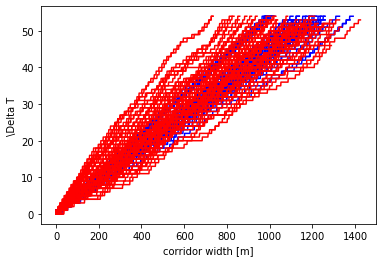

In [372]:
col = ["FR","X","Y","ID"]
blist = 2 * lin_var[test_var]
v_0_list = []
from itertools import groupby
N_del_i = 10
N_del = 10
os.system("mkdir " + path + "flow/")
err_total_up = np.empty([0])
err_total_down = np.empty([0])
x_total = np.empty([0])
DT_total = np.empty([0])
mot_total = np.empty([0])

N_list_list = np.empty([0])
t_arange_list =  np.empty([0])
numbering =  np.empty([0])
moti =  np.empty([0])
count_run = 0
for T_test in T_test_list:
    folder_frame_frac = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['ini_folder'])
    b_folder = np.array(folder_frame.loc[folder_frame[test_str2] == T_test]['b'])
    loc_list = [[path + folder + sl + "new_evac_traj_" + af.b_data_name(2 * bi, 3) + "_" + str(i) + ".txt" for i in
                 range(runs_tested)] for folder, bi in zip(folder_frame_frac, b_folder)]
    bi = 0
    exit_times = np.empty([blist.shape[0],N_runs])
    exit_times_np = np.empty([0])
    for loc_list_runs,w in zip(loc_list,range(blist.shape[0])):
        print("<calculating " + test_str + " = " + str(2 * lin_var[test_var][bi]) + ">")
        p0count = 0
        count = 0
        incount = 0
        #exit_time_array = np.empty([0])
        #exit_time_list = []
        for loc,i in zip(loc_list_runs,range(N_runs)):
            if os.path.isfile(loc) == False:
                #print("WARNING: file " + loc + " not found.")
                continue
            df = pd.read_csv(loc, sep="\s+", header=0, comment="#",skipinitialspace=True, usecols=col)
            min_value = df.groupby('ID')['Y'].min()[df['ID']]
            #print(min_value.keys())
            min_value = min_value[min_value < -0.2]
            key_filtered = min_value.keys().values
            df = df[df['ID'].isin(key_filtered)]
            df = df[df['Y'] >= 0]
            
            df_fr = df.groupby('ID')['FR'].max()
            df_fr = pd.DataFrame({'ID':df_fr.index.values,'FR':df_fr.values})
            
            if 2 * lin_var[test_var][bi] in bexp:
                if i < 15:
                    frames = df_fr['FR'].values
                    frame_max = df_fr['FR'].max()
                    N_count = 0
                    N_list = []
                    t_range = np.arange(0,frame_max)
                    for fr in t_range:
                        if fr in frames:
                            N_count += 1
                        N_list.append(N_count)
                    if T_test == 0.1:
                        f = "r"
                    else:
                        f = "b"
                    plt.plot(t_range,N_list,color = f)

                    num = np.empty([t_range.shape[0]])
                    num.fill(count_run)
                    mo = np.full((t_range.shape[0]),T_test)
                    numbering = np.append(numbering,num)
                    moti = np.append(moti,mo)
                    N_list_list = np.append(N_list_list,N_list)
                    t_arange_list = np.append(t_arange_list,t_range/fps)
            count_run += 1
            n_largest = df_fr['FR'].nlargest(10)
            n_smallest = df_fr['FR'].nsmallest(10)
            #print(n_largest)
            df_fr = df_fr[~df_fr['FR'].isin(n_largest)]
            df_fr = df_fr[~df_fr['FR'].isin(n_smallest)]

            #df_fr = df_fr.nsmallest(10)
            #print(df_fr)
            #print(df_fr['ID'].values.shape)
            exit_time = np.sort(df_fr['FR'].values)/fps
            exit_time_diff = exit_time[1:] - exit_time[:-1]
            exit_times[w][i] = exit_time_diff.mean()
            exit_times_np = np.append(exit_times_np, exit_time_diff)
            #print(exit_time_diff)
            #plt.boxplot(exit_time_diff)
            #exit_time_array = np.append(exit_time_array,exit_time_diff.mean())
            #exit_time_list.append(exit_time_diff)
        #exit_times.append(exit_time_array)
            #exit_time_array[w][i] = exit_time_diff[0:30]
        exit_times_df = pd.DataFrame({"DT" : exit_times_np})
        exit_times_df.to_csv(path + "/flow/DThist" + str(T_test) + ".csv")
        mot_total = np.append(mot_total,T_test)
        bi += 1
        

    flat_list = exit_times
    cat = np.array([np.array([i for k in den]) for i, den in zip(np.arange(0, lin_var[test_var].shape[0]), flat_list)])
    # print(cat.flatten().shape)
    # print(density_reduced.flatten().shape)
    print(cat.flatten().shape)
    print(flat_list.flatten().shape)
    df = pd.DataFrame()
    df['category'] = cat.flatten()
    df['density'] = flat_list.flatten()

    mean = df.groupby('category')['density'].mean()
    p025 = df.groupby('category')['density'].quantile(0.025)
    p975 = df.groupby('category')['density'].quantile(0.975)

    plt.xlabel(af.title_var(test_var))
    plt.ylabel('\Delta T')

    #x = var_new  # np.array([var[test_var] for var in cross_var])
    if test_var == 1:
        x = 2 * lin_var[1]

    err = [mean - p025, p975 - mean]
    #plt.errorbar(x, mean, yerr=err, fmt='v', label= af.label_var(test_var2) + str(T_test), ms=10)
    err_total_up = np.append(err_total_up,err[0])
    err_total_down = np.append(err_total_down,err[0])

    x_total = np.append(x_total,x)
    DT_total = np.append(DT_total,mean)
df_out = pd.DataFrame({test_str:x_total,"DT":DT_total,"DTerr_up":err_total_up,"DTerr_down":err_total_down,test_str2:mot_total})
df_out.to_csv(path + "flow/" + "flow_err.csv")

print(t_arange_list.shape,N_list_list.shape,moti.shape,numbering.shape)
df_exp_n = pd.DataFrame({"t":t_arange_list,"NT":N_list_list,"motivation":moti,"num": numbering})
df_exp_n.to_csv(path + "flow/NT.csv")

    #plt.boxplot(exit_times.T)
#plt.legend()
#plt.plot(bexp,mean_exit_exp, ls = "None", marker = "o")
plt.show()

    #plt.scatter(blist, exit_time_array/fps)
    #print(exit)
    

(480,) (480,)
(17102,) (17102,) (17102,) (17102,)


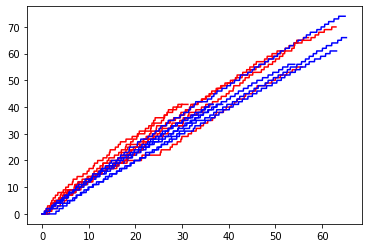

In [336]:
from os import listdir
from os.path import isfile, join
onlyfiles = [f for f in listdir("exp_results/trajectories/") if isfile(join("exp_results/trajectories/", f)) and f != ".DS_Store"]
colexp = ["id",'frame','x/m','y/m']
bexp = []
mot = []
onlyfiles_new = []
for files in onlyfiles:
    df = pd.read_csv("exp_results/trajectories/"+ files, sep="\s+", header=0, comment="#",skipinitialspace=True,index_col=False, usecols=colexp)
    #min_value = df.groupby('id')['y/m'].min()[df['id']]
    id_max = df["id"].max()
    if id_max < 40:
        continue
    onlyfiles_new.append(files)

    bexp.append(float(files[6] + "." + files[7]))
    if files[10] == "0":
        mot.append("high")
    if files[10] == "-":
        mot.append("low")
#print(len(mot))
mean_exit_exp = []
N_list_list = np.empty([0])
t_arange_list =  np.empty([0])
numbering =  np.empty([0])
moti =  np.empty([0])
exit_times_np = np.empty([0])
mot_large = np.empty([0])

for files,m,k in zip(onlyfiles_new,mot,range(len(onlyfiles_new))):

    #print(files,m)
    #print(files)
    df = pd.read_csv("exp_results/trajectories/"+ files, sep="\s+", header=0, comment="#",skipinitialspace=True,index_col=False, usecols=colexp)
    #min_value = df.groupby('id')['y/m'].min()[df['id']]
    id_max = df["id"].max()
    if id_max < 40:
        continue

    #print(min_value.keys())
    #min_value = min_value[min_value < -0.2]
    #key_filtered = min_value.keys().values
    #df = df[df['id'].isin(key_filtered)]
    df = df[df['y/m'] >= 0]
    df_fr = df.groupby('id')['frame'].max()
    df_fr = pd.DataFrame({'id':df_fr.index.values,'frame':df_fr.values})
    
    frames = df_fr['frame'].values
    frame_max = df_fr['frame'].max()
    N_count = 0
    N_exp = []
    t_range = np.arange(0,frame_max)
    for fra in t_range:
        if fra in frames:
            N_count += 1
        N_exp.append(N_count)
    if m == "high":
        f = "r"
    else:
        f = "b"
    num = np.empty([t_range.shape[0]])
    num.fill(k)
    mo = np.full((t_range.shape[0]),m)
    numbering = np.append(numbering,num)
    moti = np.append(moti,mo)
    N_list_list = np.append(N_list_list,N_exp)
    t_arange_list = np.append(t_arange_list,t_range/25)
    plt.plot(t_range/25,N_exp,color = f)

    
    
    n_largest = df_fr['frame'].nlargest(10)
    n_smallest = df_fr['frame'].nsmallest(10)
    #print(df_fr)
    #print(n_largest)
    df_fr = df_fr[~df_fr['frame'].isin(n_largest)]
    df_fr = df_fr[~df_fr['frame'].isin(n_smallest)]
    #df_fr = df_fr.nsmallest(10)
    #print(df_fr)
    #print(df_fr['ID'].values.shape)
    exit_time = np.sort(df_fr['frame'].values)/25
    exit_time_diff = exit_time[1:] - exit_time[:-1]
    exit_times_np = np.append(exit_times_np, exit_time_diff)
    mot_large = np.append(mot_large,np.full((exit_time_diff.shape[0]),m))
    
    #print(exit_time_diff.mean())
    mean_exit_exp.append(exit_time_diff.mean())
print(exit_times_np.shape,mot_large.shape)
exit_times_df = pd.DataFrame({"DT" : exit_times_np,"motivation": mot_large})
exit_times_df.to_csv("exp_results/DThist.csv")

df_exp = pd.DataFrame({"b" : bexp,"DT": mean_exit_exp,"mot":mot})
df_exp.to_csv("exp_results/DT.csv")

print(t_arange_list.shape,N_list_list.shape, moti.shape,numbering.shape)
df_exp_n = pd.DataFrame({"t":t_arange_list,"NT":N_list_list,"motivation":moti,"num": numbering})
df_exp_n.to_csv("exp_results/NT.csv")
    #exit_times[w][i] = exit_time_diff.mean()